In [1]:
# Standard Library Imports
import os
import re
import json
import random
import multiprocessing
import statistics
from typing import Any, Tuple

# Third-party Imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from qiskit import QuantumCircuit, transpile,ClassicalRegister,QuantumRegister
from qiskit_ibm_runtime import QiskitRuntimeService, SamplerV2 as Sampler
from qiskit.transpiler.preset_passmanagers import generate_preset_pass_manager
from qiskit_aer import QasmSimulator
from qiskit.visualization import plot_distribution
from IPython.display import display
from deap import creator, base, tools

import grape  # Grammatical evolution library
from grape import algorithms  # Evolutionary algorithms

In [ ]:
# Configure IBM Quantum Service
QiskitRuntimeService.save_account(
    token='IBM_QUANTUM_TOKEN_HERE', 
    overwrite=True,
    channel='ibm_cloud',
    instance='ibm_quantum_instance_id_here'
)

service = QiskitRuntimeService()  # Loads default account

backend = service.backend("ibm_torino")
backend_name = backend.name
print(f"✓ Connected to backend: {backend_name}")
print(f"✓ Saved accounts: {service.saved_accounts()}")

In [3]:
# Get the number of logical CPU cores available
num_cores = os.cpu_count()
print("Number of CPU cores available:", num_cores)

Number of CPU cores available: 10


In [4]:
BNF_GRAMMAR = grape.Grammar("grammars/grover.bnf")

In [5]:
# Define evaluation constants
NUM_SHOTS = 10000
SUCCESS_THRESHOLD = 0.48
GATE_PENALTY_WEIGHT = 0.02
TARGET_STATE = "101"

In [6]:
def generate_oracle_for_state(marked_state: str) -> str:
    """Generate Grover oracle code for a given marked state."""
    n = len(marked_state)
    code_lines = []
    # For each qubit where the marked state is '0', apply X gate.
    for i, bit in enumerate(marked_state):
        if bit == '0':
            code_lines.append(f"qc.x({i})")
    # Apply a multi-controlled phase flip (using Hadamard and mcx)
    code_lines.append(f"qc.h({n-1})")
    code_lines.append(f"qc.mcx(list(range({n-1})), {n-1})")
    code_lines.append(f"qc.h({n-1})")
    # Undo the X gates.
    for i, bit in enumerate(marked_state):
        if bit == '0':
            code_lines.append(f"qc.x({i})")
    return "\n".join(code_lines) + "\n"


In [7]:
class CircuitEvaluator:
    def __init__(self, shots: int = NUM_SHOTS, log_dir: str = None):
        """
        Initialize the evaluator with simulation parameters and logging directory.
        """
        self.shots = shots
        self.log_dir = log_dir
        if log_dir:
            os.makedirs(self.log_dir, exist_ok=True)
        os.makedirs(self.log_dir, exist_ok=True)
    
    def decode_individual(self, ind) -> str:
        """
        Decodes an individual's genome into a phenotype code string.
        Returns:
            A string containing the code if decoding is successful,
            or None if invalid.
        """
        if ind.invalid or not hasattr(ind, 'phenotype'):
            return None
        try:
            phenotype_code = ind.phenotype
            if isinstance(phenotype_code, list):
                phenotype_code = "".join(phenotype_code)
            # Replace literal \n with actual newlines and clean quotes
            cleaned_code = re.sub(r'\\n', '\n', phenotype_code)
            cleaned_code = re.sub(r'^"|"$', '', cleaned_code)
            cleaned_code = re.sub(r'"\s+"', '\n', cleaned_code)

            # Inject named registers for compatibility with Sampler V2
            cleaned_code = re.sub(
                r"qc\s*=\s*QuantumCircuit\(\s*3\s*,\s*3\s*\)",
                "qr = QuantumRegister(3, name='q')\ncr = ClassicalRegister(3, name='cr')\nqc = QuantumCircuit(qr, cr)",
                cleaned_code
            )
            return cleaned_code
        except Exception as ex:
            print(f"[Decode Error] {ex}")
            return None
    
    def execute_circuit(self, phenotype_code: str) -> QuantumCircuit:
        """
        Executes the phenotype code to produce a QuantumCircuit.
        Returns:
            The QuantumCircuit if 'qc' is found in the execution context,
            otherwise None.
        """
        local_vars = {}
        try:
            exec(phenotype_code, globals(), local_vars)
            if "qc" in local_vars:
                return local_vars["qc"]
            else:
                print("No circuit variable 'qc' found in phenotype code.")
                return None
        except Exception as e:
            print(f"Error executing phenotype code: {e}")
            return None
    
    def simulate_circuit(self, circuit: QuantumCircuit, marked_state: str) -> dict:
        """
        Simulates the circuit and returns performance metrics for the given marked state.
        
        Args:
            circuit (QuantumCircuit): The circuit to simulate.
            marked_state (str): The state to evaluate.
        
        Returns:
            dict: Contains counts, p_marked, error, gate_count, and depth.
        """
        simulator = QasmSimulator()
        compiled = transpile(circuit, simulator, optimization_level=0)
        result = simulator.run(compiled, shots=self.shots).result()
        counts = result.get_counts()
        # Reverse bitstrings to match the expected format.
        corrected = {k[::-1]: v for k, v in counts.items()}
        total = sum(corrected.values())
        p_marked = corrected.get(marked_state, 0) / total if total > 0 else 0.0
        error = 1 - p_marked
        return {
            "counts": corrected,
            "p_marked": p_marked,
            "error": error,
            "gate_count": compiled.size(),
            "depth": compiled.depth()
        }
    
    def log_evaluation(self, logs: list, generation: int, individual) -> None:
        """
        Logs the evaluation details for an individual to JSON and CSV files.
        """
        if not self.log_dir:
            return
        id_hash = hash(str(individual.genome)) % 10**8
        log_file_json = os.path.join(self.log_dir, f"eval_gen{generation}_id{id_hash}.json")
        log_file_csv = os.path.join(self.log_dir, f"eval_gen{generation}_id{id_hash}.csv")
        with open(log_file_json, "w") as f:
            json.dump(logs, f, indent=2)
        df = pd.DataFrame(logs)
        df[["state", "p_marked", "error", "gate_count", "depth"]].to_csv(log_file_csv, index=False)

In [8]:
def inject_oracle(phenotype_str: str, oracle_code: str) -> str:
    """Inject oracle code into the phenotype string."""
    pattern = r"(## Begin Oracle\n)(.*?)(## End Oracle\n)"
    new_block = r"\1" + oracle_code + r"\3"
    return re.sub(pattern, new_block, phenotype_str, flags=re.DOTALL)

In [9]:
# %%
def fitness_function_specialized_state_000(
    phenotype_str,
    shots=NUM_SHOTS,
    threshold=SUCCESS_THRESHOLD,
    gate_penalty_weight=GATE_PENALTY_WEIGHT,
    target_state=TARGET_STATE,
    log_states=True,
    log_dir=None  
):
    if not isinstance(phenotype_str, str):
        return (float('inf'), []) if log_states else float('inf')
        
    # Initialize Evaluator with the CORRECT directory
    evaluator = CircuitEvaluator(shots=shots, log_dir=log_dir)
    logs = []
    
    oracle_code = generate_oracle_for_state(target_state)
    modified_code = inject_oracle(phenotype_str, oracle_code)
    qc = evaluator.execute_circuit(modified_code)
    if qc is None:
        return (float('inf'), []) if log_states else float('inf')
    
    result = evaluator.simulate_circuit(qc, target_state)
    p_marked = result["p_marked"]
    error = 1 - p_marked
    miss = 1 if error > threshold else 0
    gate_count = result.get("gate_count", 0)
    
    fitness_score = 10 * miss + error + gate_penalty_weight * gate_count
    
    if log_states:
        logs.append({
            "state": target_state,
            "p_marked": p_marked,
            "error": error,
            "gate_count": gate_count,
            "oracle": oracle_code,
            "code": modified_code,
            "counts": result["counts"],
            "depth": result.get("depth", None)
        })
        return (fitness_score, logs)
    else:
        return fitness_score

In [10]:
POPULATION_SIZE    = 1000
MAX_GENERATIONS    = 100
N_GEN = 1
P_CROSSOVER        = 0.8     
P_MUTATION         = 0.01
ELITE_SIZE         = 1
HALLOFFAME_SIZE    = 1
CODON_SIZE         = 400
MAX_TREE_DEPTH     = 50      
TOURNAMENT_SIZE    = 5
MIN_INIT_DEPTH     = 20        
MAX_INIT_DEPTH     = 40       
CODON_CONSUMPTION  = "lazy"   
GENOME_REPRESENTATION = 'list'
REPORT_ITEMS = ['gen', 'invalid', 'avg', 'std', 'min', 'max',
                'fitness_test',
                'best_ind_length', 'avg_length',
                'best_ind_nodes', 'avg_nodes',
                'avg_depth',
                'avg_used_codons', 'best_ind_used_codons',
                'selection_time', 'generation_time']

## IBM Hardware Runner Function

In [20]:
def run_hof_on_ibm(evaluator, hof, target_state=TARGET_STATE):
    """Run Hall of Fame individuals on IBM hardware."""
    service = QiskitRuntimeService(channel="ibm_cloud")  # Changed from "ibm_quantum"
    backend = service.backend("ibm_torino")
    print(f"[QPU] Running on: {backend.name}")

    sampler = Sampler(mode=backend)
    sampler.options.default_shots = evaluator.shots

    for i, ind in enumerate(hof.items):
        print(f"\n[HOF Individual {i+1}] Fitness: {ind.fitness.values[0]}")

        pheno_code = evaluator.decode_individual(ind)
        pheno_code = re.sub(
            r"qc\s*=\s*QuantumCircuit\(\s*3\s*,\s*3\s*\)",
            "qr = QuantumRegister(3, name='q')\n"
            "cr = ClassicalRegister(3, name='cr')\n"
            "qc = QuantumCircuit(qr, cr)",
            pheno_code
        )

        qc = evaluator.execute_circuit(pheno_code)
        if qc is None:
            print(" Invalid circuit. Skipping.")
            continue

        pm = generate_preset_pass_manager(target=backend.target, optimization_level=3)
        circuit_isa = pm.run(qc)

        print("Evolved transpiled count_ops:", circuit_isa.count_ops())
        print("Evolved transpiled depth:   ", circuit_isa.depth())
        print("Total ops:       ", circuit_isa.size())
        print("Qubits / Clbits: ", circuit_isa.num_qubits, "/", circuit_isa.num_clbits)

        display(circuit_isa.draw(output="mpl", idle_wires=False))

        result = sampler.run([circuit_isa]).result()
        databins = result[0].data
        counts = databins["cr"].get_counts()
        counts = {k[::-1]: v for k, v in counts.items()}
        display(plot_distribution(counts, title=f"HOF #{i+1} on {backend.name}"))

### Independent Run Function

In [12]:
NUMBER_OF_RUNS = 5

In [13]:
def run_evolution_experiment(run_id, seed, target_state):
    """Runs a complete GE evolution for a specific seed and target state."""
    print(f"\n{'='*60}")
    print(f"RUN {run_id}/{NUMBER_OF_RUNS} | Target: {target_state} | Seed: {seed}")
    print(f"{'='*60}")
    
    # Organize logs by state, then by run
    state_dir = f"experiments_state_{target_state}"
    os.makedirs(state_dir, exist_ok=True)
    run_log_dir = os.path.join(state_dir, f"run_{run_id}_seed_{seed}")
    os.makedirs(run_log_dir, exist_ok=True)
    print(f"✓ Logging to: {run_log_dir}")
    
    random.seed(seed)
    np.random.seed(seed)
    
    # Force clean DEAP state
    for attr in ["FitnessMin", "Individual"]:
        if hasattr(creator, attr):
            delattr(creator, attr)
    
    creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
    creator.create("Individual", grape.Individual, fitness=creator.FitnessMin)

    toolbox = base.Toolbox()
    toolbox.register(
        "populationCreator",
        grape.sensible_initialisation,
        creator.Individual,
        bnf_grammar=BNF_GRAMMAR,
        min_init_depth=MIN_INIT_DEPTH,
        max_init_depth=MAX_INIT_DEPTH,
        codon_size=CODON_SIZE,
        codon_consumption=CODON_CONSUMPTION,
        genome_representation=GENOME_REPRESENTATION
    )
    toolbox.register("mate", grape.crossover_onepoint)
    toolbox.register("mutate", grape.mutation_int_flip_per_codon)
    toolbox.register("select", tools.selTournament, tournsize=TOURNAMENT_SIZE)
    
    # Create pool for this specific run
    pool = multiprocessing.Pool(num_cores)
    toolbox.register("map", pool.map)
    
    def evaluate_wrapper(individual, pts_train=None):
        evaluator = CircuitEvaluator(shots=NUM_SHOTS, log_dir=run_log_dir)
        phenotype_str = evaluator.decode_individual(individual)
        if not phenotype_str:
            return (float('inf'),)
        fitness_val = fitness_function_specialized_state_000(
            phenotype_str,
            shots=NUM_SHOTS,
            threshold=SUCCESS_THRESHOLD,
            gate_penalty_weight=GATE_PENALTY_WEIGHT,
            target_state=target_state,
            log_states=False,
            log_dir=run_log_dir
        )
        return (fitness_val,)

    toolbox.register("evaluate", evaluate_wrapper)

    # Initialize population
    population = toolbox.populationCreator(pop_size=POPULATION_SIZE)
    hof = tools.HallOfFame(1)
    stats = tools.Statistics(lambda ind: ind.fitness.values)
    stats.register("avg", np.mean)
    stats.register("std", np.std)
    stats.register("min", np.min)
    stats.register("max", np.max)
    
    evaluator = CircuitEvaluator(shots=NUM_SHOTS, log_dir=run_log_dir)
    
    # Track metrics over generations
    generations_list = []
    best_fitness_list = []
    best_fidelity_list = []
    best_gate_count_list = []
    best_depth_list = []
    
    # Manual evolution loop with progress display
    print(f"✓ Starting evolution (Population: {POPULATION_SIZE}, Generations: {MAX_GENERATIONS})")
    
    for gen in range(MAX_GENERATIONS):
        # Run one generation
        population, logbook = algorithms.ge_eaSimpleWithElitism(
            population,
            toolbox,
            cxpb=P_CROSSOVER,
            mutpb=P_MUTATION,
            ngen=N_GEN,  # Only 1 generation at a time
            elite_size=ELITE_SIZE,
            bnf_grammar=BNF_GRAMMAR,
            codon_size=CODON_SIZE,
            max_tree_depth=MAX_TREE_DEPTH,
            codon_consumption=CODON_CONSUMPTION,
            report_items=['gen', 'min', 'avg'],
            genome_representation=GENOME_REPRESENTATION,
            stats=stats,
            halloffame=hof,
            verbose=False
        )
        
        # DISPLAY BEST INDIVIDUAL OF THIS GENERATION
        best_ind = tools.selBest(population, 1)[0]
        best_ind.generation = gen
        
        best_phenotype = evaluator.decode_individual(best_ind)
        if best_phenotype is not None:
            fitness_val, logs = fitness_function_specialized_state_000(
                best_phenotype,
                shots=NUM_SHOTS,
                threshold=SUCCESS_THRESHOLD,
                gate_penalty_weight=GATE_PENALTY_WEIGHT,
                target_state=target_state,
                log_states=True,
                log_dir=run_log_dir
            )
            
            # TRACK METRICS (but don't log to disk yet)
            generations_list.append(gen)
            best_fitness_list.append(best_ind.fitness.values[0])
            best_fidelity_list.append(logs[0]['p_marked'])
            best_gate_count_list.append(logs[0]['gate_count'])
            best_depth_list.append(logs[0]['depth'])
            
            qc = evaluator.execute_circuit(best_phenotype)
            if qc:
                print(f"\n[Run {run_id} | Gen {gen}/{MAX_GENERATIONS-1}] Best Fitness: {best_ind.fitness.values[0]:.4f} | Fidelity: {logs[0]['p_marked']:.4f} | Gates: {logs[0]['gate_count']}")
                display(qc.draw("mpl"))
    
    # PLOT EVOLUTION METRICS
    print(f"\n{'='*60}")
    print(f"Generating evolution plots for Run {run_id}...")
    print(f"{'='*60}")
    
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    
    # Fitness plot
    axes[0, 0].plot(generations_list, best_fitness_list, 'b-', linewidth=2)
    axes[0, 0].set_xlabel('Generation', fontsize=12)
    axes[0, 0].set_ylabel('Best Fitness (Lower is Better)', fontsize=12)
    axes[0, 0].set_title(f'Run {run_id}: Fitness Evolution', fontsize=14, fontweight='bold')
    axes[0, 0].grid(True, alpha=0.3)
    
    # Fidelity plot
    axes[0, 1].plot(generations_list, best_fidelity_list, 'g-', linewidth=2)
    axes[0, 1].set_xlabel('Generation', fontsize=12)
    axes[0, 1].set_ylabel('Fidelity', fontsize=12)
    axes[0, 1].set_title(f'Run {run_id}: Fidelity Evolution', fontsize=14, fontweight='bold')
    axes[0, 1].grid(True, alpha=0.3)
    axes[0, 1].set_ylim([0, 1.05])
    axes[0, 1].axhline(y=SUCCESS_THRESHOLD, color='r', linestyle='--', label=f'Threshold={SUCCESS_THRESHOLD}')
    axes[0, 1].legend()
    
    # Gate count plot
    axes[1, 0].plot(generations_list, best_gate_count_list, 'r-', linewidth=2)
    axes[1, 0].set_xlabel('Generation', fontsize=12)
    axes[1, 0].set_ylabel('Gate Count', fontsize=12)
    axes[1, 0].set_title(f'Run {run_id}: Gate Count Evolution', fontsize=14, fontweight='bold')
    axes[1, 0].grid(True, alpha=0.3)
    
    # Depth plot
    axes[1, 1].plot(generations_list, best_depth_list, 'm-', linewidth=2)
    axes[1, 1].set_xlabel('Generation', fontsize=12)
    axes[1, 1].set_ylabel('Circuit Depth', fontsize=12)
    axes[1, 1].set_title(f'Run {run_id}: Depth Evolution', fontsize=14, fontweight='bold')
    axes[1, 1].grid(True, alpha=0.3)
    
    plt.tight_layout()
    plot_path = os.path.join(run_log_dir, f'evolution_metrics_run_{run_id}.png')
    plt.savefig(plot_path, dpi=150, bbox_inches='tight')
    print(f"✓ Plot saved to: {plot_path}")
    display(fig)
    plt.close()
    
    # Close pool after evolution completes
    pool.close()
    pool.join()
    
    # Final evaluation
    best_ind = hof[0]
    phenotype = evaluator.decode_individual(best_ind)
    
    metrics_score, logs = fitness_function_specialized_state_000(
        phenotype,
        shots=NUM_SHOTS,
        threshold=SUCCESS_THRESHOLD,
        gate_penalty_weight=GATE_PENALTY_WEIGHT,
        target_state=target_state,
        log_states=True,
        log_dir=run_log_dir
    )
    
    best_metrics = logs[0]
    
    # LOG ONLY THE FINAL BEST CIRCUIT TO DISK
    evaluator.log_evaluation(logs, MAX_GENERATIONS-1, best_ind)
    
    print(f"\n{'='*60}")
    print(f"✓ Run {run_id} COMPLETE | Fidelity: {best_metrics['p_marked']:.4f} | Gates: {best_metrics['gate_count']} | Depth: {best_metrics['depth']}")
    print(f"{'='*60}\n")
    
    return {
        "run_id": run_id,
        "seed": seed,
        "log_dir": run_log_dir,
        "individual": best_ind,
        "phenotype": phenotype,
        "fidelity": best_metrics['p_marked'],
        "gate_count": best_metrics['gate_count'],
        "depth": best_metrics['depth'],
        "raw_fitness": best_ind.fitness.values[0],
        # Include evolution history for aggregate plotting
        "generations": generations_list,
        "fitness_history": best_fitness_list,
        "fidelity_history": best_fidelity_list,
        "gate_count_history": best_gate_count_list,
        "depth_history": best_depth_list
    }

### Execute 5 Independent Runs

Generated seeds: [29855, 15775, 52596, 60899, 37187]
✓ Seeds saved to experiment_seeds.json

Starting 5 independent runs for state |101>...

RUN 1/5 | Target: 101 | Seed: 29855
✓ Logging to: experiments_state_101/run_1_seed_29855
✓ Starting evolution (Population: 1000, Generations: 100)
gen = 0 , Best fitness = (1.6815,)
gen = 1 , Best fitness = (1.6815,) , Number of invalids = 138

[Run 1 | Gen 0/99] Best Fitness: 1.6815 | Fidelity: 0.5485 | Gates: 62


/Users/admin/Downloads/GE_Grover/.venv/lib/python3.10/site-packages/numpy/_core/_methods.py:191: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


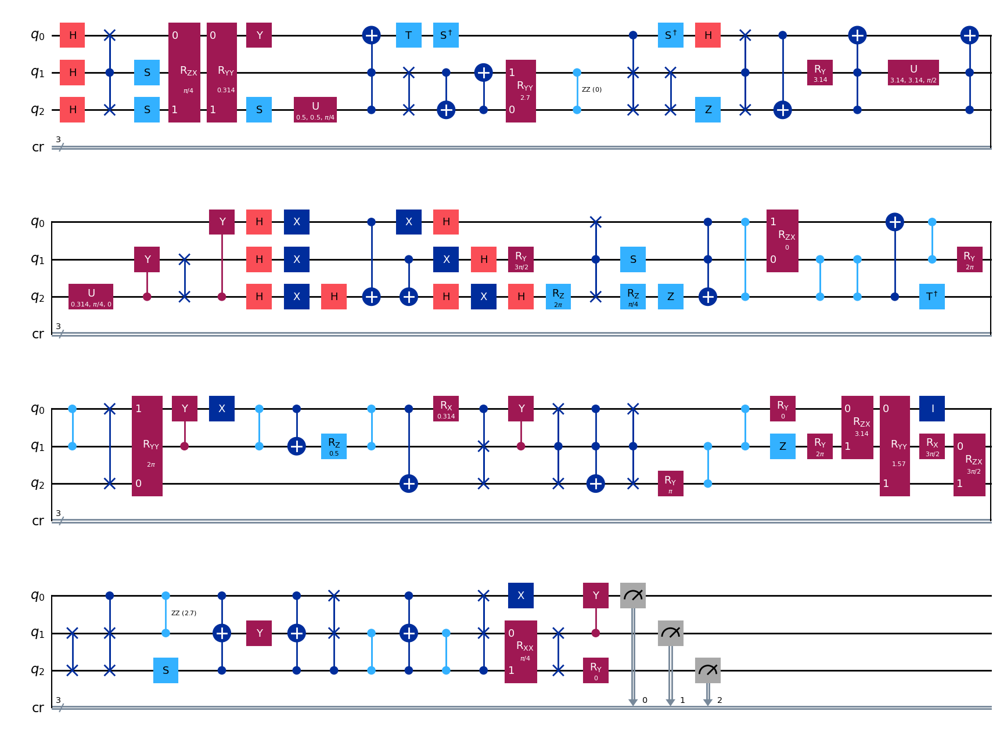

gen = 0 , Best fitness = (1.6815,)
gen = 1 , Best fitness = (1.6815,) , Number of invalids = 96

[Run 1 | Gen 1/99] Best Fitness: 1.6815 | Fidelity: 0.5564 | Gates: 62


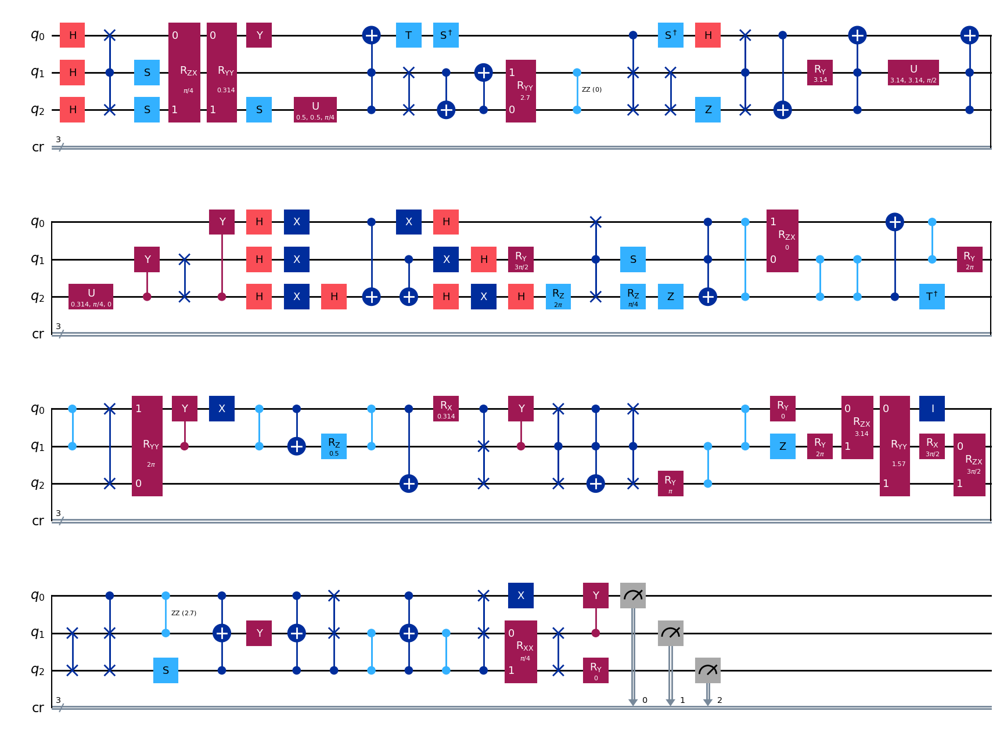

gen = 0 , Best fitness = (1.6815,)
gen = 1 , Best fitness = (1.6815,) , Number of invalids = 61

[Run 1 | Gen 2/99] Best Fitness: 1.6815 | Fidelity: 0.5464 | Gates: 62


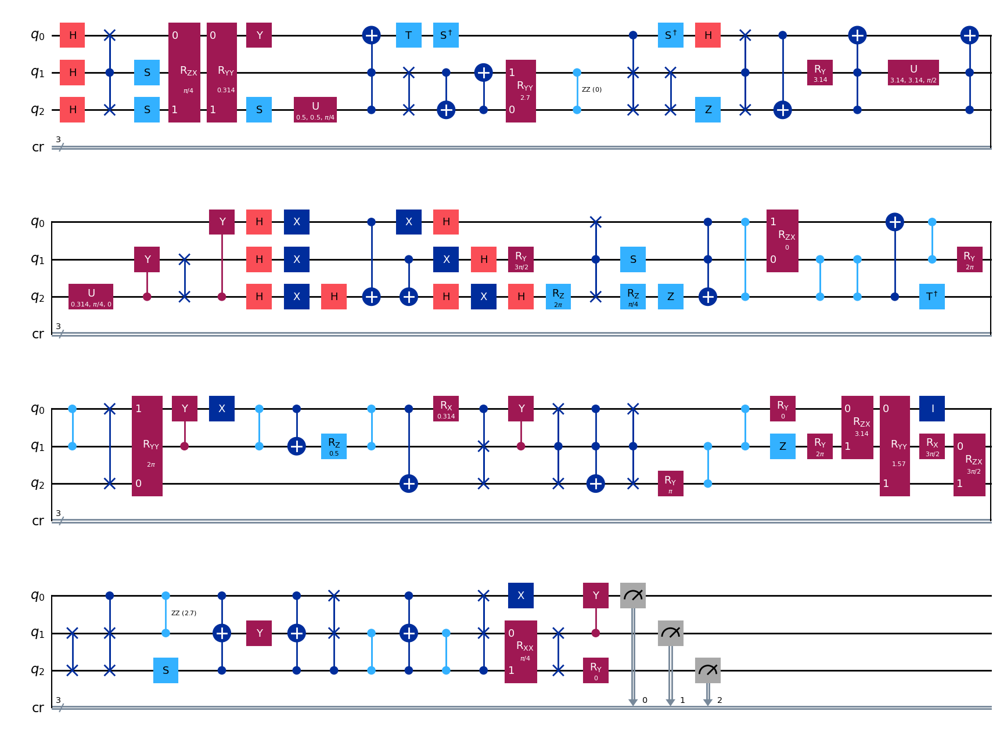

gen = 0 , Best fitness = (1.6815,)
gen = 1 , Best fitness = (1.6802000000000001,) , Number of invalids = 60

[Run 1 | Gen 3/99] Best Fitness: 1.6802 | Fidelity: 0.5443 | Gates: 62


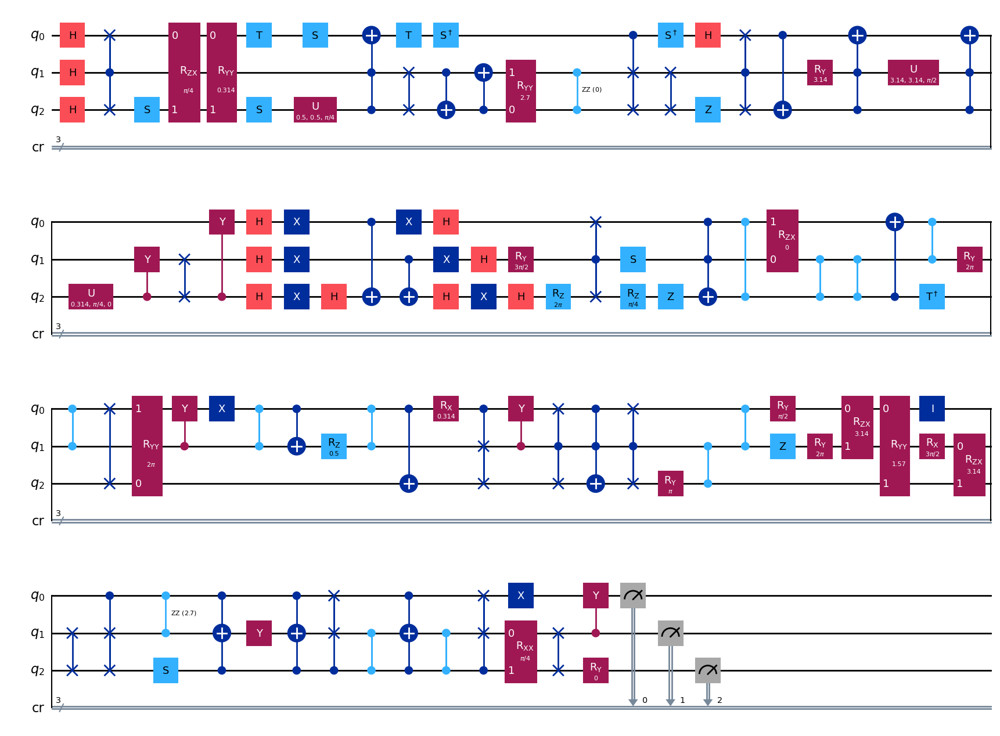

gen = 0 , Best fitness = (1.6802000000000001,)
gen = 1 , Best fitness = (1.6802000000000001,) , Number of invalids = 59

[Run 1 | Gen 4/99] Best Fitness: 1.6802 | Fidelity: 0.5583 | Gates: 62


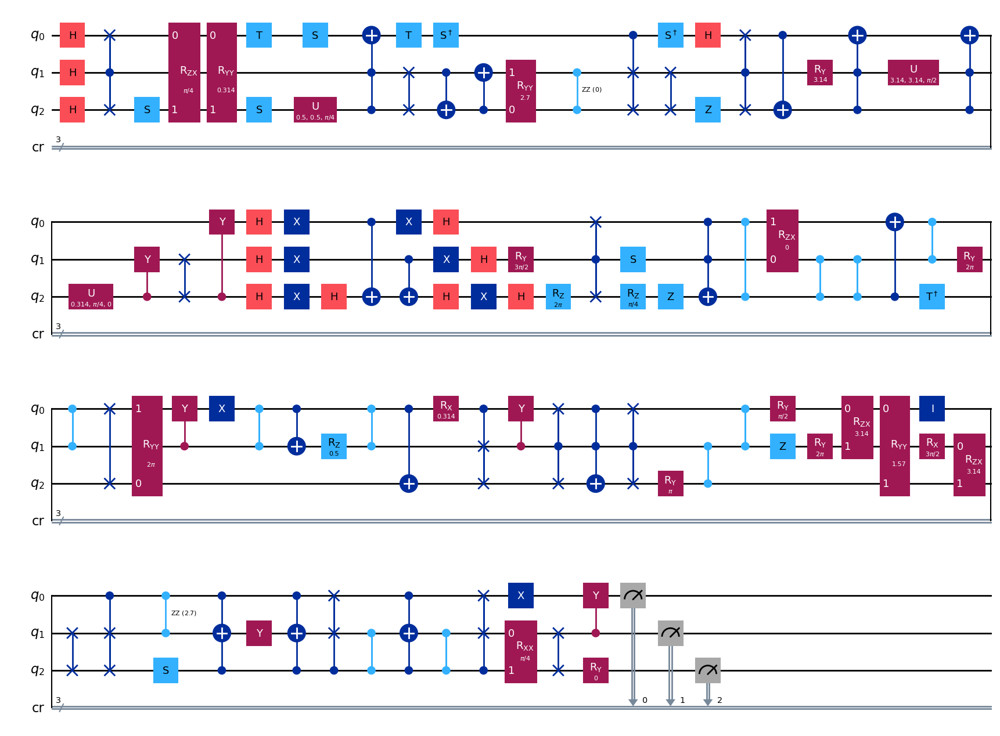

gen = 0 , Best fitness = (1.6802000000000001,)
gen = 1 , Best fitness = (1.6802000000000001,) , Number of invalids = 59

[Run 1 | Gen 5/99] Best Fitness: 1.6802 | Fidelity: 0.5458 | Gates: 62


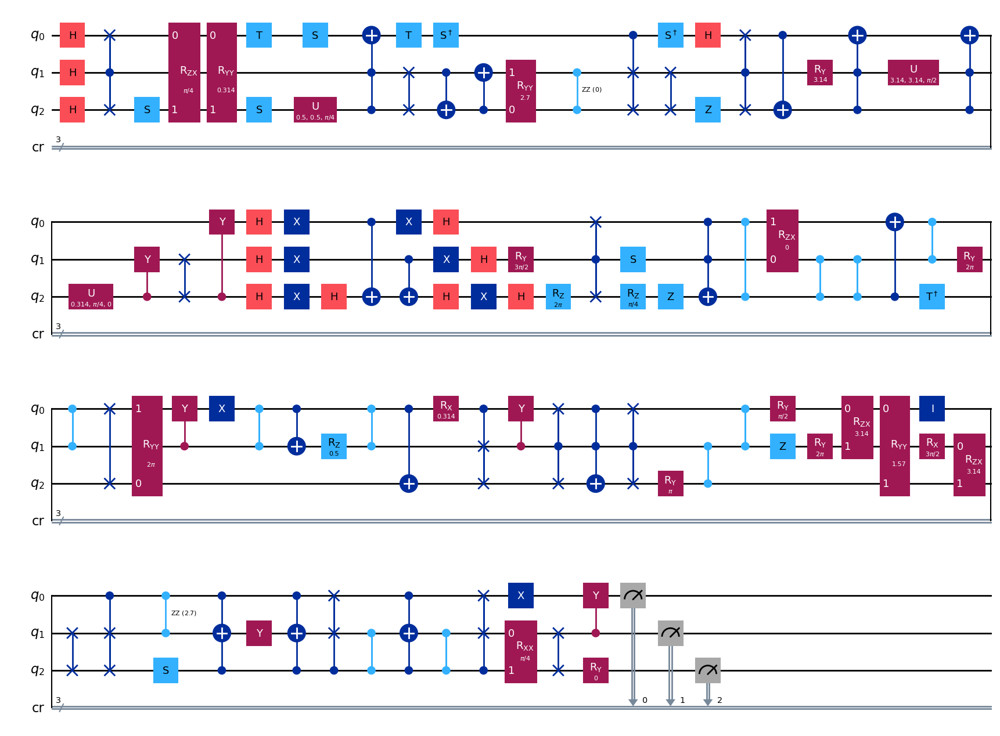

gen = 0 , Best fitness = (1.6802000000000001,)
gen = 1 , Best fitness = (1.4864000000000002,) , Number of invalids = 56

[Run 1 | Gen 6/99] Best Fitness: 1.4864 | Fidelity: 0.5618 | Gates: 52


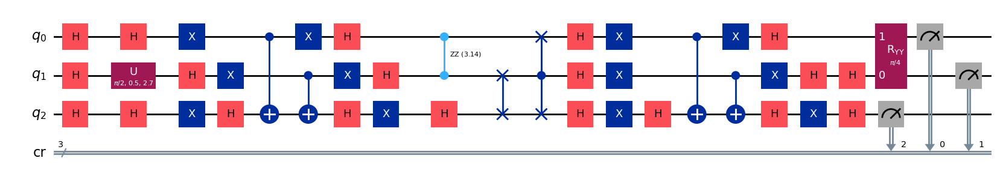

gen = 0 , Best fitness = (1.4864000000000002,)
gen = 1 , Best fitness = (1.005,) , Number of invalids = 43

[Run 1 | Gen 7/99] Best Fitness: 1.0050 | Fidelity: 0.5871 | Gates: 30


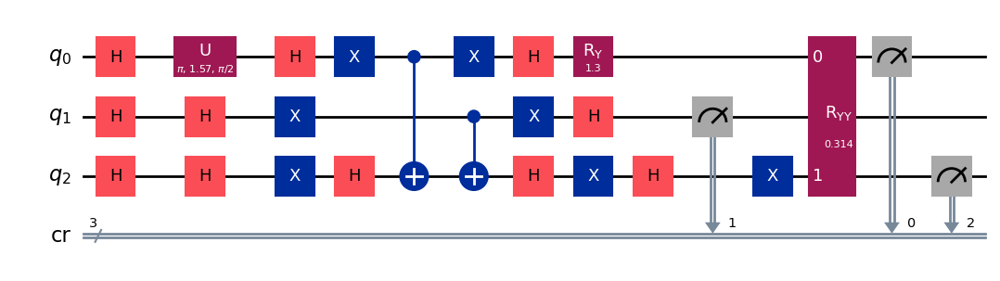

gen = 0 , Best fitness = (1.005,)
gen = 1 , Best fitness = (1.0019,) , Number of invalids = 55

[Run 1 | Gen 8/99] Best Fitness: 1.0019 | Fidelity: 0.6008 | Gates: 30


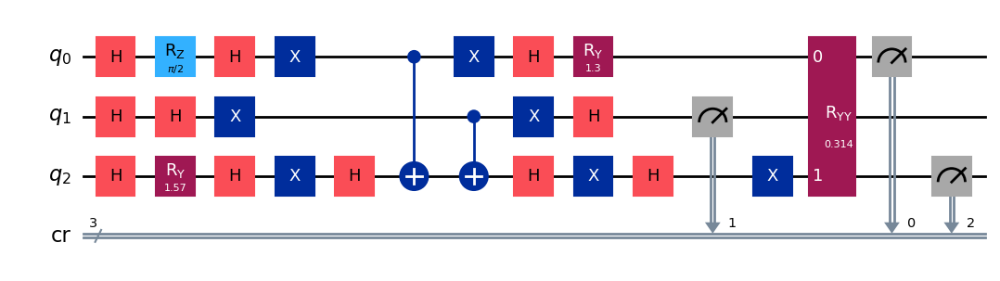

gen = 0 , Best fitness = (1.0019,)
gen = 1 , Best fitness = (1.0019,) , Number of invalids = 39

[Run 1 | Gen 9/99] Best Fitness: 1.0019 | Fidelity: 0.5945 | Gates: 30


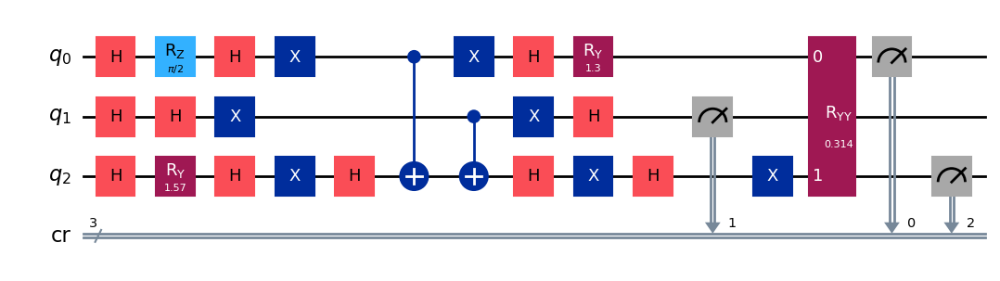

gen = 0 , Best fitness = (1.0019,)
gen = 1 , Best fitness = (0.9882,) , Number of invalids = 45

[Run 1 | Gen 10/99] Best Fitness: 0.9882 | Fidelity: 0.6065 | Gates: 30


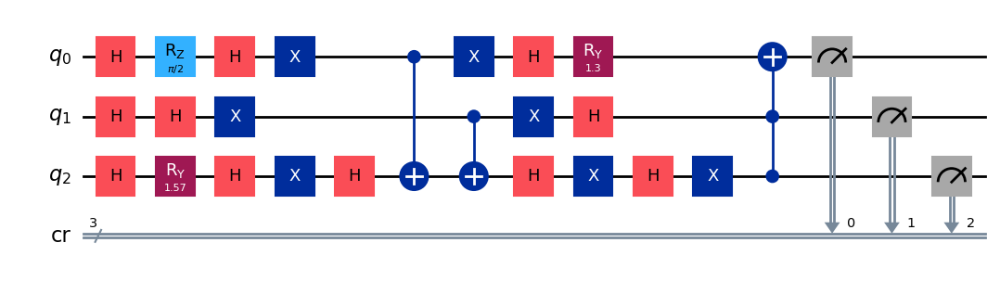

gen = 0 , Best fitness = (0.9882,)
gen = 1 , Best fitness = (0.9882,) , Number of invalids = 44

[Run 1 | Gen 11/99] Best Fitness: 0.9882 | Fidelity: 0.6023 | Gates: 30


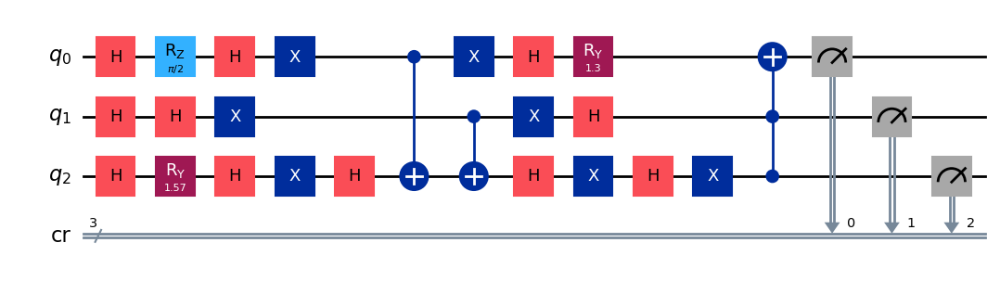

gen = 0 , Best fitness = (0.9882,)
gen = 1 , Best fitness = (0.9882,) , Number of invalids = 53

[Run 1 | Gen 12/99] Best Fitness: 0.9882 | Fidelity: 0.6065 | Gates: 30


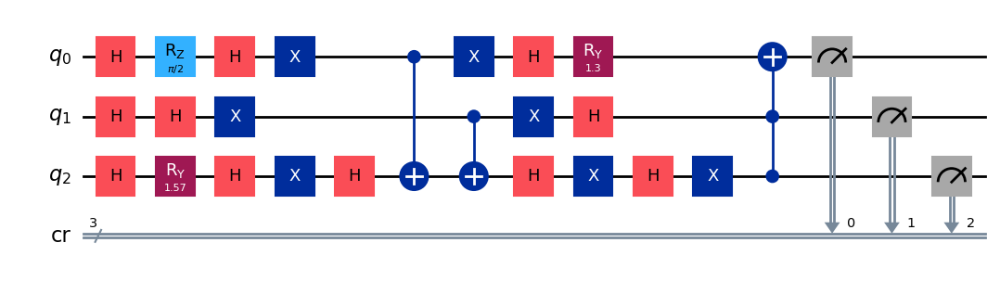

gen = 0 , Best fitness = (0.9882,)
gen = 1 , Best fitness = (0.9674999999999999,) , Number of invalids = 37

[Run 1 | Gen 13/99] Best Fitness: 0.9675 | Fidelity: 0.6053 | Gates: 29


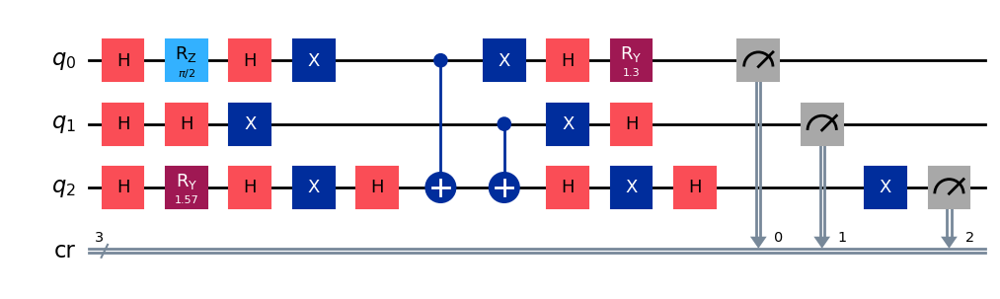

gen = 0 , Best fitness = (0.9674999999999999,)
gen = 1 , Best fitness = (0.9674999999999999,) , Number of invalids = 30

[Run 1 | Gen 14/99] Best Fitness: 0.9675 | Fidelity: 0.6009 | Gates: 29


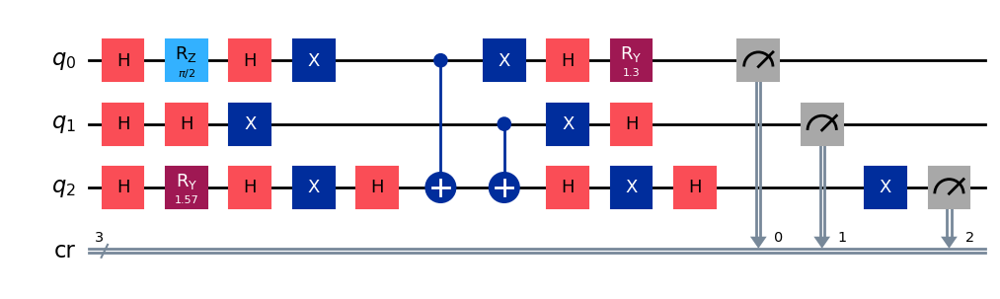

gen = 0 , Best fitness = (0.9674999999999999,)
gen = 1 , Best fitness = (0.9674999999999999,) , Number of invalids = 25

[Run 1 | Gen 15/99] Best Fitness: 0.9675 | Fidelity: 0.6005 | Gates: 29


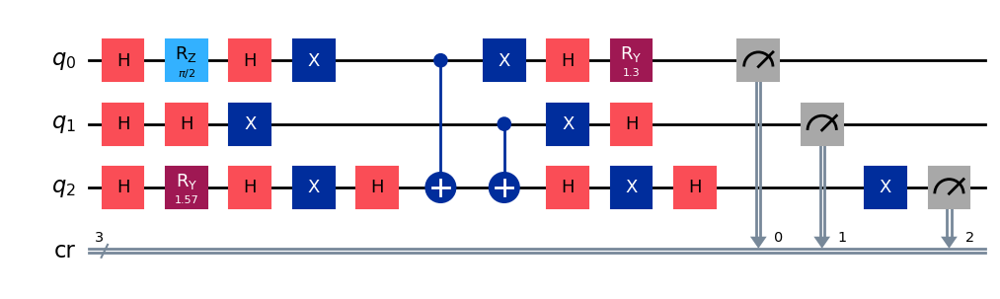

gen = 0 , Best fitness = (0.9674999999999999,)
gen = 1 , Best fitness = (0.9674999999999999,) , Number of invalids = 23

[Run 1 | Gen 16/99] Best Fitness: 0.9675 | Fidelity: 0.6108 | Gates: 29


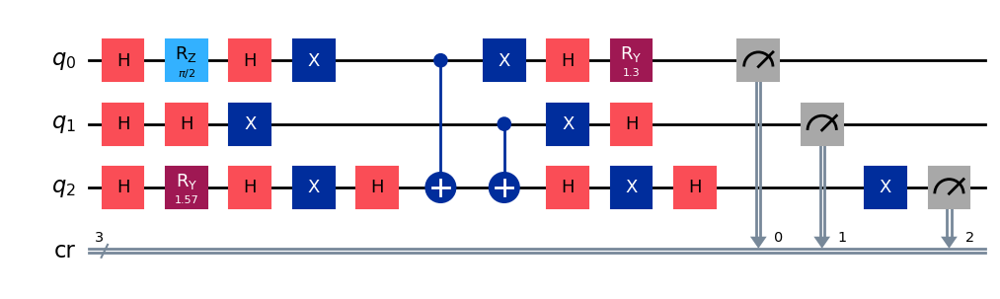

gen = 0 , Best fitness = (0.9674999999999999,)
gen = 1 , Best fitness = (0.948,) , Number of invalids = 19

[Run 1 | Gen 17/99] Best Fitness: 0.9480 | Fidelity: 0.6564 | Gates: 30


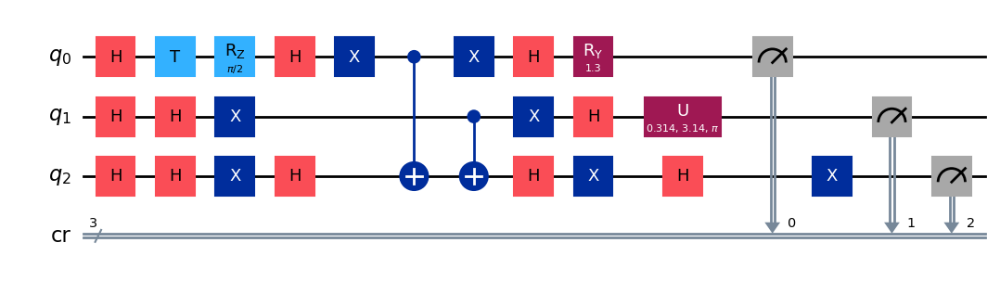

gen = 0 , Best fitness = (0.948,)
gen = 1 , Best fitness = (0.948,) , Number of invalids = 21

[Run 1 | Gen 18/99] Best Fitness: 0.9480 | Fidelity: 0.6632 | Gates: 30


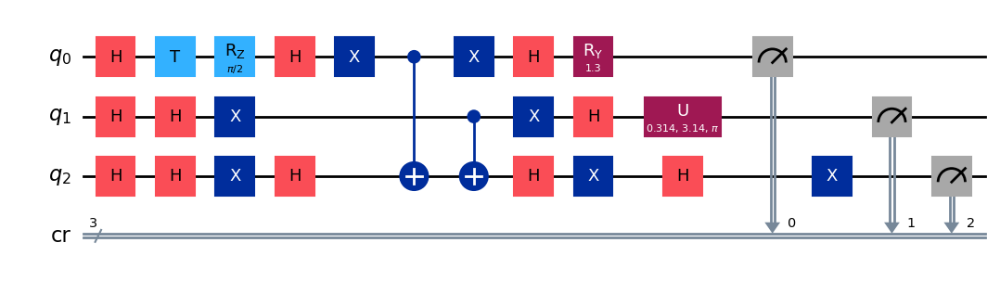

gen = 0 , Best fitness = (0.948,)
gen = 1 , Best fitness = (0.948,) , Number of invalids = 15

[Run 1 | Gen 19/99] Best Fitness: 0.9480 | Fidelity: 0.6564 | Gates: 30


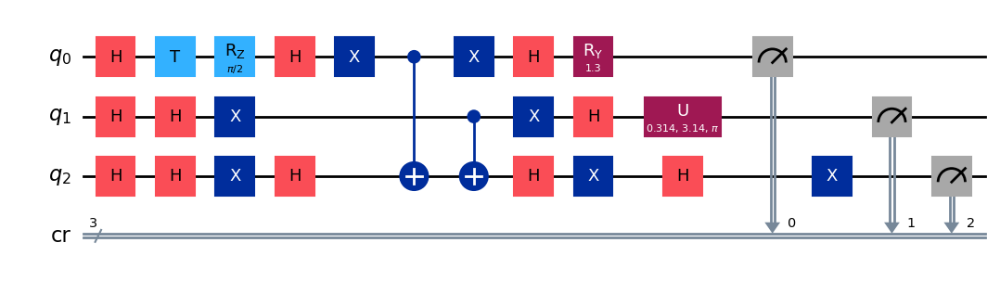

gen = 0 , Best fitness = (0.948,)
gen = 1 , Best fitness = (0.9478,) , Number of invalids = 11

[Run 1 | Gen 20/99] Best Fitness: 0.9478 | Fidelity: 0.6645 | Gates: 30


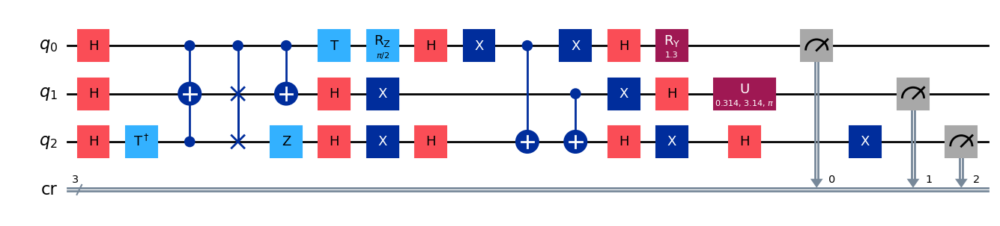

gen = 0 , Best fitness = (0.9478,)
gen = 1 , Best fitness = (0.938,) , Number of invalids = 10

[Run 1 | Gen 21/99] Best Fitness: 0.9380 | Fidelity: 0.6646 | Gates: 30


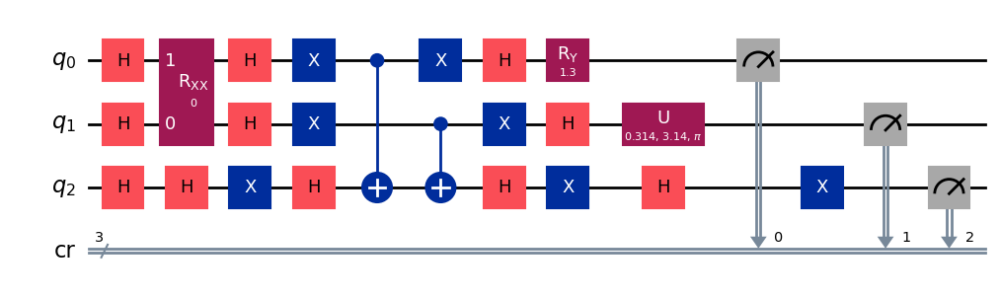

gen = 0 , Best fitness = (0.938,)
gen = 1 , Best fitness = (0.9310999999999999,) , Number of invalids = 10

[Run 1 | Gen 22/99] Best Fitness: 0.9311 | Fidelity: 0.6547 | Gates: 30


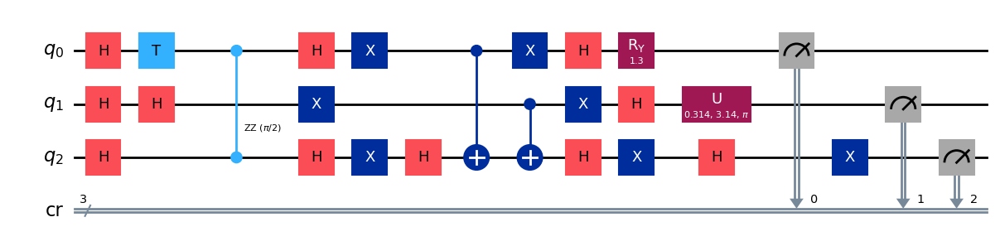

gen = 0 , Best fitness = (0.9310999999999999,)
gen = 1 , Best fitness = (0.9310999999999999,) , Number of invalids = 5

[Run 1 | Gen 23/99] Best Fitness: 0.9311 | Fidelity: 0.6527 | Gates: 30


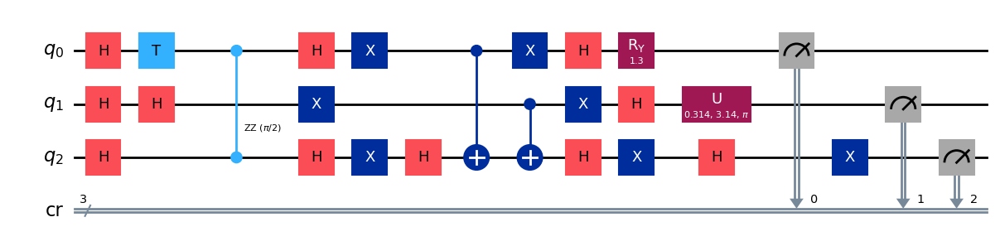

gen = 0 , Best fitness = (0.9310999999999999,)
gen = 1 , Best fitness = (0.9310999999999999,) , Number of invalids = 6

[Run 1 | Gen 24/99] Best Fitness: 0.9311 | Fidelity: 0.6500 | Gates: 30


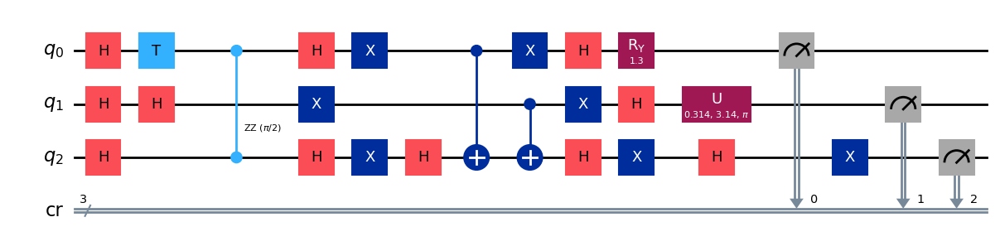

gen = 0 , Best fitness = (0.9310999999999999,)
gen = 1 , Best fitness = (0.9310999999999999,) , Number of invalids = 6

[Run 1 | Gen 25/99] Best Fitness: 0.9311 | Fidelity: 0.6602 | Gates: 30


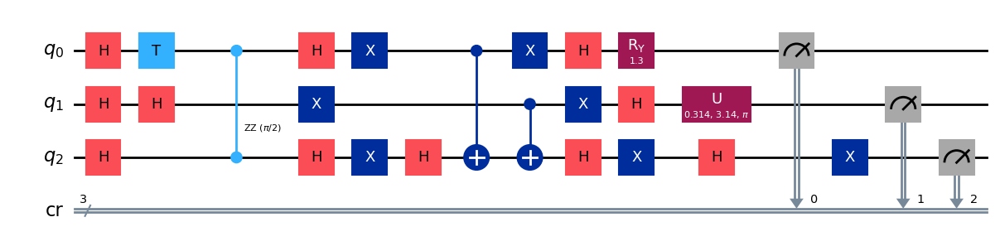

gen = 0 , Best fitness = (0.9310999999999999,)
gen = 1 , Best fitness = (0.9310999999999999,) , Number of invalids = 3

[Run 1 | Gen 26/99] Best Fitness: 0.9311 | Fidelity: 0.6545 | Gates: 30


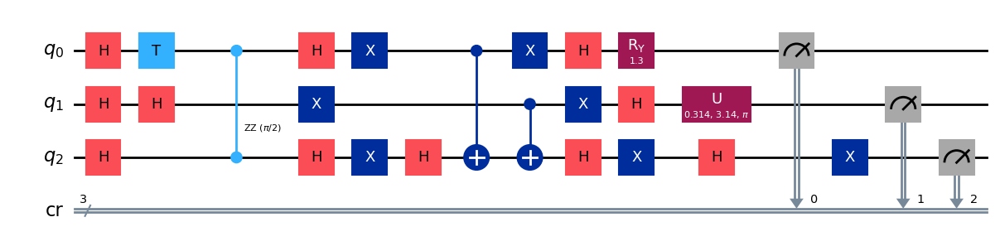

gen = 0 , Best fitness = (0.9310999999999999,)
gen = 1 , Best fitness = (0.9310999999999999,) , Number of invalids = 2

[Run 1 | Gen 27/99] Best Fitness: 0.9311 | Fidelity: 0.6619 | Gates: 30


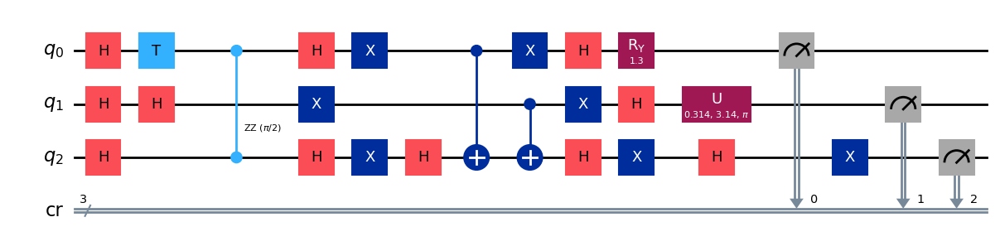

gen = 0 , Best fitness = (0.9310999999999999,)
gen = 1 , Best fitness = (0.9310999999999999,) , Number of invalids = 0

[Run 1 | Gen 28/99] Best Fitness: 0.9311 | Fidelity: 0.6678 | Gates: 30


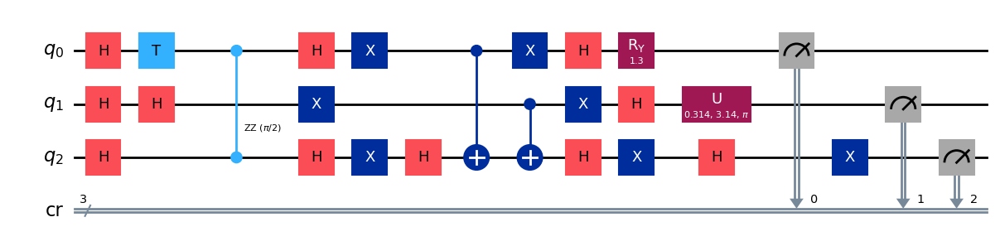

gen = 0 , Best fitness = (0.9310999999999999,)
gen = 1 , Best fitness = (0.8694,) , Number of invalids = 0

[Run 1 | Gen 29/99] Best Fitness: 0.8694 | Fidelity: 0.7173 | Gates: 30


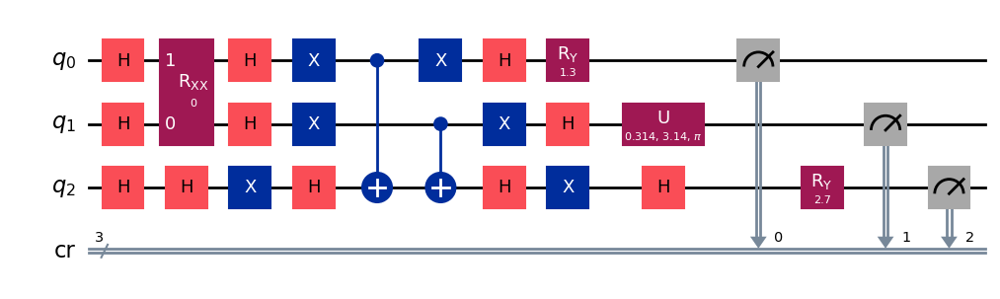

gen = 0 , Best fitness = (0.8694,)
gen = 1 , Best fitness = (0.8694,) , Number of invalids = 0

[Run 1 | Gen 30/99] Best Fitness: 0.8694 | Fidelity: 0.7124 | Gates: 30


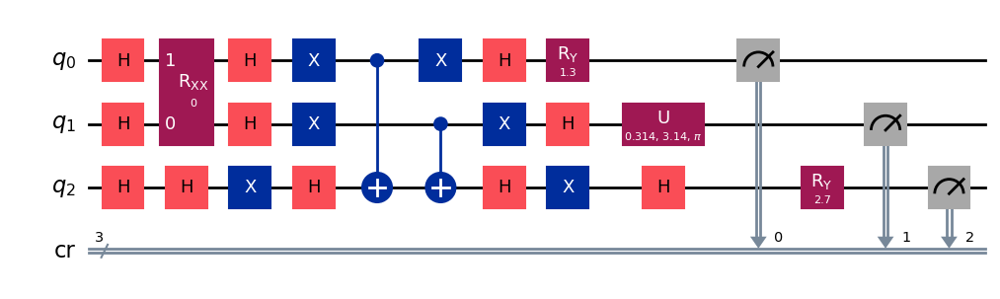

gen = 0 , Best fitness = (0.8694,)
gen = 1 , Best fitness = (0.8694,) , Number of invalids = 0

[Run 1 | Gen 31/99] Best Fitness: 0.8694 | Fidelity: 0.7225 | Gates: 30


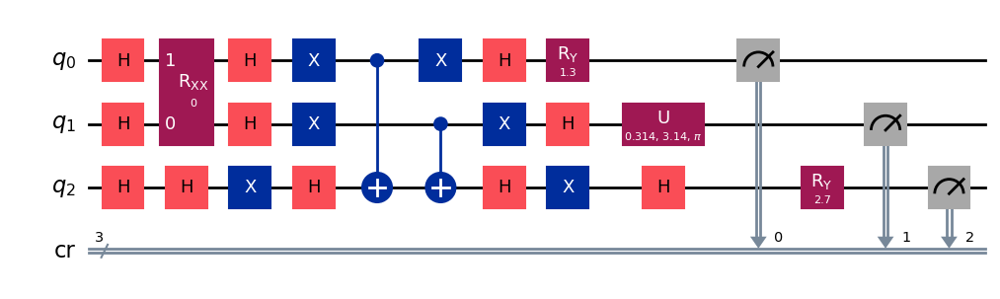

gen = 0 , Best fitness = (0.8694,)
gen = 1 , Best fitness = (0.8694,) , Number of invalids = 0

[Run 1 | Gen 32/99] Best Fitness: 0.8694 | Fidelity: 0.7161 | Gates: 30


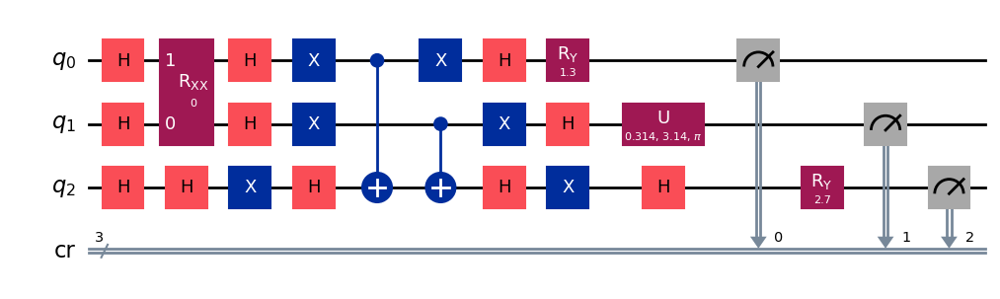

gen = 0 , Best fitness = (0.8694,)
gen = 1 , Best fitness = (0.8694,) , Number of invalids = 1

[Run 1 | Gen 33/99] Best Fitness: 0.8694 | Fidelity: 0.7118 | Gates: 30


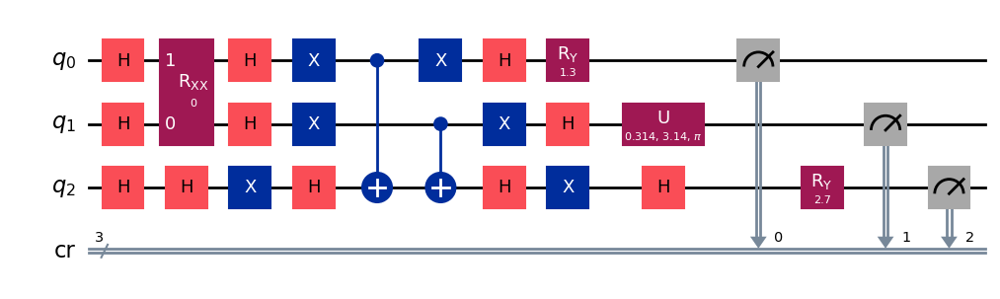

gen = 0 , Best fitness = (0.8694,)
gen = 1 , Best fitness = (0.8694,) , Number of invalids = 0

[Run 1 | Gen 34/99] Best Fitness: 0.8694 | Fidelity: 0.7146 | Gates: 30


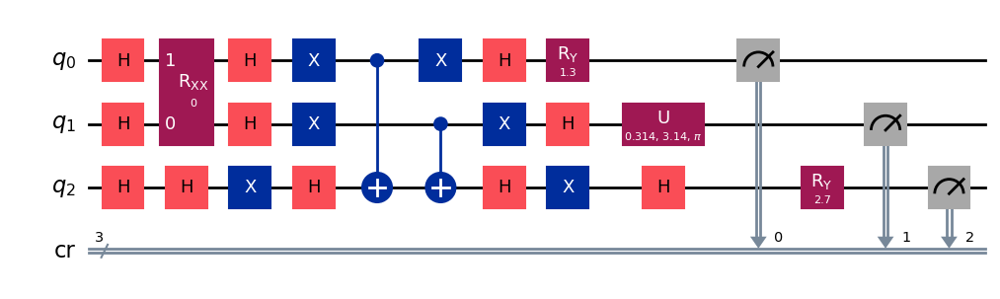

gen = 0 , Best fitness = (0.8694,)
gen = 1 , Best fitness = (0.8694,) , Number of invalids = 1

[Run 1 | Gen 35/99] Best Fitness: 0.8694 | Fidelity: 0.7176 | Gates: 30


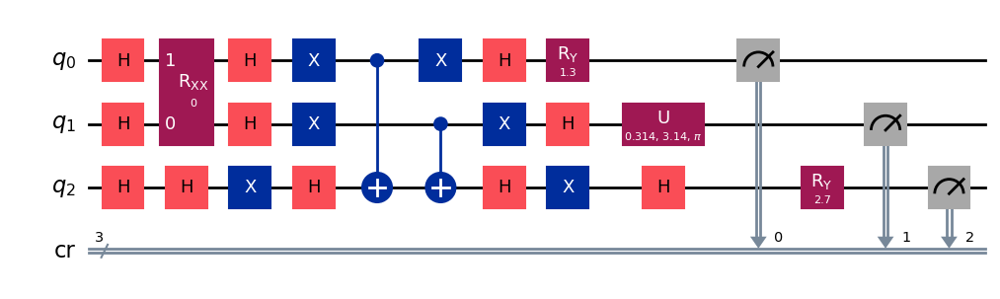

gen = 0 , Best fitness = (0.8694,)
gen = 1 , Best fitness = (0.8694,) , Number of invalids = 2

[Run 1 | Gen 36/99] Best Fitness: 0.8694 | Fidelity: 0.7146 | Gates: 30


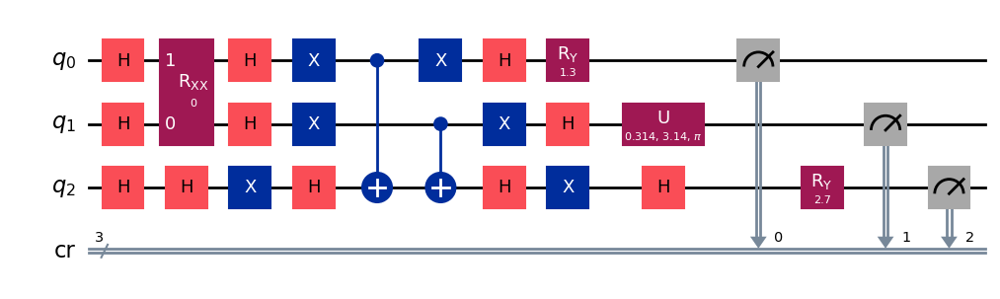

gen = 0 , Best fitness = (0.8694,)
gen = 1 , Best fitness = (0.8407,) , Number of invalids = 1

[Run 1 | Gen 37/99] Best Fitness: 0.8407 | Fidelity: 0.7677 | Gates: 30


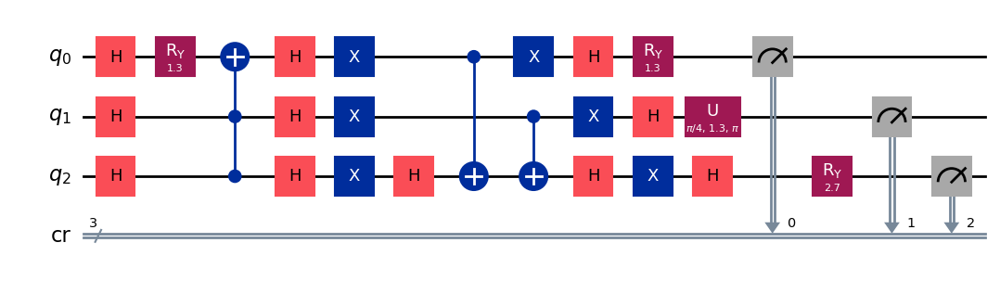

gen = 0 , Best fitness = (0.8407,)
gen = 1 , Best fitness = (0.8375,) , Number of invalids = 1

[Run 1 | Gen 38/99] Best Fitness: 0.8375 | Fidelity: 0.7656 | Gates: 30


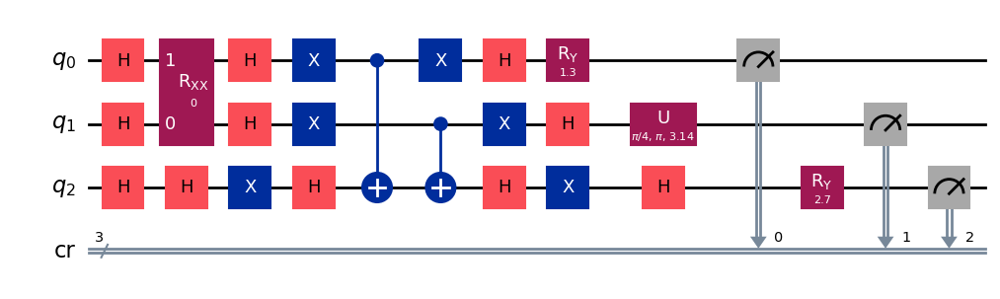

gen = 0 , Best fitness = (0.8375,)
gen = 1 , Best fitness = (0.8314,) , Number of invalids = 0

[Run 1 | Gen 39/99] Best Fitness: 0.8314 | Fidelity: 0.7573 | Gates: 30


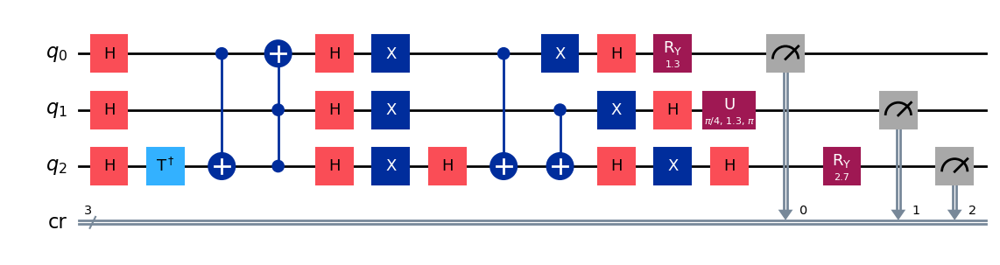

gen = 0 , Best fitness = (0.8314,)
gen = 1 , Best fitness = (0.8314,) , Number of invalids = 1

[Run 1 | Gen 40/99] Best Fitness: 0.8314 | Fidelity: 0.7696 | Gates: 30


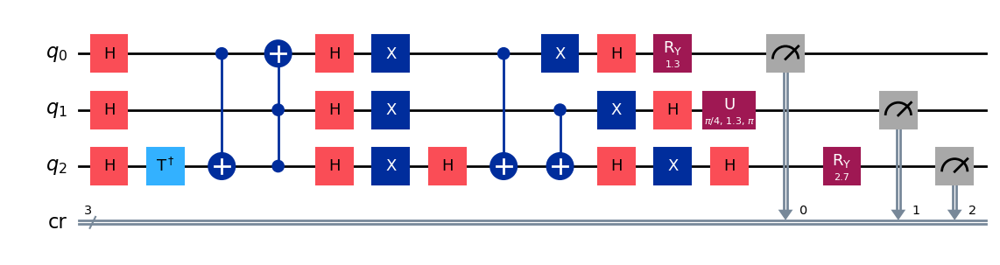

gen = 0 , Best fitness = (0.8314,)
gen = 1 , Best fitness = (0.8314,) , Number of invalids = 0

[Run 1 | Gen 41/99] Best Fitness: 0.8314 | Fidelity: 0.7623 | Gates: 30


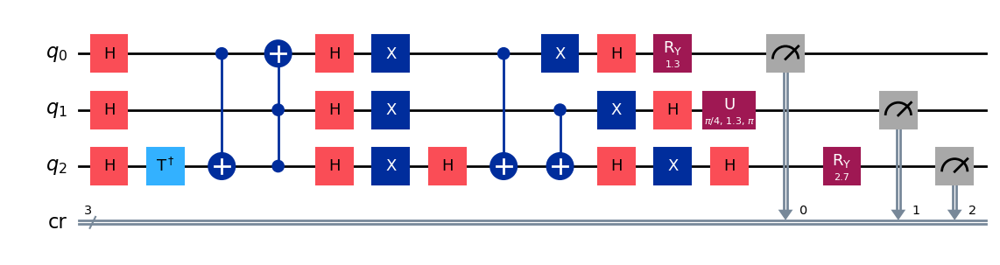

gen = 0 , Best fitness = (0.8314,)
gen = 1 , Best fitness = (0.8314,) , Number of invalids = 0

[Run 1 | Gen 42/99] Best Fitness: 0.8314 | Fidelity: 0.7632 | Gates: 30


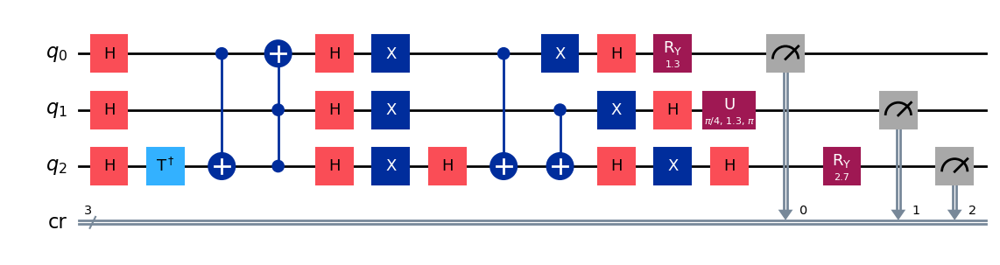

gen = 0 , Best fitness = (0.8314,)
gen = 1 , Best fitness = (0.8314,) , Number of invalids = 0

[Run 1 | Gen 43/99] Best Fitness: 0.8314 | Fidelity: 0.7609 | Gates: 30


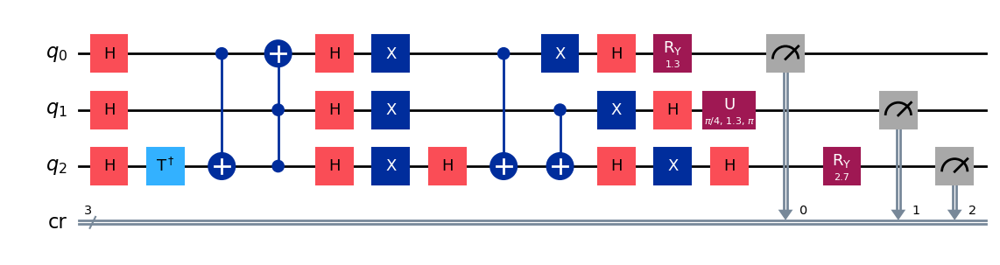

gen = 0 , Best fitness = (0.8314,)
gen = 1 , Best fitness = (0.8314,) , Number of invalids = 0

[Run 1 | Gen 44/99] Best Fitness: 0.8314 | Fidelity: 0.7660 | Gates: 30


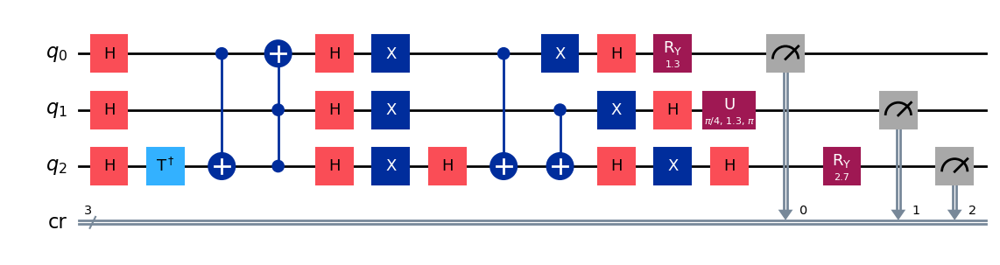

gen = 0 , Best fitness = (0.8314,)
gen = 1 , Best fitness = (0.8314,) , Number of invalids = 0

[Run 1 | Gen 45/99] Best Fitness: 0.8314 | Fidelity: 0.7572 | Gates: 30


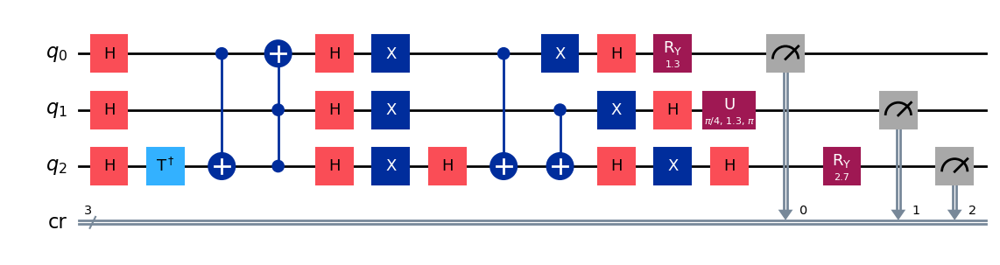

gen = 0 , Best fitness = (0.8314,)
gen = 1 , Best fitness = (0.8314,) , Number of invalids = 0

[Run 1 | Gen 46/99] Best Fitness: 0.8314 | Fidelity: 0.7657 | Gates: 30


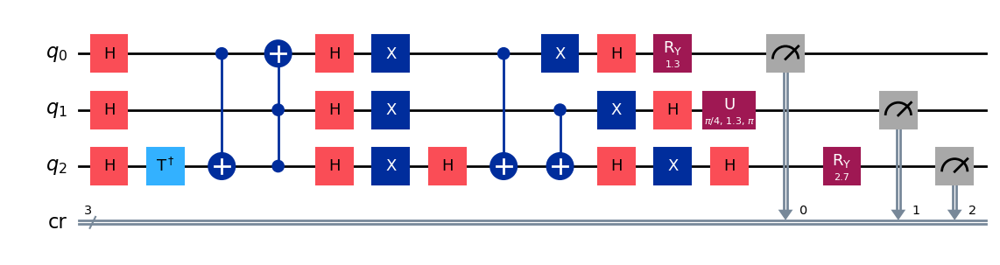

gen = 0 , Best fitness = (0.8314,)
gen = 1 , Best fitness = (0.8314,) , Number of invalids = 0

[Run 1 | Gen 47/99] Best Fitness: 0.8314 | Fidelity: 0.7533 | Gates: 30


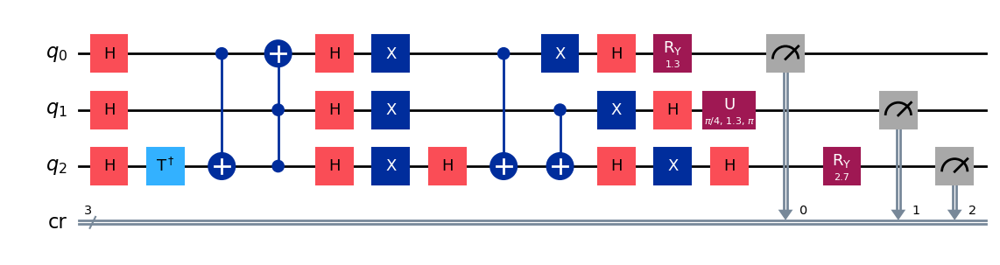

gen = 0 , Best fitness = (0.8314,)
gen = 1 , Best fitness = (0.8314,) , Number of invalids = 0

[Run 1 | Gen 48/99] Best Fitness: 0.8314 | Fidelity: 0.7623 | Gates: 30


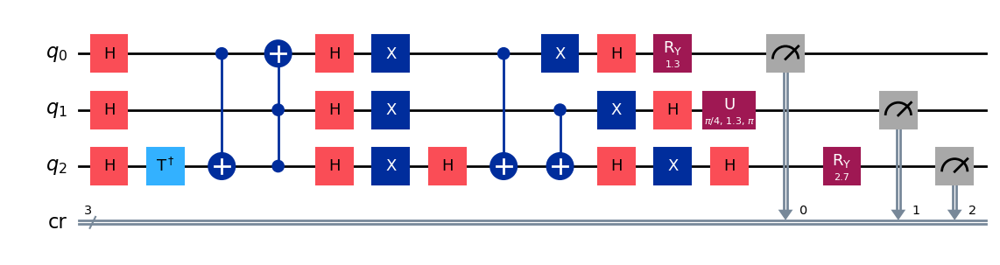

gen = 0 , Best fitness = (0.8314,)
gen = 1 , Best fitness = (0.8282999999999999,) , Number of invalids = 0

[Run 1 | Gen 49/99] Best Fitness: 0.8283 | Fidelity: 0.7571 | Gates: 30


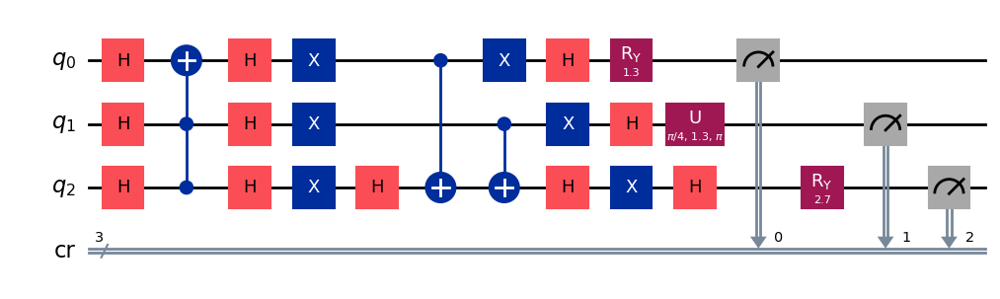

gen = 0 , Best fitness = (0.8282999999999999,)
gen = 1 , Best fitness = (0.8282999999999999,) , Number of invalids = 0

[Run 1 | Gen 50/99] Best Fitness: 0.8283 | Fidelity: 0.7504 | Gates: 30


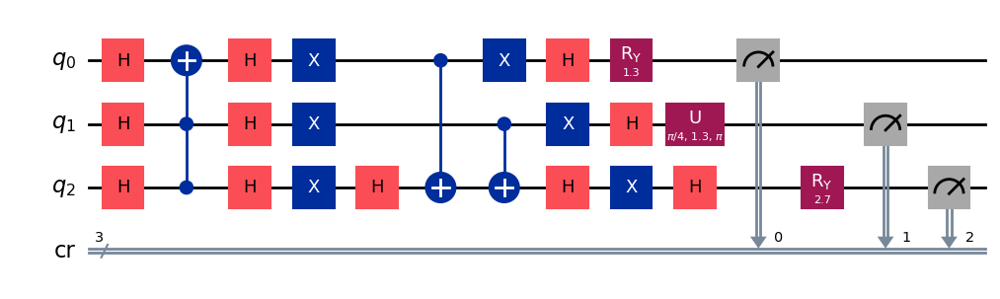

gen = 0 , Best fitness = (0.8282999999999999,)
gen = 1 , Best fitness = (0.8282999999999999,) , Number of invalids = 0

[Run 1 | Gen 51/99] Best Fitness: 0.8283 | Fidelity: 0.7573 | Gates: 30


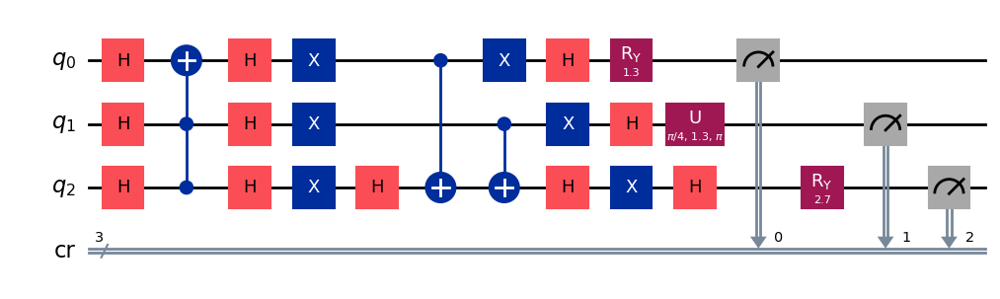

gen = 0 , Best fitness = (0.8282999999999999,)
gen = 1 , Best fitness = (0.8282999999999999,) , Number of invalids = 0

[Run 1 | Gen 52/99] Best Fitness: 0.8283 | Fidelity: 0.7621 | Gates: 30


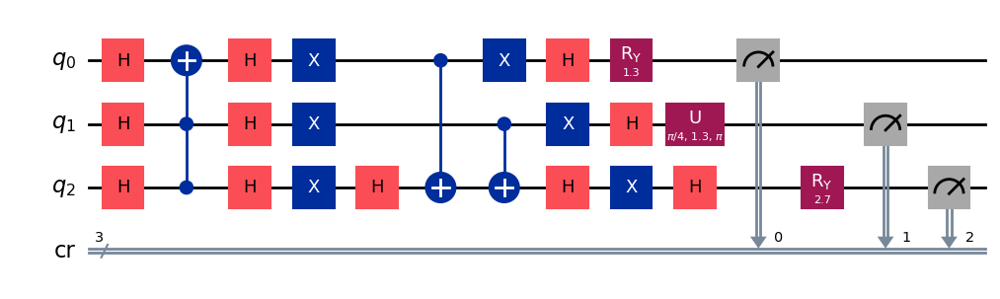

gen = 0 , Best fitness = (0.8282999999999999,)
gen = 1 , Best fitness = (0.8282999999999999,) , Number of invalids = 0

[Run 1 | Gen 53/99] Best Fitness: 0.8283 | Fidelity: 0.7623 | Gates: 30


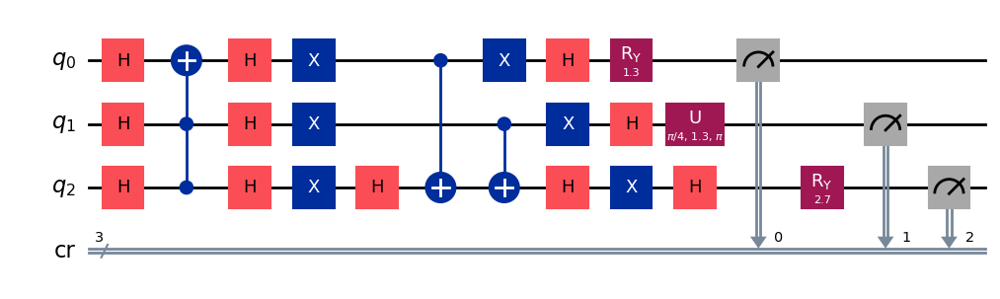

gen = 0 , Best fitness = (0.8282999999999999,)
gen = 1 , Best fitness = (0.8282999999999999,) , Number of invalids = 0

[Run 1 | Gen 54/99] Best Fitness: 0.8283 | Fidelity: 0.7623 | Gates: 30


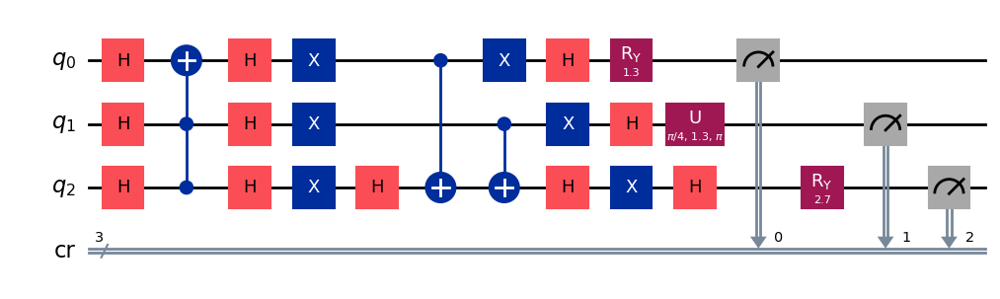

gen = 0 , Best fitness = (0.8282999999999999,)
gen = 1 , Best fitness = (0.8282999999999999,) , Number of invalids = 0

[Run 1 | Gen 55/99] Best Fitness: 0.8283 | Fidelity: 0.7640 | Gates: 30


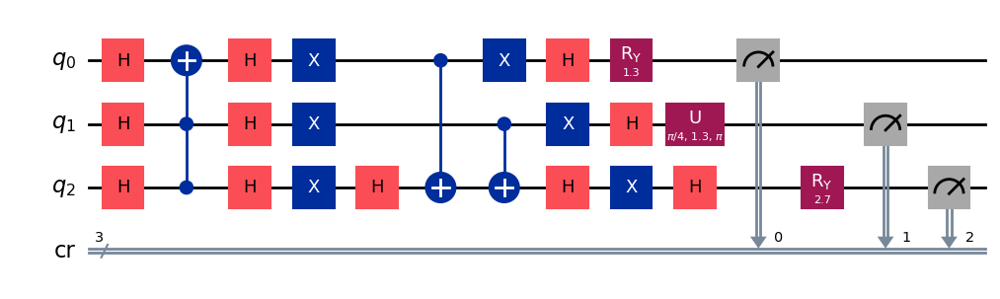

gen = 0 , Best fitness = (0.8282999999999999,)
gen = 1 , Best fitness = (0.8282999999999999,) , Number of invalids = 0

[Run 1 | Gen 56/99] Best Fitness: 0.8283 | Fidelity: 0.7684 | Gates: 30


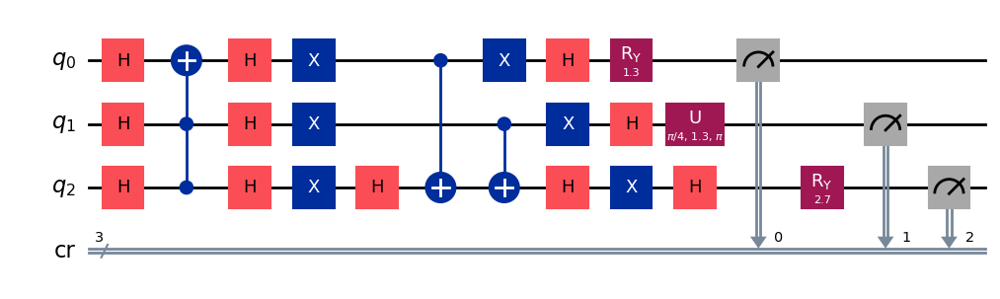

gen = 0 , Best fitness = (0.8282999999999999,)
gen = 1 , Best fitness = (0.8095,) , Number of invalids = 0

[Run 1 | Gen 57/99] Best Fitness: 0.8095 | Fidelity: 0.8022 | Gates: 31


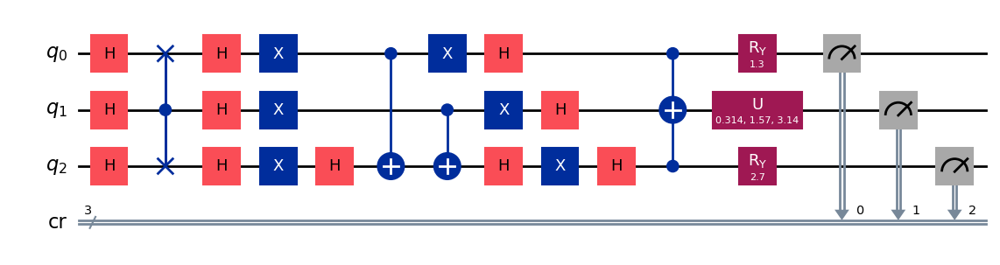

gen = 0 , Best fitness = (0.8095,)
gen = 1 , Best fitness = (0.8095,) , Number of invalids = 0

[Run 1 | Gen 58/99] Best Fitness: 0.8095 | Fidelity: 0.8035 | Gates: 31


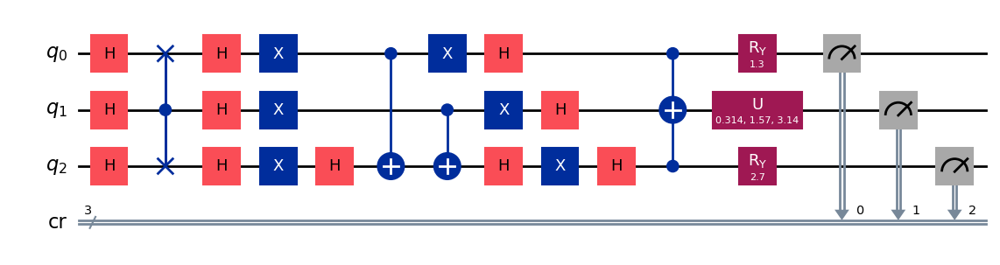

gen = 0 , Best fitness = (0.8095,)
gen = 1 , Best fitness = (0.8095,) , Number of invalids = 0

[Run 1 | Gen 59/99] Best Fitness: 0.8095 | Fidelity: 0.8047 | Gates: 31


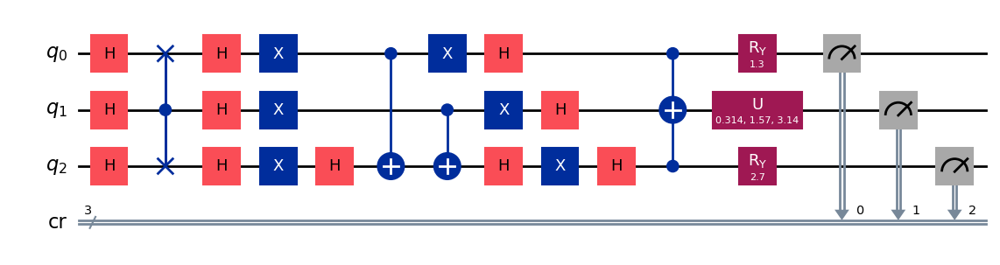

gen = 0 , Best fitness = (0.8095,)
gen = 1 , Best fitness = (0.8095,) , Number of invalids = 0

[Run 1 | Gen 60/99] Best Fitness: 0.8095 | Fidelity: 0.8082 | Gates: 31


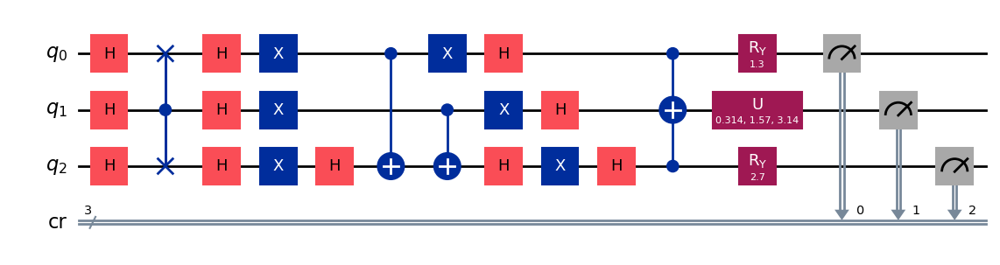

gen = 0 , Best fitness = (0.8095,)
gen = 1 , Best fitness = (0.8036,) , Number of invalids = 0

[Run 1 | Gen 61/99] Best Fitness: 0.8036 | Fidelity: 0.8183 | Gates: 31


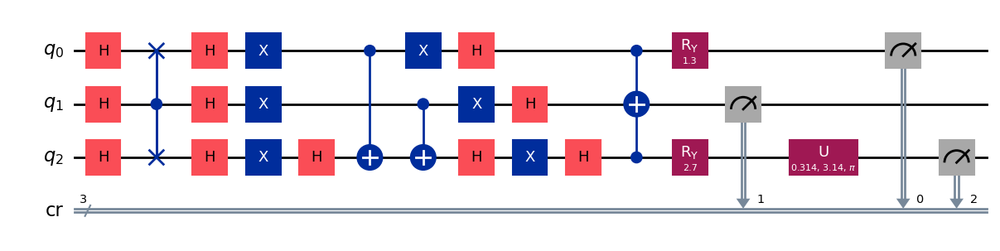

gen = 0 , Best fitness = (0.8036,)
gen = 1 , Best fitness = (0.802,) , Number of invalids = 0

[Run 1 | Gen 62/99] Best Fitness: 0.8020 | Fidelity: 0.8121 | Gates: 31


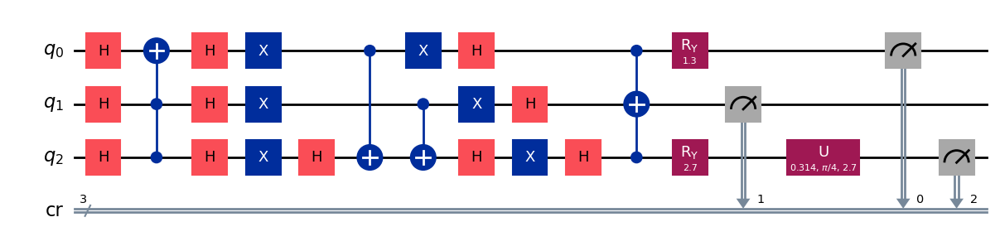

gen = 0 , Best fitness = (0.802,)
gen = 1 , Best fitness = (0.802,) , Number of invalids = 0

[Run 1 | Gen 63/99] Best Fitness: 0.8020 | Fidelity: 0.8057 | Gates: 31


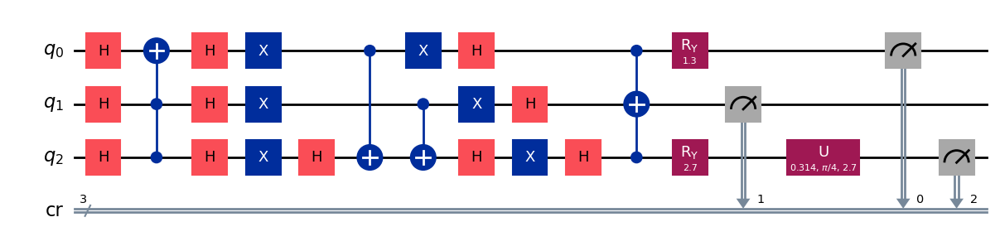

gen = 0 , Best fitness = (0.802,)
gen = 1 , Best fitness = (0.802,) , Number of invalids = 0

[Run 1 | Gen 64/99] Best Fitness: 0.8020 | Fidelity: 0.8057 | Gates: 31


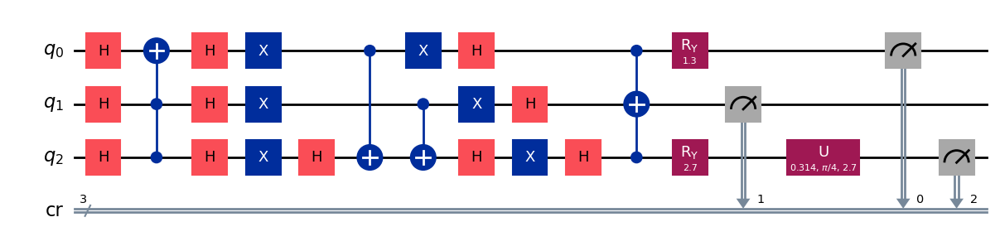

gen = 0 , Best fitness = (0.802,)
gen = 1 , Best fitness = (0.802,) , Number of invalids = 0

[Run 1 | Gen 65/99] Best Fitness: 0.8020 | Fidelity: 0.8090 | Gates: 31


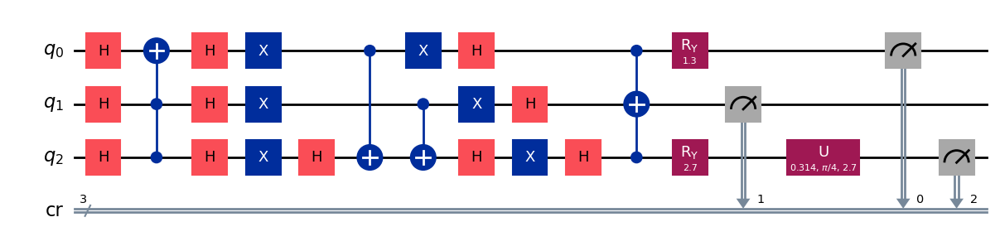

gen = 0 , Best fitness = (0.802,)
gen = 1 , Best fitness = (0.7957,) , Number of invalids = 0

[Run 1 | Gen 66/99] Best Fitness: 0.7957 | Fidelity: 0.8213 | Gates: 31


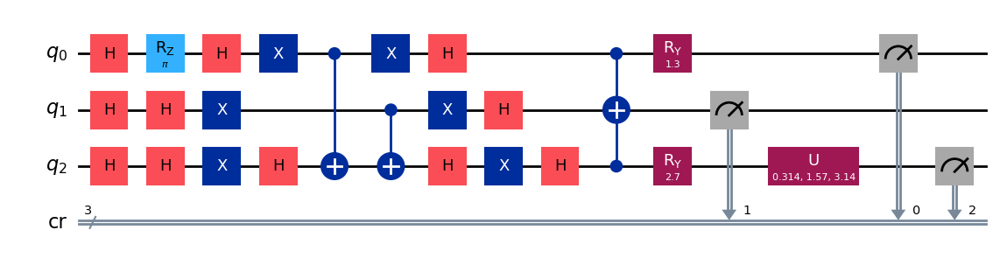

gen = 0 , Best fitness = (0.7957,)
gen = 1 , Best fitness = (0.7957,) , Number of invalids = 0

[Run 1 | Gen 67/99] Best Fitness: 0.7957 | Fidelity: 0.8181 | Gates: 31


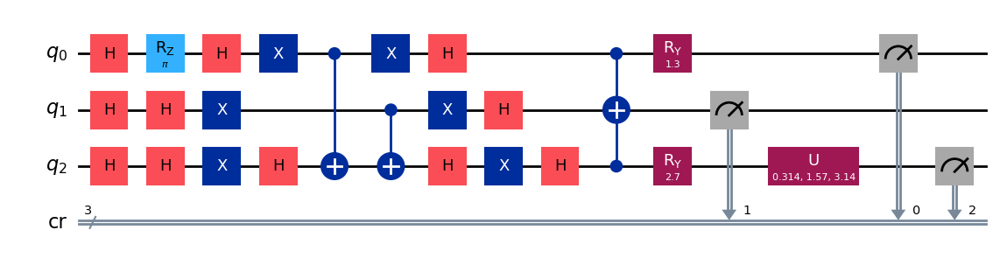

gen = 0 , Best fitness = (0.7957,)
gen = 1 , Best fitness = (0.7957,) , Number of invalids = 0

[Run 1 | Gen 68/99] Best Fitness: 0.7957 | Fidelity: 0.8218 | Gates: 31


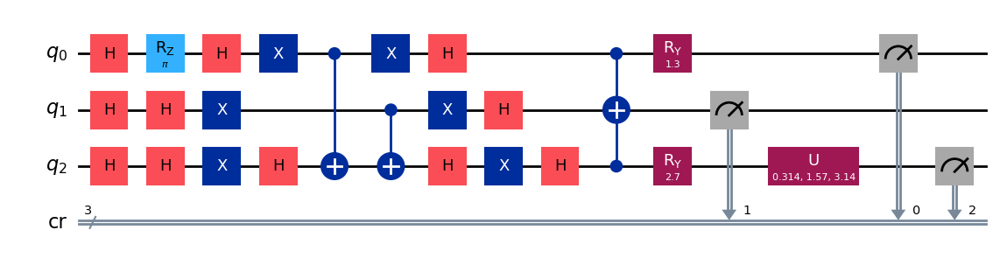

gen = 0 , Best fitness = (0.7957,)
gen = 1 , Best fitness = (0.7925,) , Number of invalids = 0

[Run 1 | Gen 69/99] Best Fitness: 0.7925 | Fidelity: 0.8233 | Gates: 31


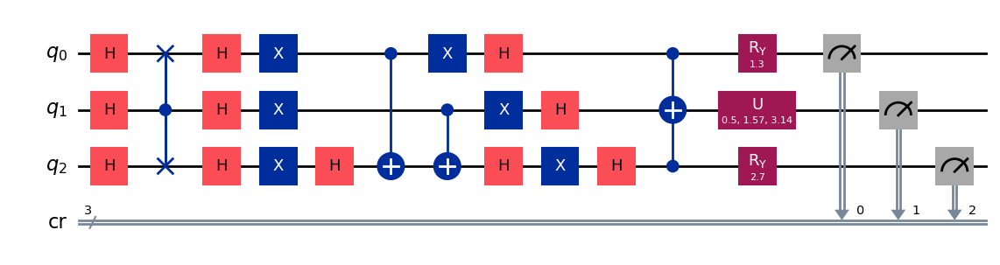

gen = 0 , Best fitness = (0.7925,)
gen = 1 , Best fitness = (0.7607,) , Number of invalids = 0

[Run 1 | Gen 70/99] Best Fitness: 0.7607 | Fidelity: 0.8570 | Gates: 31


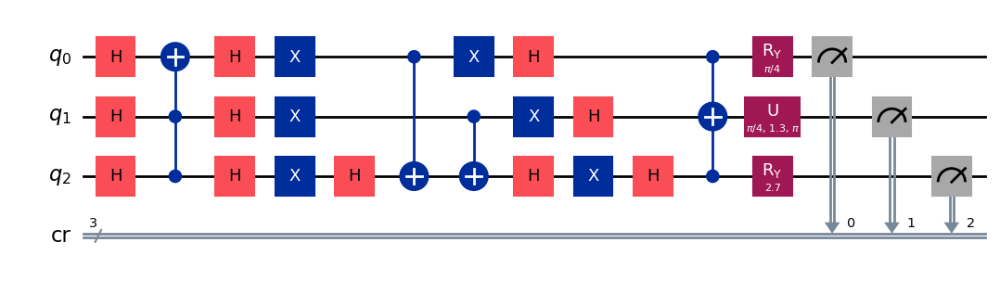

gen = 0 , Best fitness = (0.7607,)
gen = 1 , Best fitness = (0.7566,) , Number of invalids = 0

[Run 1 | Gen 71/99] Best Fitness: 0.7566 | Fidelity: 0.8602 | Gates: 31


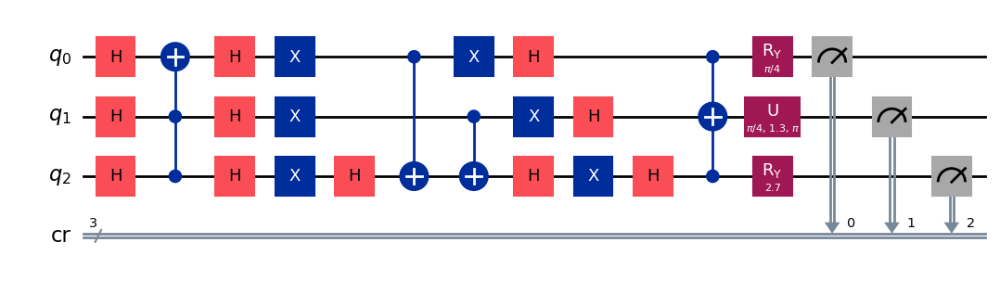

gen = 0 , Best fitness = (0.7566,)
gen = 1 , Best fitness = (0.7566,) , Number of invalids = 0

[Run 1 | Gen 72/99] Best Fitness: 0.7566 | Fidelity: 0.8585 | Gates: 31


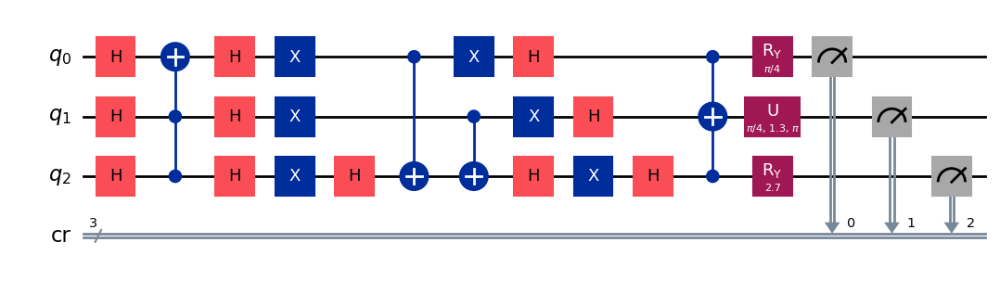

gen = 0 , Best fitness = (0.7566,)
gen = 1 , Best fitness = (0.7566,) , Number of invalids = 0

[Run 1 | Gen 73/99] Best Fitness: 0.7566 | Fidelity: 0.8587 | Gates: 31


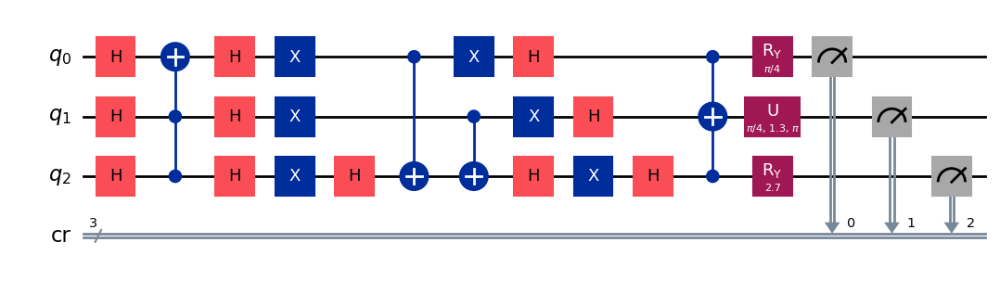

gen = 0 , Best fitness = (0.7566,)
gen = 1 , Best fitness = (0.7566,) , Number of invalids = 0

[Run 1 | Gen 74/99] Best Fitness: 0.7566 | Fidelity: 0.8553 | Gates: 31


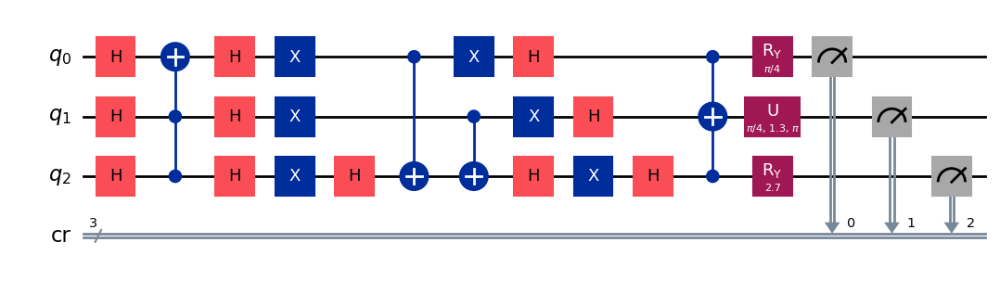

gen = 0 , Best fitness = (0.7566,)
gen = 1 , Best fitness = (0.7566,) , Number of invalids = 0

[Run 1 | Gen 75/99] Best Fitness: 0.7566 | Fidelity: 0.8574 | Gates: 31


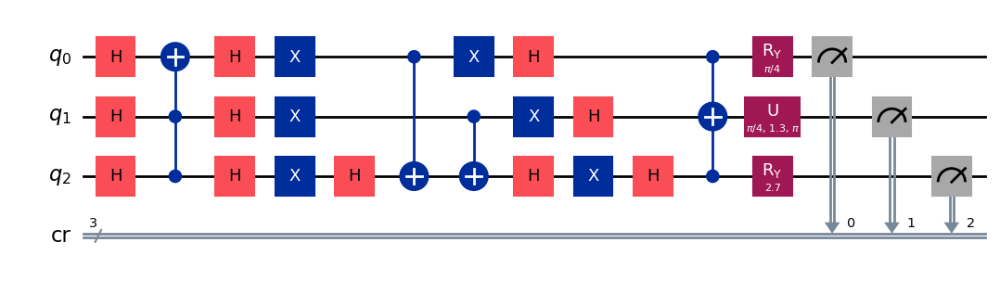

gen = 0 , Best fitness = (0.7566,)
gen = 1 , Best fitness = (0.7566,) , Number of invalids = 0

[Run 1 | Gen 76/99] Best Fitness: 0.7566 | Fidelity: 0.8530 | Gates: 31


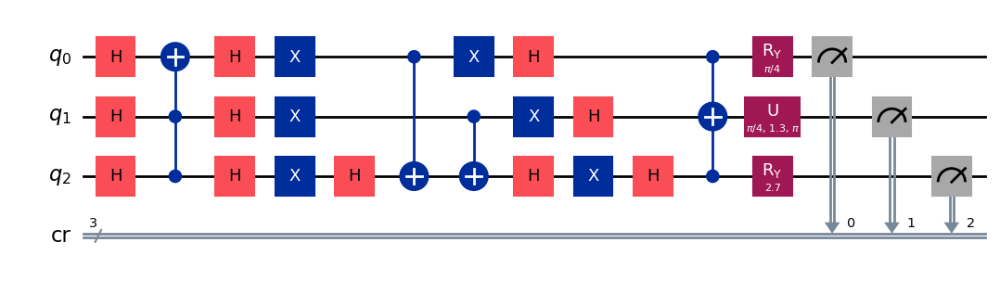

gen = 0 , Best fitness = (0.7566,)
gen = 1 , Best fitness = (0.7566,) , Number of invalids = 0

[Run 1 | Gen 77/99] Best Fitness: 0.7566 | Fidelity: 0.8634 | Gates: 31


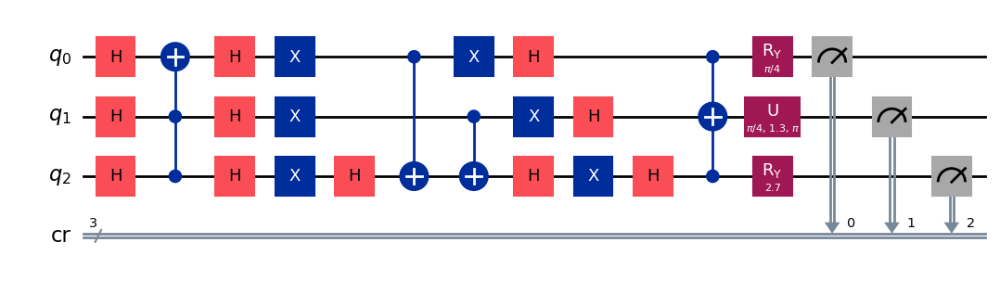

gen = 0 , Best fitness = (0.7566,)
gen = 1 , Best fitness = (0.7566,) , Number of invalids = 0

[Run 1 | Gen 78/99] Best Fitness: 0.7566 | Fidelity: 0.8554 | Gates: 31


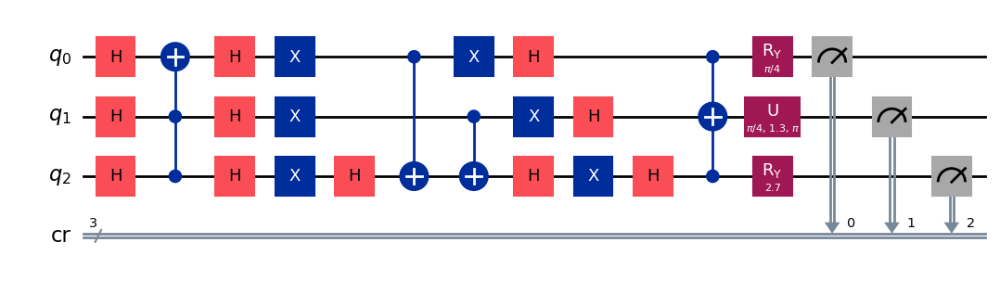

gen = 0 , Best fitness = (0.7566,)
gen = 1 , Best fitness = (0.7566,) , Number of invalids = 0

[Run 1 | Gen 79/99] Best Fitness: 0.7566 | Fidelity: 0.8523 | Gates: 31


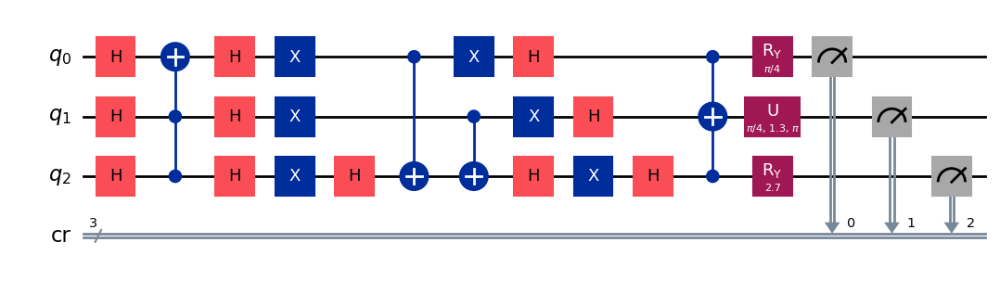

gen = 0 , Best fitness = (0.7566,)
gen = 1 , Best fitness = (0.7566,) , Number of invalids = 0

[Run 1 | Gen 80/99] Best Fitness: 0.7566 | Fidelity: 0.8531 | Gates: 31


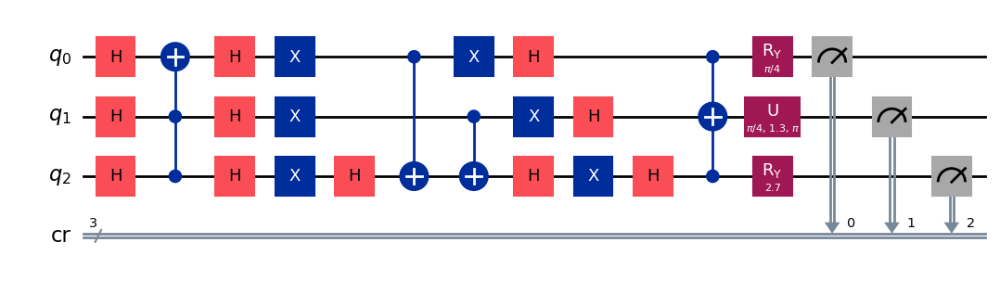

gen = 0 , Best fitness = (0.7566,)
gen = 1 , Best fitness = (0.7532,) , Number of invalids = 0

[Run 1 | Gen 81/99] Best Fitness: 0.7532 | Fidelity: 0.8577 | Gates: 31


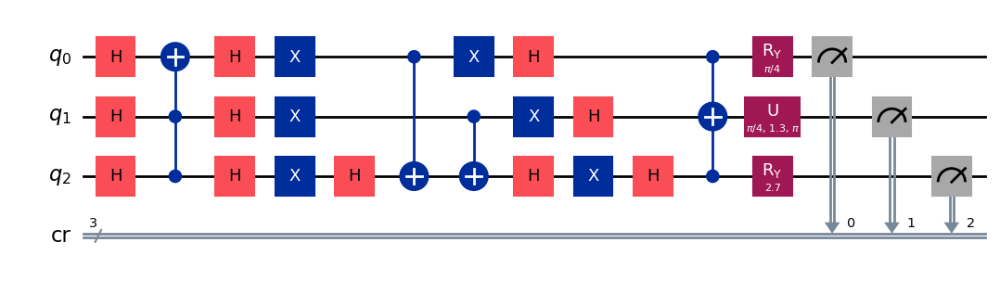

gen = 0 , Best fitness = (0.7532,)
gen = 1 , Best fitness = (0.7532,) , Number of invalids = 0

[Run 1 | Gen 82/99] Best Fitness: 0.7532 | Fidelity: 0.8553 | Gates: 31


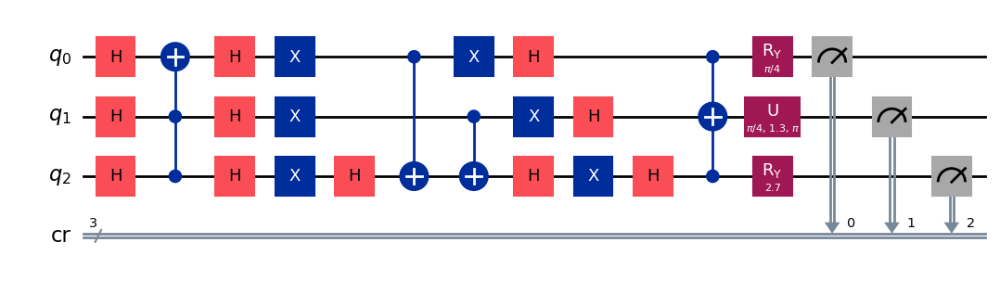

gen = 0 , Best fitness = (0.7532,)
gen = 1 , Best fitness = (0.7532,) , Number of invalids = 0

[Run 1 | Gen 83/99] Best Fitness: 0.7532 | Fidelity: 0.8555 | Gates: 31


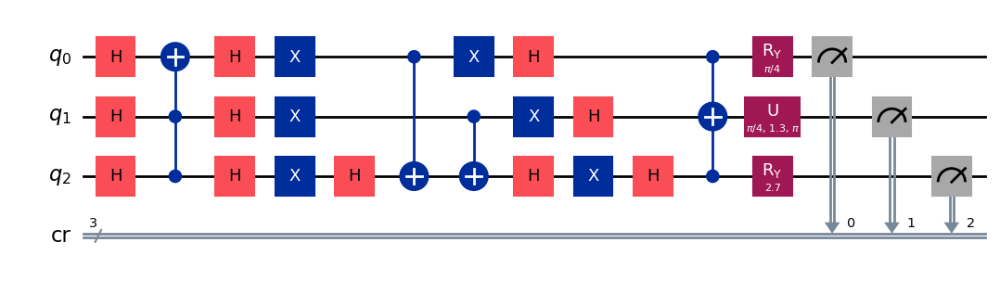

gen = 0 , Best fitness = (0.7532,)
gen = 1 , Best fitness = (0.7532,) , Number of invalids = 0

[Run 1 | Gen 84/99] Best Fitness: 0.7532 | Fidelity: 0.8610 | Gates: 31


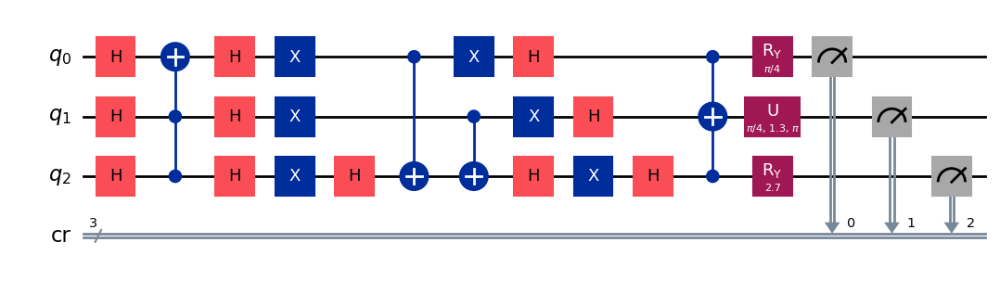

gen = 0 , Best fitness = (0.7532,)
gen = 1 , Best fitness = (0.7532,) , Number of invalids = 0

[Run 1 | Gen 85/99] Best Fitness: 0.7532 | Fidelity: 0.8597 | Gates: 31


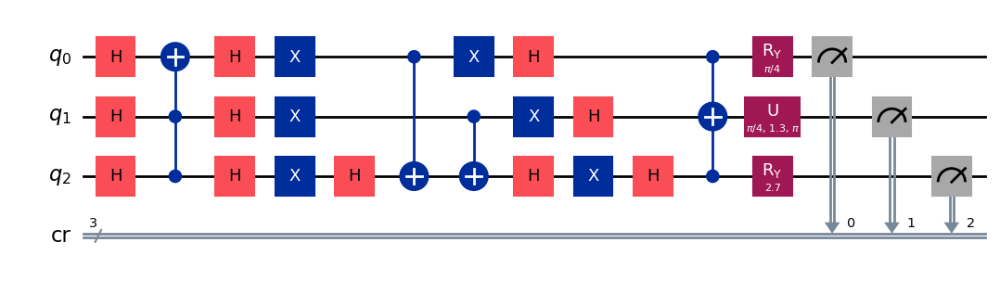

gen = 0 , Best fitness = (0.7532,)
gen = 1 , Best fitness = (0.7532,) , Number of invalids = 0

[Run 1 | Gen 86/99] Best Fitness: 0.7532 | Fidelity: 0.8562 | Gates: 31


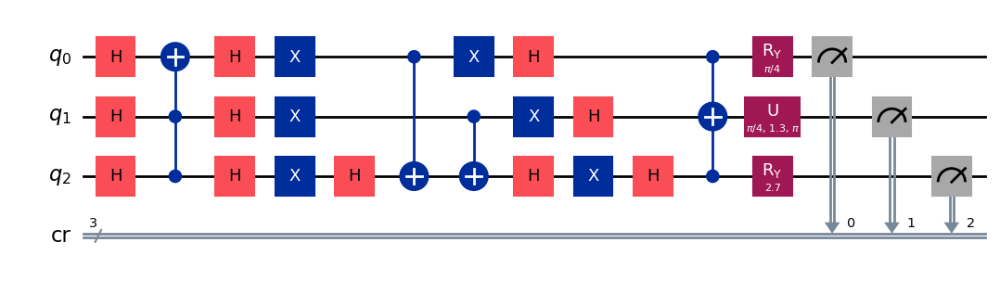

gen = 0 , Best fitness = (0.7532,)
gen = 1 , Best fitness = (0.7532,) , Number of invalids = 0

[Run 1 | Gen 87/99] Best Fitness: 0.7532 | Fidelity: 0.8624 | Gates: 31


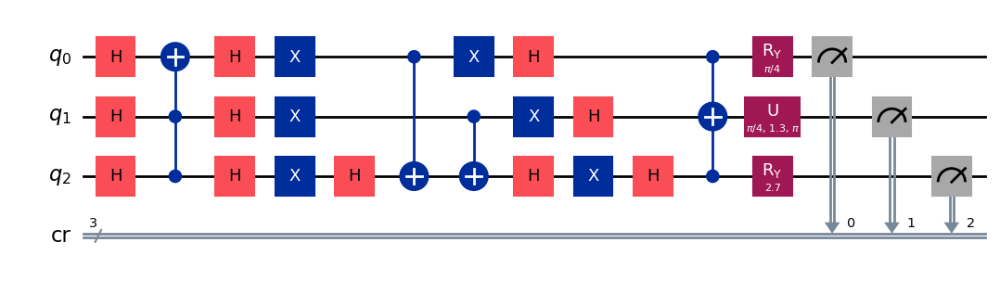

gen = 0 , Best fitness = (0.7532,)
gen = 1 , Best fitness = (0.7532,) , Number of invalids = 0

[Run 1 | Gen 88/99] Best Fitness: 0.7532 | Fidelity: 0.8579 | Gates: 31


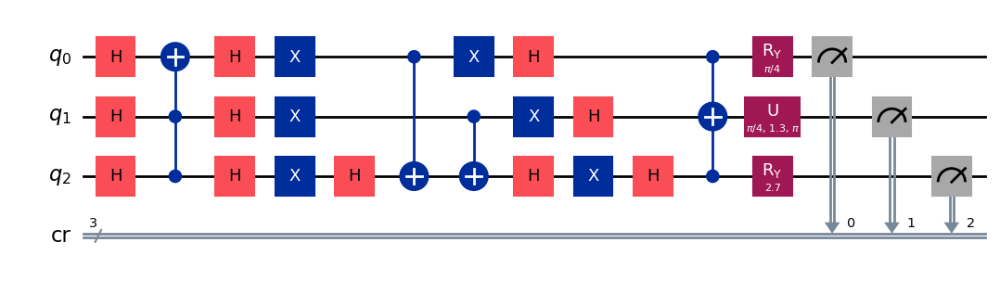

gen = 0 , Best fitness = (0.7532,)
gen = 1 , Best fitness = (0.7532,) , Number of invalids = 0

[Run 1 | Gen 89/99] Best Fitness: 0.7532 | Fidelity: 0.8627 | Gates: 31


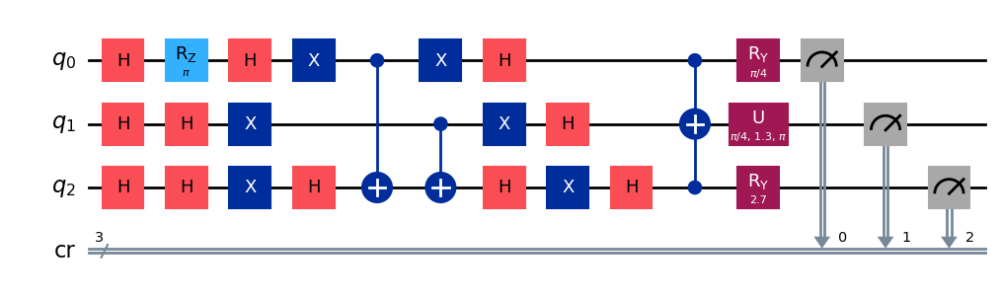

gen = 0 , Best fitness = (0.7532,)
gen = 1 , Best fitness = (0.7532,) , Number of invalids = 0

[Run 1 | Gen 90/99] Best Fitness: 0.7532 | Fidelity: 0.8603 | Gates: 31


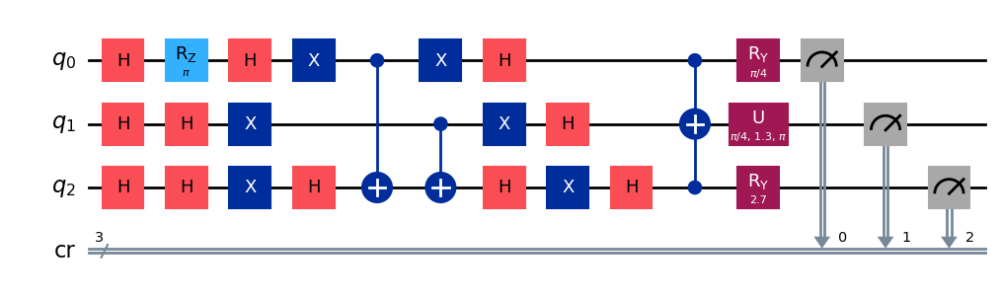

gen = 0 , Best fitness = (0.7532,)
gen = 1 , Best fitness = (0.7532,) , Number of invalids = 0

[Run 1 | Gen 91/99] Best Fitness: 0.7532 | Fidelity: 0.8581 | Gates: 31


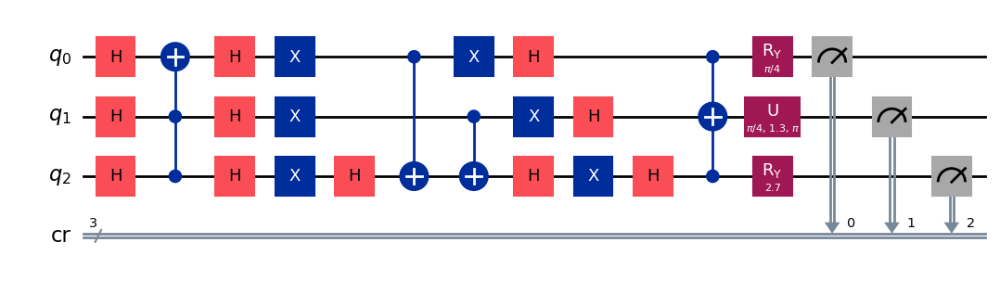

gen = 0 , Best fitness = (0.7532,)
gen = 1 , Best fitness = (0.7532,) , Number of invalids = 0

[Run 1 | Gen 92/99] Best Fitness: 0.7532 | Fidelity: 0.8533 | Gates: 31


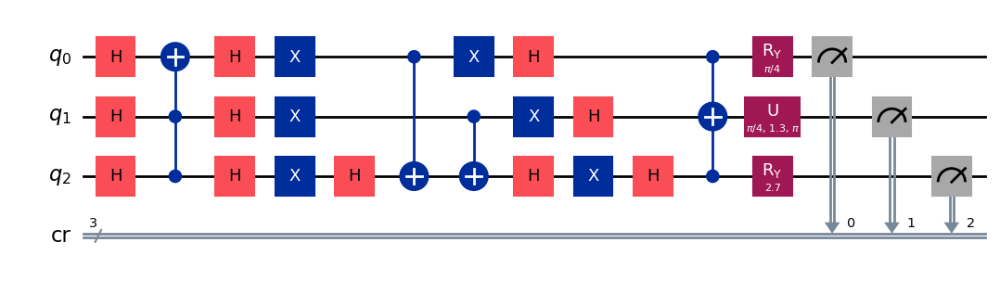

gen = 0 , Best fitness = (0.7532,)
gen = 1 , Best fitness = (0.7514,) , Number of invalids = 0

[Run 1 | Gen 93/99] Best Fitness: 0.7514 | Fidelity: 0.8588 | Gates: 31


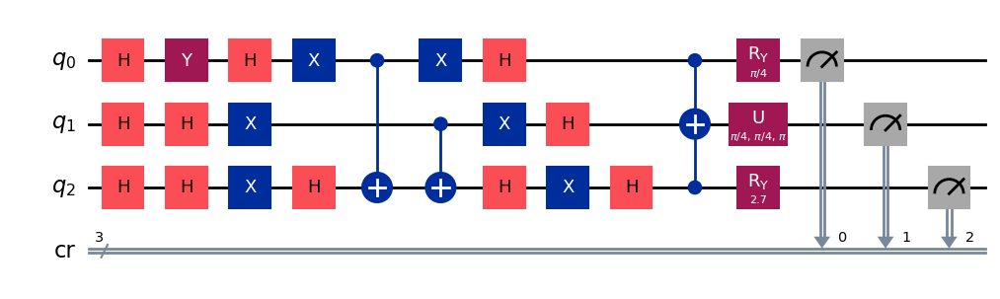

gen = 0 , Best fitness = (0.7514,)
gen = 1 , Best fitness = (0.7514,) , Number of invalids = 0

[Run 1 | Gen 94/99] Best Fitness: 0.7514 | Fidelity: 0.8567 | Gates: 31


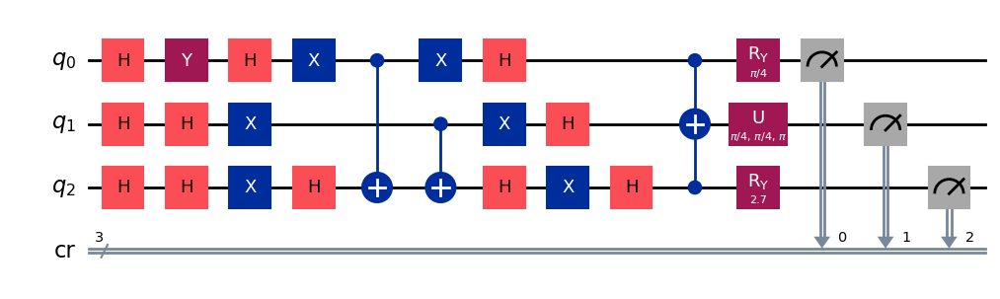

gen = 0 , Best fitness = (0.7514,)
gen = 1 , Best fitness = (0.7506,) , Number of invalids = 0

[Run 1 | Gen 95/99] Best Fitness: 0.7506 | Fidelity: 0.8898 | Gates: 32


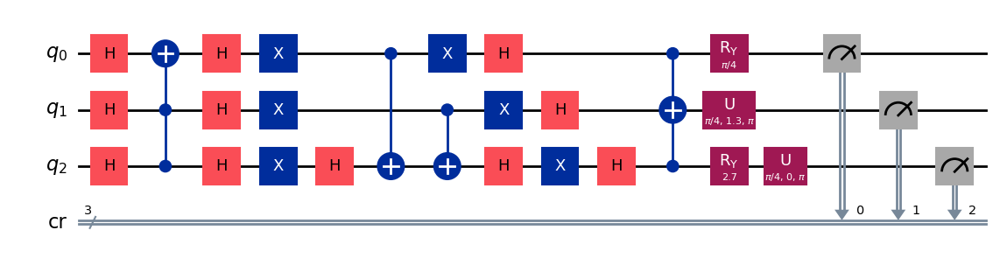

gen = 0 , Best fitness = (0.7506,)
gen = 1 , Best fitness = (0.7506,) , Number of invalids = 0

[Run 1 | Gen 96/99] Best Fitness: 0.7506 | Fidelity: 0.8909 | Gates: 32


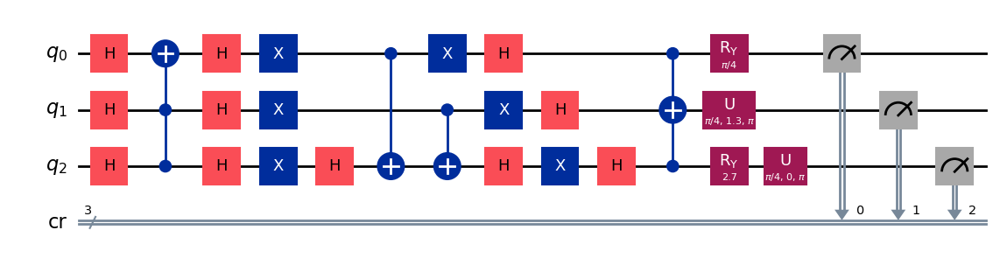

gen = 0 , Best fitness = (0.7506,)
gen = 1 , Best fitness = (0.7506,) , Number of invalids = 0

[Run 1 | Gen 97/99] Best Fitness: 0.7506 | Fidelity: 0.8924 | Gates: 32


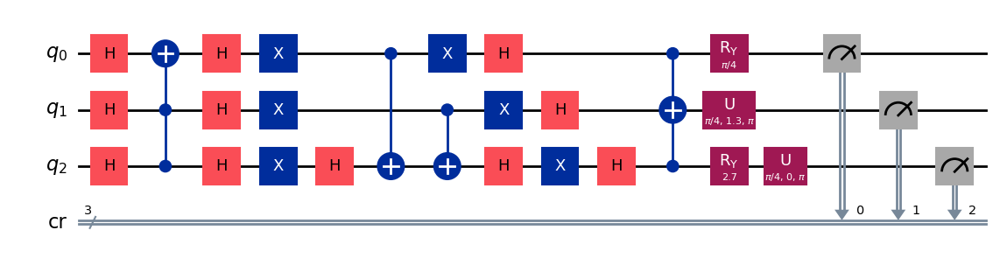

gen = 0 , Best fitness = (0.7506,)
gen = 1 , Best fitness = (0.7506,) , Number of invalids = 0

[Run 1 | Gen 98/99] Best Fitness: 0.7506 | Fidelity: 0.8876 | Gates: 32


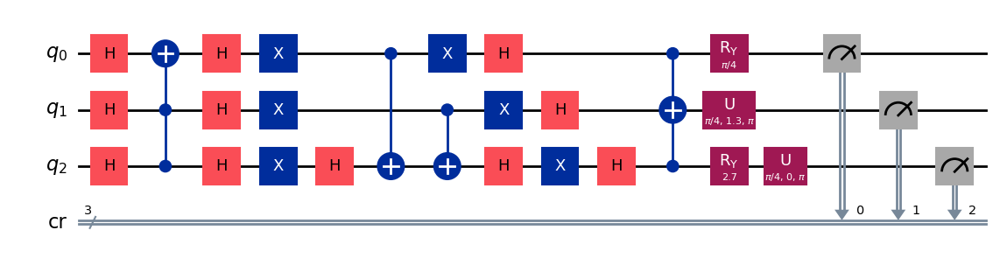

gen = 0 , Best fitness = (0.7506,)
gen = 1 , Best fitness = (0.7506,) , Number of invalids = 0

[Run 1 | Gen 99/99] Best Fitness: 0.7506 | Fidelity: 0.8918 | Gates: 32


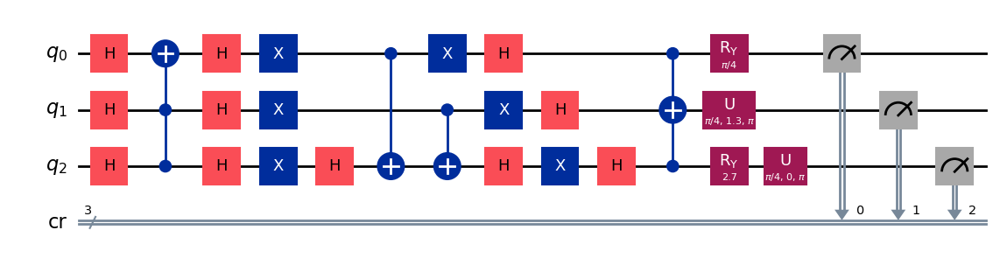


Generating evolution plots for Run 1...
✓ Plot saved to: experiments_state_101/run_1_seed_29855/evolution_metrics_run_1.png


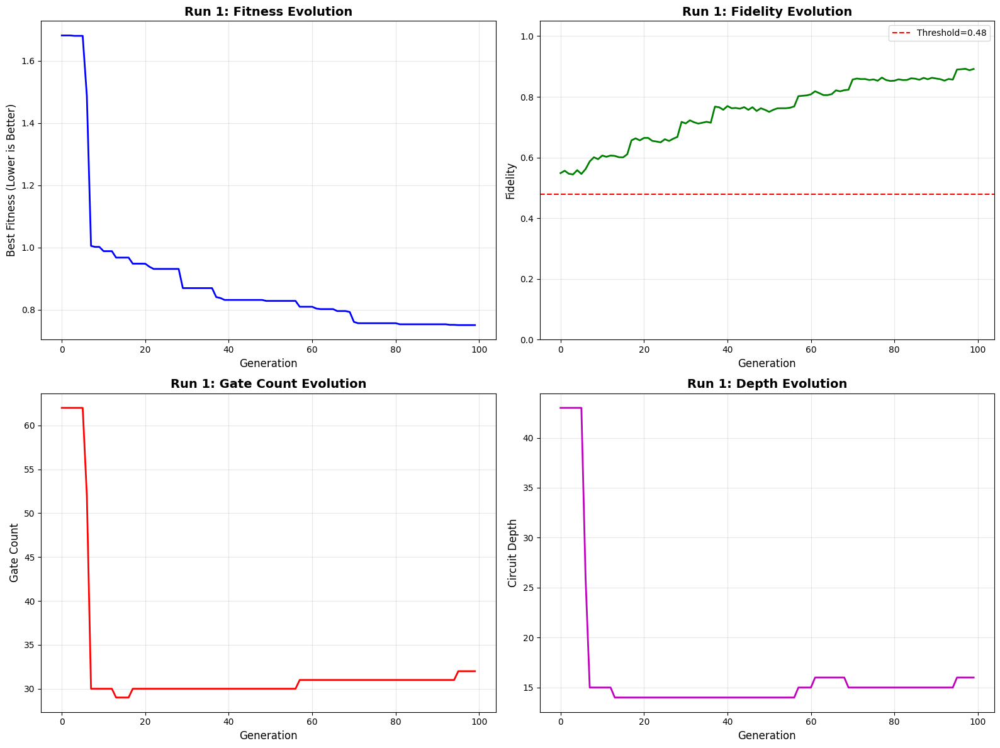


✓ Run 1 COMPLETE | Fidelity: 0.8904 | Gates: 32 | Depth: 16


RUN 2/5 | Target: 101 | Seed: 15775
✓ Logging to: experiments_state_101/run_2_seed_15775
✓ Starting evolution (Population: 1000, Generations: 100)
gen = 0 , Best fitness = (1.5314,)
gen = 1 , Best fitness = (1.5314,) , Number of invalids = 161

[Run 2 | Gen 0/99] Best Fitness: 1.5314 | Fidelity: 0.5333 | Gates: 53


/Users/admin/Downloads/GE_Grover/.venv/lib/python3.10/site-packages/numpy/_core/_methods.py:191: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


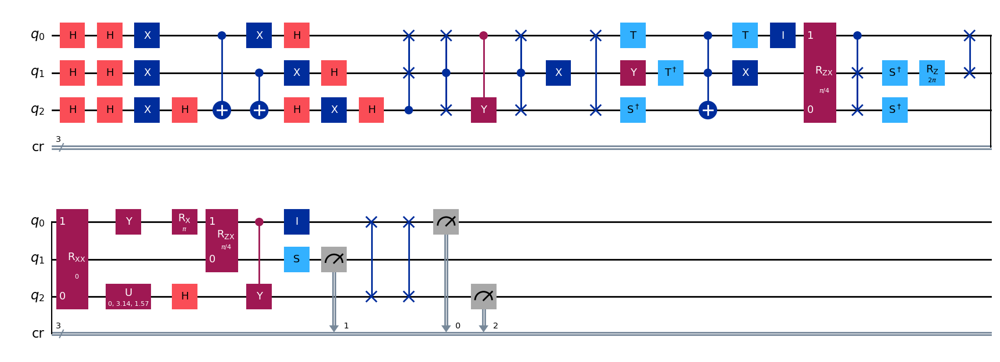

gen = 0 , Best fitness = (1.5314,)
gen = 1 , Best fitness = (1.5314,) , Number of invalids = 79

[Run 2 | Gen 1/99] Best Fitness: 1.5314 | Fidelity: 0.5284 | Gates: 53


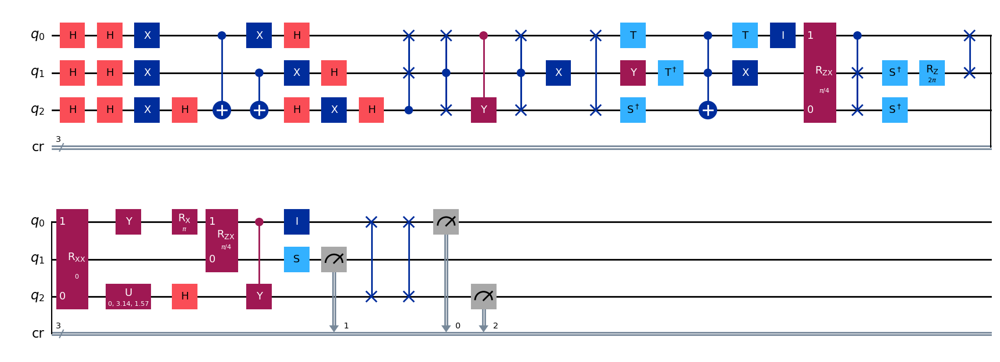

gen = 0 , Best fitness = (1.5314,)
gen = 1 , Best fitness = (1.5161,) , Number of invalids = 69

[Run 2 | Gen 2/99] Best Fitness: 1.5161 | Fidelity: 0.5487 | Gates: 53


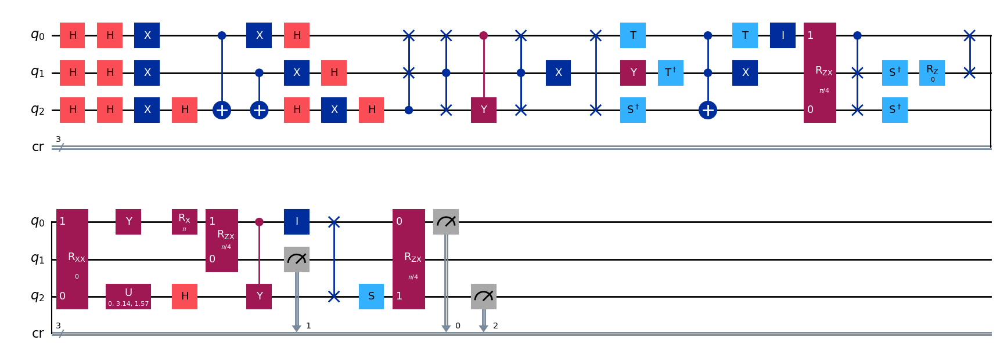

gen = 0 , Best fitness = (1.5161,)
gen = 1 , Best fitness = (1.5161,) , Number of invalids = 33

[Run 2 | Gen 3/99] Best Fitness: 1.5161 | Fidelity: 0.5427 | Gates: 53


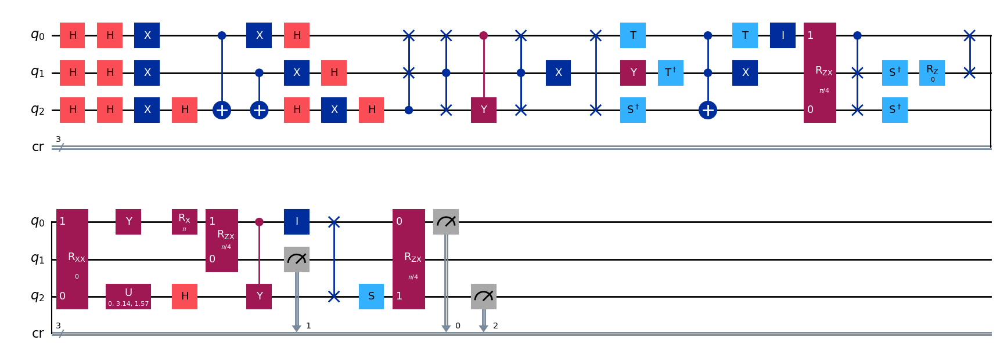

gen = 0 , Best fitness = (1.5161,)
gen = 1 , Best fitness = (1.4746000000000001,) , Number of invalids = 31

[Run 2 | Gen 4/99] Best Fitness: 1.4746 | Fidelity: 0.5263 | Gates: 50


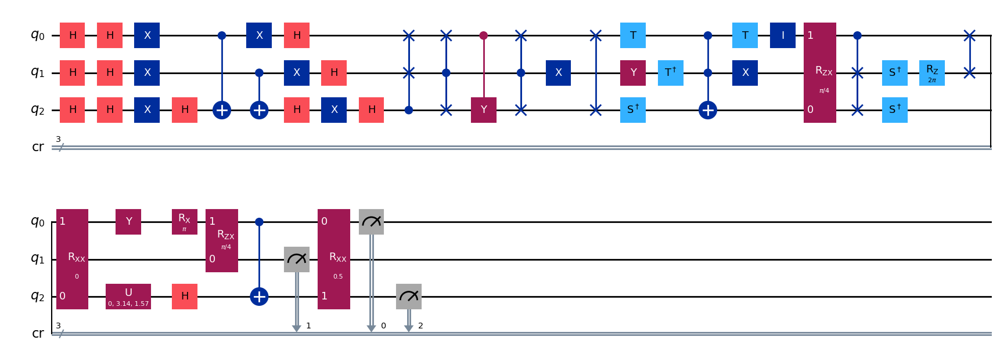

gen = 0 , Best fitness = (1.4746000000000001,)
gen = 1 , Best fitness = (1.4746000000000001,) , Number of invalids = 20

[Run 2 | Gen 5/99] Best Fitness: 1.4746 | Fidelity: 0.5286 | Gates: 50


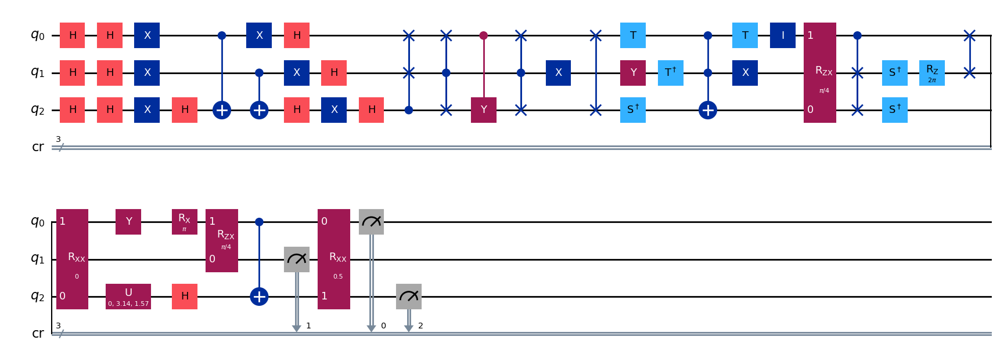

gen = 0 , Best fitness = (1.4746000000000001,)
gen = 1 , Best fitness = (1.4746000000000001,) , Number of invalids = 17

[Run 2 | Gen 6/99] Best Fitness: 1.4746 | Fidelity: 0.5170 | Gates: 50


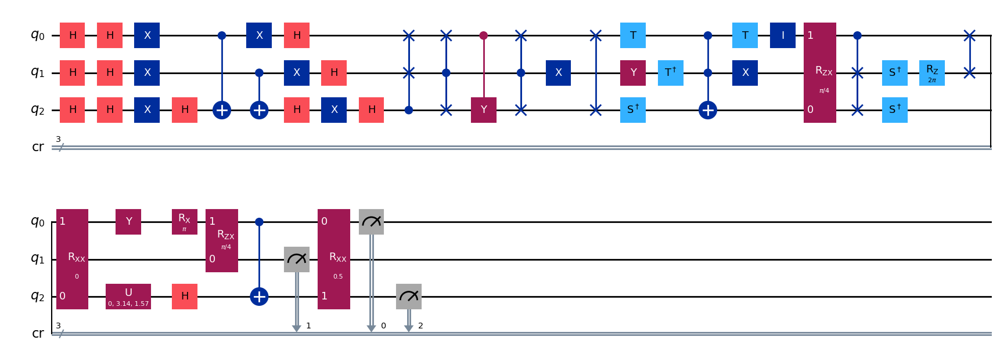

gen = 0 , Best fitness = (1.4746000000000001,)
gen = 1 , Best fitness = (1.4746000000000001,) , Number of invalids = 16

[Run 2 | Gen 7/99] Best Fitness: 1.4746 | Fidelity: 0.5218 | Gates: 50


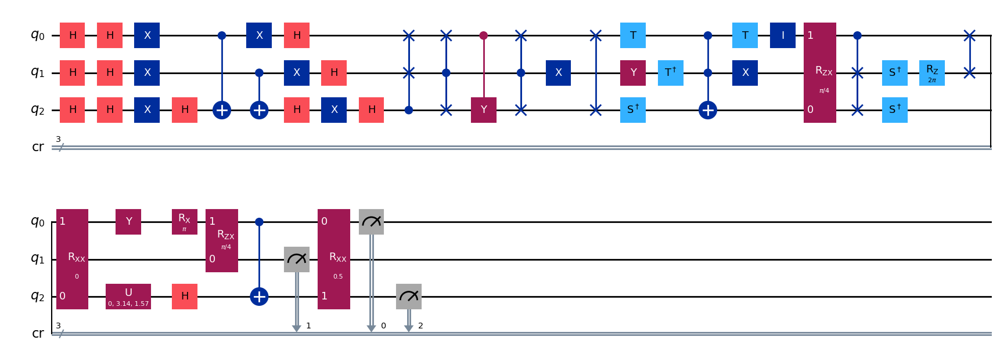

gen = 0 , Best fitness = (1.4746000000000001,)
gen = 1 , Best fitness = (1.4746000000000001,) , Number of invalids = 29

[Run 2 | Gen 8/99] Best Fitness: 1.4746 | Fidelity: 0.5145 | Gates: 50


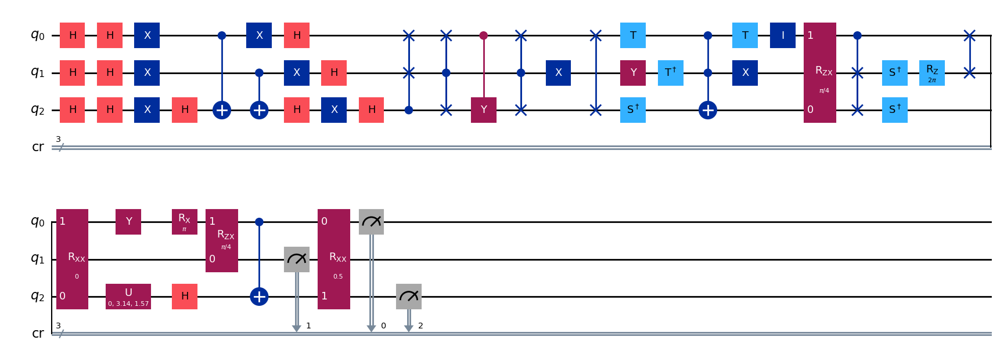

gen = 0 , Best fitness = (1.4746000000000001,)
gen = 1 , Best fitness = (1.4746000000000001,) , Number of invalids = 31

[Run 2 | Gen 9/99] Best Fitness: 1.4746 | Fidelity: 0.5294 | Gates: 50


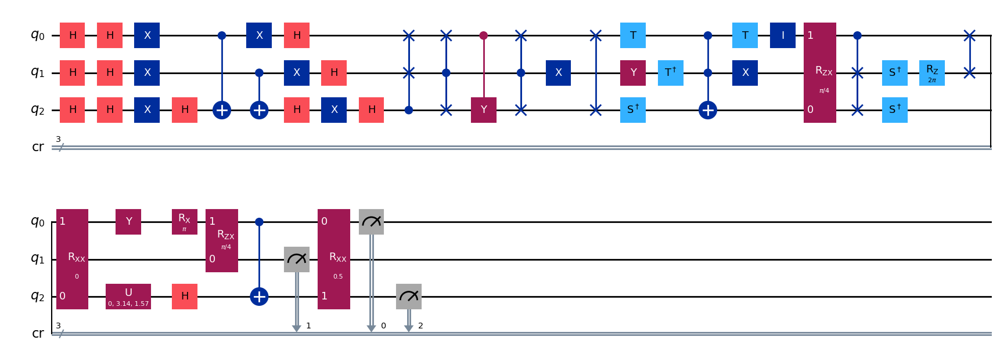

gen = 0 , Best fitness = (1.4746000000000001,)
gen = 1 , Best fitness = (1.4746000000000001,) , Number of invalids = 26

[Run 2 | Gen 10/99] Best Fitness: 1.4746 | Fidelity: 0.5250 | Gates: 50


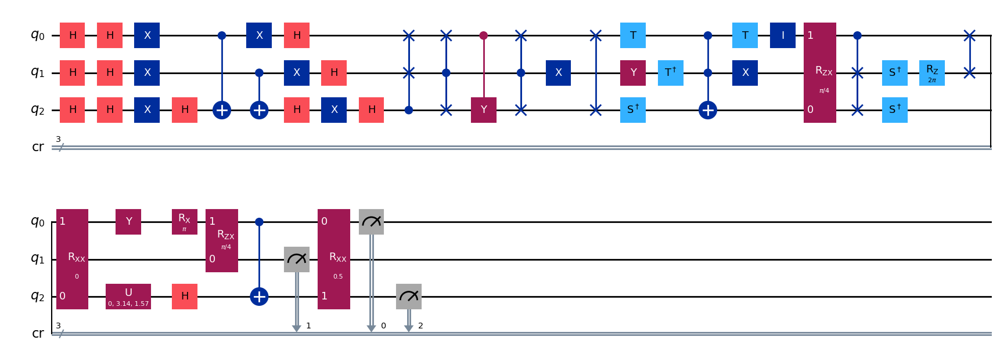

gen = 0 , Best fitness = (1.4746000000000001,)
gen = 1 , Best fitness = (1.4746000000000001,) , Number of invalids = 17

[Run 2 | Gen 11/99] Best Fitness: 1.4746 | Fidelity: 0.5263 | Gates: 50


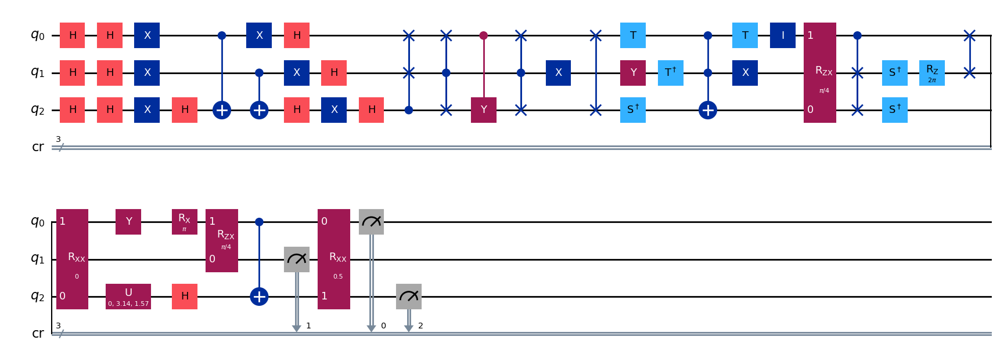

gen = 0 , Best fitness = (1.4746000000000001,)
gen = 1 , Best fitness = (1.3215,) , Number of invalids = 13

[Run 2 | Gen 12/99] Best Fitness: 1.3215 | Fidelity: 0.5547 | Gates: 44


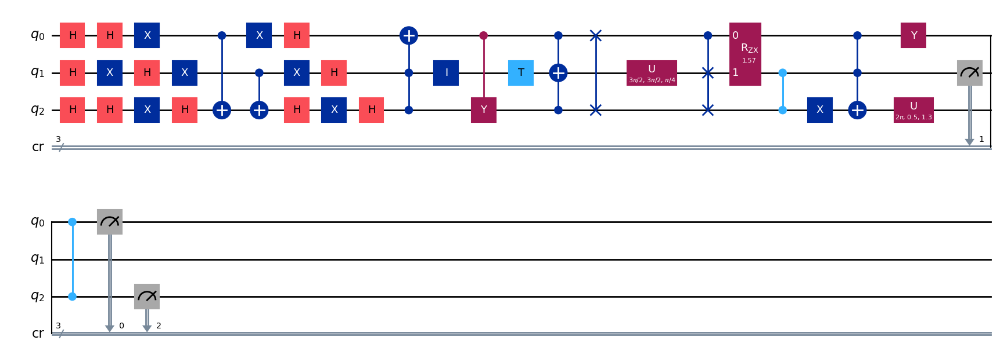

gen = 0 , Best fitness = (1.3215,)
gen = 1 , Best fitness = (1.3192,) , Number of invalids = 18

[Run 2 | Gen 13/99] Best Fitness: 1.3192 | Fidelity: 0.5546 | Gates: 44


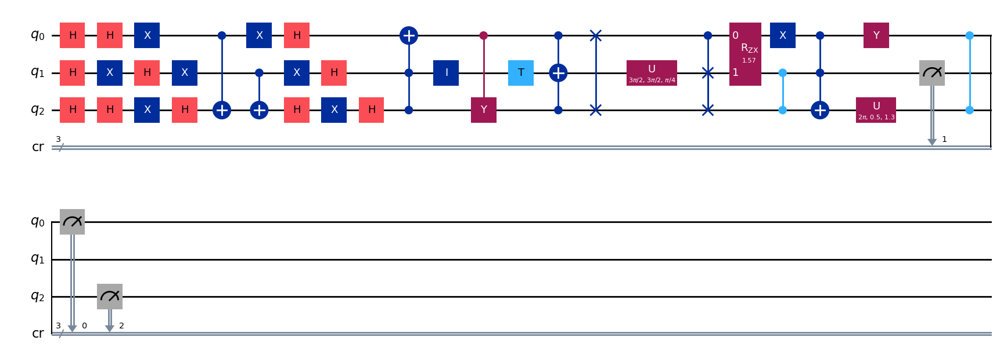

gen = 0 , Best fitness = (1.3192,)
gen = 1 , Best fitness = (1.02,) , Number of invalids = 16

[Run 2 | Gen 14/99] Best Fitness: 1.0200 | Fidelity: 0.6060 | Gates: 31


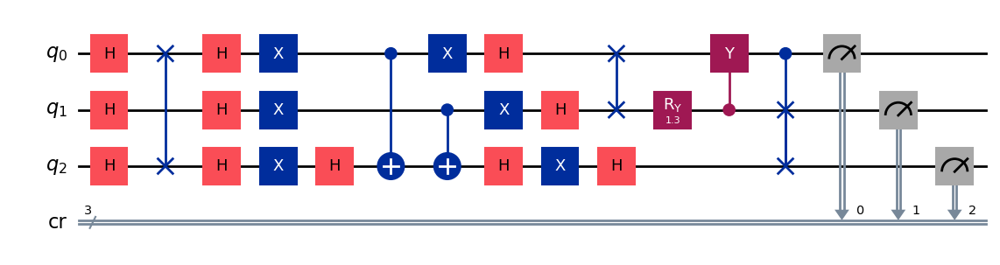

gen = 0 , Best fitness = (1.02,)
gen = 1 , Best fitness = (1.02,) , Number of invalids = 11

[Run 2 | Gen 15/99] Best Fitness: 1.0200 | Fidelity: 0.5993 | Gates: 31


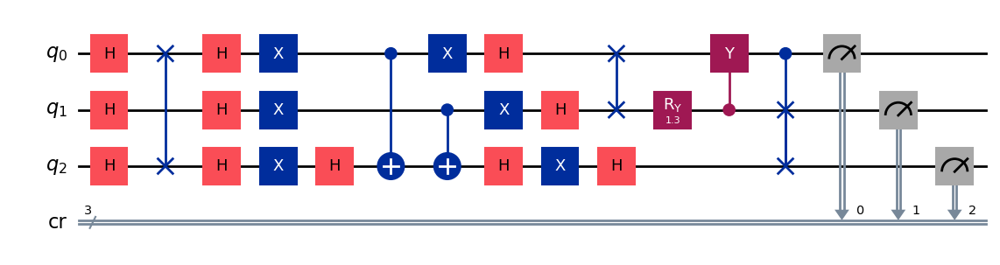

gen = 0 , Best fitness = (1.02,)
gen = 1 , Best fitness = (1.02,) , Number of invalids = 13

[Run 2 | Gen 16/99] Best Fitness: 1.0200 | Fidelity: 0.6036 | Gates: 31


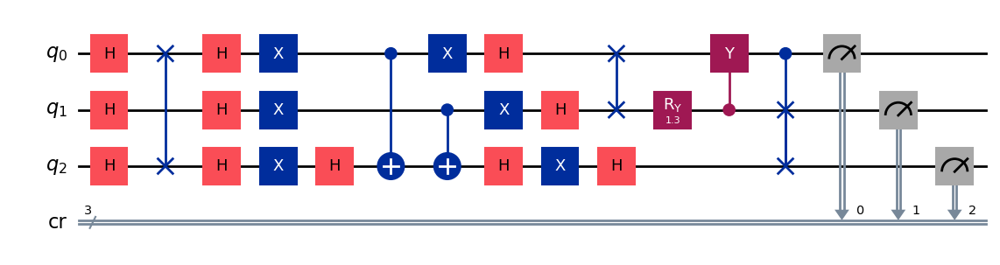

gen = 0 , Best fitness = (1.02,)
gen = 1 , Best fitness = (1.02,) , Number of invalids = 17

[Run 2 | Gen 17/99] Best Fitness: 1.0200 | Fidelity: 0.6050 | Gates: 31


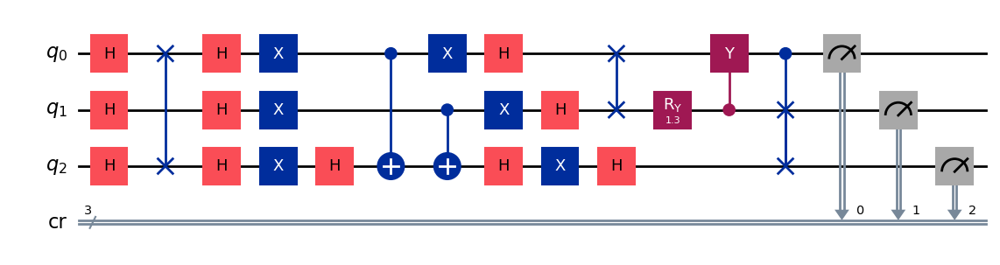

gen = 0 , Best fitness = (1.02,)
gen = 1 , Best fitness = (1.0166,) , Number of invalids = 15

[Run 2 | Gen 18/99] Best Fitness: 1.0166 | Fidelity: 0.5982 | Gates: 31


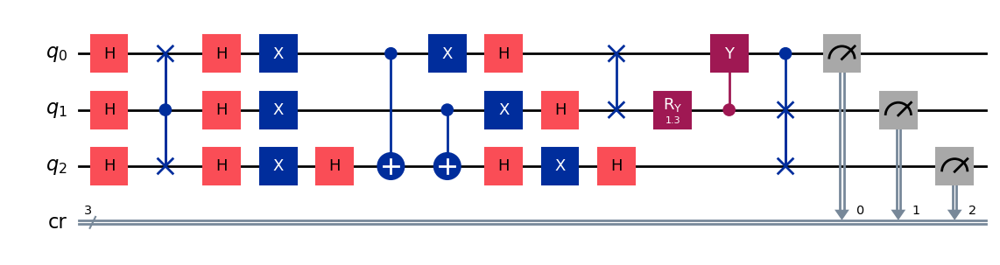

gen = 0 , Best fitness = (1.0166,)
gen = 1 , Best fitness = (1.0164,) , Number of invalids = 25

[Run 2 | Gen 19/99] Best Fitness: 1.0164 | Fidelity: 0.6063 | Gates: 31


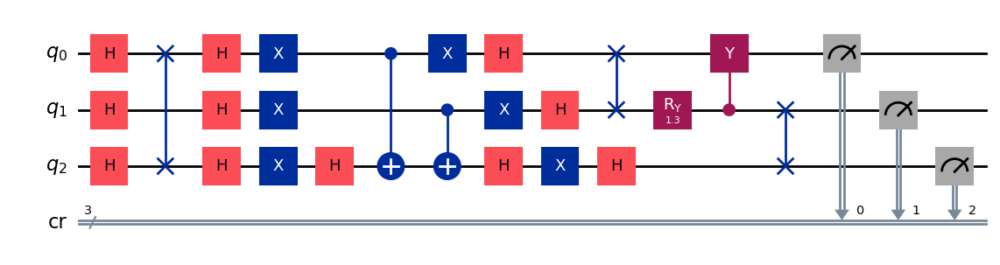

gen = 0 , Best fitness = (1.0164,)
gen = 1 , Best fitness = (1.0105,) , Number of invalids = 14

[Run 2 | Gen 20/99] Best Fitness: 1.0105 | Fidelity: 0.6127 | Gates: 31


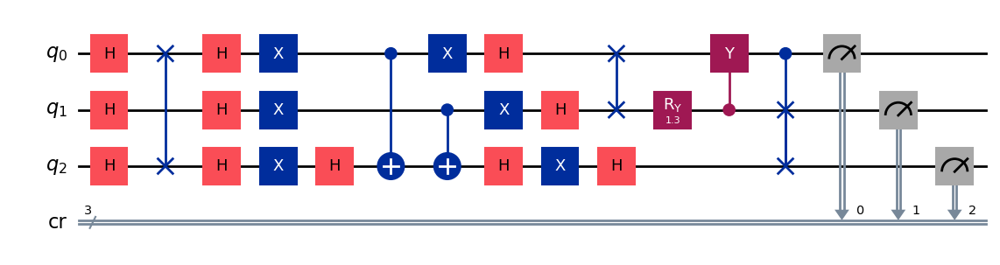

gen = 0 , Best fitness = (1.0105,)
gen = 1 , Best fitness = (1.0105,) , Number of invalids = 24

[Run 2 | Gen 21/99] Best Fitness: 1.0105 | Fidelity: 0.6041 | Gates: 31


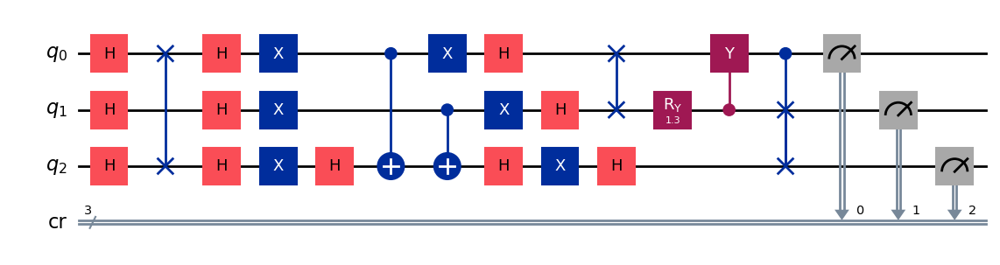

gen = 0 , Best fitness = (1.0105,)
gen = 1 , Best fitness = (1.0063,) , Number of invalids = 10

[Run 2 | Gen 22/99] Best Fitness: 1.0063 | Fidelity: 0.5949 | Gates: 31


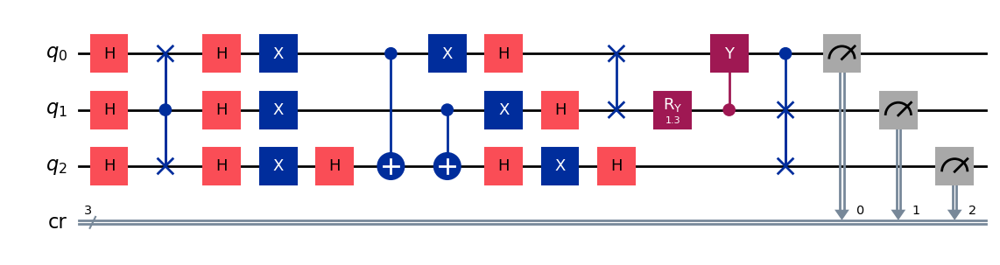

gen = 0 , Best fitness = (1.0063,)
gen = 1 , Best fitness = (1.0063,) , Number of invalids = 6

[Run 2 | Gen 23/99] Best Fitness: 1.0063 | Fidelity: 0.6088 | Gates: 31


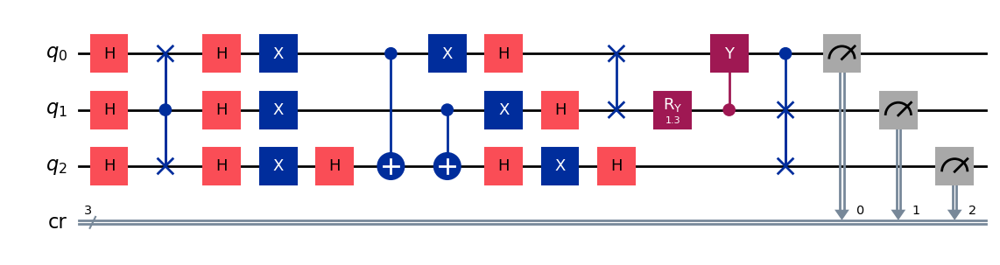

gen = 0 , Best fitness = (1.0063,)
gen = 1 , Best fitness = (1.0063,) , Number of invalids = 4

[Run 2 | Gen 24/99] Best Fitness: 1.0063 | Fidelity: 0.6050 | Gates: 31


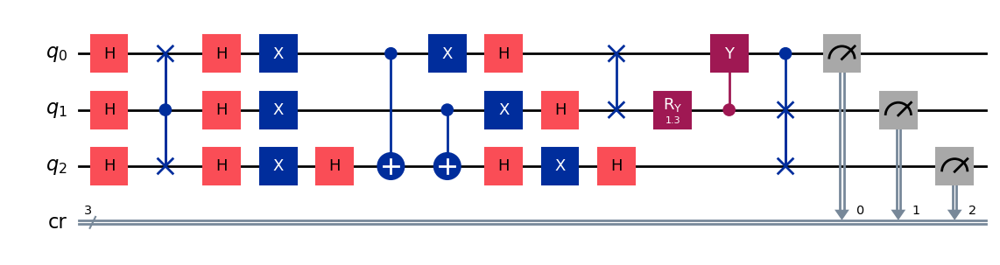

gen = 0 , Best fitness = (1.0063,)
gen = 1 , Best fitness = (1.0063,) , Number of invalids = 3

[Run 2 | Gen 25/99] Best Fitness: 1.0063 | Fidelity: 0.6033 | Gates: 31


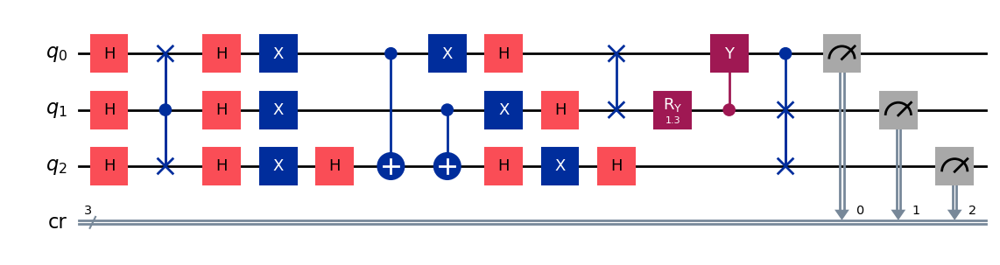

gen = 0 , Best fitness = (1.0063,)
gen = 1 , Best fitness = (1.0063,) , Number of invalids = 5

[Run 2 | Gen 26/99] Best Fitness: 1.0063 | Fidelity: 0.6018 | Gates: 31


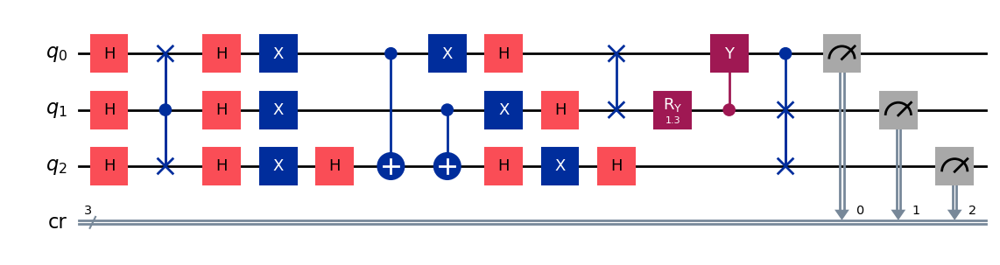

gen = 0 , Best fitness = (1.0063,)
gen = 1 , Best fitness = (1.0063,) , Number of invalids = 0

[Run 2 | Gen 27/99] Best Fitness: 1.0063 | Fidelity: 0.5963 | Gates: 31


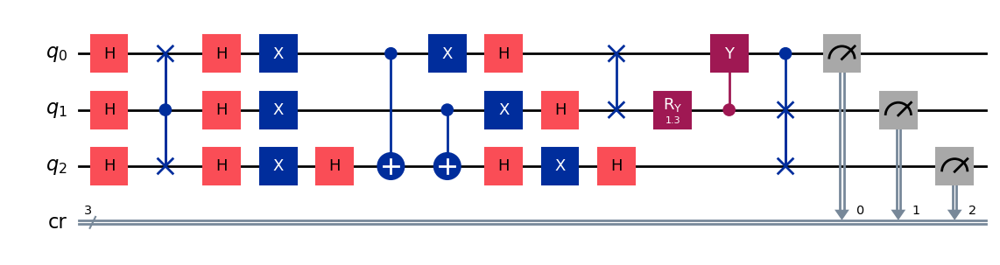

gen = 0 , Best fitness = (1.0063,)
gen = 1 , Best fitness = (1.0063,) , Number of invalids = 3

[Run 2 | Gen 28/99] Best Fitness: 1.0063 | Fidelity: 0.6072 | Gates: 31


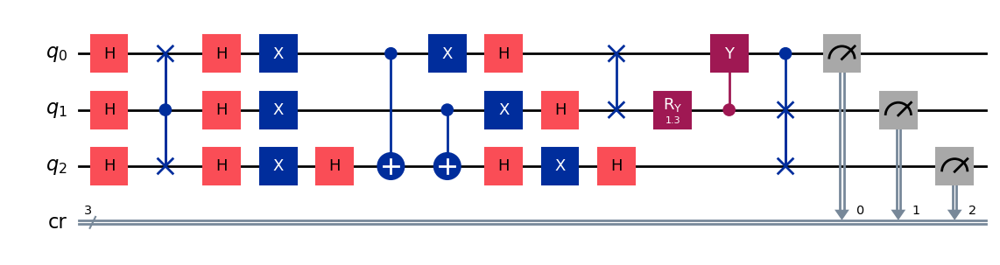

gen = 0 , Best fitness = (1.0063,)
gen = 1 , Best fitness = (1.0028000000000001,) , Number of invalids = 0

[Run 2 | Gen 29/99] Best Fitness: 1.0028 | Fidelity: 0.6071 | Gates: 31


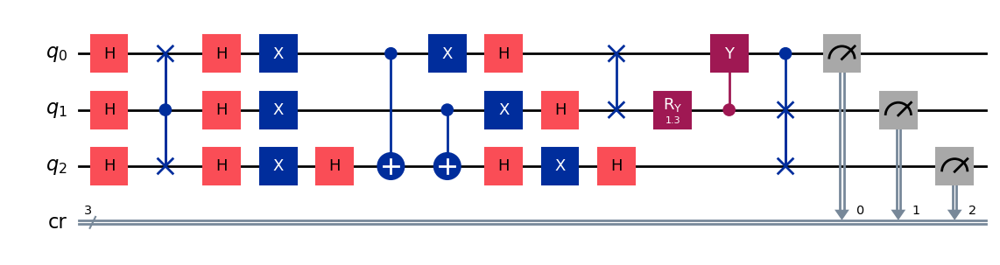

gen = 0 , Best fitness = (1.0028000000000001,)
gen = 1 , Best fitness = (1.0028000000000001,) , Number of invalids = 1

[Run 2 | Gen 30/99] Best Fitness: 1.0028 | Fidelity: 0.6047 | Gates: 31


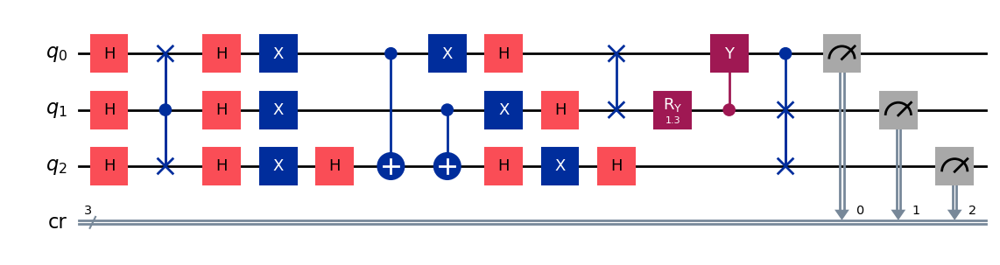

gen = 0 , Best fitness = (1.0028000000000001,)
gen = 1 , Best fitness = (1.0028000000000001,) , Number of invalids = 1

[Run 2 | Gen 31/99] Best Fitness: 1.0028 | Fidelity: 0.6018 | Gates: 31


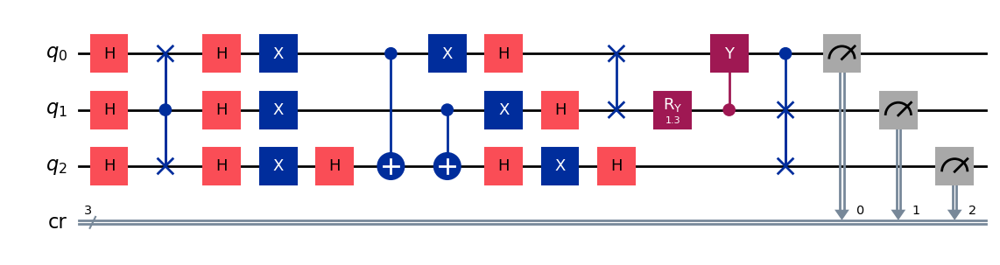

gen = 0 , Best fitness = (1.0028000000000001,)
gen = 1 , Best fitness = (1.0028000000000001,) , Number of invalids = 0

[Run 2 | Gen 32/99] Best Fitness: 1.0028 | Fidelity: 0.6074 | Gates: 31


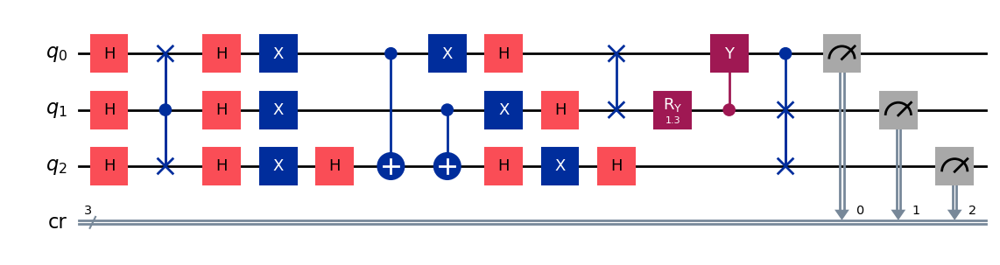

gen = 0 , Best fitness = (1.0028000000000001,)
gen = 1 , Best fitness = (1.0028000000000001,) , Number of invalids = 0

[Run 2 | Gen 33/99] Best Fitness: 1.0028 | Fidelity: 0.6061 | Gates: 31


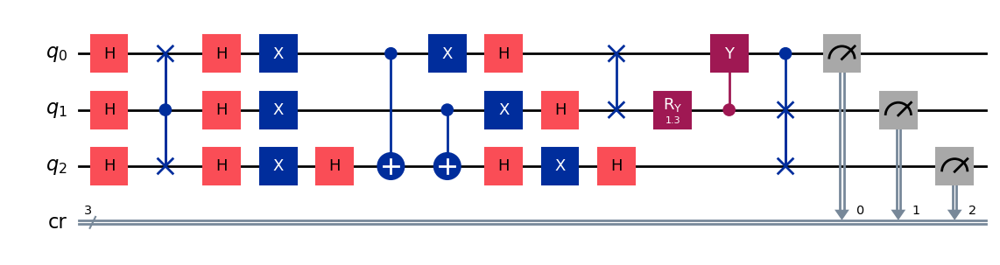

gen = 0 , Best fitness = (1.0028000000000001,)
gen = 1 , Best fitness = (1.0028000000000001,) , Number of invalids = 0

[Run 2 | Gen 34/99] Best Fitness: 1.0028 | Fidelity: 0.6049 | Gates: 31


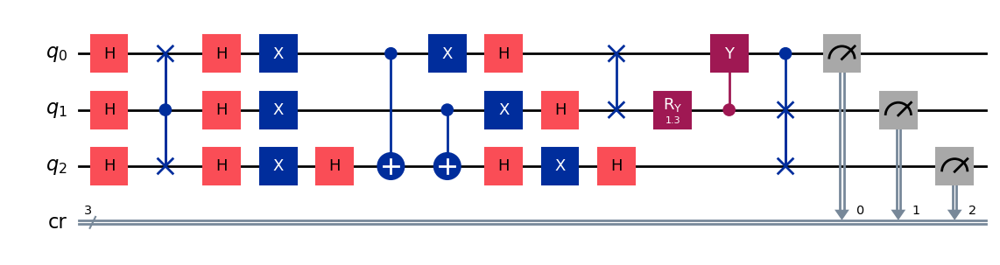

gen = 0 , Best fitness = (1.0028000000000001,)
gen = 1 , Best fitness = (1.0028000000000001,) , Number of invalids = 0

[Run 2 | Gen 35/99] Best Fitness: 1.0028 | Fidelity: 0.6037 | Gates: 31


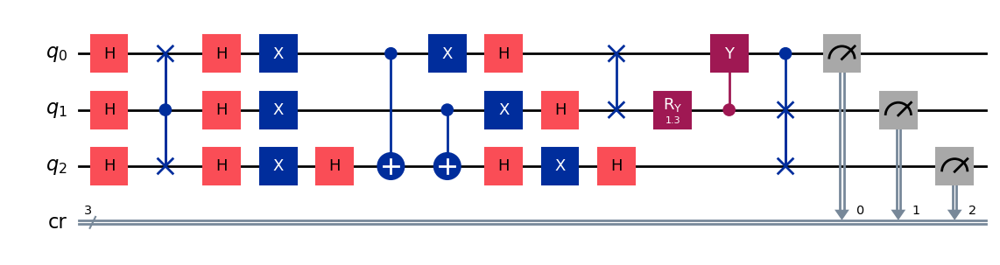

gen = 0 , Best fitness = (1.0028000000000001,)
gen = 1 , Best fitness = (1.0028000000000001,) , Number of invalids = 0

[Run 2 | Gen 36/99] Best Fitness: 1.0028 | Fidelity: 0.6026 | Gates: 31


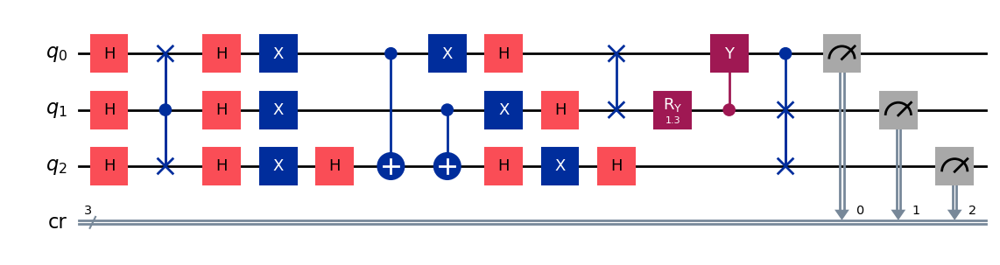

gen = 0 , Best fitness = (1.0028000000000001,)
gen = 1 , Best fitness = (1.0028000000000001,) , Number of invalids = 0

[Run 2 | Gen 37/99] Best Fitness: 1.0028 | Fidelity: 0.6021 | Gates: 31


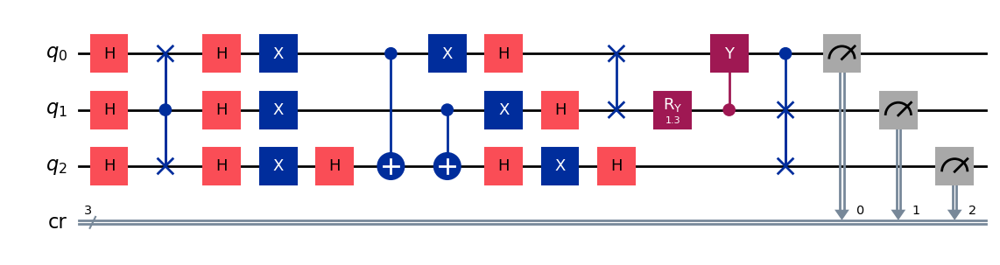

gen = 0 , Best fitness = (1.0028000000000001,)
gen = 1 , Best fitness = (1.0028000000000001,) , Number of invalids = 1

[Run 2 | Gen 38/99] Best Fitness: 1.0028 | Fidelity: 0.6061 | Gates: 31


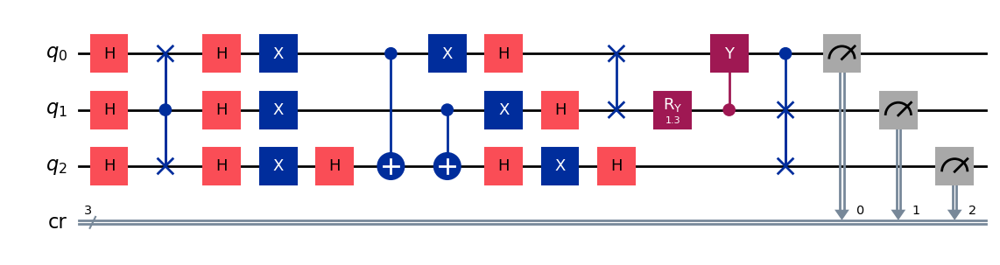

gen = 0 , Best fitness = (1.0028000000000001,)
gen = 1 , Best fitness = (1.0028000000000001,) , Number of invalids = 0

[Run 2 | Gen 39/99] Best Fitness: 1.0028 | Fidelity: 0.5994 | Gates: 31


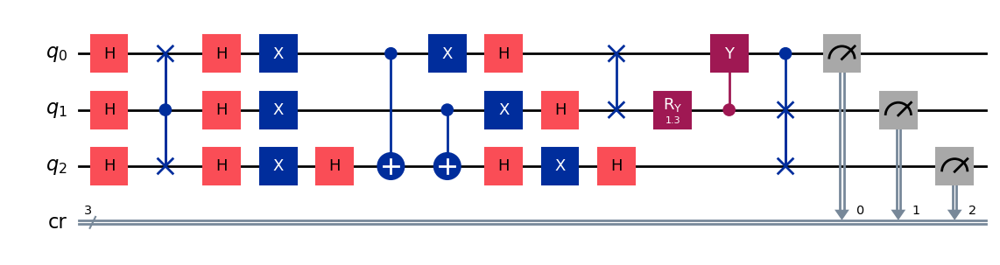

gen = 0 , Best fitness = (1.0028000000000001,)
gen = 1 , Best fitness = (1.0028000000000001,) , Number of invalids = 1

[Run 2 | Gen 40/99] Best Fitness: 1.0028 | Fidelity: 0.6055 | Gates: 31


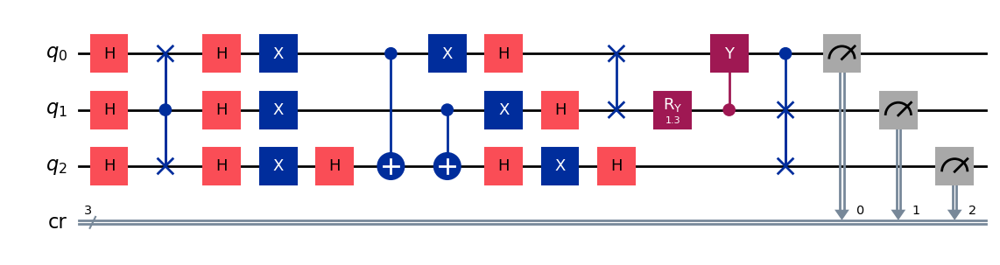

gen = 0 , Best fitness = (1.0028000000000001,)
gen = 1 , Best fitness = (1.0011,) , Number of invalids = 0

[Run 2 | Gen 41/99] Best Fitness: 1.0011 | Fidelity: 0.5871 | Gates: 30


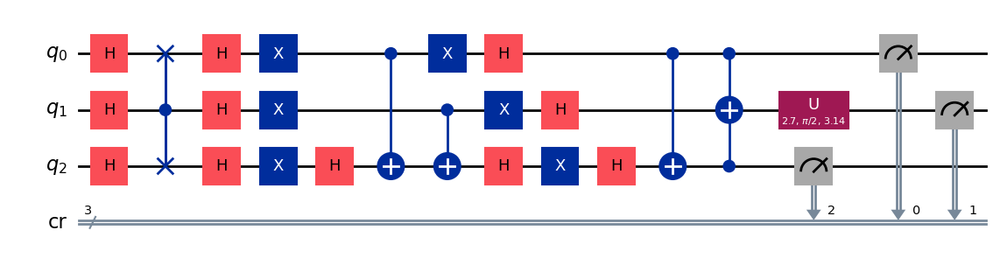

gen = 0 , Best fitness = (1.0011,)
gen = 1 , Best fitness = (1.0011,) , Number of invalids = 0

[Run 2 | Gen 42/99] Best Fitness: 1.0011 | Fidelity: 0.5870 | Gates: 30


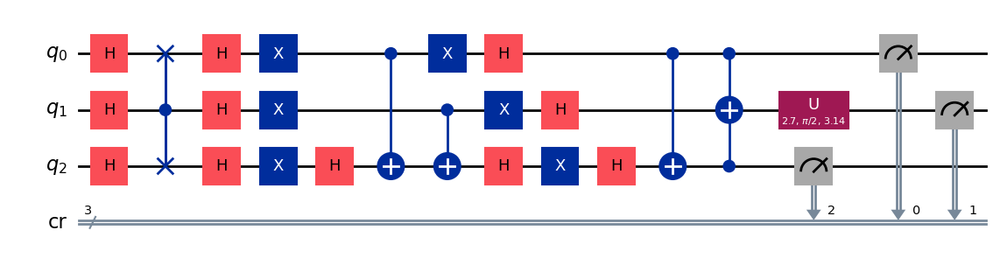

gen = 0 , Best fitness = (1.0011,)
gen = 1 , Best fitness = (1.0011,) , Number of invalids = 0

[Run 2 | Gen 43/99] Best Fitness: 1.0011 | Fidelity: 0.5931 | Gates: 30


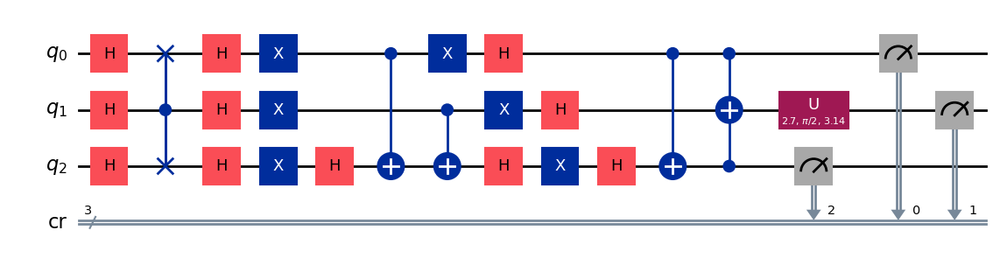

gen = 0 , Best fitness = (1.0011,)
gen = 1 , Best fitness = (1.0011,) , Number of invalids = 0

[Run 2 | Gen 44/99] Best Fitness: 1.0011 | Fidelity: 0.5932 | Gates: 30


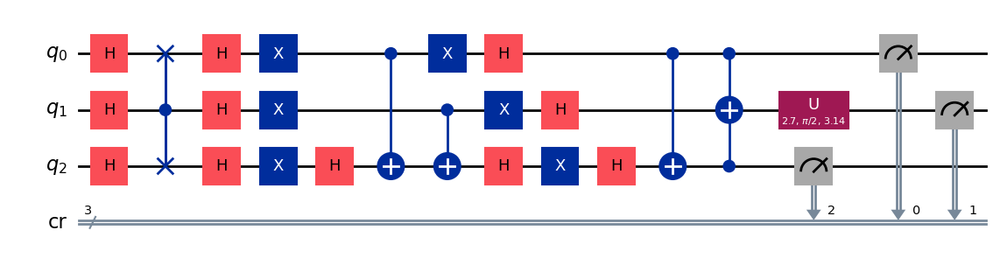

gen = 0 , Best fitness = (1.0011,)
gen = 1 , Best fitness = (0.9919,) , Number of invalids = 0

[Run 2 | Gen 45/99] Best Fitness: 0.9919 | Fidelity: 0.5873 | Gates: 30


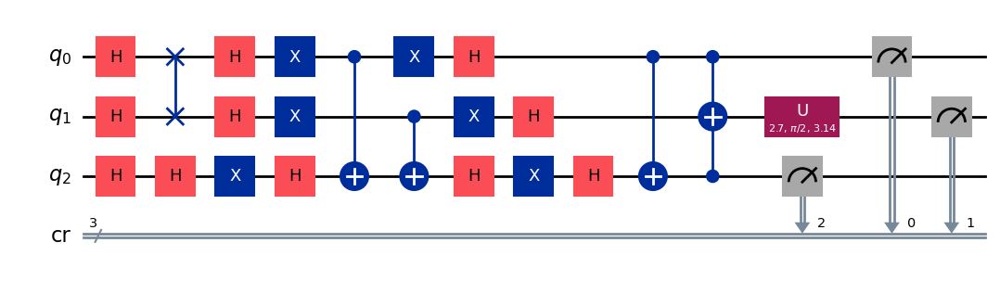

gen = 0 , Best fitness = (0.9919,)
gen = 1 , Best fitness = (0.9787,) , Number of invalids = 0

[Run 2 | Gen 46/99] Best Fitness: 0.9787 | Fidelity: 0.6238 | Gates: 30


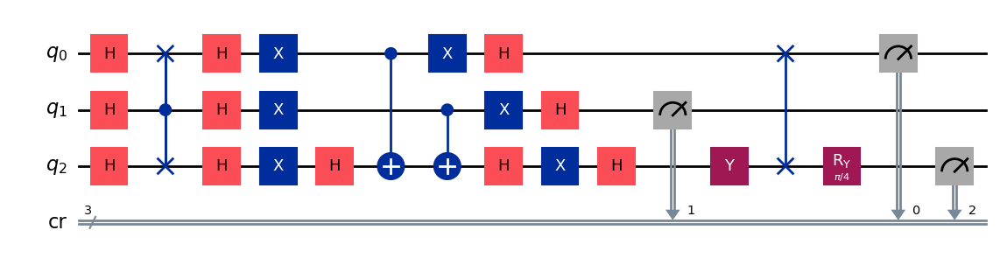

gen = 0 , Best fitness = (0.9787,)
gen = 1 , Best fitness = (0.9787,) , Number of invalids = 0

[Run 2 | Gen 47/99] Best Fitness: 0.9787 | Fidelity: 0.6237 | Gates: 30


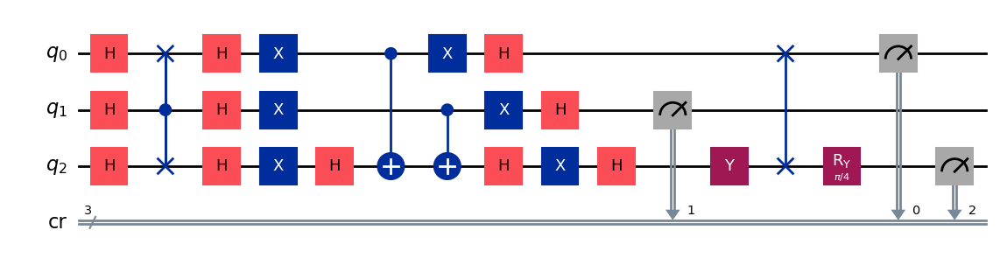

gen = 0 , Best fitness = (0.9787,)
gen = 1 , Best fitness = (0.9787,) , Number of invalids = 0

[Run 2 | Gen 48/99] Best Fitness: 0.9787 | Fidelity: 0.6193 | Gates: 30


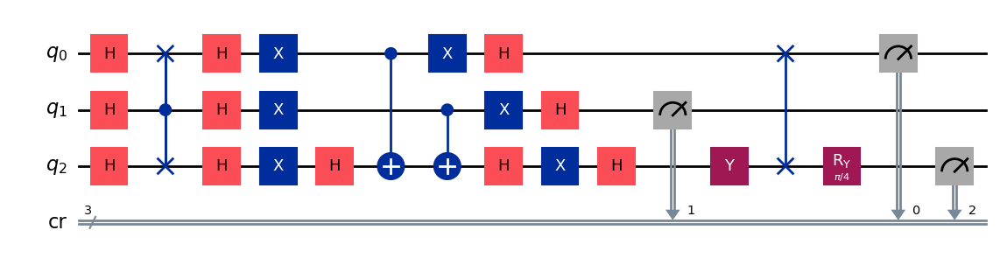

gen = 0 , Best fitness = (0.9787,)
gen = 1 , Best fitness = (0.9749,) , Number of invalids = 0

[Run 2 | Gen 49/99] Best Fitness: 0.9749 | Fidelity: 0.6227 | Gates: 30


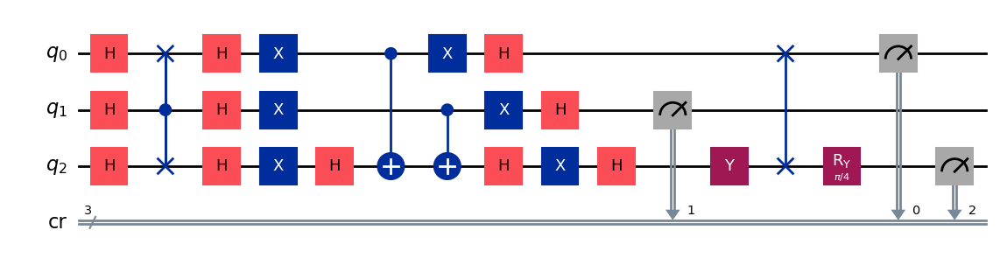

gen = 0 , Best fitness = (0.9749,)
gen = 1 , Best fitness = (0.9749,) , Number of invalids = 0

[Run 2 | Gen 50/99] Best Fitness: 0.9749 | Fidelity: 0.6185 | Gates: 30


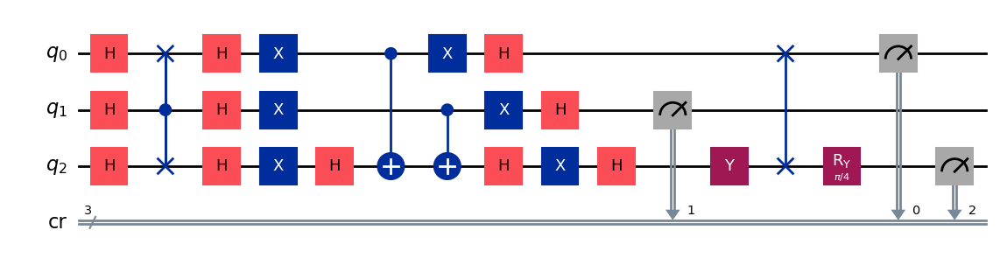

gen = 0 , Best fitness = (0.9749,)
gen = 1 , Best fitness = (0.9738,) , Number of invalids = 0

[Run 2 | Gen 51/99] Best Fitness: 0.9738 | Fidelity: 0.6211 | Gates: 30


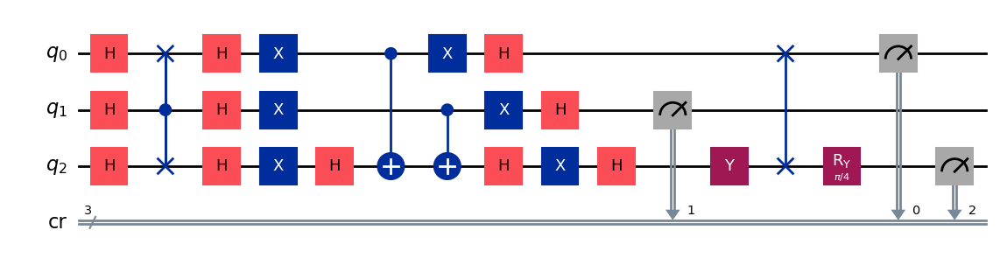

gen = 0 , Best fitness = (0.9738,)
gen = 1 , Best fitness = (0.9738,) , Number of invalids = 0

[Run 2 | Gen 52/99] Best Fitness: 0.9738 | Fidelity: 0.6235 | Gates: 30


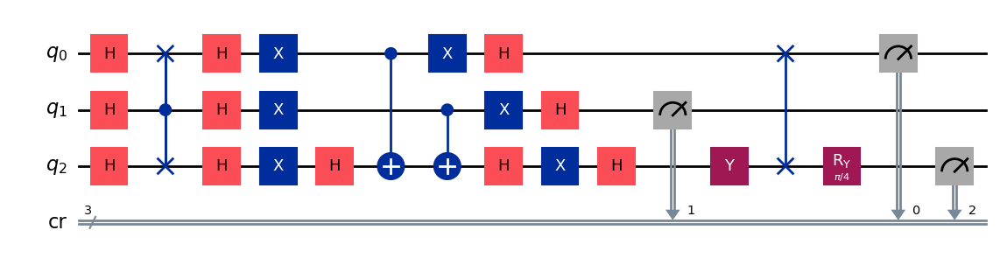

gen = 0 , Best fitness = (0.9738,)
gen = 1 , Best fitness = (0.9295,) , Number of invalids = 0

[Run 2 | Gen 53/99] Best Fitness: 0.9295 | Fidelity: 0.6962 | Gates: 32


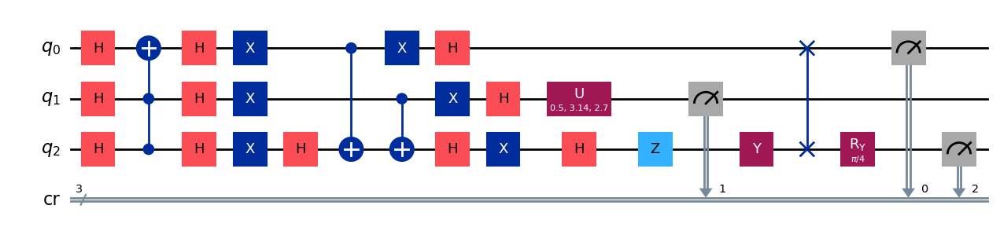

gen = 0 , Best fitness = (0.9295,)
gen = 1 , Best fitness = (0.9295,) , Number of invalids = 0

[Run 2 | Gen 54/99] Best Fitness: 0.9295 | Fidelity: 0.7031 | Gates: 32


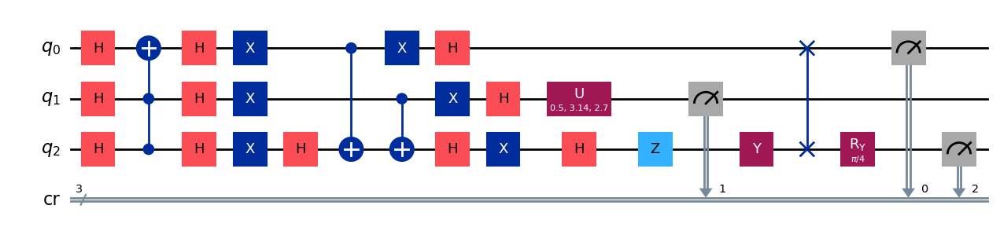

gen = 0 , Best fitness = (0.9295,)
gen = 1 , Best fitness = (0.9295,) , Number of invalids = 0

[Run 2 | Gen 55/99] Best Fitness: 0.9295 | Fidelity: 0.7075 | Gates: 32


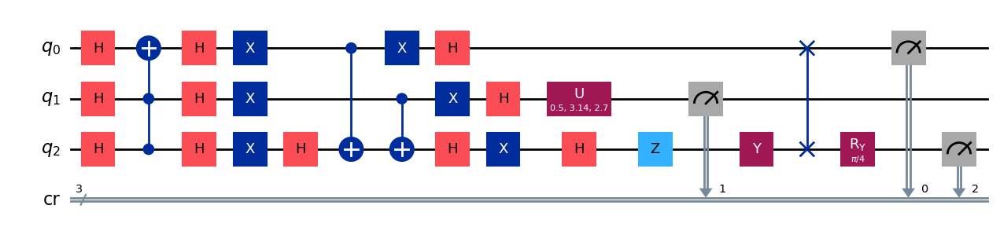

gen = 0 , Best fitness = (0.9295,)
gen = 1 , Best fitness = (0.9295,) , Number of invalids = 0

[Run 2 | Gen 56/99] Best Fitness: 0.9295 | Fidelity: 0.6960 | Gates: 32


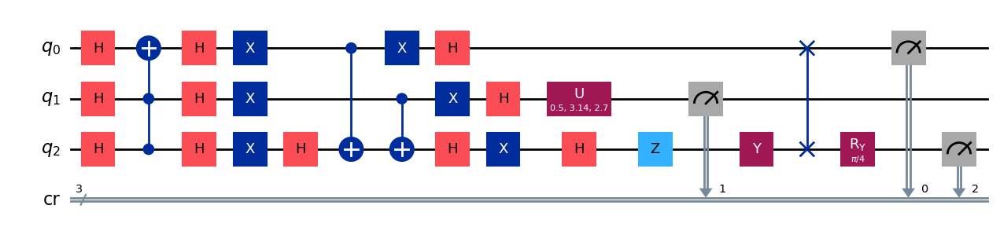

gen = 0 , Best fitness = (0.9295,)
gen = 1 , Best fitness = (0.9295,) , Number of invalids = 0

[Run 2 | Gen 57/99] Best Fitness: 0.9295 | Fidelity: 0.7075 | Gates: 32


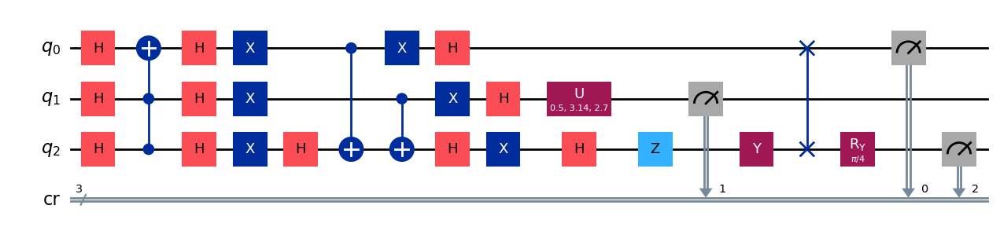

gen = 0 , Best fitness = (0.9295,)
gen = 1 , Best fitness = (0.9291,) , Number of invalids = 0

[Run 2 | Gen 58/99] Best Fitness: 0.9291 | Fidelity: 0.7043 | Gates: 32


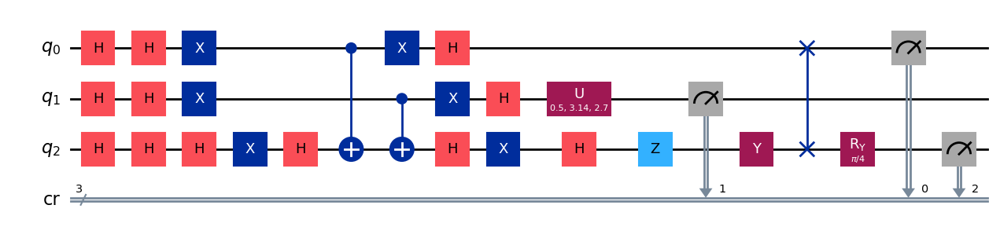

gen = 0 , Best fitness = (0.9291,)
gen = 1 , Best fitness = (0.9291,) , Number of invalids = 1

[Run 2 | Gen 59/99] Best Fitness: 0.9291 | Fidelity: 0.6981 | Gates: 32


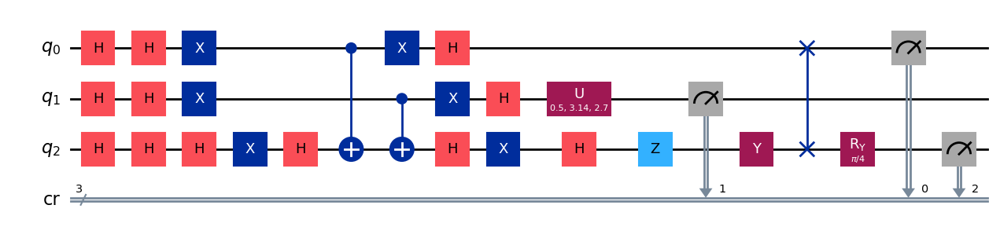

gen = 0 , Best fitness = (0.9291,)
gen = 1 , Best fitness = (0.9291,) , Number of invalids = 1

[Run 2 | Gen 60/99] Best Fitness: 0.9291 | Fidelity: 0.7099 | Gates: 32


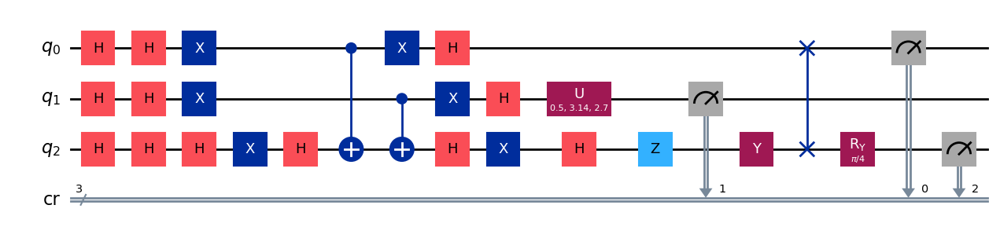

gen = 0 , Best fitness = (0.9291,)
gen = 1 , Best fitness = (0.9291,) , Number of invalids = 0

[Run 2 | Gen 61/99] Best Fitness: 0.9291 | Fidelity: 0.7044 | Gates: 32


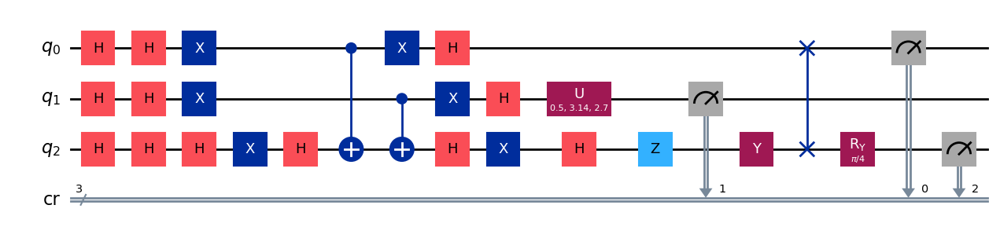

gen = 0 , Best fitness = (0.9291,)
gen = 1 , Best fitness = (0.9291,) , Number of invalids = 0

[Run 2 | Gen 62/99] Best Fitness: 0.9291 | Fidelity: 0.7076 | Gates: 32


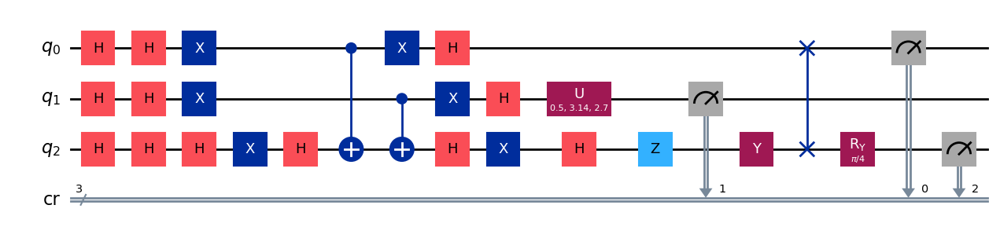

gen = 0 , Best fitness = (0.9291,)
gen = 1 , Best fitness = (0.9291,) , Number of invalids = 0

[Run 2 | Gen 63/99] Best Fitness: 0.9291 | Fidelity: 0.7024 | Gates: 32


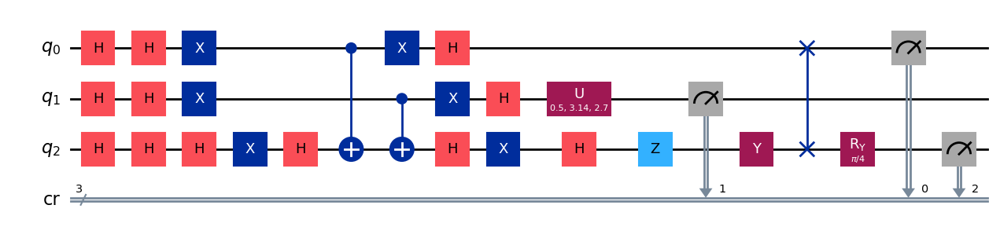

gen = 0 , Best fitness = (0.9291,)
gen = 1 , Best fitness = (0.9291,) , Number of invalids = 0

[Run 2 | Gen 64/99] Best Fitness: 0.9291 | Fidelity: 0.7133 | Gates: 32


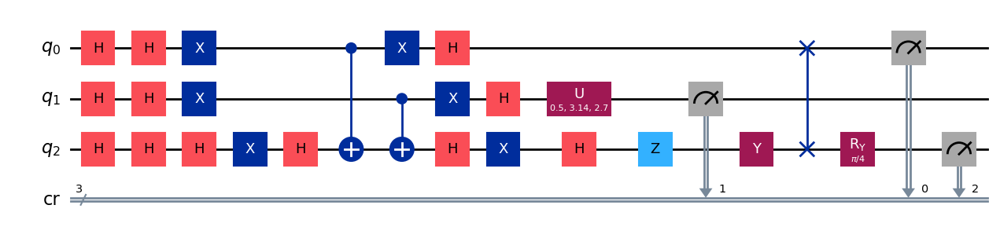

gen = 0 , Best fitness = (0.9291,)
gen = 1 , Best fitness = (0.9243,) , Number of invalids = 0

[Run 2 | Gen 65/99] Best Fitness: 0.9243 | Fidelity: 0.7010 | Gates: 32


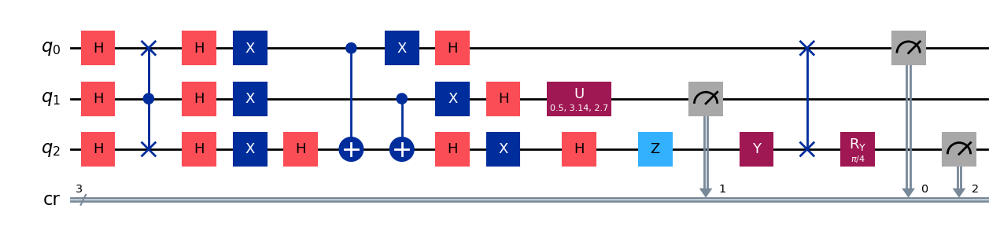

gen = 0 , Best fitness = (0.9243,)
gen = 1 , Best fitness = (0.9243,) , Number of invalids = 0

[Run 2 | Gen 66/99] Best Fitness: 0.9243 | Fidelity: 0.7052 | Gates: 32


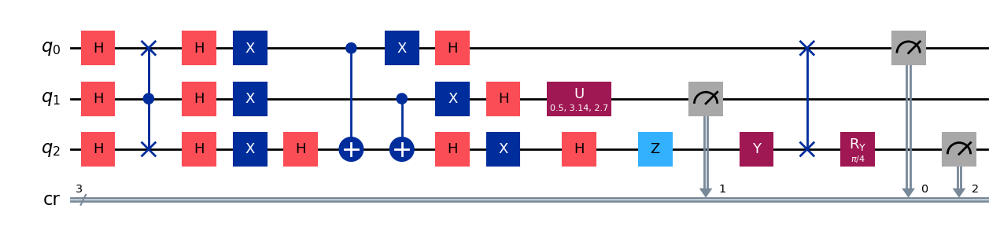

gen = 0 , Best fitness = (0.9243,)
gen = 1 , Best fitness = (0.9243,) , Number of invalids = 0

[Run 2 | Gen 67/99] Best Fitness: 0.9243 | Fidelity: 0.7014 | Gates: 32


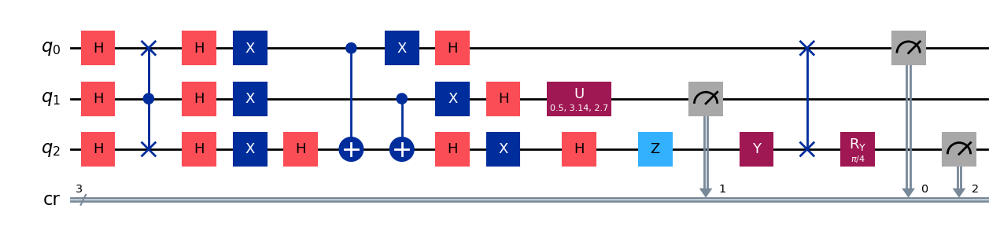

gen = 0 , Best fitness = (0.9243,)
gen = 1 , Best fitness = (0.9243,) , Number of invalids = 0

[Run 2 | Gen 68/99] Best Fitness: 0.9243 | Fidelity: 0.7002 | Gates: 32


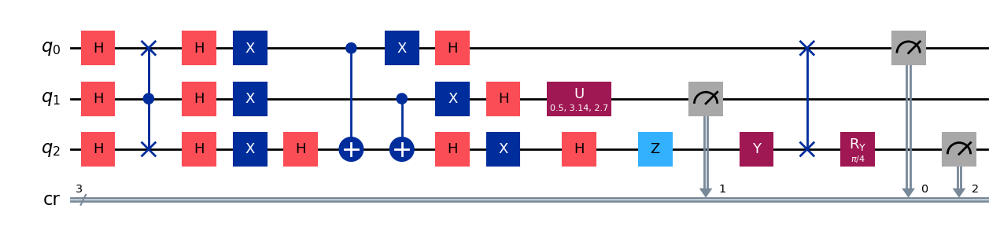

gen = 0 , Best fitness = (0.9243,)
gen = 1 , Best fitness = (0.9172,) , Number of invalids = 0

[Run 2 | Gen 69/99] Best Fitness: 0.9172 | Fidelity: 0.7040 | Gates: 31


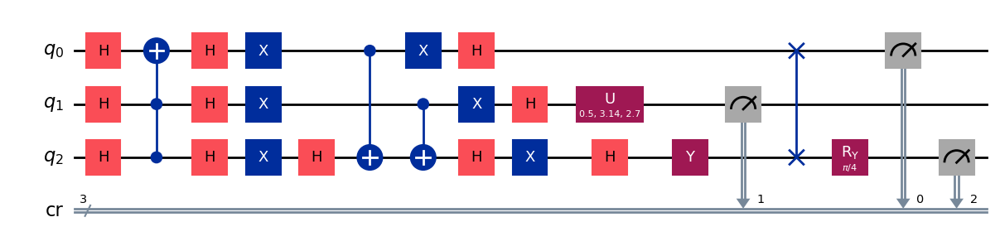

gen = 0 , Best fitness = (0.9172,)
gen = 1 , Best fitness = (0.9172,) , Number of invalids = 0

[Run 2 | Gen 70/99] Best Fitness: 0.9172 | Fidelity: 0.6960 | Gates: 31


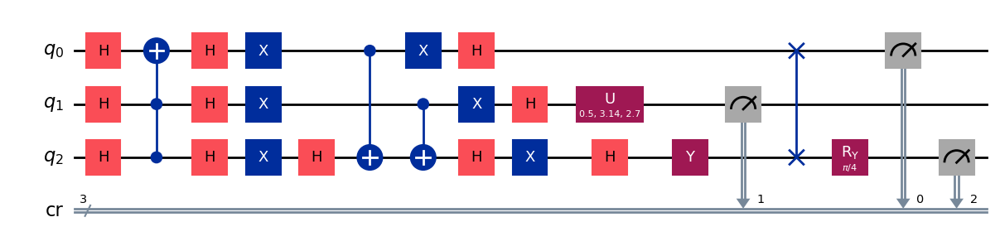

gen = 0 , Best fitness = (0.9172,)
gen = 1 , Best fitness = (0.9172,) , Number of invalids = 0

[Run 2 | Gen 71/99] Best Fitness: 0.9172 | Fidelity: 0.7028 | Gates: 31


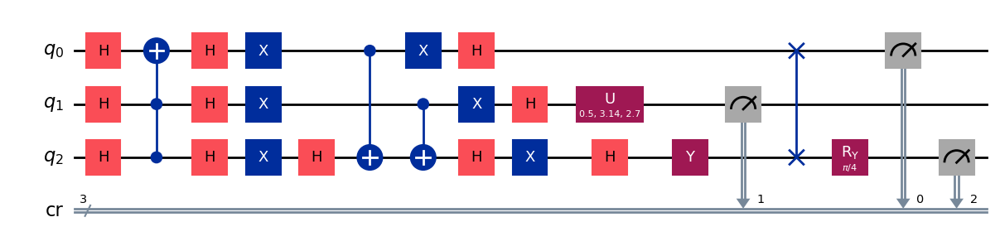

gen = 0 , Best fitness = (0.9172,)
gen = 1 , Best fitness = (0.8912,) , Number of invalids = 0

[Run 2 | Gen 72/99] Best Fitness: 0.8912 | Fidelity: 0.7686 | Gates: 33


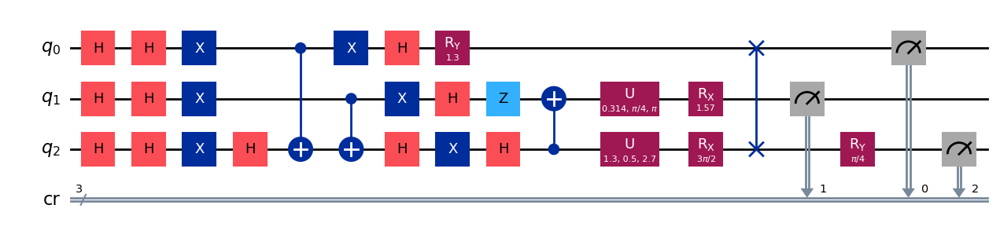

gen = 0 , Best fitness = (0.8912,)
gen = 1 , Best fitness = (0.8912,) , Number of invalids = 0

[Run 2 | Gen 73/99] Best Fitness: 0.8912 | Fidelity: 0.7750 | Gates: 33


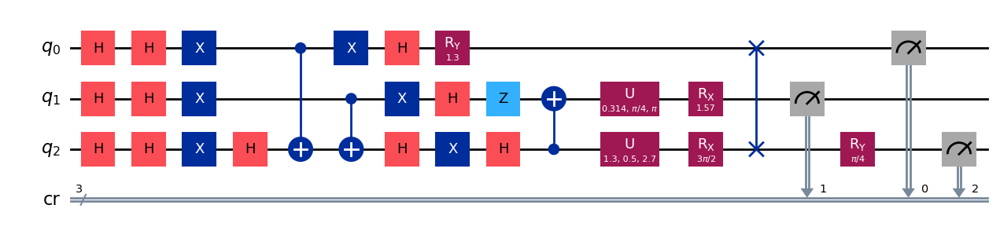

gen = 0 , Best fitness = (0.8912,)
gen = 1 , Best fitness = (0.8901,) , Number of invalids = 0

[Run 2 | Gen 74/99] Best Fitness: 0.8901 | Fidelity: 0.7687 | Gates: 33


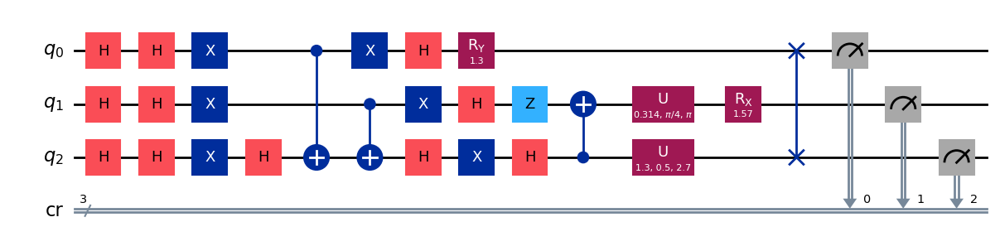

gen = 0 , Best fitness = (0.8901,)
gen = 1 , Best fitness = (0.889,) , Number of invalids = 0

[Run 2 | Gen 75/99] Best Fitness: 0.8890 | Fidelity: 0.7699 | Gates: 33


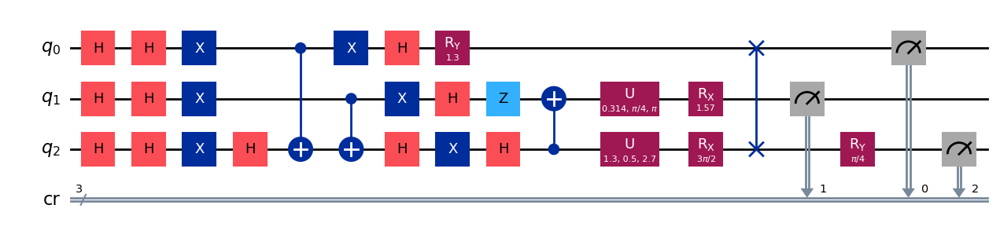

gen = 0 , Best fitness = (0.889,)
gen = 1 , Best fitness = (0.8842,) , Number of invalids = 0

[Run 2 | Gen 76/99] Best Fitness: 0.8842 | Fidelity: 0.7634 | Gates: 33


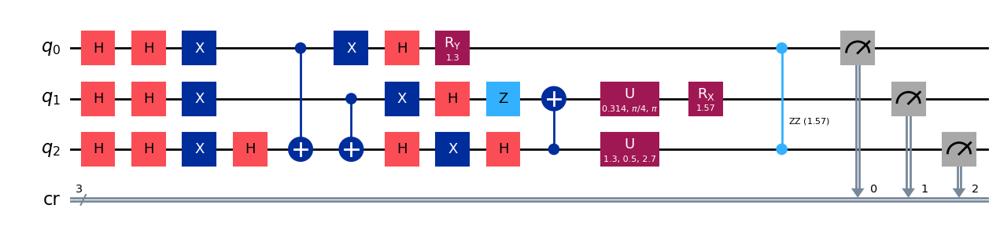

gen = 0 , Best fitness = (0.8842,)
gen = 1 , Best fitness = (0.7971,) , Number of invalids = 0

[Run 2 | Gen 77/99] Best Fitness: 0.7971 | Fidelity: 0.7688 | Gates: 28


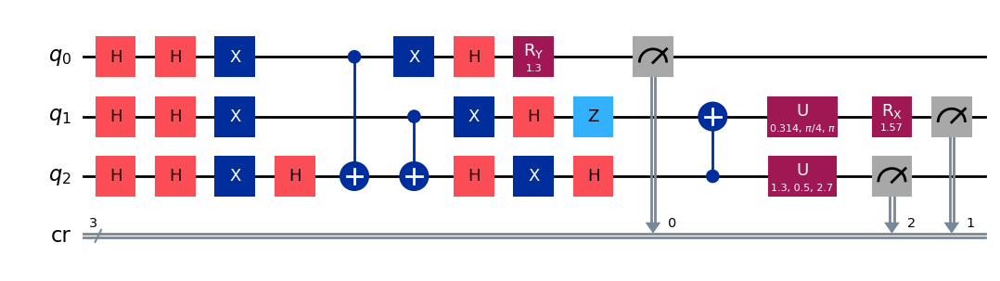

gen = 0 , Best fitness = (0.7971,)
gen = 1 , Best fitness = (0.7605000000000001,) , Number of invalids = 0

[Run 2 | Gen 78/99] Best Fitness: 0.7605 | Fidelity: 0.8997 | Gates: 33


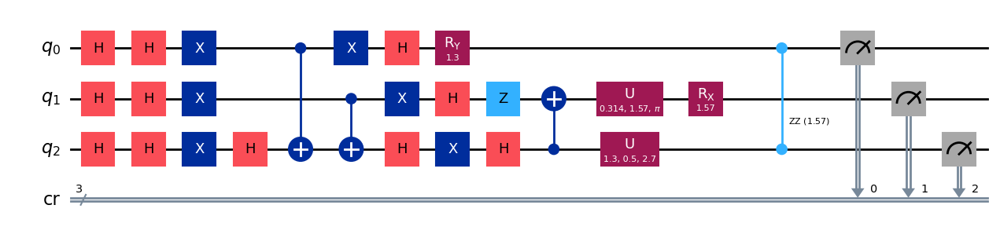

gen = 0 , Best fitness = (0.7605000000000001,)
gen = 1 , Best fitness = (0.7605000000000001,) , Number of invalids = 0

[Run 2 | Gen 79/99] Best Fitness: 0.7605 | Fidelity: 0.8987 | Gates: 33


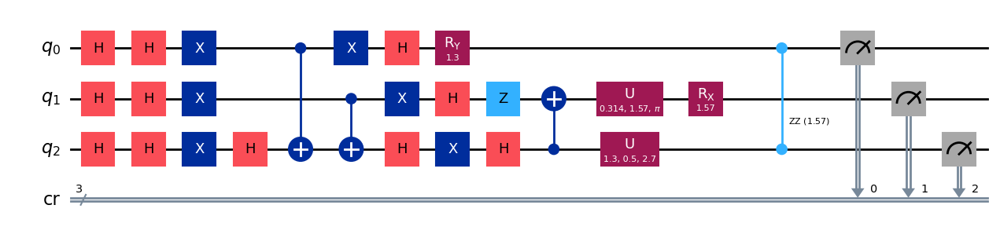

gen = 0 , Best fitness = (0.7605000000000001,)
gen = 1 , Best fitness = (0.7605000000000001,) , Number of invalids = 0

[Run 2 | Gen 80/99] Best Fitness: 0.7605 | Fidelity: 0.8949 | Gates: 33


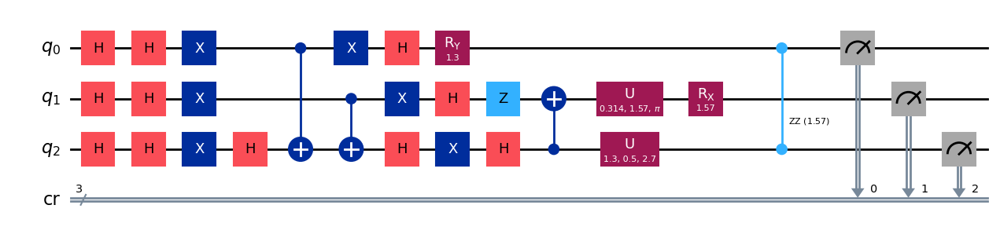

gen = 0 , Best fitness = (0.7605000000000001,)
gen = 1 , Best fitness = (0.7586,) , Number of invalids = 0

[Run 2 | Gen 81/99] Best Fitness: 0.7586 | Fidelity: 0.8964 | Gates: 33


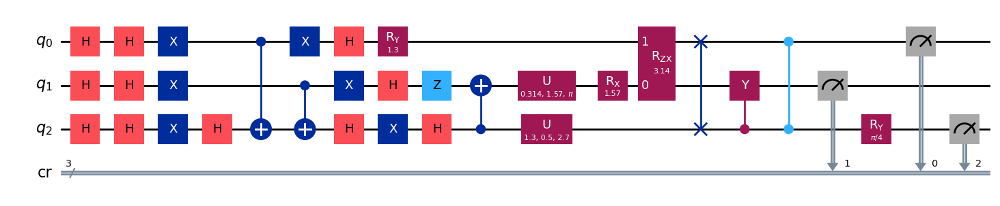

gen = 0 , Best fitness = (0.7586,)
gen = 1 , Best fitness = (0.7409,) , Number of invalids = 0

[Run 2 | Gen 82/99] Best Fitness: 0.7409 | Fidelity: 0.9235 | Gates: 33


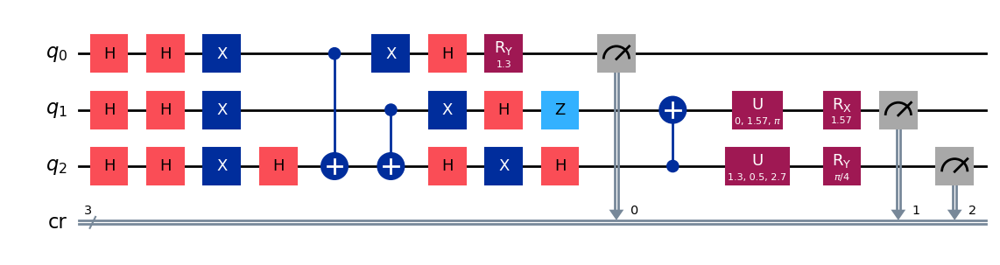

gen = 0 , Best fitness = (0.7409,)
gen = 1 , Best fitness = (0.6655000000000001,) , Number of invalids = 0

[Run 2 | Gen 83/99] Best Fitness: 0.6655 | Fidelity: 0.8935 | Gates: 28


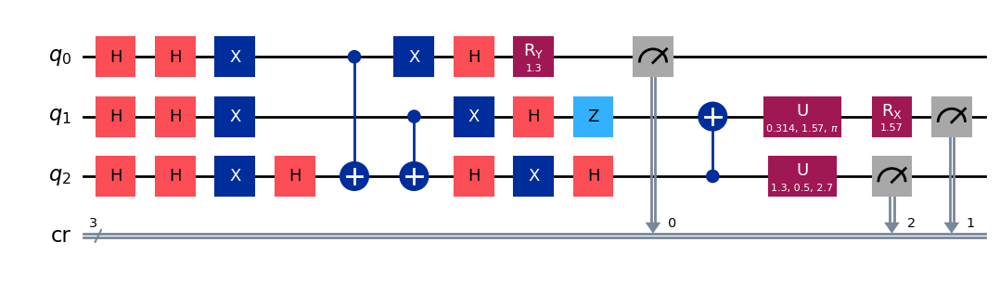

gen = 0 , Best fitness = (0.6655000000000001,)
gen = 1 , Best fitness = (0.6655000000000001,) , Number of invalids = 0

[Run 2 | Gen 84/99] Best Fitness: 0.6655 | Fidelity: 0.8943 | Gates: 28


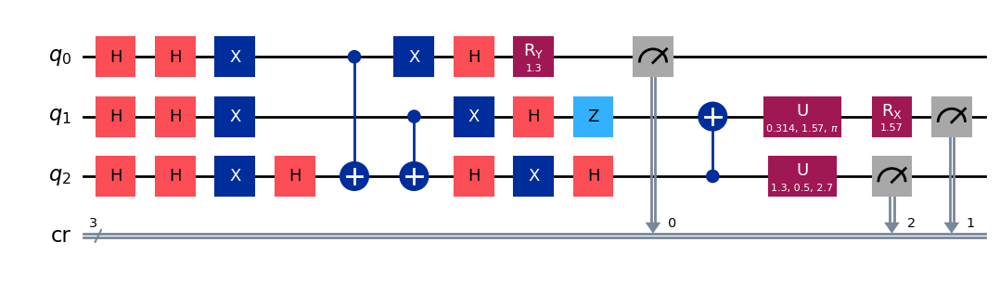

gen = 0 , Best fitness = (0.6655000000000001,)
gen = 1 , Best fitness = (0.6624000000000001,) , Number of invalids = 0

[Run 2 | Gen 85/99] Best Fitness: 0.6624 | Fidelity: 0.8897 | Gates: 28


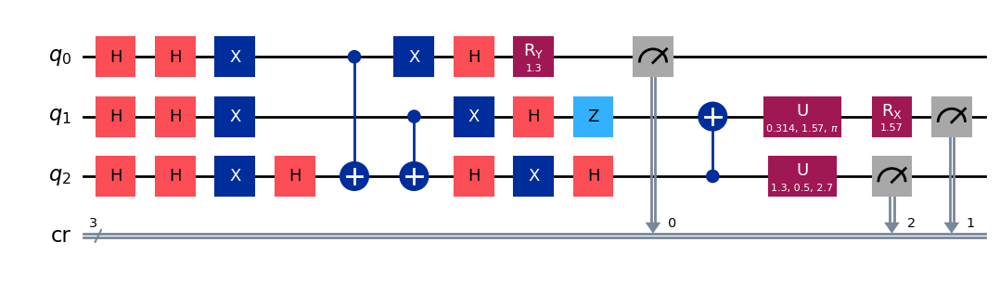

gen = 0 , Best fitness = (0.6624000000000001,)
gen = 1 , Best fitness = (0.6624000000000001,) , Number of invalids = 0

[Run 2 | Gen 86/99] Best Fitness: 0.6624 | Fidelity: 0.8966 | Gates: 28


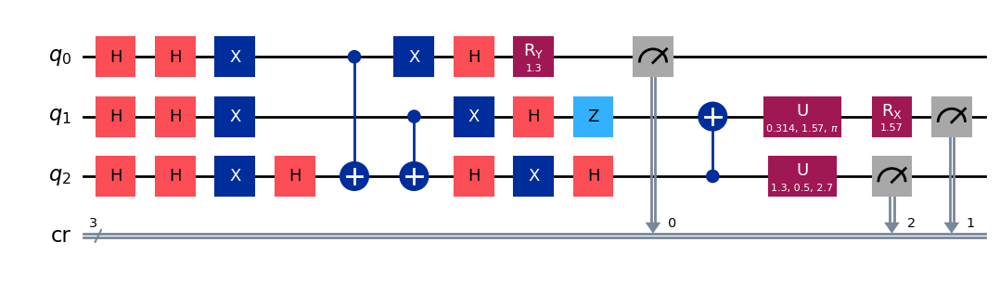

gen = 0 , Best fitness = (0.6624000000000001,)
gen = 1 , Best fitness = (0.6624000000000001,) , Number of invalids = 0

[Run 2 | Gen 87/99] Best Fitness: 0.6624 | Fidelity: 0.8960 | Gates: 28


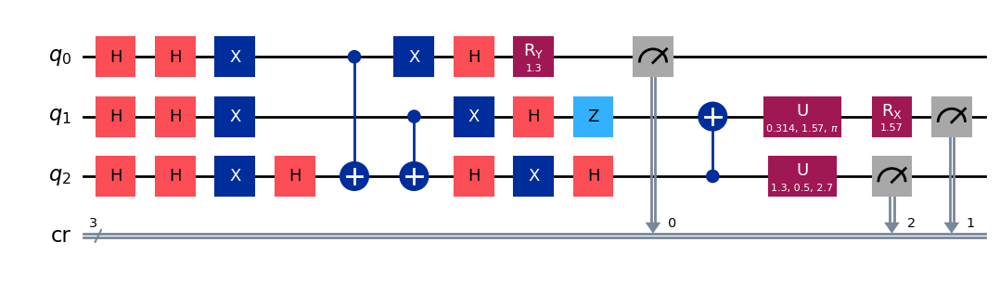

gen = 0 , Best fitness = (0.6624000000000001,)
gen = 1 , Best fitness = (0.6219,) , Number of invalids = 0

[Run 2 | Gen 88/99] Best Fitness: 0.6219 | Fidelity: 0.9417 | Gates: 28


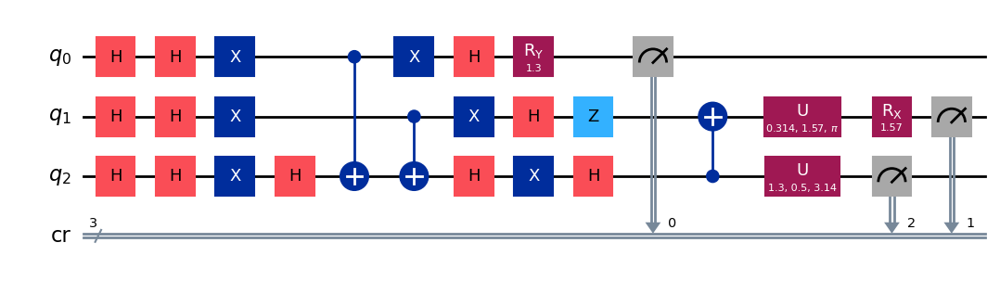

gen = 0 , Best fitness = (0.6219,)
gen = 1 , Best fitness = (0.6175,) , Number of invalids = 0

[Run 2 | Gen 89/99] Best Fitness: 0.6175 | Fidelity: 0.9402 | Gates: 28


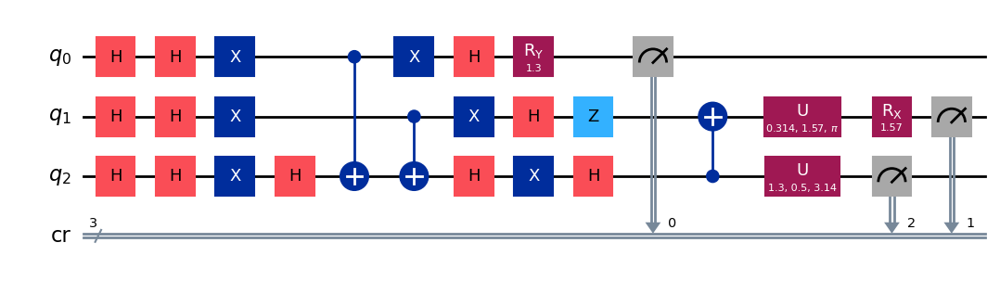

gen = 0 , Best fitness = (0.6175,)
gen = 1 , Best fitness = (0.6168,) , Number of invalids = 0

[Run 2 | Gen 90/99] Best Fitness: 0.6168 | Fidelity: 0.9418 | Gates: 28


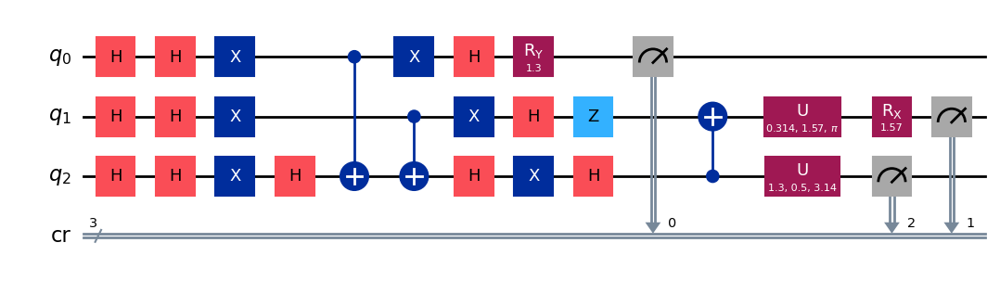

gen = 0 , Best fitness = (0.6168,)
gen = 1 , Best fitness = (0.6023000000000001,) , Number of invalids = 0

[Run 2 | Gen 91/99] Best Fitness: 0.6023 | Fidelity: 0.9582 | Gates: 28


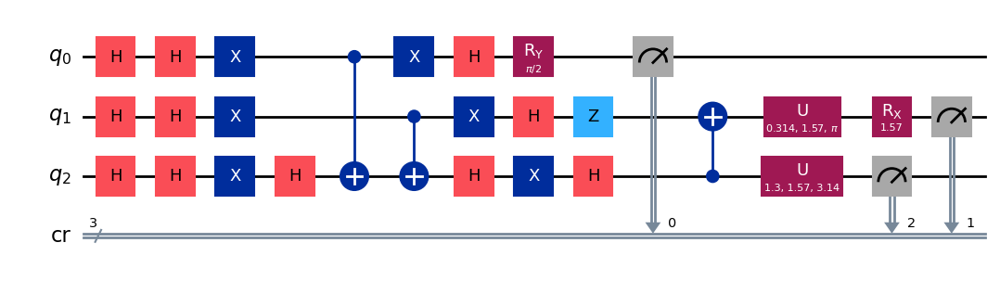

gen = 0 , Best fitness = (0.6023000000000001,)
gen = 1 , Best fitness = (0.5954,) , Number of invalids = 0

[Run 2 | Gen 92/99] Best Fitness: 0.5954 | Fidelity: 0.9655 | Gates: 28


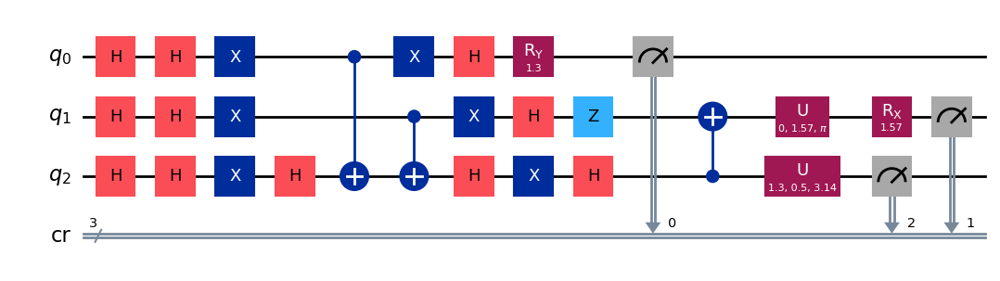

gen = 0 , Best fitness = (0.5954,)
gen = 1 , Best fitness = (0.5954,) , Number of invalids = 0

[Run 2 | Gen 93/99] Best Fitness: 0.5954 | Fidelity: 0.9632 | Gates: 28


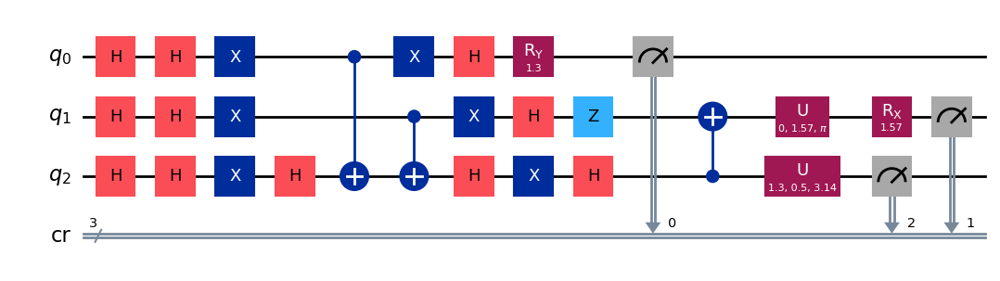

gen = 0 , Best fitness = (0.5954,)
gen = 1 , Best fitness = (0.5954,) , Number of invalids = 0

[Run 2 | Gen 94/99] Best Fitness: 0.5954 | Fidelity: 0.9657 | Gates: 28


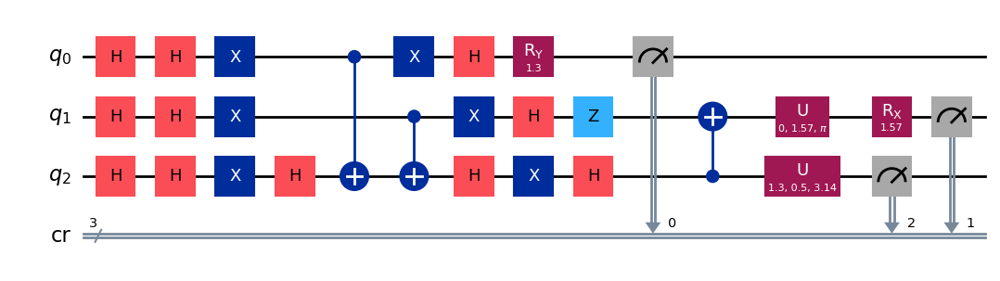

gen = 0 , Best fitness = (0.5954,)
gen = 1 , Best fitness = (0.5954,) , Number of invalids = 0

[Run 2 | Gen 95/99] Best Fitness: 0.5954 | Fidelity: 0.9661 | Gates: 28


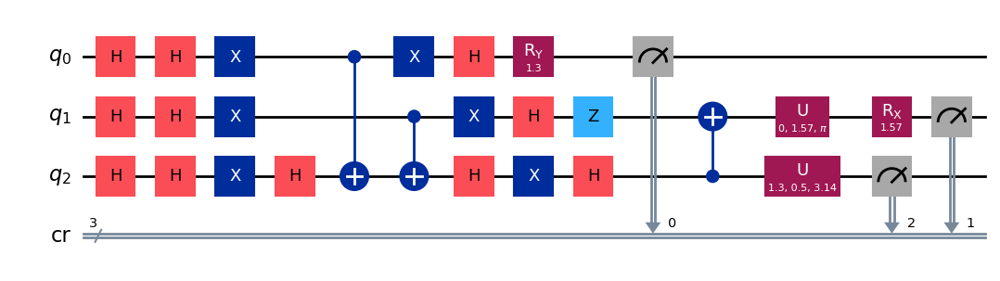

gen = 0 , Best fitness = (0.5954,)
gen = 1 , Best fitness = (0.5939000000000001,) , Number of invalids = 0

[Run 2 | Gen 96/99] Best Fitness: 0.5939 | Fidelity: 0.9614 | Gates: 28


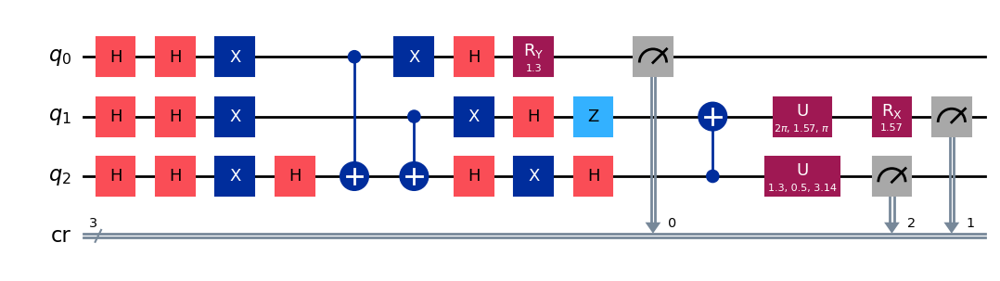

gen = 0 , Best fitness = (0.5939000000000001,)
gen = 1 , Best fitness = (0.5939000000000001,) , Number of invalids = 0

[Run 2 | Gen 97/99] Best Fitness: 0.5939 | Fidelity: 0.9635 | Gates: 28


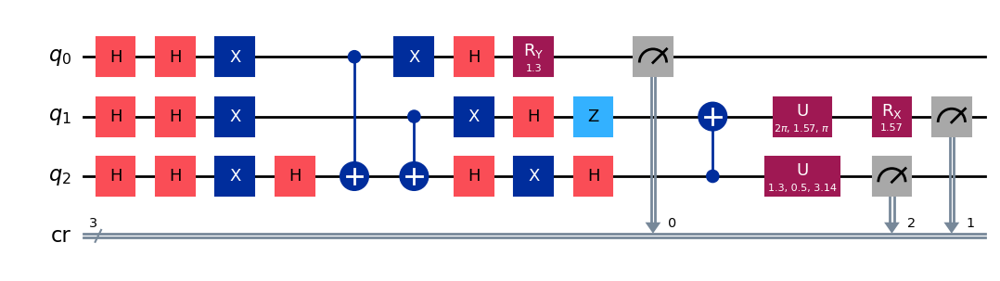

gen = 0 , Best fitness = (0.5939000000000001,)
gen = 1 , Best fitness = (0.5779000000000001,) , Number of invalids = 0

[Run 2 | Gen 98/99] Best Fitness: 0.5779 | Fidelity: 0.9824 | Gates: 28


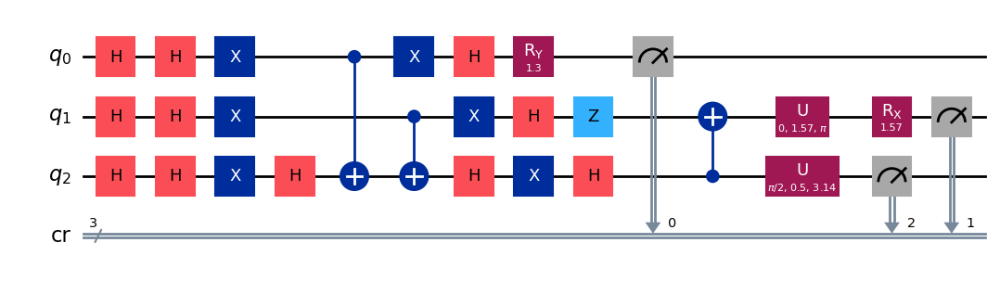

gen = 0 , Best fitness = (0.5779000000000001,)
gen = 1 , Best fitness = (0.5779000000000001,) , Number of invalids = 0

[Run 2 | Gen 99/99] Best Fitness: 0.5779 | Fidelity: 0.9829 | Gates: 28


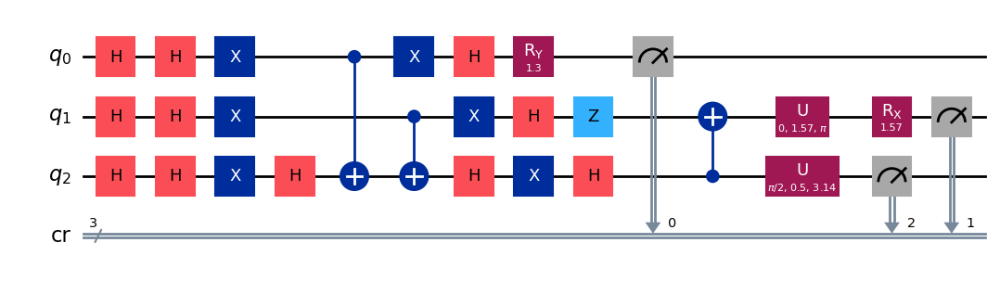


Generating evolution plots for Run 2...
✓ Plot saved to: experiments_state_101/run_2_seed_15775/evolution_metrics_run_2.png


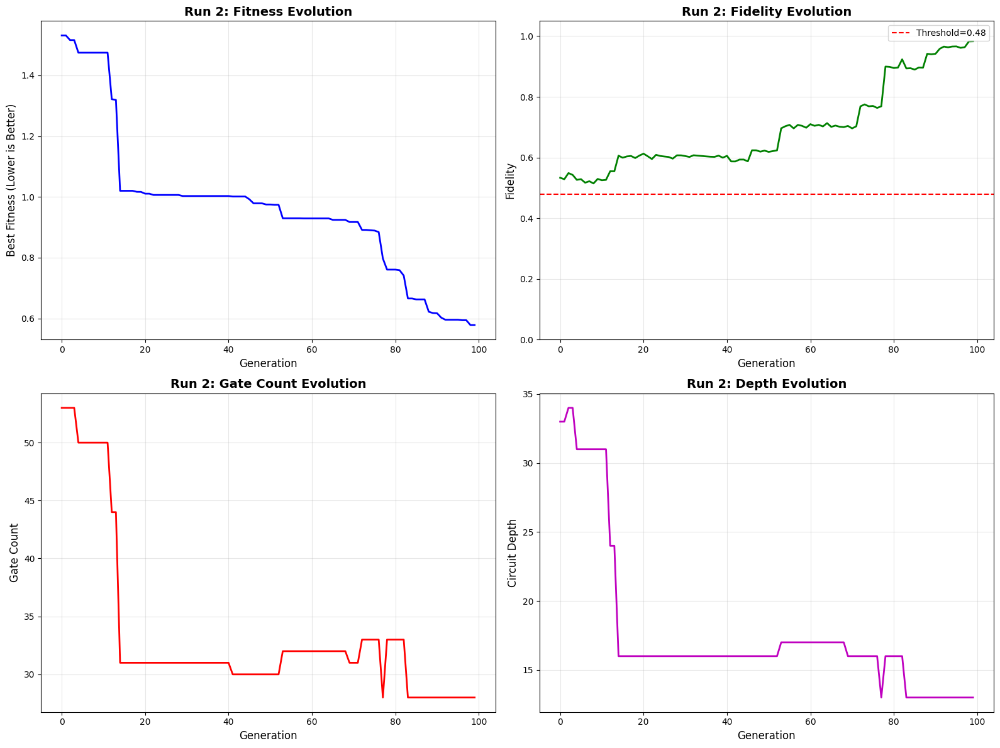


✓ Run 2 COMPLETE | Fidelity: 0.9810 | Gates: 28 | Depth: 13


RUN 3/5 | Target: 101 | Seed: 52596
✓ Logging to: experiments_state_101/run_3_seed_52596
✓ Starting evolution (Population: 1000, Generations: 100)
gen = 0 , Best fitness = (2.3937,)
gen = 1 , Best fitness = (2.3937,) , Number of invalids = 144

[Run 3 | Gen 0/99] Best Fitness: 2.3937 | Fidelity: 0.5852 | Gates: 99


/Users/admin/Downloads/GE_Grover/.venv/lib/python3.10/site-packages/numpy/_core/_methods.py:191: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


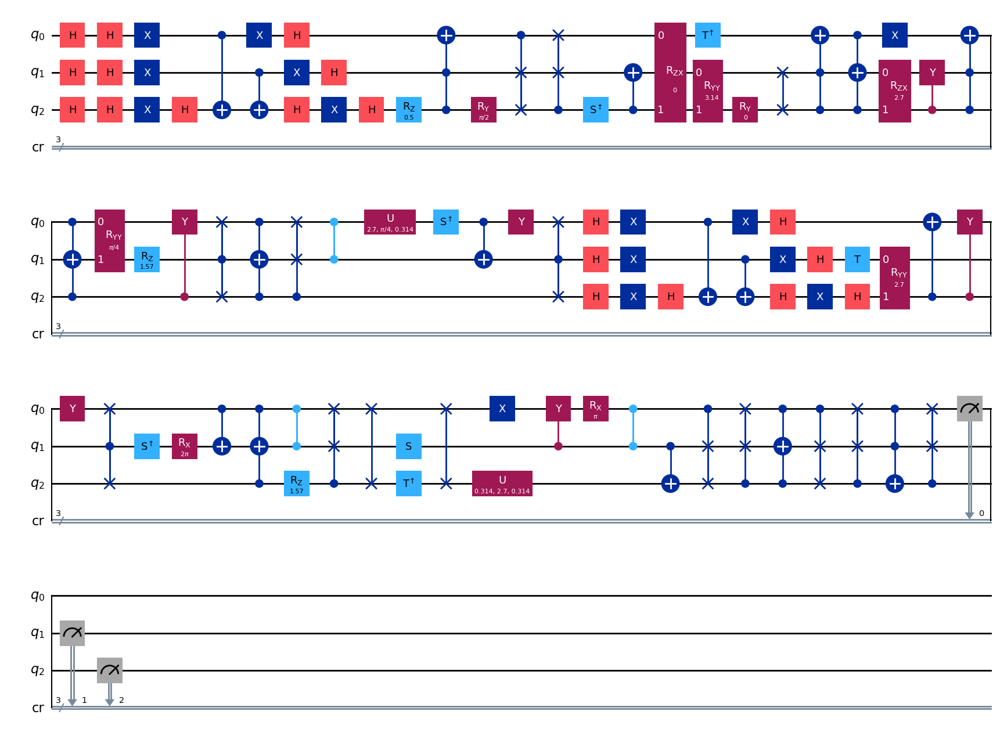

gen = 0 , Best fitness = (2.3937,)
gen = 1 , Best fitness = (2.3937,) , Number of invalids = 80

[Run 3 | Gen 1/99] Best Fitness: 2.3937 | Fidelity: 0.5834 | Gates: 99


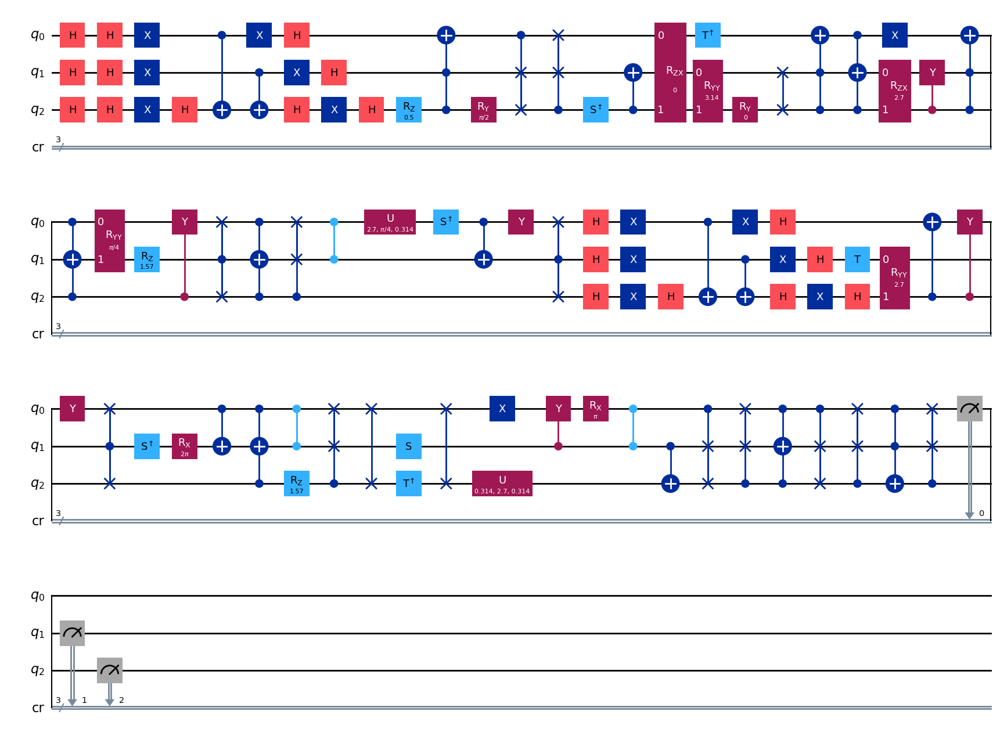

gen = 0 , Best fitness = (2.3937,)
gen = 1 , Best fitness = (2.3937,) , Number of invalids = 68

[Run 3 | Gen 2/99] Best Fitness: 2.3937 | Fidelity: 0.5848 | Gates: 99


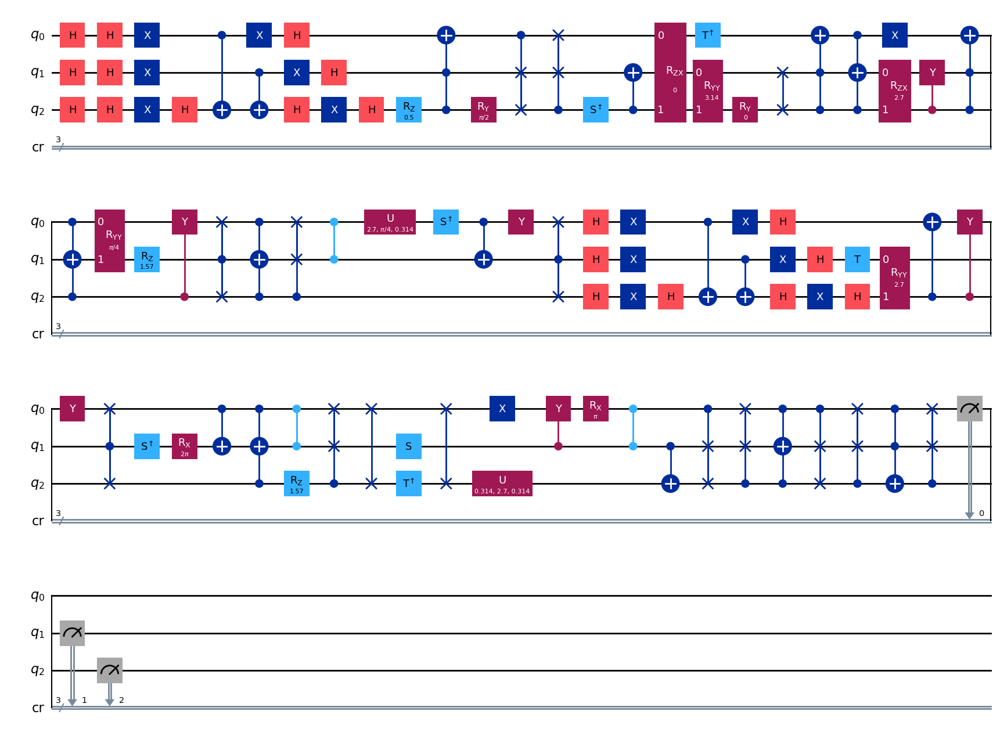

gen = 0 , Best fitness = (2.3937,)
gen = 1 , Best fitness = (2.3937,) , Number of invalids = 52

[Run 3 | Gen 3/99] Best Fitness: 2.3937 | Fidelity: 0.5829 | Gates: 99


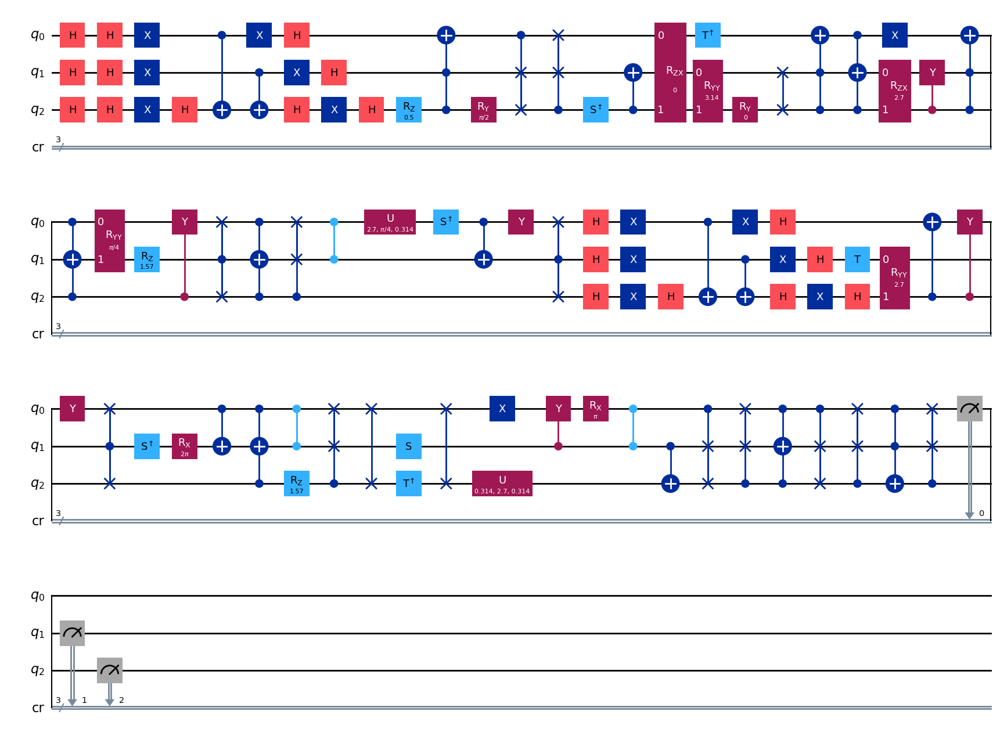

gen = 0 , Best fitness = (2.3937,)
gen = 1 , Best fitness = (2.3937,) , Number of invalids = 45

[Run 3 | Gen 4/99] Best Fitness: 2.3937 | Fidelity: 0.5763 | Gates: 99


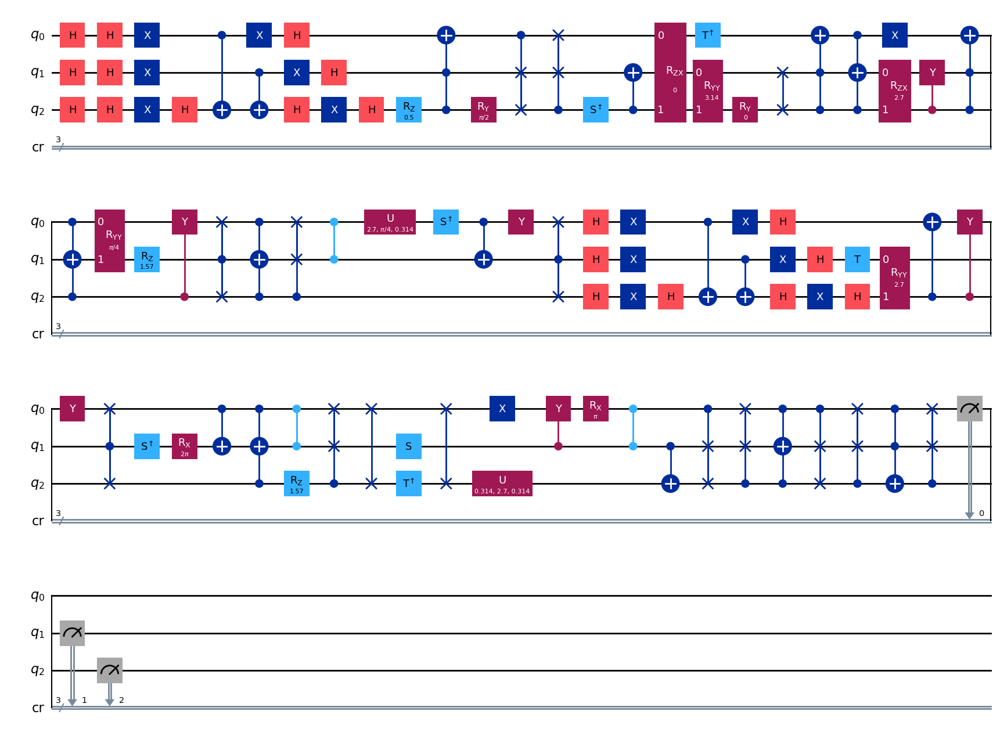

gen = 0 , Best fitness = (2.3937,)
gen = 1 , Best fitness = (2.3937,) , Number of invalids = 56

[Run 3 | Gen 5/99] Best Fitness: 2.3937 | Fidelity: 0.5864 | Gates: 99


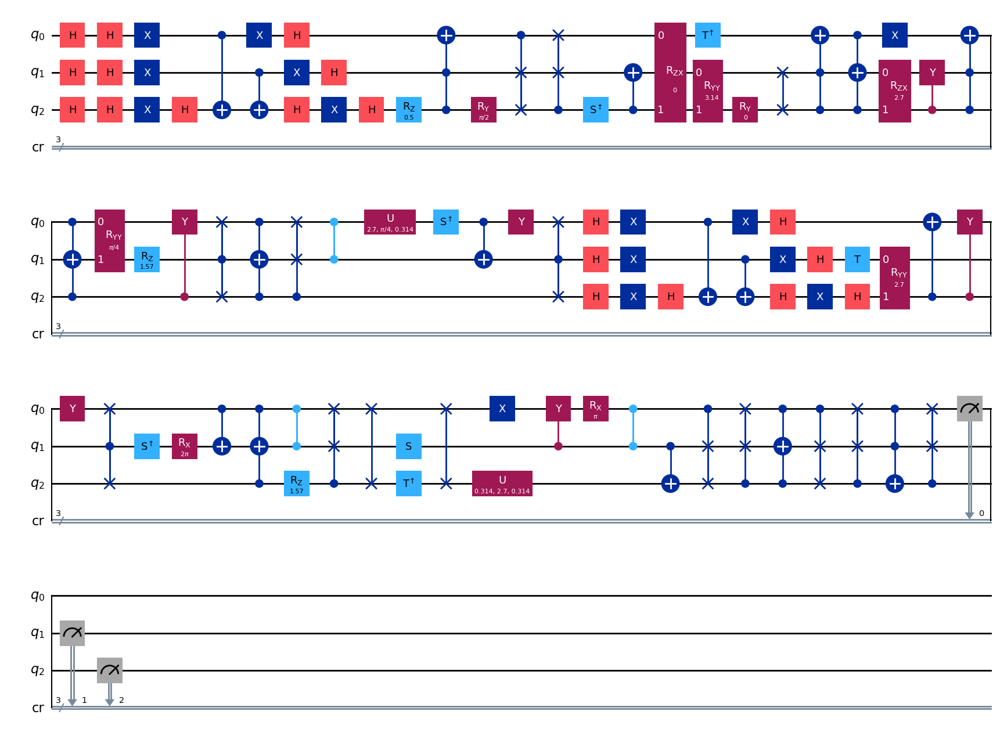

gen = 0 , Best fitness = (2.3937,)
gen = 1 , Best fitness = (2.3937,) , Number of invalids = 53

[Run 3 | Gen 6/99] Best Fitness: 2.3937 | Fidelity: 0.5884 | Gates: 99


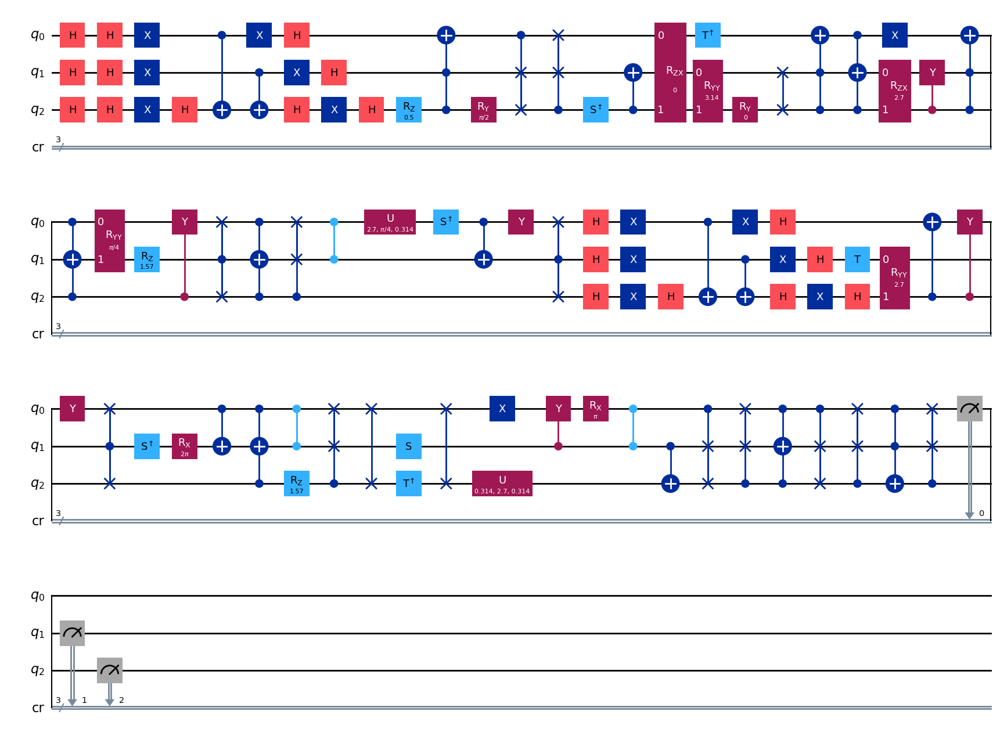

gen = 0 , Best fitness = (2.3937,)
gen = 1 , Best fitness = (2.3937,) , Number of invalids = 55

[Run 3 | Gen 7/99] Best Fitness: 2.3937 | Fidelity: 0.5815 | Gates: 99


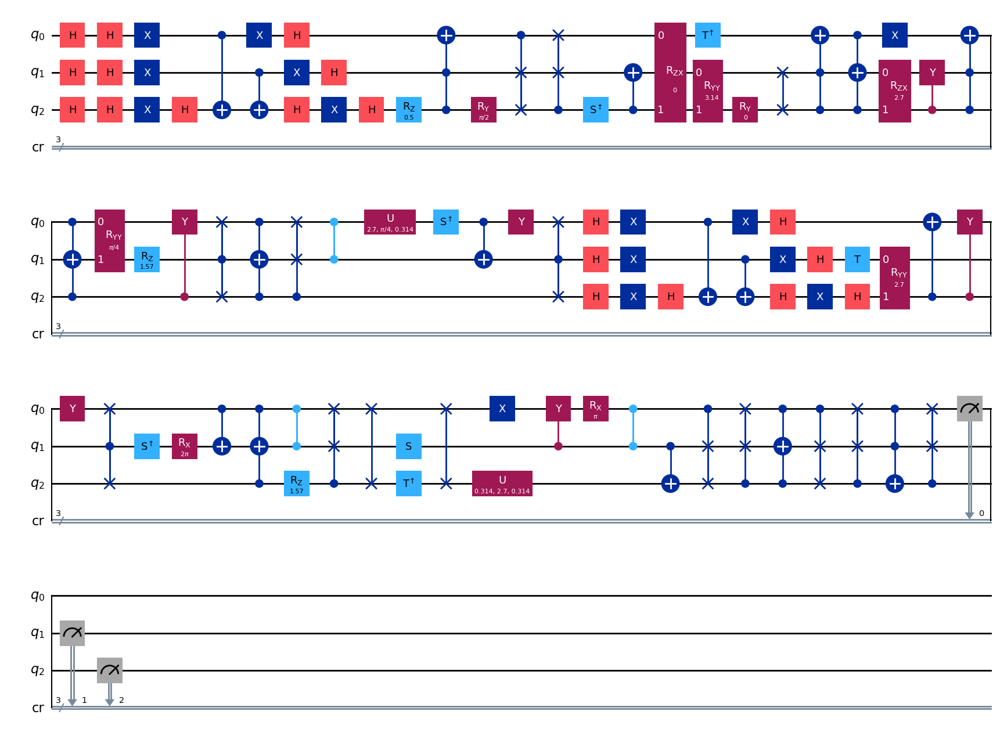

gen = 0 , Best fitness = (2.3937,)
gen = 1 , Best fitness = (2.3937,) , Number of invalids = 44

[Run 3 | Gen 8/99] Best Fitness: 2.3937 | Fidelity: 0.5802 | Gates: 99


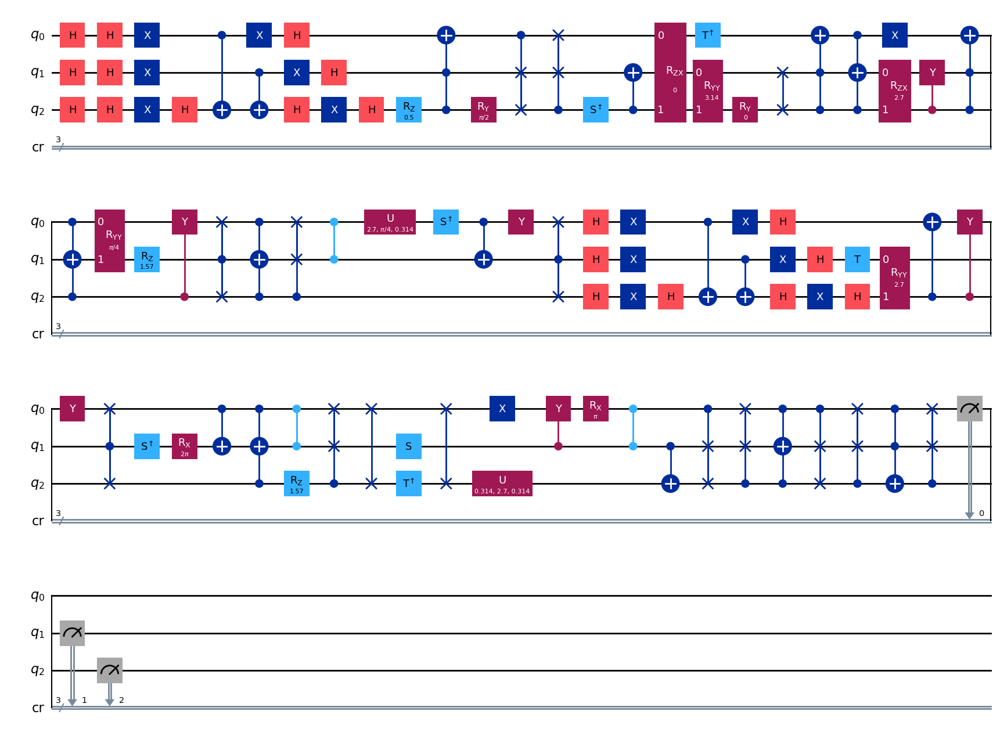

gen = 0 , Best fitness = (2.3937,)
gen = 1 , Best fitness = (2.3937,) , Number of invalids = 37

[Run 3 | Gen 9/99] Best Fitness: 2.3937 | Fidelity: 0.5818 | Gates: 99


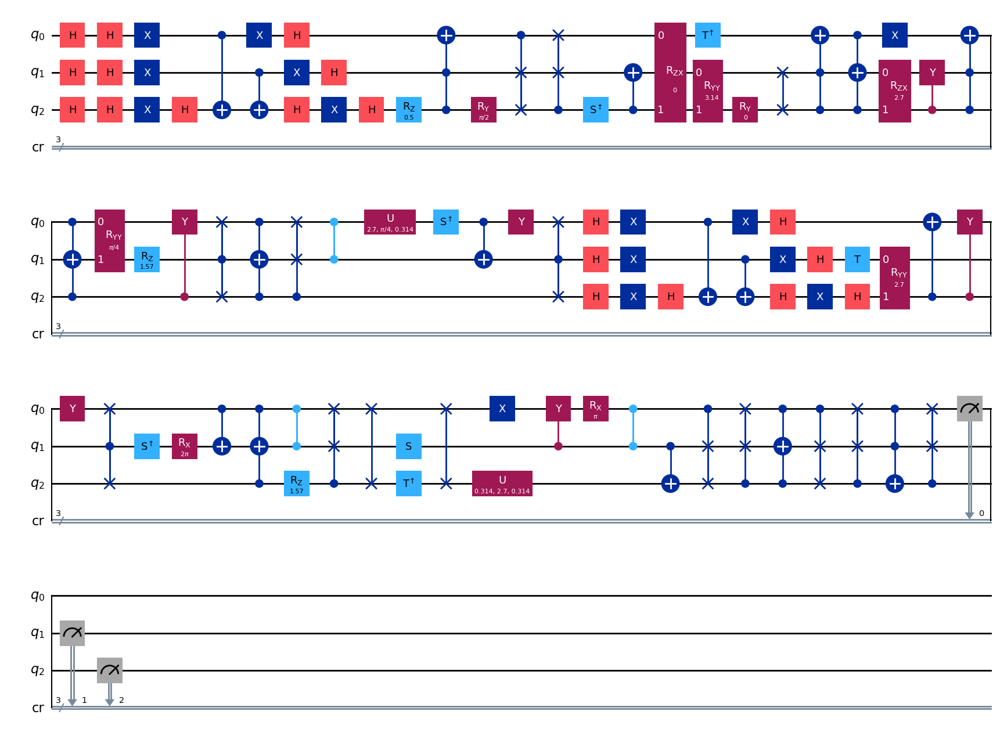

gen = 0 , Best fitness = (2.3937,)
gen = 1 , Best fitness = (1.9138,) , Number of invalids = 49

[Run 3 | Gen 10/99] Best Fitness: 1.9138 | Fidelity: 0.5737 | Gates: 75


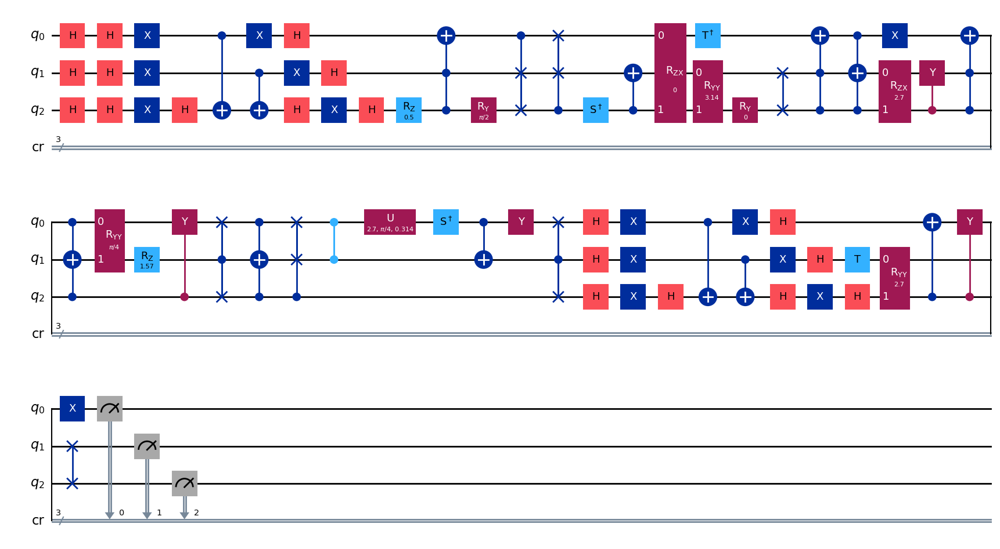

gen = 0 , Best fitness = (1.9138,)
gen = 1 , Best fitness = (0.9733999999999999,) , Number of invalids = 45

[Run 3 | Gen 11/99] Best Fitness: 0.9734 | Fidelity: 0.6074 | Gates: 29


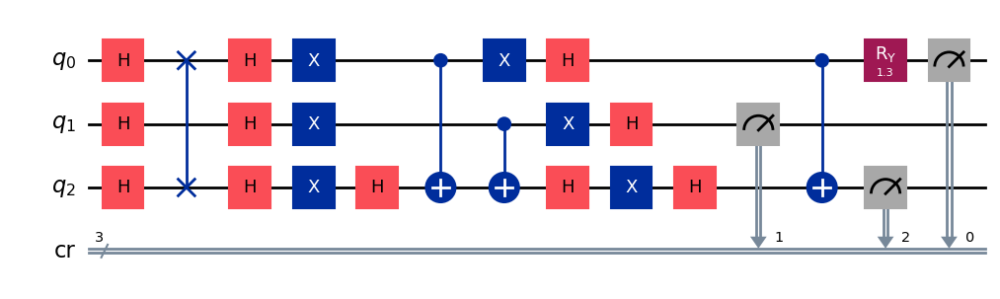

gen = 0 , Best fitness = (0.9733999999999999,)
gen = 1 , Best fitness = (0.9733999999999999,) , Number of invalids = 58

[Run 3 | Gen 12/99] Best Fitness: 0.9734 | Fidelity: 0.6041 | Gates: 29


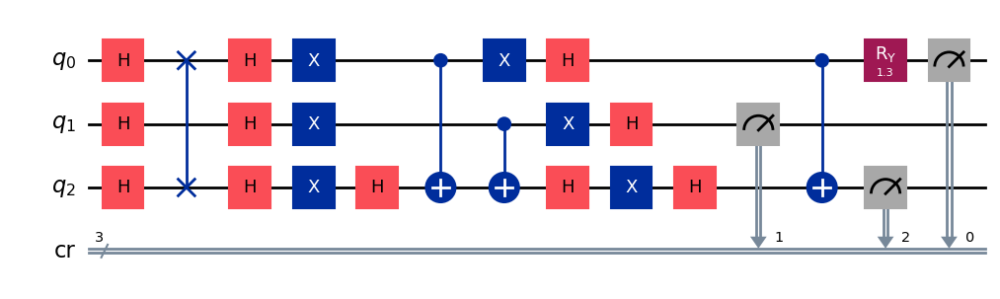

gen = 0 , Best fitness = (0.9733999999999999,)
gen = 1 , Best fitness = (0.968,) , Number of invalids = 67

[Run 3 | Gen 13/99] Best Fitness: 0.9680 | Fidelity: 0.6109 | Gates: 29


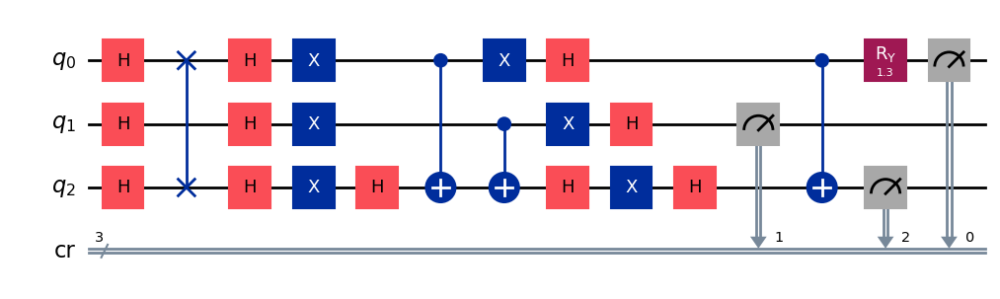

gen = 0 , Best fitness = (0.968,)
gen = 1 , Best fitness = (0.968,) , Number of invalids = 63

[Run 3 | Gen 14/99] Best Fitness: 0.9680 | Fidelity: 0.6083 | Gates: 29


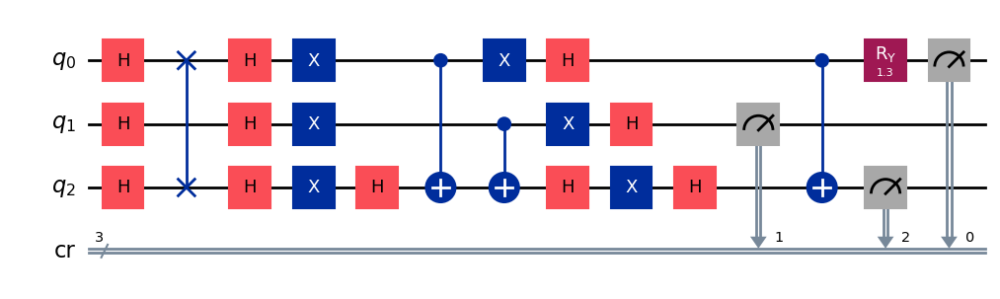

gen = 0 , Best fitness = (0.968,)
gen = 1 , Best fitness = (0.968,) , Number of invalids = 60

[Run 3 | Gen 15/99] Best Fitness: 0.9680 | Fidelity: 0.6041 | Gates: 29


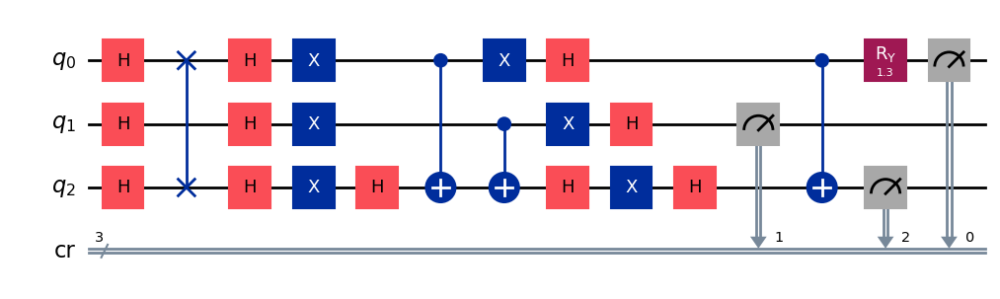

gen = 0 , Best fitness = (0.968,)
gen = 1 , Best fitness = (0.968,) , Number of invalids = 66

[Run 3 | Gen 16/99] Best Fitness: 0.9680 | Fidelity: 0.6059 | Gates: 29


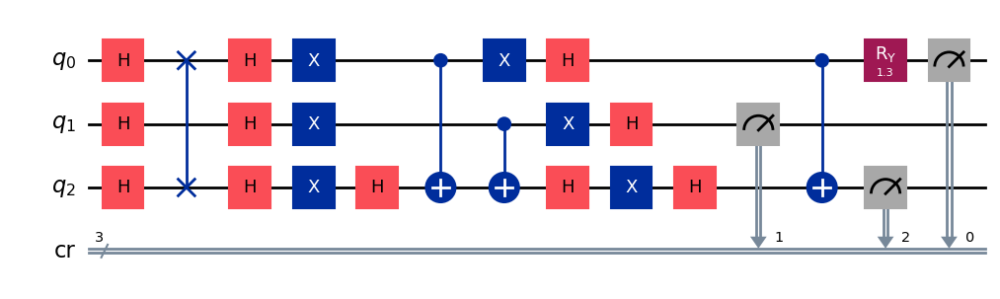

gen = 0 , Best fitness = (0.968,)
gen = 1 , Best fitness = (0.9673999999999999,) , Number of invalids = 50

[Run 3 | Gen 17/99] Best Fitness: 0.9674 | Fidelity: 0.6084 | Gates: 29


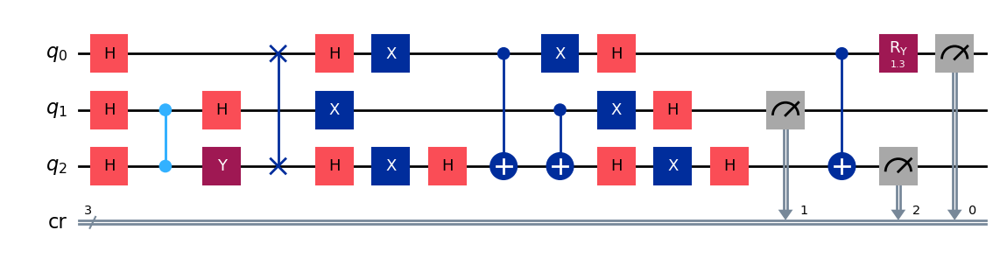

gen = 0 , Best fitness = (0.9673999999999999,)
gen = 1 , Best fitness = (0.9673999999999999,) , Number of invalids = 44

[Run 3 | Gen 18/99] Best Fitness: 0.9674 | Fidelity: 0.6019 | Gates: 29


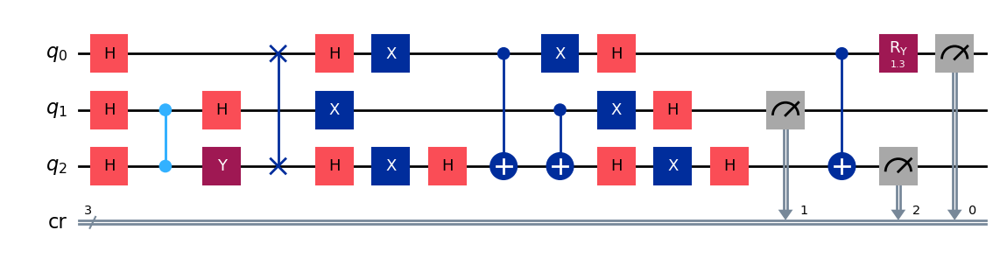

gen = 0 , Best fitness = (0.9673999999999999,)
gen = 1 , Best fitness = (0.9672999999999999,) , Number of invalids = 35

[Run 3 | Gen 19/99] Best Fitness: 0.9673 | Fidelity: 0.5875 | Gates: 29


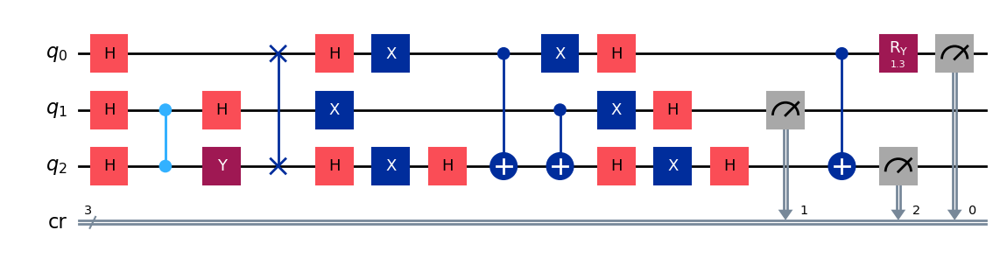

gen = 0 , Best fitness = (0.9672999999999999,)
gen = 1 , Best fitness = (0.9672999999999999,) , Number of invalids = 41

[Run 3 | Gen 20/99] Best Fitness: 0.9673 | Fidelity: 0.6027 | Gates: 29


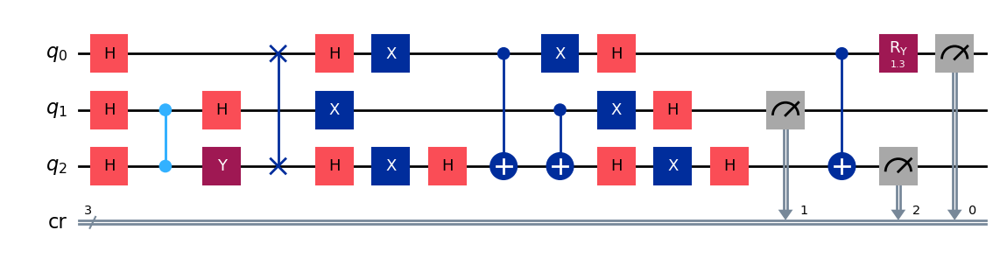

gen = 0 , Best fitness = (0.9672999999999999,)
gen = 1 , Best fitness = (0.9672999999999999,) , Number of invalids = 27

[Run 3 | Gen 21/99] Best Fitness: 0.9673 | Fidelity: 0.6021 | Gates: 29


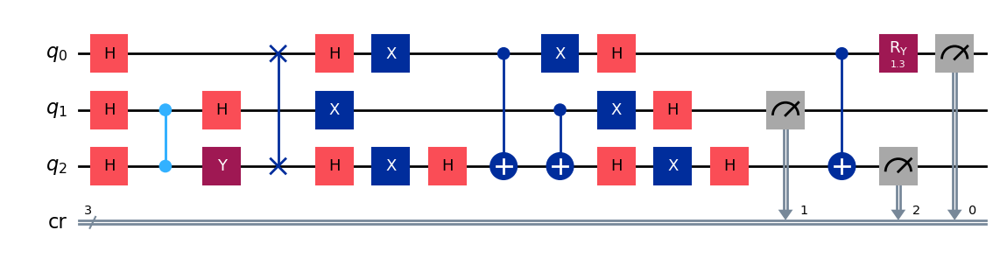

gen = 0 , Best fitness = (0.9672999999999999,)
gen = 1 , Best fitness = (0.9672999999999999,) , Number of invalids = 30

[Run 3 | Gen 22/99] Best Fitness: 0.9673 | Fidelity: 0.6103 | Gates: 29


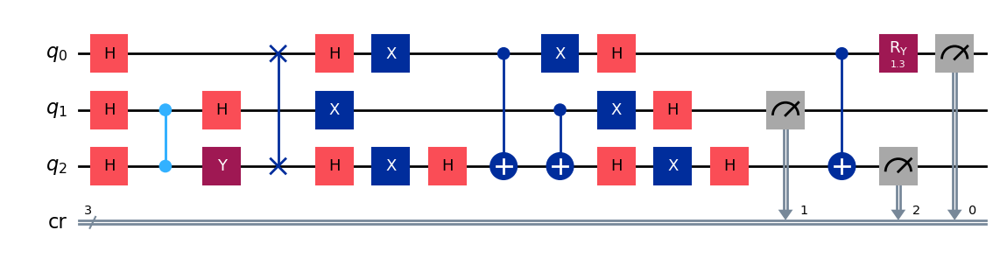

gen = 0 , Best fitness = (0.9672999999999999,)
gen = 1 , Best fitness = (0.9656,) , Number of invalids = 30

[Run 3 | Gen 23/99] Best Fitness: 0.9656 | Fidelity: 0.5937 | Gates: 29


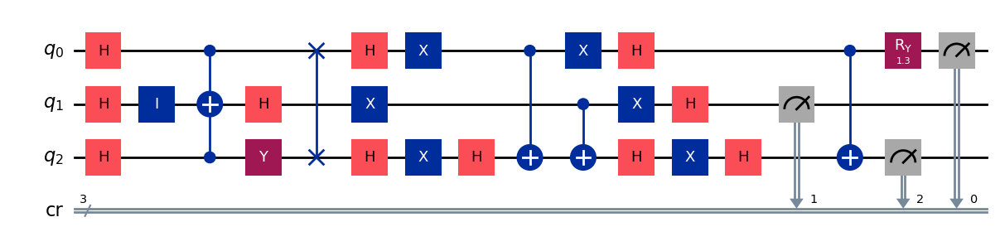

gen = 0 , Best fitness = (0.9656,)
gen = 1 , Best fitness = (0.9656,) , Number of invalids = 22

[Run 3 | Gen 24/99] Best Fitness: 0.9656 | Fidelity: 0.6114 | Gates: 29


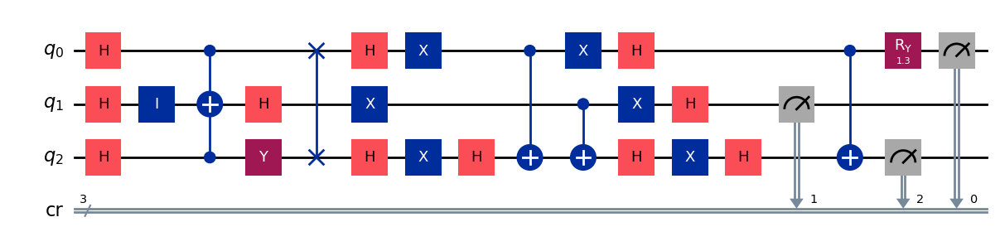

gen = 0 , Best fitness = (0.9656,)
gen = 1 , Best fitness = (0.9656,) , Number of invalids = 14

[Run 3 | Gen 25/99] Best Fitness: 0.9656 | Fidelity: 0.6008 | Gates: 29


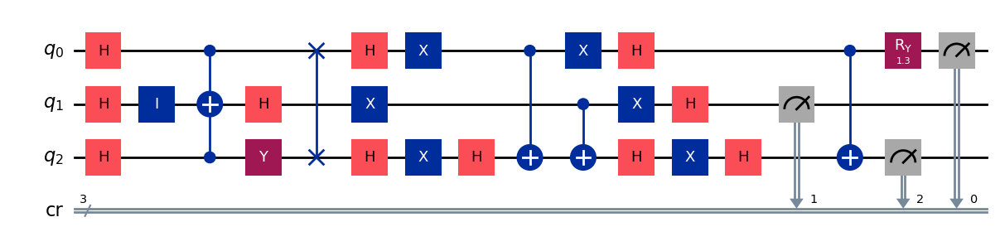

gen = 0 , Best fitness = (0.9656,)
gen = 1 , Best fitness = (0.9571999999999999,) , Number of invalids = 14

[Run 3 | Gen 26/99] Best Fitness: 0.9572 | Fidelity: 0.6269 | Gates: 29


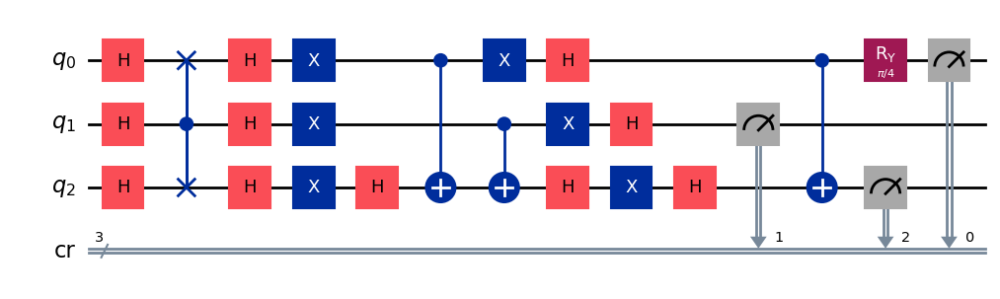

gen = 0 , Best fitness = (0.9571999999999999,)
gen = 1 , Best fitness = (0.9571999999999999,) , Number of invalids = 15

[Run 3 | Gen 27/99] Best Fitness: 0.9572 | Fidelity: 0.6184 | Gates: 29


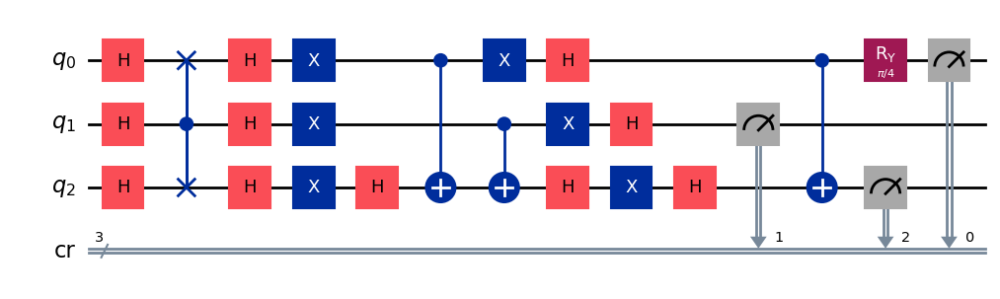

gen = 0 , Best fitness = (0.9571999999999999,)
gen = 1 , Best fitness = (0.9566,) , Number of invalids = 14

[Run 3 | Gen 28/99] Best Fitness: 0.9566 | Fidelity: 0.6233 | Gates: 29


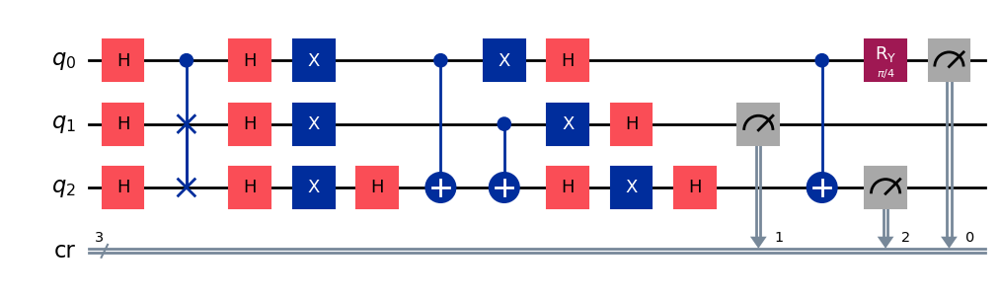

gen = 0 , Best fitness = (0.9566,)
gen = 1 , Best fitness = (0.9518,) , Number of invalids = 10

[Run 3 | Gen 29/99] Best Fitness: 0.9518 | Fidelity: 0.6245 | Gates: 29


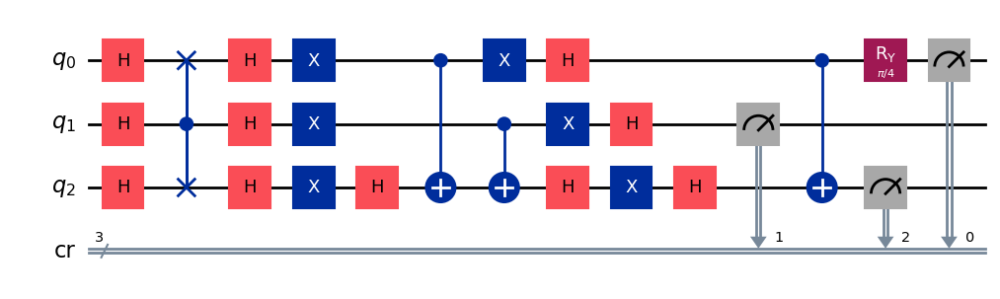

gen = 0 , Best fitness = (0.9518,)
gen = 1 , Best fitness = (0.9469,) , Number of invalids = 9

[Run 3 | Gen 30/99] Best Fitness: 0.9469 | Fidelity: 0.6285 | Gates: 29


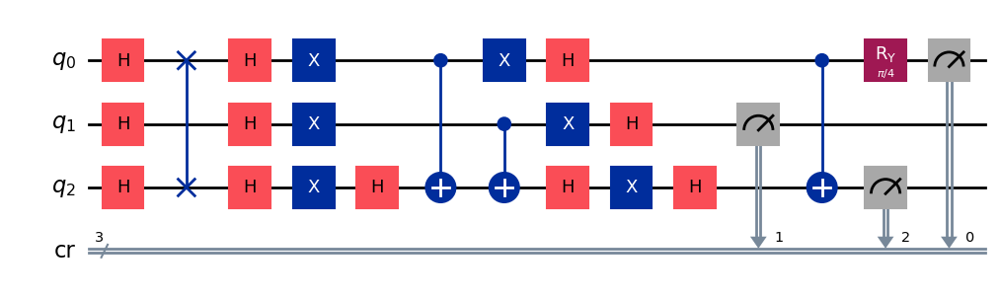

gen = 0 , Best fitness = (0.9469,)
gen = 1 , Best fitness = (0.9469,) , Number of invalids = 3

[Run 3 | Gen 31/99] Best Fitness: 0.9469 | Fidelity: 0.6274 | Gates: 29


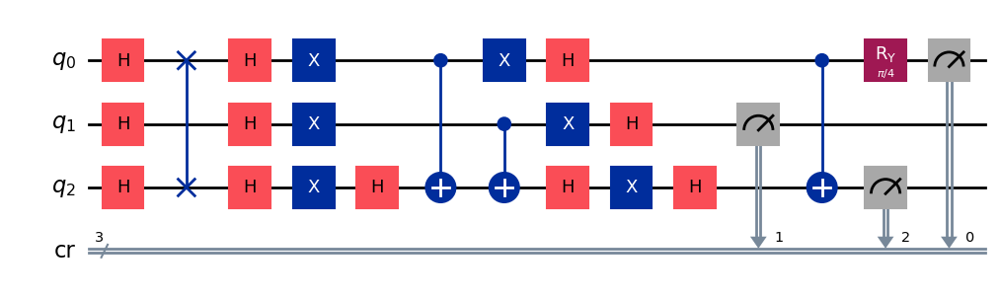

gen = 0 , Best fitness = (0.9469,)
gen = 1 , Best fitness = (0.9459,) , Number of invalids = 5

[Run 3 | Gen 32/99] Best Fitness: 0.9459 | Fidelity: 0.6194 | Gates: 29


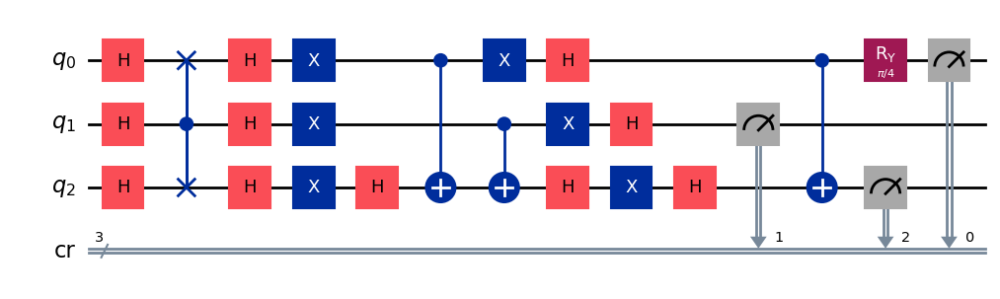

gen = 0 , Best fitness = (0.9459,)
gen = 1 , Best fitness = (0.9459,) , Number of invalids = 2

[Run 3 | Gen 33/99] Best Fitness: 0.9459 | Fidelity: 0.6222 | Gates: 29


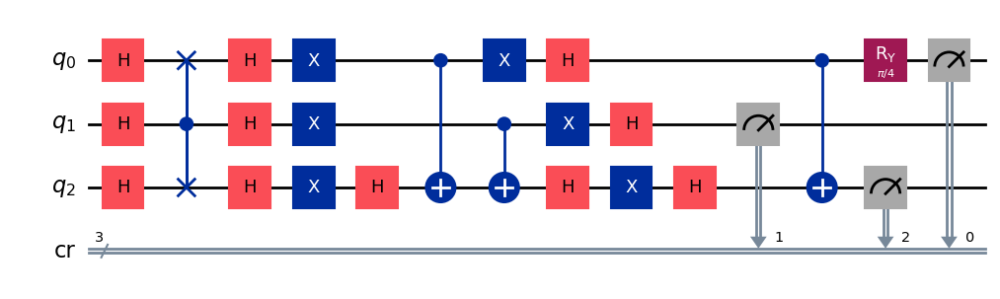

gen = 0 , Best fitness = (0.9459,)
gen = 1 , Best fitness = (0.9459,) , Number of invalids = 0

[Run 3 | Gen 34/99] Best Fitness: 0.9459 | Fidelity: 0.6165 | Gates: 29


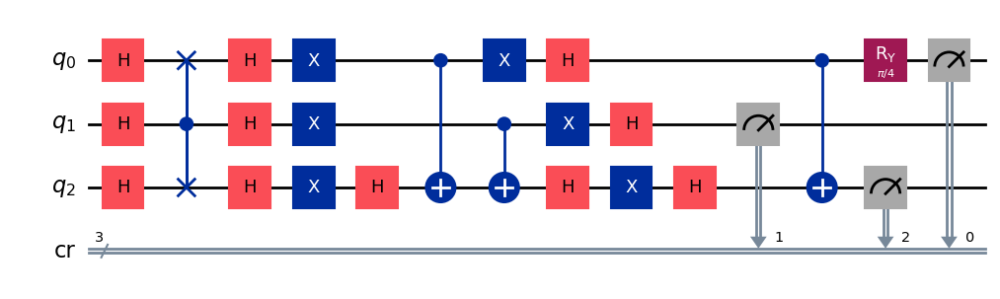

gen = 0 , Best fitness = (0.9459,)
gen = 1 , Best fitness = (0.9459,) , Number of invalids = 2

[Run 3 | Gen 35/99] Best Fitness: 0.9459 | Fidelity: 0.6275 | Gates: 29


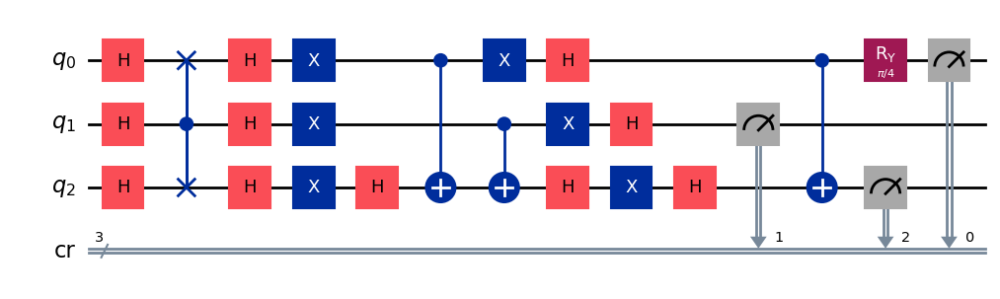

gen = 0 , Best fitness = (0.9459,)
gen = 1 , Best fitness = (0.9459,) , Number of invalids = 3

[Run 3 | Gen 36/99] Best Fitness: 0.9459 | Fidelity: 0.6172 | Gates: 29


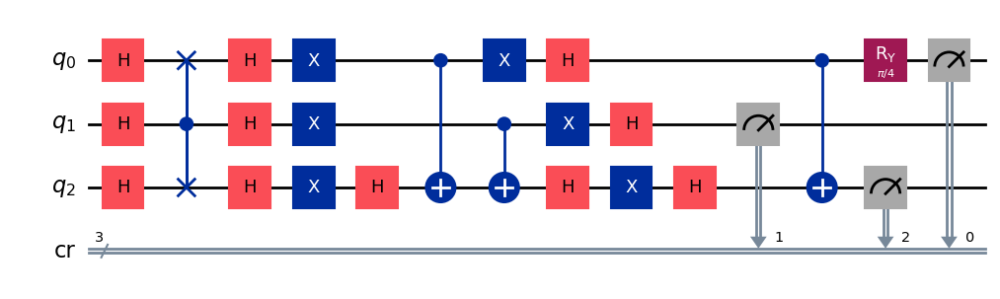

gen = 0 , Best fitness = (0.9459,)
gen = 1 , Best fitness = (0.9027,) , Number of invalids = 1

[Run 3 | Gen 37/99] Best Fitness: 0.9027 | Fidelity: 0.7023 | Gates: 31


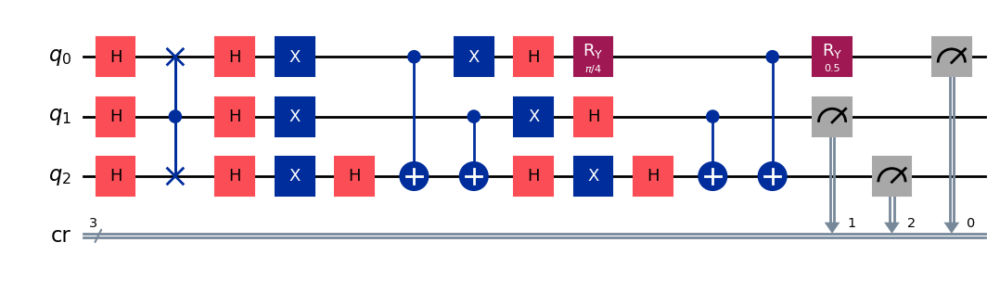

gen = 0 , Best fitness = (0.9027,)
gen = 1 , Best fitness = (0.8941,) , Number of invalids = 2

[Run 3 | Gen 38/99] Best Fitness: 0.8941 | Fidelity: 0.7289 | Gates: 31


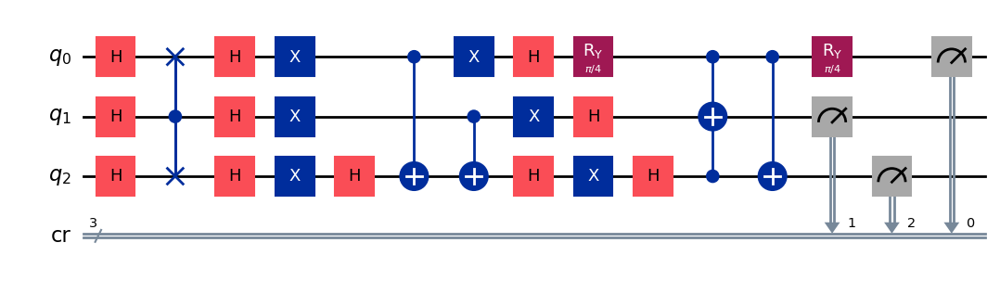

gen = 0 , Best fitness = (0.8941,)
gen = 1 , Best fitness = (0.8941,) , Number of invalids = 3

[Run 3 | Gen 39/99] Best Fitness: 0.8941 | Fidelity: 0.7214 | Gates: 31


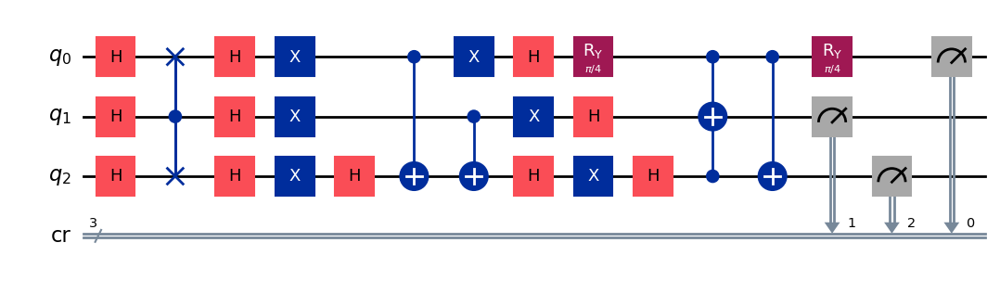

gen = 0 , Best fitness = (0.8941,)
gen = 1 , Best fitness = (0.8911,) , Number of invalids = 1

[Run 3 | Gen 40/99] Best Fitness: 0.8911 | Fidelity: 0.7103 | Gates: 30


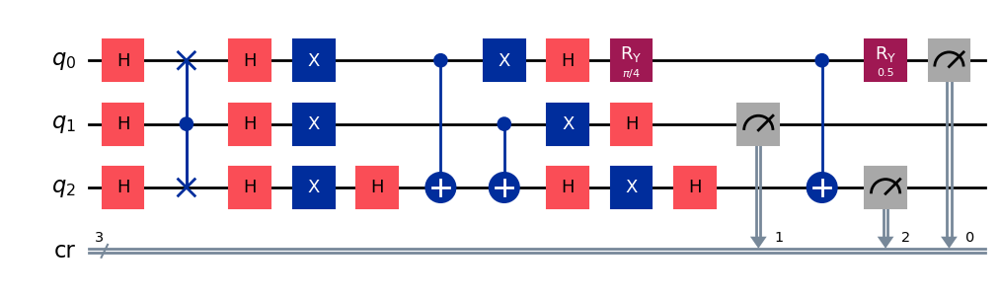

gen = 0 , Best fitness = (0.8911,)
gen = 1 , Best fitness = (0.8901,) , Number of invalids = 2

[Run 3 | Gen 41/99] Best Fitness: 0.8901 | Fidelity: 0.7120 | Gates: 30


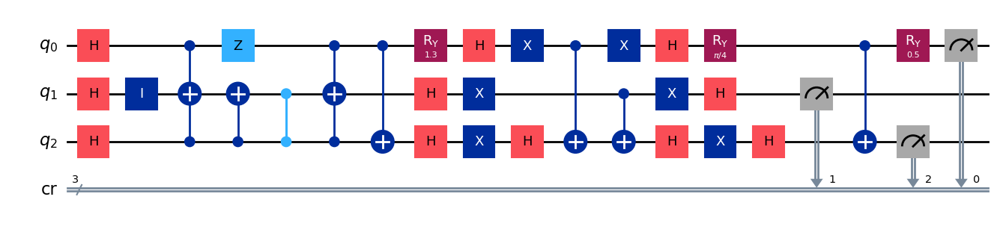

gen = 0 , Best fitness = (0.8901,)
gen = 1 , Best fitness = (0.8846999999999999,) , Number of invalids = 2

[Run 3 | Gen 42/99] Best Fitness: 0.8847 | Fidelity: 0.7178 | Gates: 30


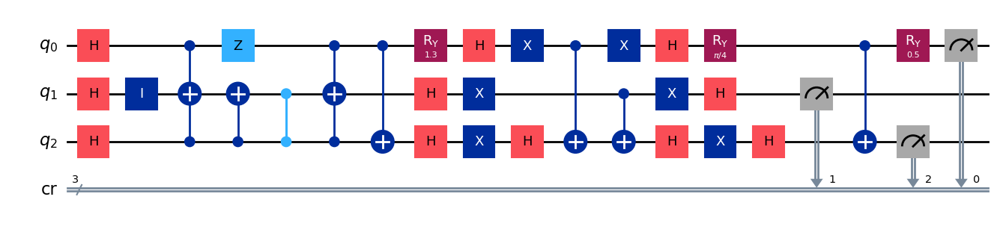

gen = 0 , Best fitness = (0.8846999999999999,)
gen = 1 , Best fitness = (0.8846999999999999,) , Number of invalids = 1

[Run 3 | Gen 43/99] Best Fitness: 0.8847 | Fidelity: 0.7143 | Gates: 30


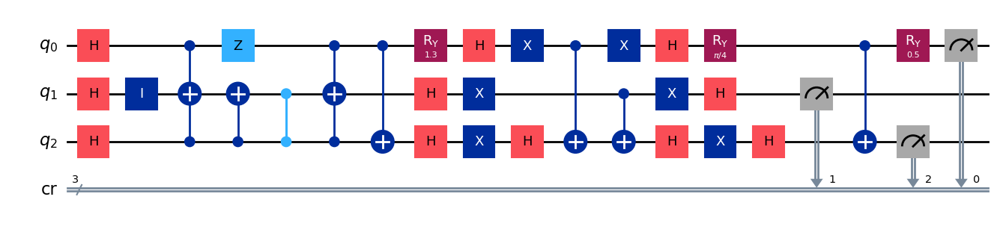

gen = 0 , Best fitness = (0.8846999999999999,)
gen = 1 , Best fitness = (0.8765,) , Number of invalids = 0

[Run 3 | Gen 44/99] Best Fitness: 0.8765 | Fidelity: 0.7111 | Gates: 30


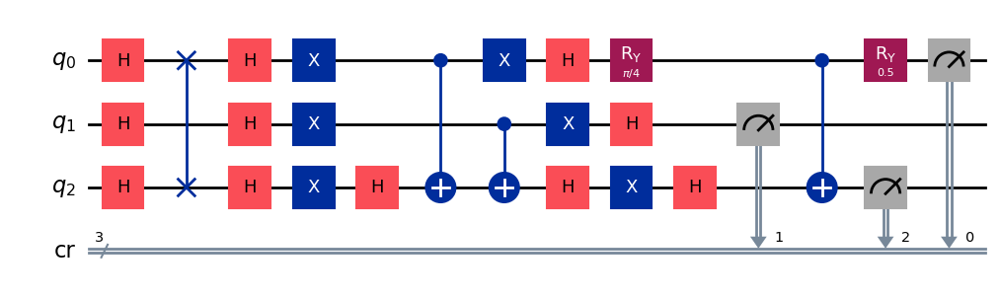

gen = 0 , Best fitness = (0.8765,)
gen = 1 , Best fitness = (0.8765,) , Number of invalids = 2

[Run 3 | Gen 45/99] Best Fitness: 0.8765 | Fidelity: 0.7216 | Gates: 30


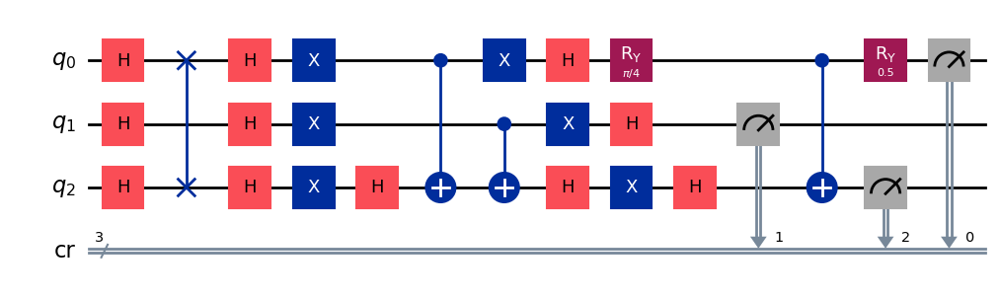

gen = 0 , Best fitness = (0.8765,)
gen = 1 , Best fitness = (0.8765,) , Number of invalids = 1

[Run 3 | Gen 46/99] Best Fitness: 0.8765 | Fidelity: 0.7139 | Gates: 30


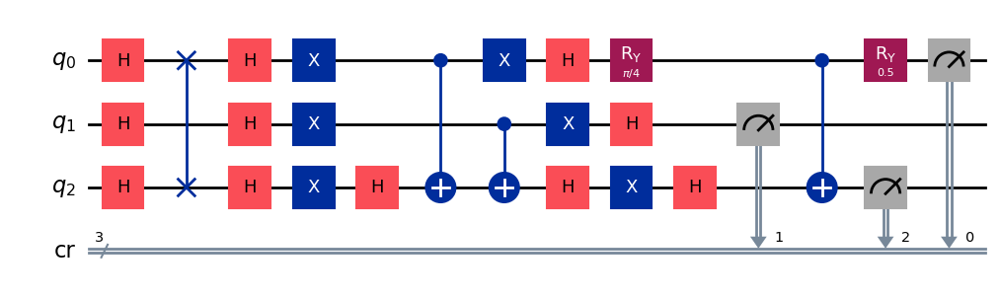

gen = 0 , Best fitness = (0.8765,)
gen = 1 , Best fitness = (0.8765,) , Number of invalids = 0

[Run 3 | Gen 47/99] Best Fitness: 0.8765 | Fidelity: 0.7174 | Gates: 30


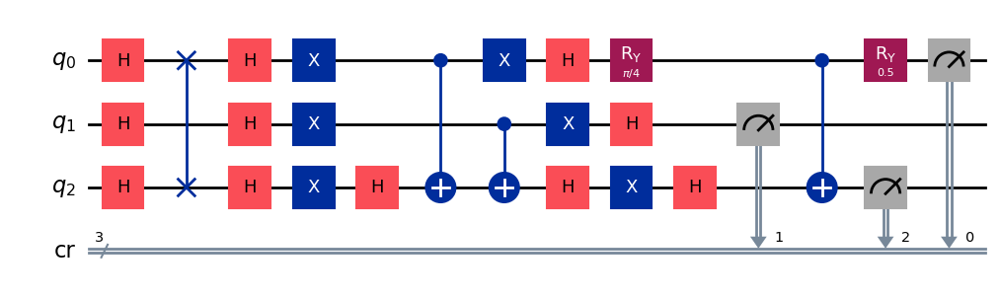

gen = 0 , Best fitness = (0.8765,)
gen = 1 , Best fitness = (0.868,) , Number of invalids = 1

[Run 3 | Gen 48/99] Best Fitness: 0.8680 | Fidelity: 0.7277 | Gates: 30


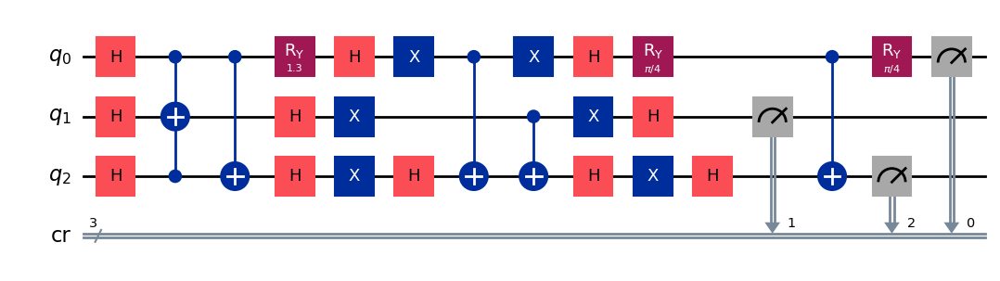

gen = 0 , Best fitness = (0.868,)
gen = 1 , Best fitness = (0.868,) , Number of invalids = 3

[Run 3 | Gen 49/99] Best Fitness: 0.8680 | Fidelity: 0.7284 | Gates: 30


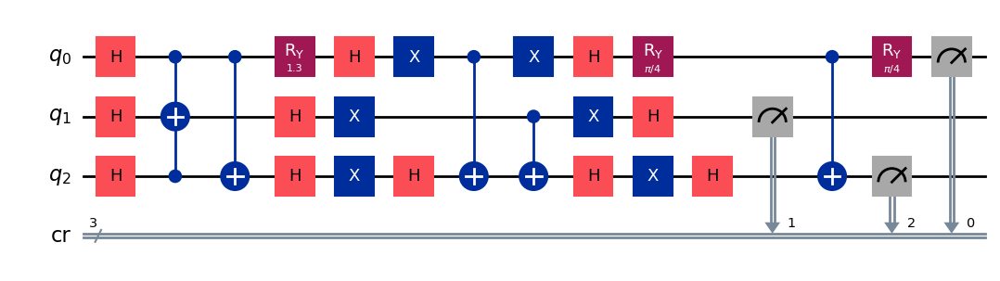

gen = 0 , Best fitness = (0.868,)
gen = 1 , Best fitness = (0.8677,) , Number of invalids = 3

[Run 3 | Gen 50/99] Best Fitness: 0.8677 | Fidelity: 0.7229 | Gates: 30


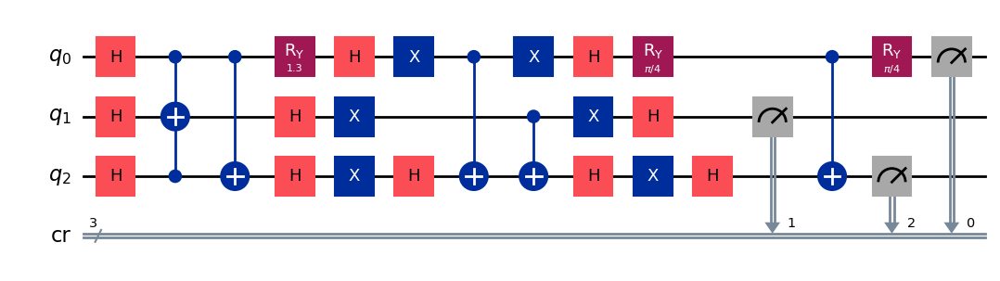

gen = 0 , Best fitness = (0.8677,)
gen = 1 , Best fitness = (0.8585,) , Number of invalids = 2

[Run 3 | Gen 51/99] Best Fitness: 0.8585 | Fidelity: 0.7735 | Gates: 32


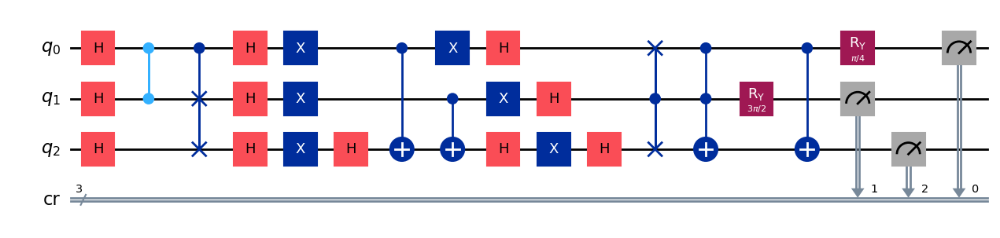

gen = 0 , Best fitness = (0.8585,)
gen = 1 , Best fitness = (0.8585,) , Number of invalids = 1

[Run 3 | Gen 52/99] Best Fitness: 0.8585 | Fidelity: 0.7774 | Gates: 32


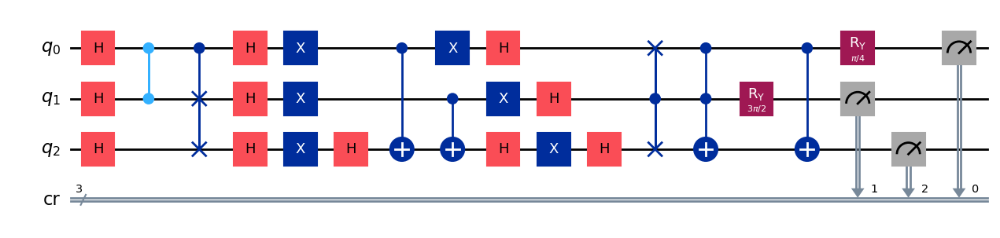

gen = 0 , Best fitness = (0.8585,)
gen = 1 , Best fitness = (0.8585,) , Number of invalids = 0

[Run 3 | Gen 53/99] Best Fitness: 0.8585 | Fidelity: 0.7799 | Gates: 32


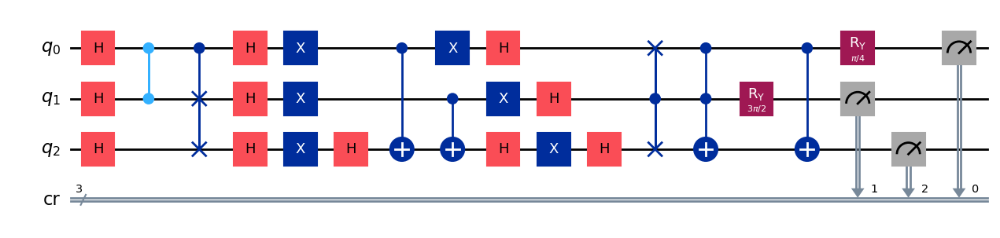

gen = 0 , Best fitness = (0.8585,)
gen = 1 , Best fitness = (0.8545,) , Number of invalids = 0

[Run 3 | Gen 54/99] Best Fitness: 0.8545 | Fidelity: 0.7782 | Gates: 32


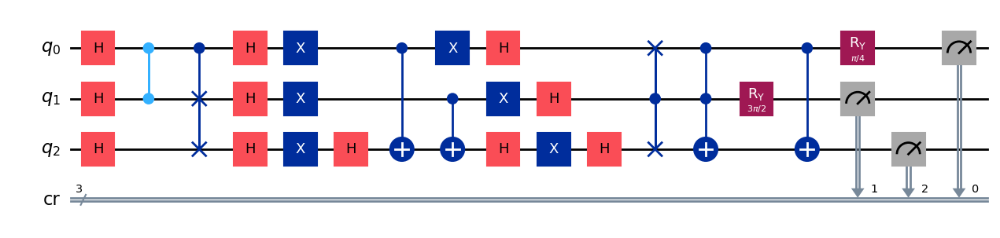

gen = 0 , Best fitness = (0.8545,)
gen = 1 , Best fitness = (0.8318,) , Number of invalids = 0

[Run 3 | Gen 55/99] Best Fitness: 0.8318 | Fidelity: 0.8109 | Gates: 32


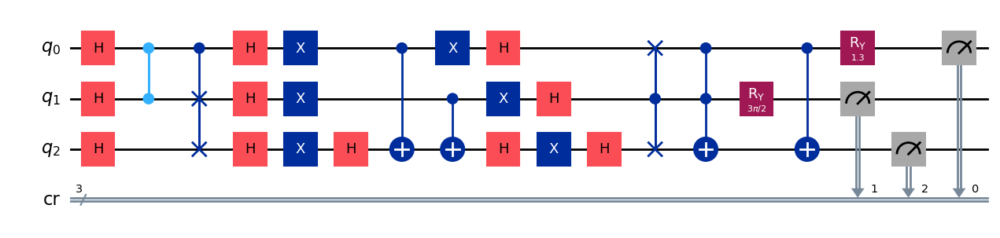

gen = 0 , Best fitness = (0.8318,)
gen = 1 , Best fitness = (0.8273,) , Number of invalids = 1

[Run 3 | Gen 56/99] Best Fitness: 0.8273 | Fidelity: 0.8107 | Gates: 32


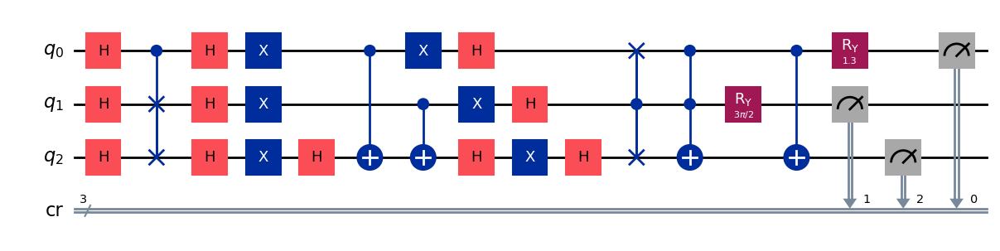

gen = 0 , Best fitness = (0.8273,)
gen = 1 , Best fitness = (0.8273,) , Number of invalids = 0

[Run 3 | Gen 57/99] Best Fitness: 0.8273 | Fidelity: 0.8090 | Gates: 32


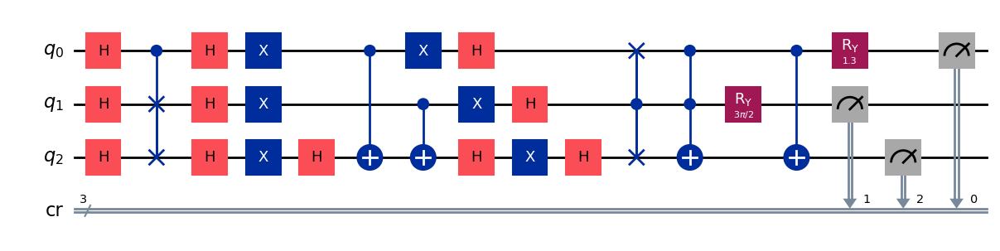

gen = 0 , Best fitness = (0.8273,)
gen = 1 , Best fitness = (0.8273,) , Number of invalids = 0

[Run 3 | Gen 58/99] Best Fitness: 0.8273 | Fidelity: 0.8116 | Gates: 32


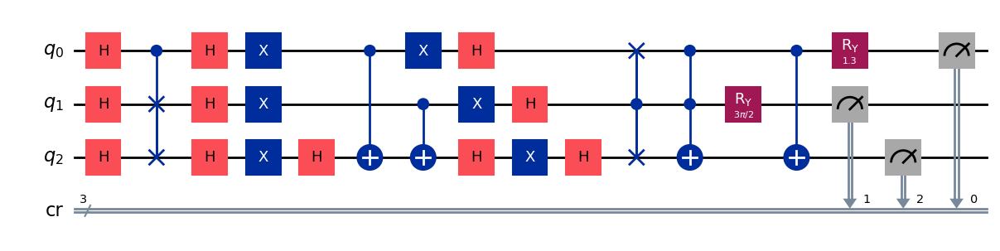

gen = 0 , Best fitness = (0.8273,)
gen = 1 , Best fitness = (0.8273,) , Number of invalids = 1

[Run 3 | Gen 59/99] Best Fitness: 0.8273 | Fidelity: 0.8053 | Gates: 32


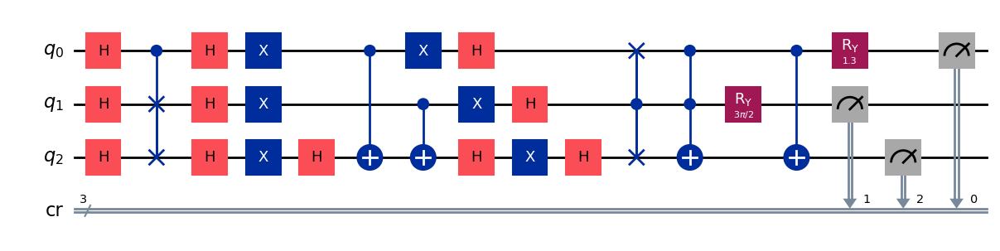

gen = 0 , Best fitness = (0.8273,)
gen = 1 , Best fitness = (0.8273,) , Number of invalids = 0

[Run 3 | Gen 60/99] Best Fitness: 0.8273 | Fidelity: 0.8022 | Gates: 32


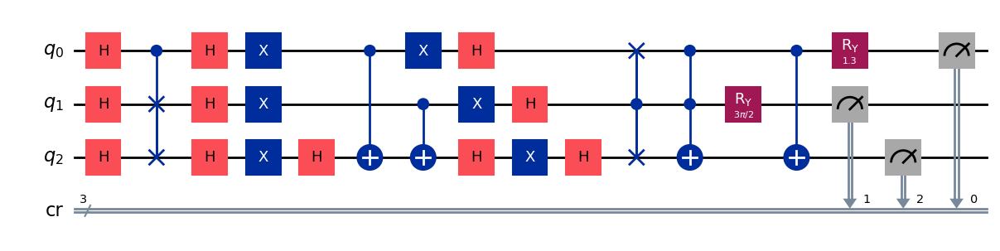

gen = 0 , Best fitness = (0.8273,)
gen = 1 , Best fitness = (0.8156,) , Number of invalids = 0

[Run 3 | Gen 61/99] Best Fitness: 0.8156 | Fidelity: 0.7836 | Gates: 30


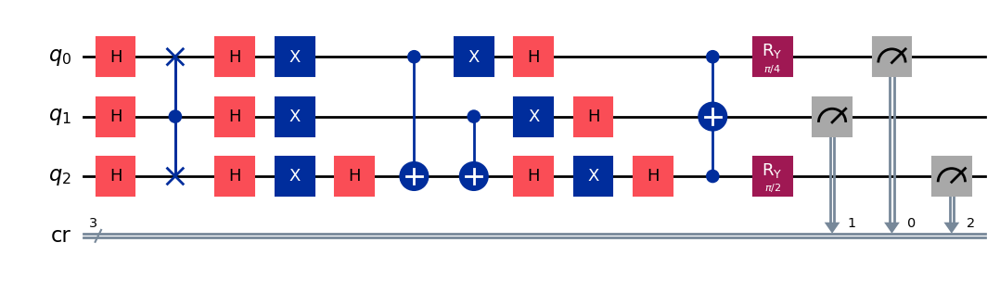

gen = 0 , Best fitness = (0.8156,)
gen = 1 , Best fitness = (0.8156,) , Number of invalids = 0

[Run 3 | Gen 62/99] Best Fitness: 0.8156 | Fidelity: 0.7850 | Gates: 30


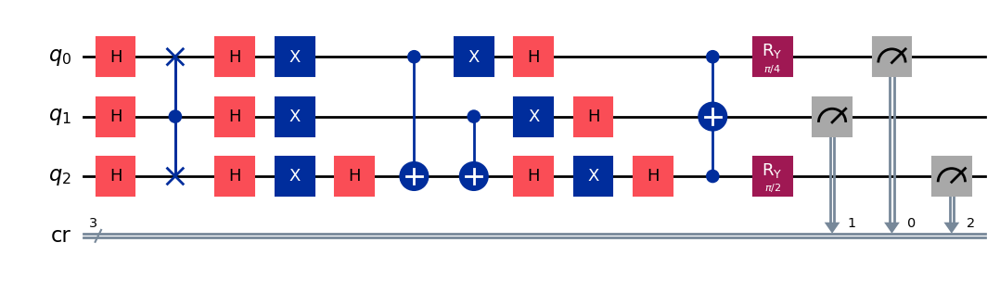

gen = 0 , Best fitness = (0.8156,)
gen = 1 , Best fitness = (0.8115,) , Number of invalids = 1

[Run 3 | Gen 63/99] Best Fitness: 0.8115 | Fidelity: 0.7770 | Gates: 30


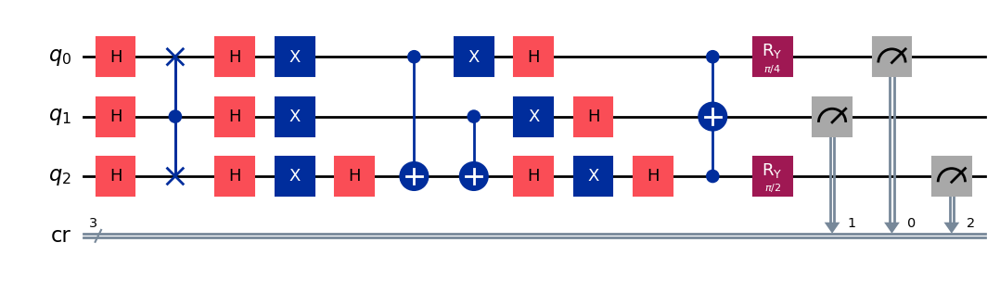

gen = 0 , Best fitness = (0.8115,)
gen = 1 , Best fitness = (0.7837999999999999,) , Number of invalids = 0

[Run 3 | Gen 64/99] Best Fitness: 0.7838 | Fidelity: 0.8173 | Gates: 30


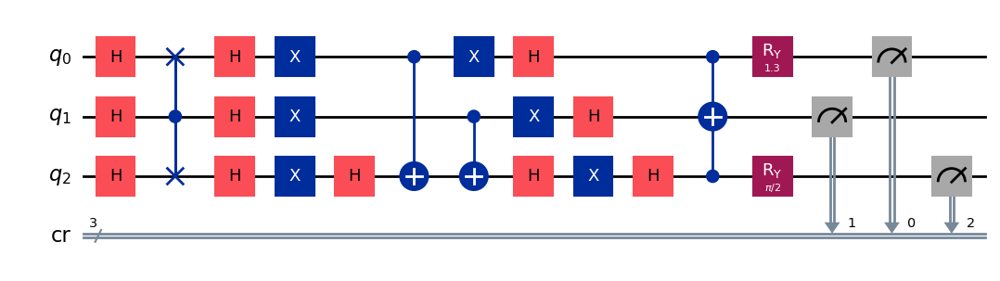

gen = 0 , Best fitness = (0.7837999999999999,)
gen = 1 , Best fitness = (0.7837999999999999,) , Number of invalids = 0

[Run 3 | Gen 65/99] Best Fitness: 0.7838 | Fidelity: 0.8101 | Gates: 30


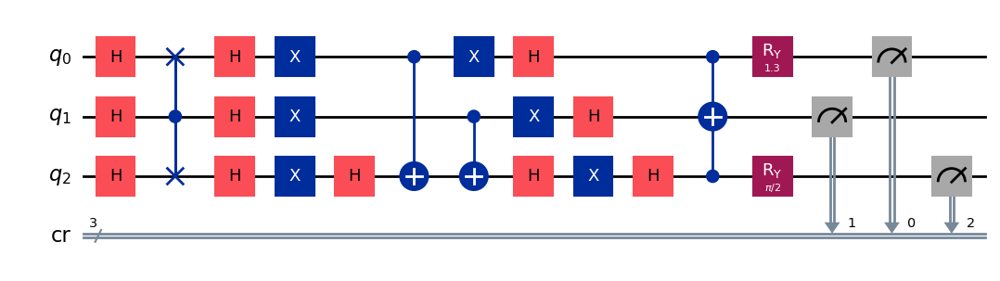

gen = 0 , Best fitness = (0.7837999999999999,)
gen = 1 , Best fitness = (0.7837,) , Number of invalids = 0

[Run 3 | Gen 66/99] Best Fitness: 0.7837 | Fidelity: 0.8039 | Gates: 30


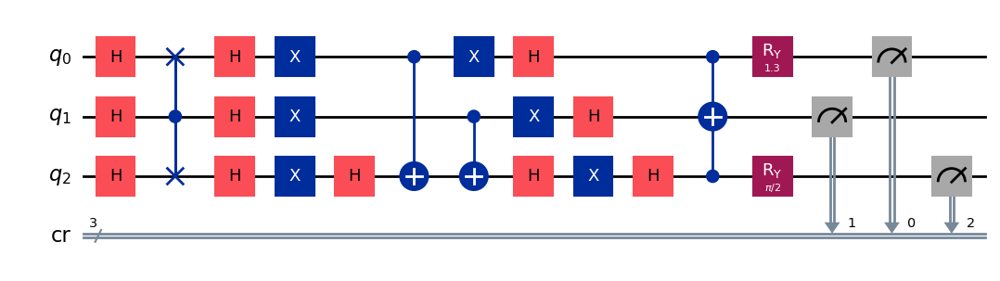

gen = 0 , Best fitness = (0.7837,)
gen = 1 , Best fitness = (0.7837,) , Number of invalids = 0

[Run 3 | Gen 67/99] Best Fitness: 0.7837 | Fidelity: 0.8094 | Gates: 30


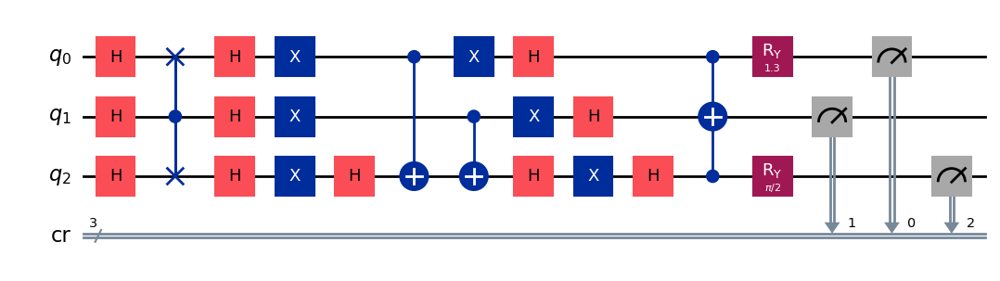

gen = 0 , Best fitness = (0.7837,)
gen = 1 , Best fitness = (0.7837,) , Number of invalids = 0

[Run 3 | Gen 68/99] Best Fitness: 0.7837 | Fidelity: 0.8037 | Gates: 30


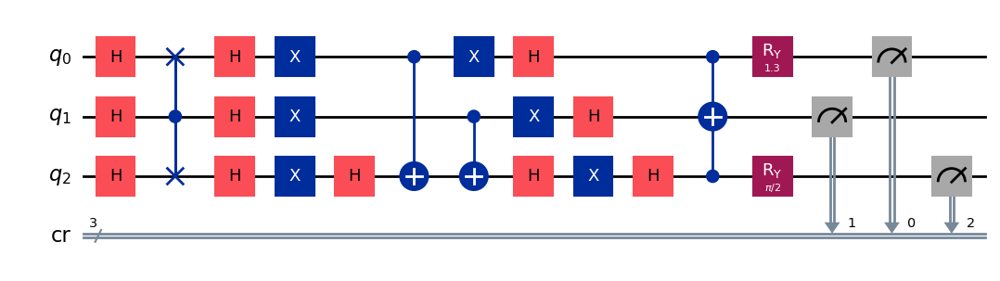

gen = 0 , Best fitness = (0.7837,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 69/99] Best Fitness: 0.7811 | Fidelity: 0.8026 | Gates: 30


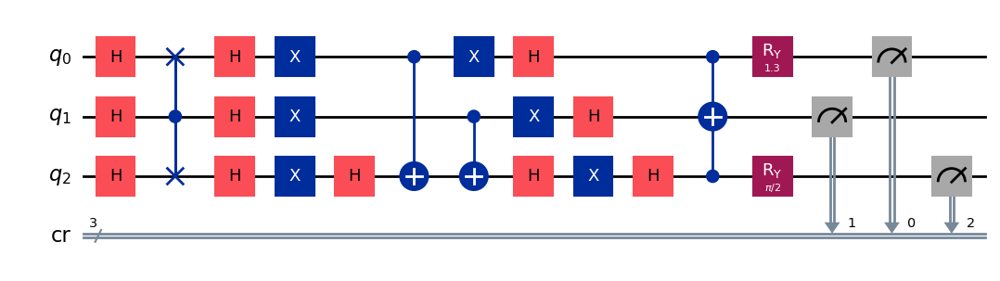

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 1

[Run 3 | Gen 70/99] Best Fitness: 0.7811 | Fidelity: 0.8034 | Gates: 30


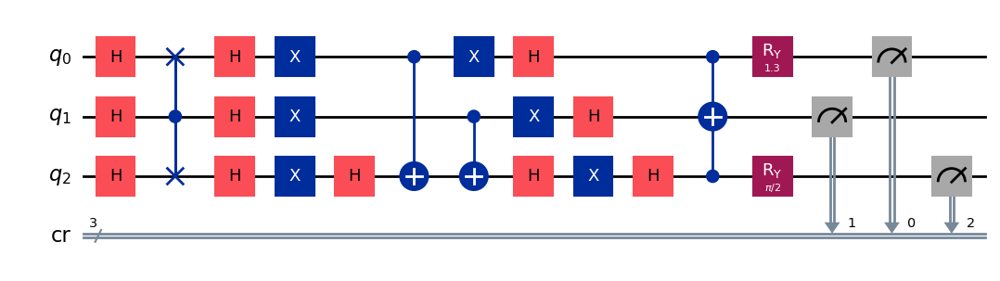

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 71/99] Best Fitness: 0.7811 | Fidelity: 0.8087 | Gates: 30


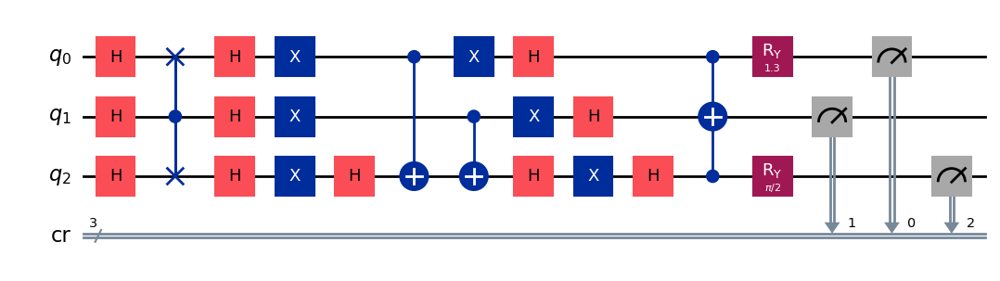

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 72/99] Best Fitness: 0.7811 | Fidelity: 0.8110 | Gates: 30


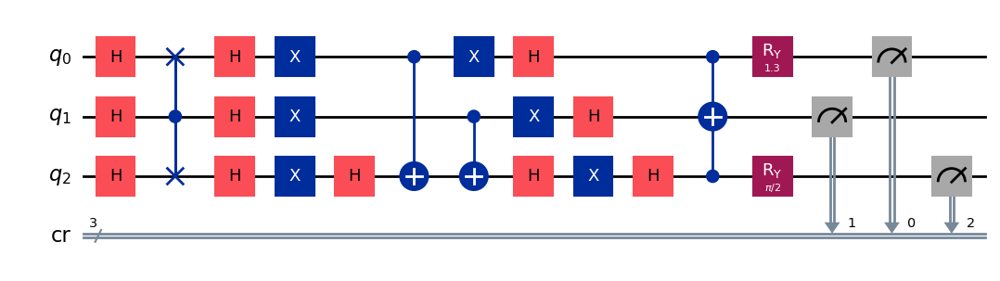

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 73/99] Best Fitness: 0.7811 | Fidelity: 0.8192 | Gates: 30


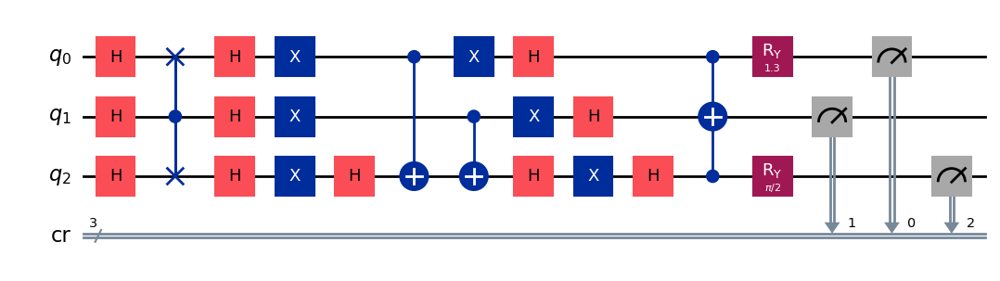

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 74/99] Best Fitness: 0.7811 | Fidelity: 0.8077 | Gates: 30


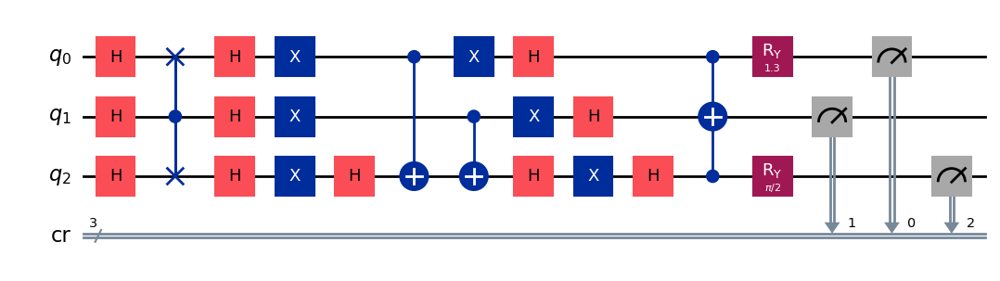

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 75/99] Best Fitness: 0.7811 | Fidelity: 0.8143 | Gates: 30


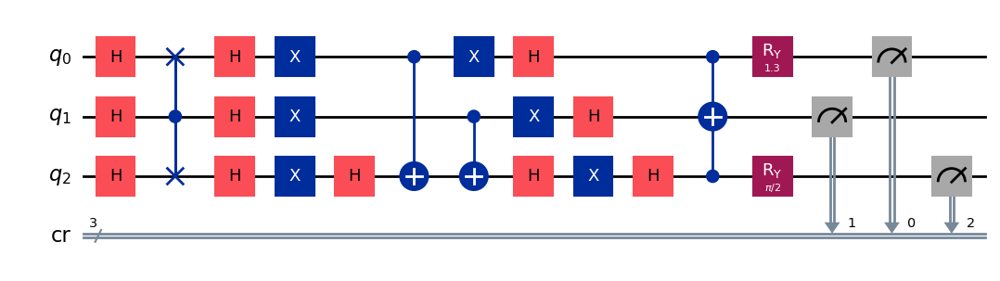

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 76/99] Best Fitness: 0.7811 | Fidelity: 0.8030 | Gates: 30


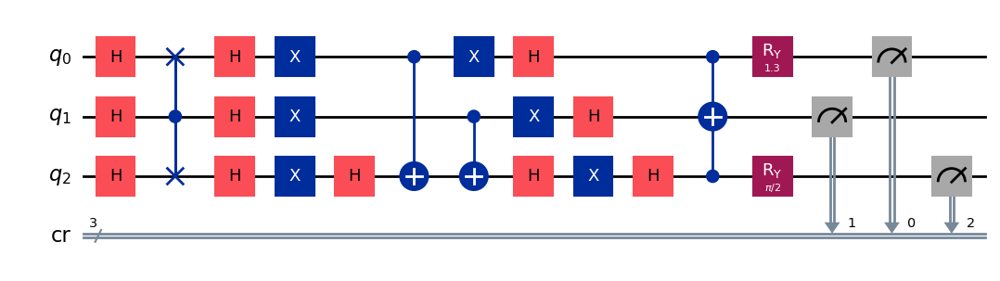

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 77/99] Best Fitness: 0.7811 | Fidelity: 0.8017 | Gates: 30


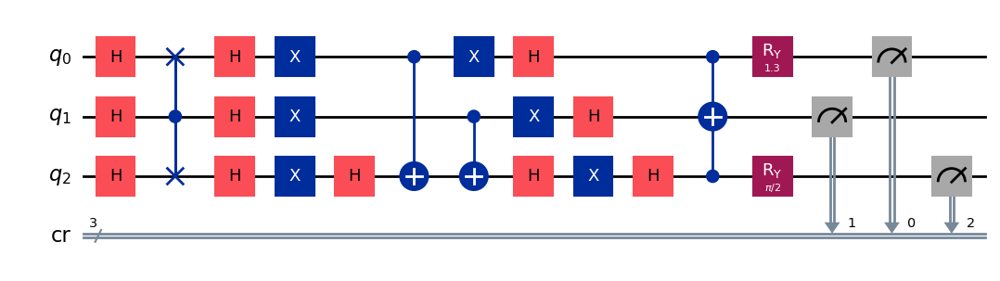

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 78/99] Best Fitness: 0.7811 | Fidelity: 0.8136 | Gates: 30


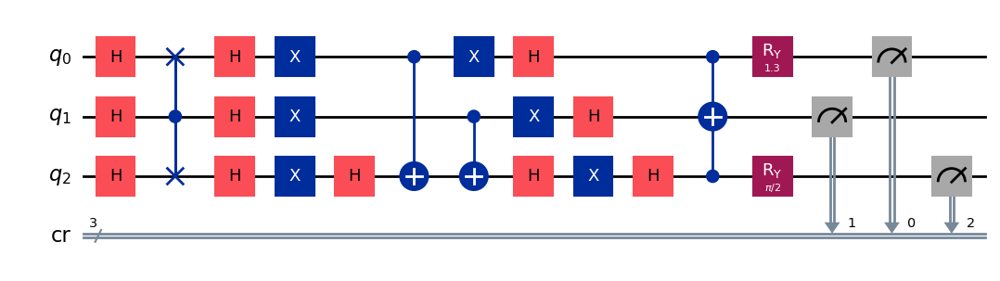

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 79/99] Best Fitness: 0.7811 | Fidelity: 0.8127 | Gates: 30


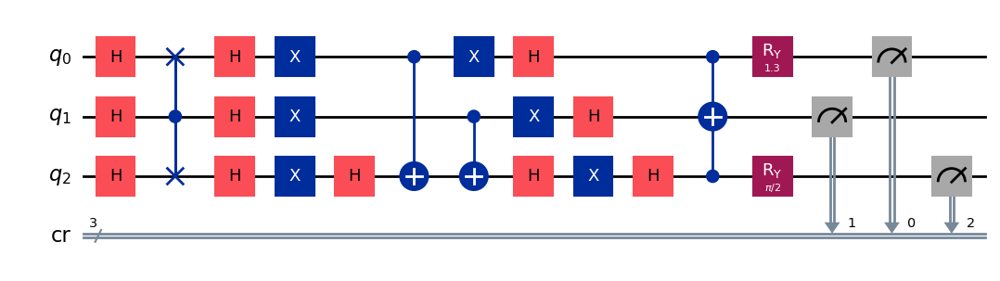

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 80/99] Best Fitness: 0.7811 | Fidelity: 0.8018 | Gates: 30


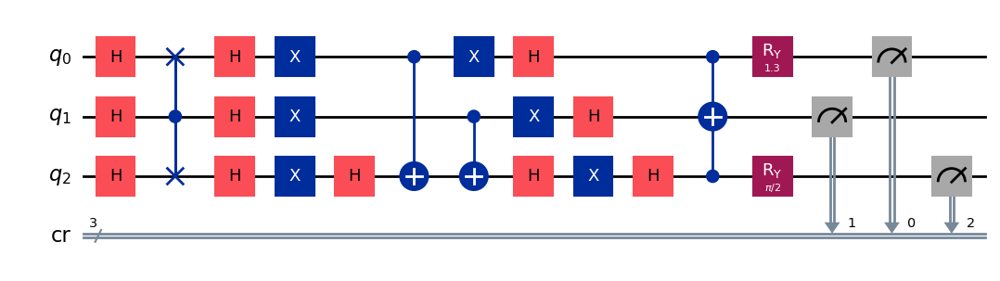

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 81/99] Best Fitness: 0.7811 | Fidelity: 0.8058 | Gates: 30


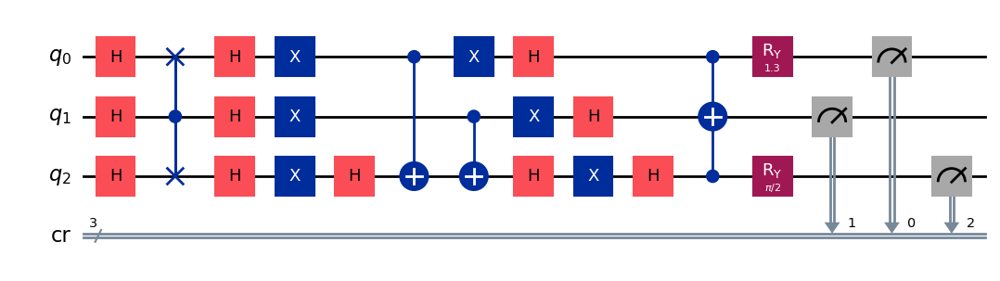

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 82/99] Best Fitness: 0.7811 | Fidelity: 0.8116 | Gates: 30


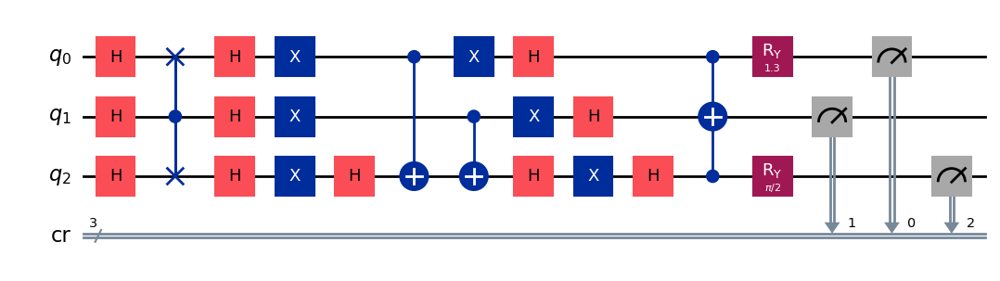

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 83/99] Best Fitness: 0.7811 | Fidelity: 0.8050 | Gates: 30


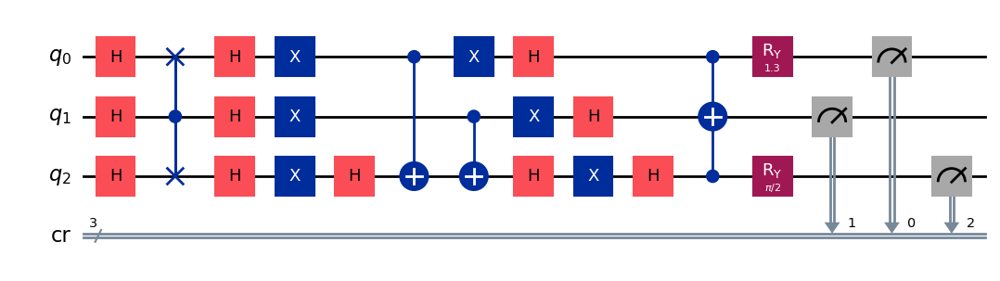

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 1

[Run 3 | Gen 84/99] Best Fitness: 0.7811 | Fidelity: 0.8095 | Gates: 30


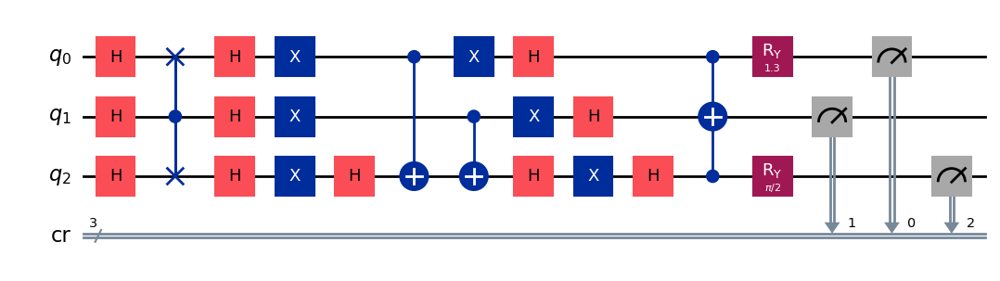

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 85/99] Best Fitness: 0.7811 | Fidelity: 0.8118 | Gates: 30


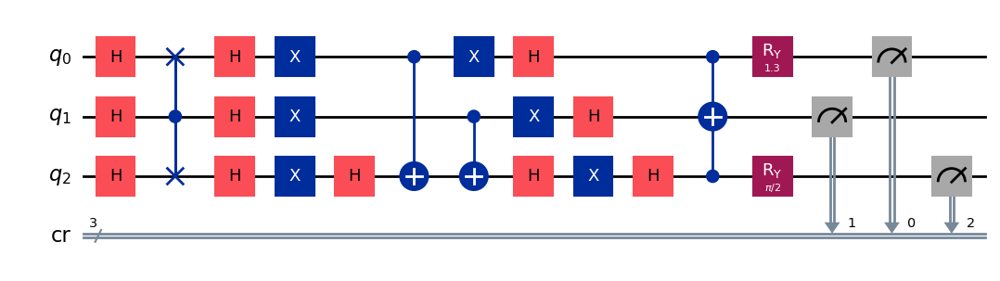

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7811,) , Number of invalids = 0

[Run 3 | Gen 86/99] Best Fitness: 0.7811 | Fidelity: 0.8129 | Gates: 30


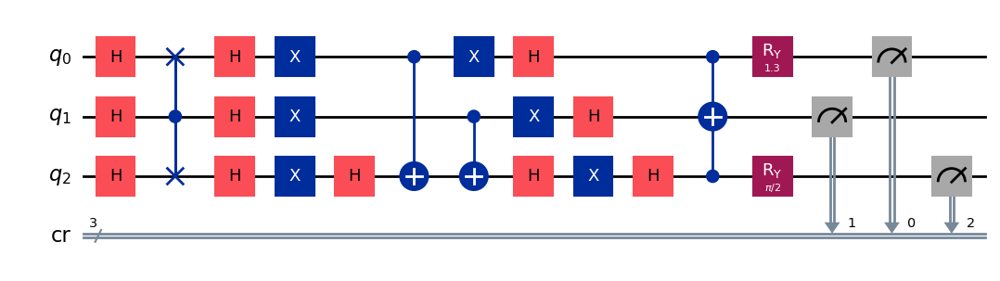

gen = 0 , Best fitness = (0.7811,)
gen = 1 , Best fitness = (0.7774,) , Number of invalids = 0

[Run 3 | Gen 87/99] Best Fitness: 0.7774 | Fidelity: 0.8104 | Gates: 30


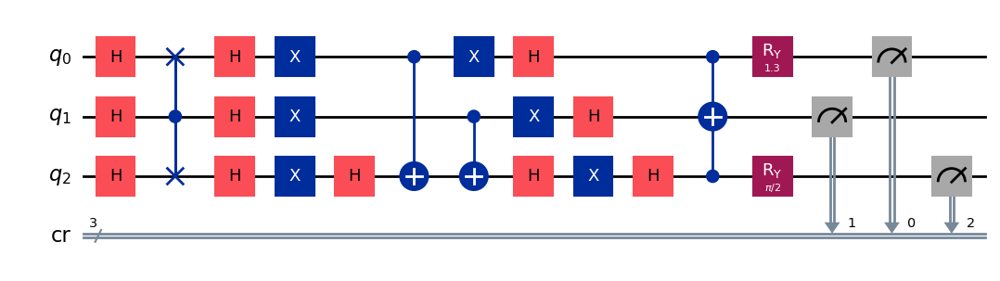

gen = 0 , Best fitness = (0.7774,)
gen = 1 , Best fitness = (0.7774,) , Number of invalids = 0

[Run 3 | Gen 88/99] Best Fitness: 0.7774 | Fidelity: 0.8041 | Gates: 30


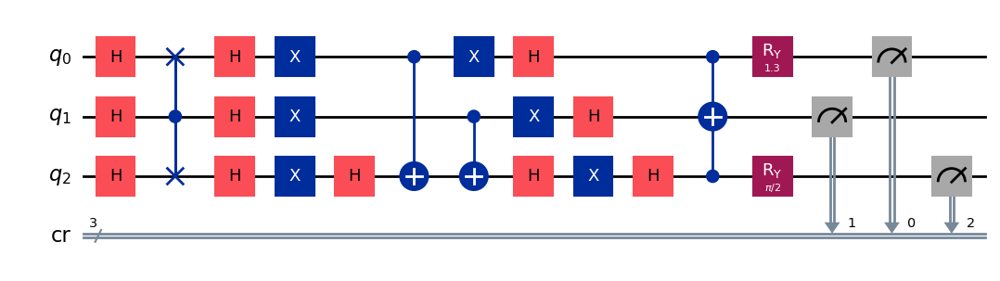

gen = 0 , Best fitness = (0.7774,)
gen = 1 , Best fitness = (0.7774,) , Number of invalids = 0

[Run 3 | Gen 89/99] Best Fitness: 0.7774 | Fidelity: 0.8163 | Gates: 30


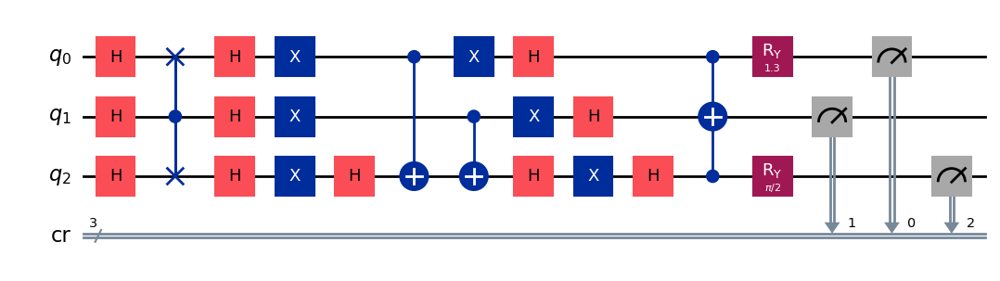

gen = 0 , Best fitness = (0.7774,)
gen = 1 , Best fitness = (0.7774,) , Number of invalids = 0

[Run 3 | Gen 90/99] Best Fitness: 0.7774 | Fidelity: 0.8060 | Gates: 30


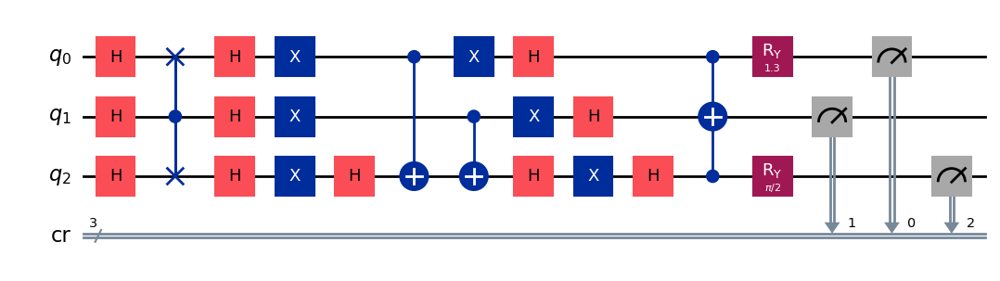

gen = 0 , Best fitness = (0.7774,)
gen = 1 , Best fitness = (0.7774,) , Number of invalids = 0

[Run 3 | Gen 91/99] Best Fitness: 0.7774 | Fidelity: 0.8159 | Gates: 30


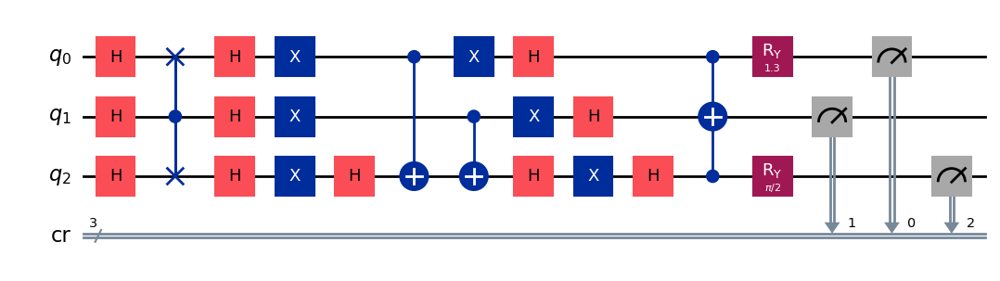

gen = 0 , Best fitness = (0.7774,)
gen = 1 , Best fitness = (0.7774,) , Number of invalids = 0

[Run 3 | Gen 92/99] Best Fitness: 0.7774 | Fidelity: 0.8022 | Gates: 30


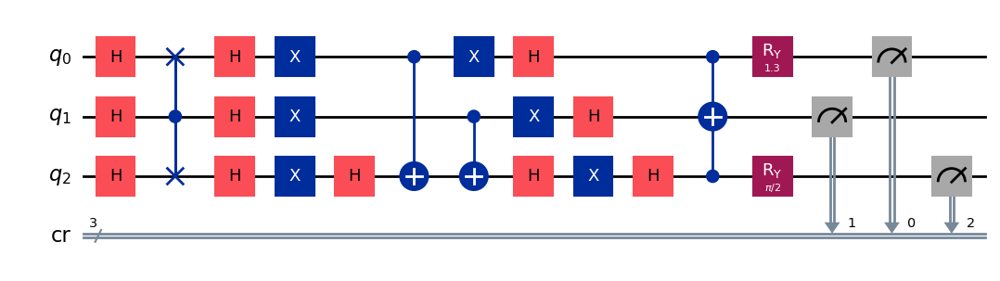

gen = 0 , Best fitness = (0.7774,)
gen = 1 , Best fitness = (0.7774,) , Number of invalids = 0

[Run 3 | Gen 93/99] Best Fitness: 0.7774 | Fidelity: 0.8034 | Gates: 30


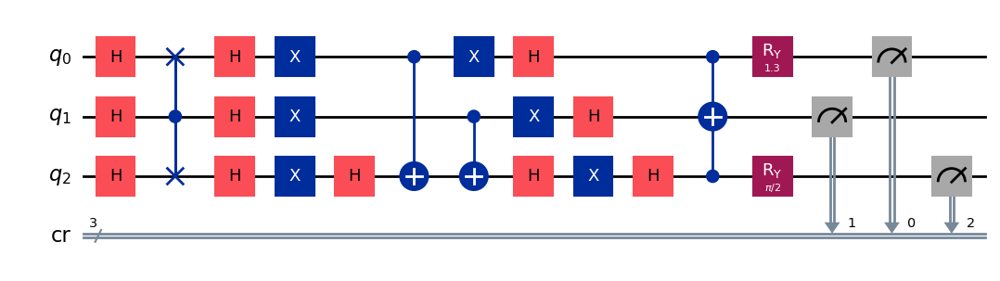

gen = 0 , Best fitness = (0.7774,)
gen = 1 , Best fitness = (0.7774,) , Number of invalids = 0

[Run 3 | Gen 94/99] Best Fitness: 0.7774 | Fidelity: 0.8138 | Gates: 30


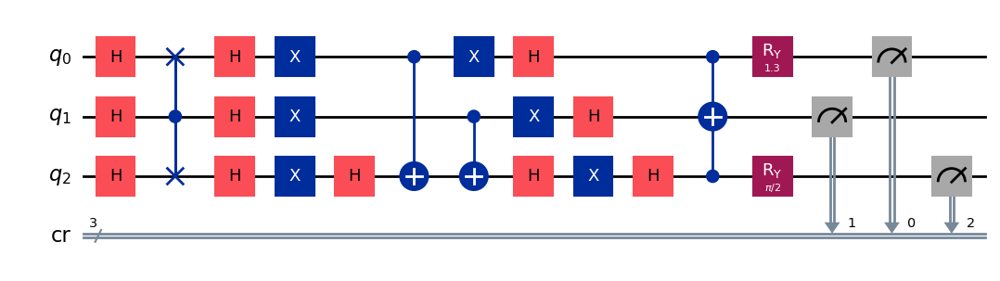

gen = 0 , Best fitness = (0.7774,)
gen = 1 , Best fitness = (0.7774,) , Number of invalids = 0

[Run 3 | Gen 95/99] Best Fitness: 0.7774 | Fidelity: 0.8141 | Gates: 30


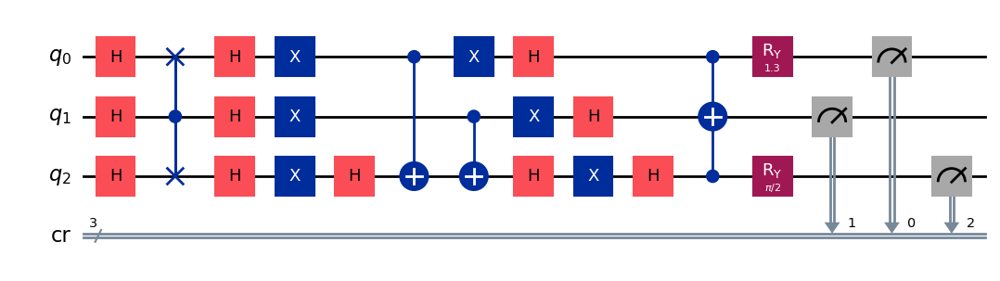

gen = 0 , Best fitness = (0.7774,)
gen = 1 , Best fitness = (0.7774,) , Number of invalids = 0

[Run 3 | Gen 96/99] Best Fitness: 0.7774 | Fidelity: 0.8020 | Gates: 30


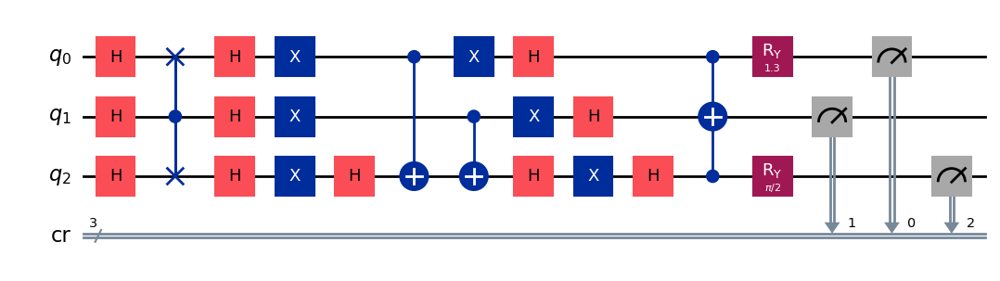

gen = 0 , Best fitness = (0.7774,)
gen = 1 , Best fitness = (0.7774,) , Number of invalids = 0

[Run 3 | Gen 97/99] Best Fitness: 0.7774 | Fidelity: 0.8146 | Gates: 30


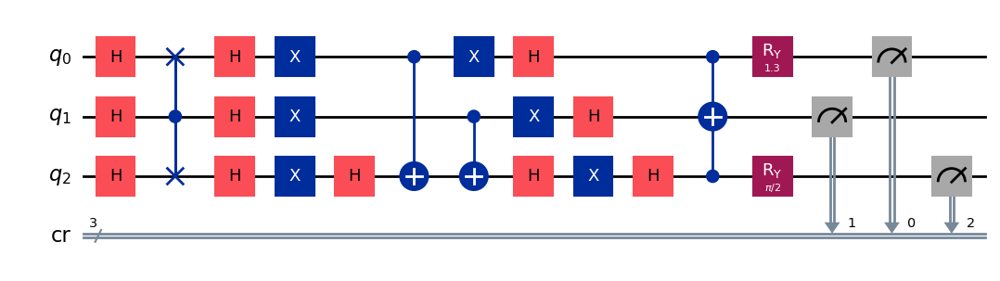

gen = 0 , Best fitness = (0.7774,)
gen = 1 , Best fitness = (0.7774,) , Number of invalids = 0

[Run 3 | Gen 98/99] Best Fitness: 0.7774 | Fidelity: 0.8134 | Gates: 30


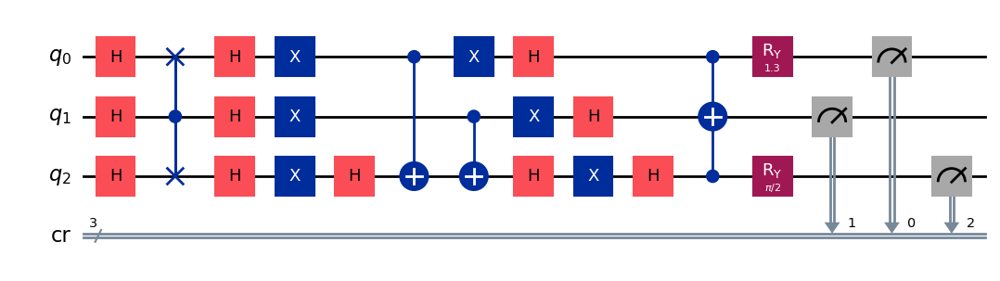

gen = 0 , Best fitness = (0.7774,)
gen = 1 , Best fitness = (0.7774,) , Number of invalids = 0

[Run 3 | Gen 99/99] Best Fitness: 0.7774 | Fidelity: 0.8057 | Gates: 30


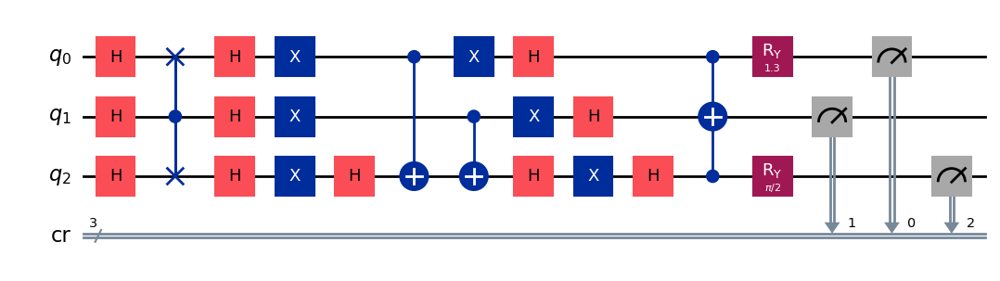


Generating evolution plots for Run 3...
✓ Plot saved to: experiments_state_101/run_3_seed_52596/evolution_metrics_run_3.png


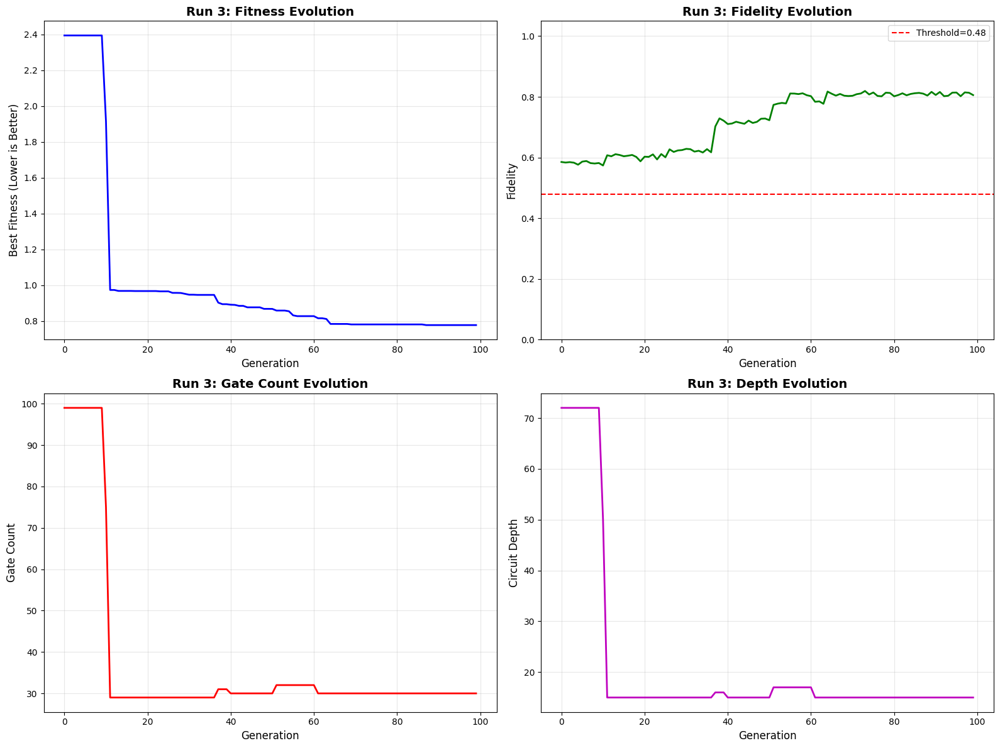


✓ Run 3 COMPLETE | Fidelity: 0.8151 | Gates: 30 | Depth: 15


RUN 4/5 | Target: 101 | Seed: 60899
✓ Logging to: experiments_state_101/run_4_seed_60899
✓ Starting evolution (Population: 1000, Generations: 100)
gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6167000000000002,) , Number of invalids = 141

[Run 4 | Gen 0/99] Best Fitness: 1.6167 | Fidelity: 0.5255 | Gates: 57


/Users/admin/Downloads/GE_Grover/.venv/lib/python3.10/site-packages/numpy/_core/_methods.py:191: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


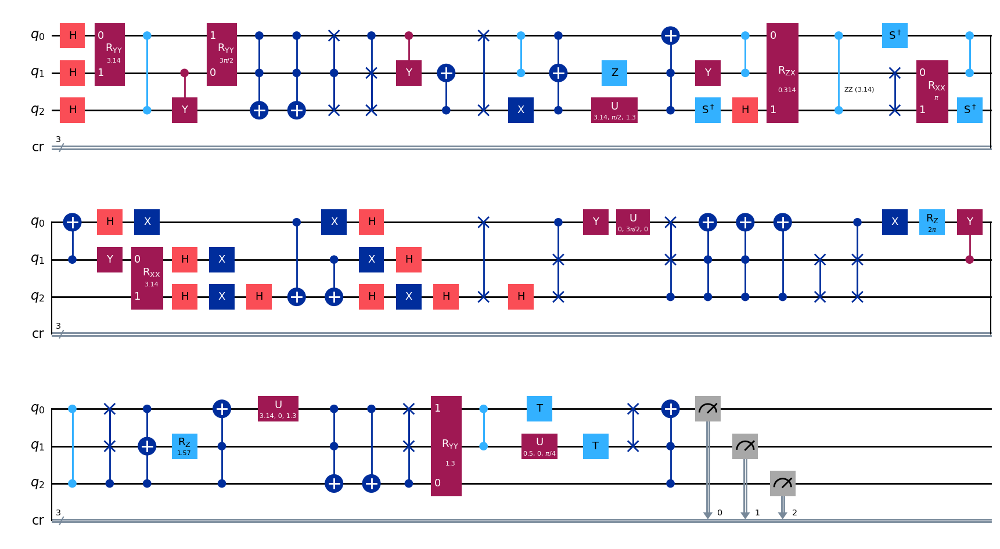

gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6167000000000002,) , Number of invalids = 70

[Run 4 | Gen 1/99] Best Fitness: 1.6167 | Fidelity: 0.5239 | Gates: 57


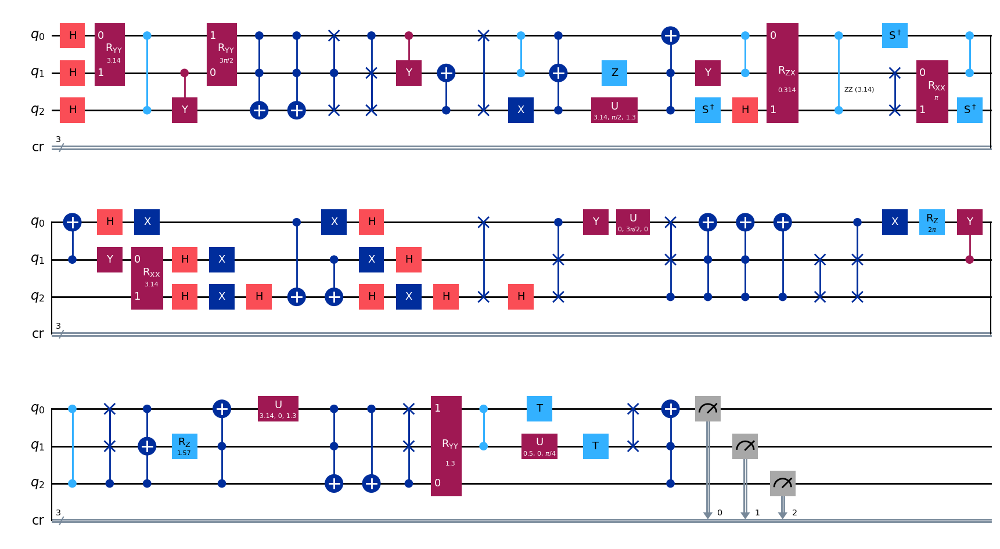

gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6167000000000002,) , Number of invalids = 50

[Run 4 | Gen 2/99] Best Fitness: 1.6167 | Fidelity: 0.5238 | Gates: 57


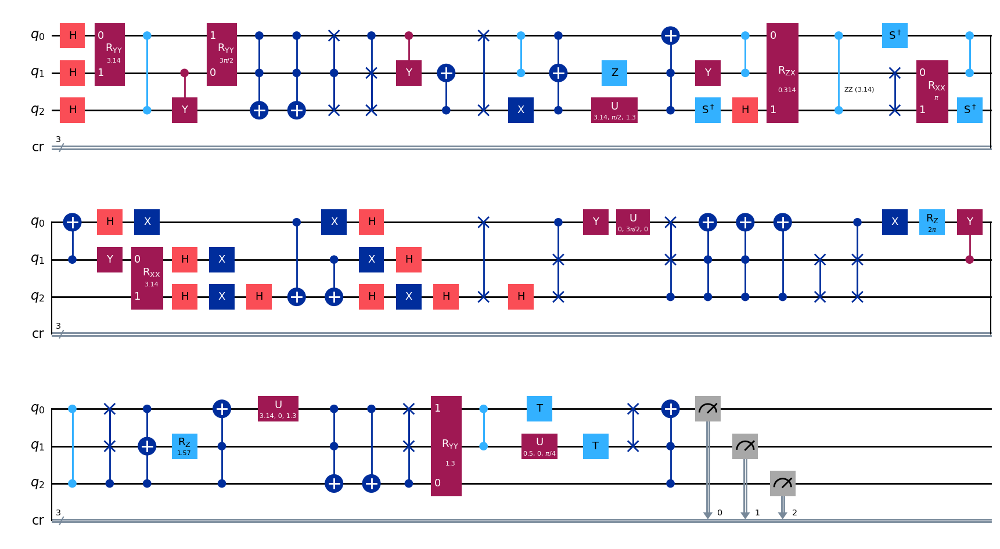

gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6167000000000002,) , Number of invalids = 47

[Run 4 | Gen 3/99] Best Fitness: 1.6167 | Fidelity: 0.5246 | Gates: 57


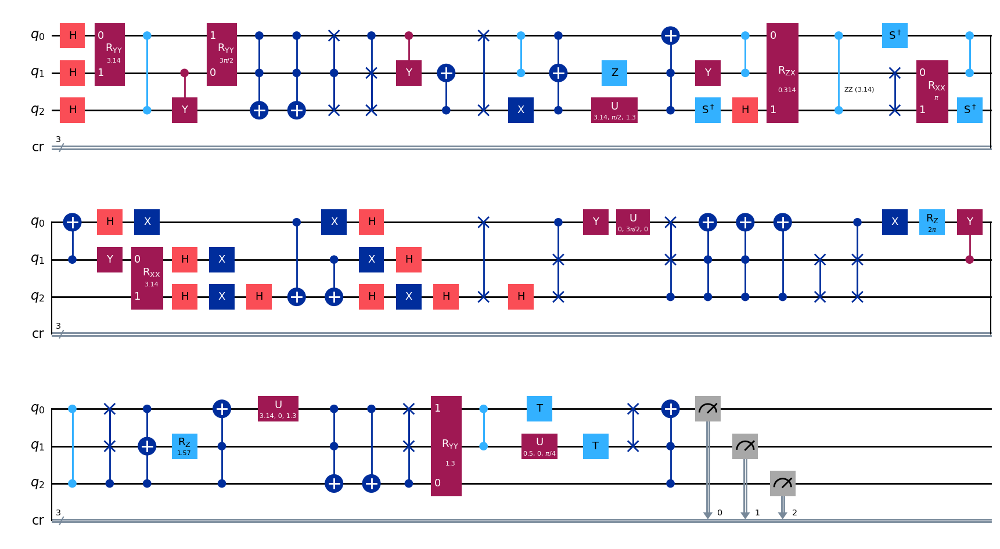

gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6167000000000002,) , Number of invalids = 32

[Run 4 | Gen 4/99] Best Fitness: 1.6167 | Fidelity: 0.5175 | Gates: 57


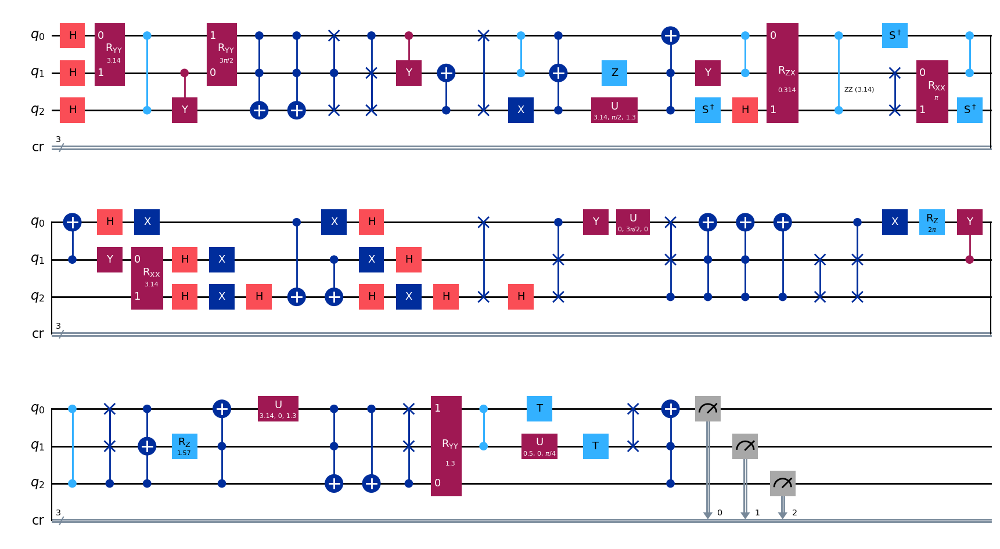

gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6167000000000002,) , Number of invalids = 30

[Run 4 | Gen 5/99] Best Fitness: 1.6167 | Fidelity: 0.5256 | Gates: 57


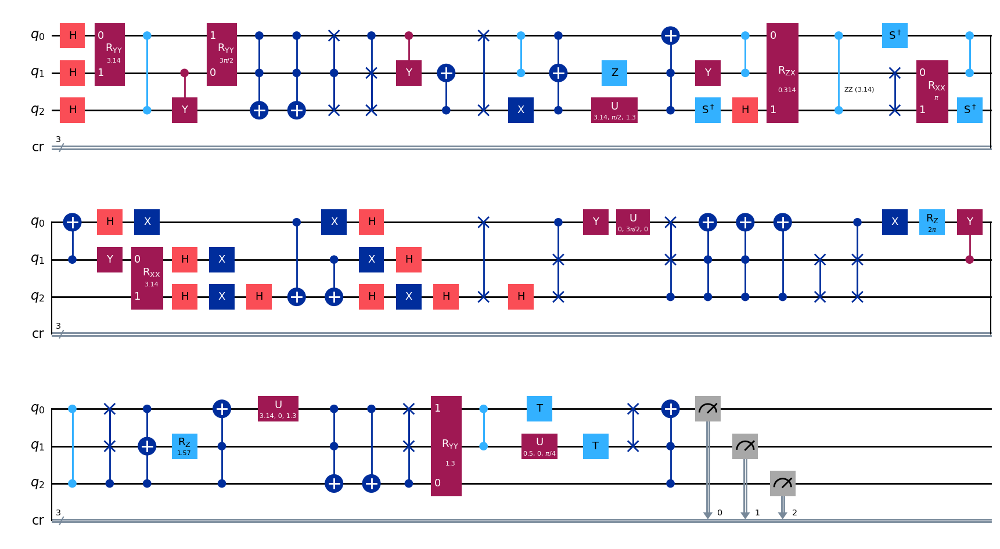

gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6167000000000002,) , Number of invalids = 26

[Run 4 | Gen 6/99] Best Fitness: 1.6167 | Fidelity: 0.5235 | Gates: 57


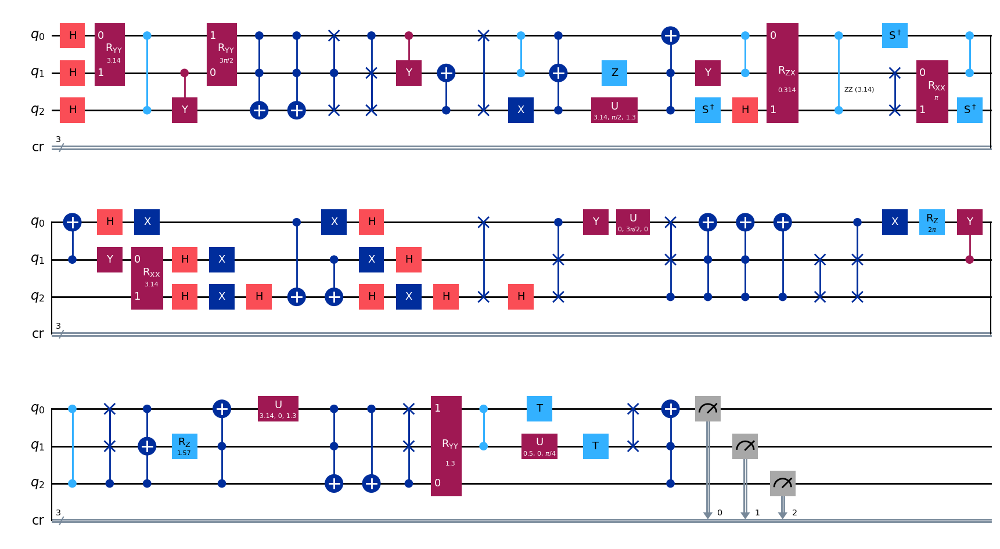

gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6167000000000002,) , Number of invalids = 25

[Run 4 | Gen 7/99] Best Fitness: 1.6167 | Fidelity: 0.5242 | Gates: 57


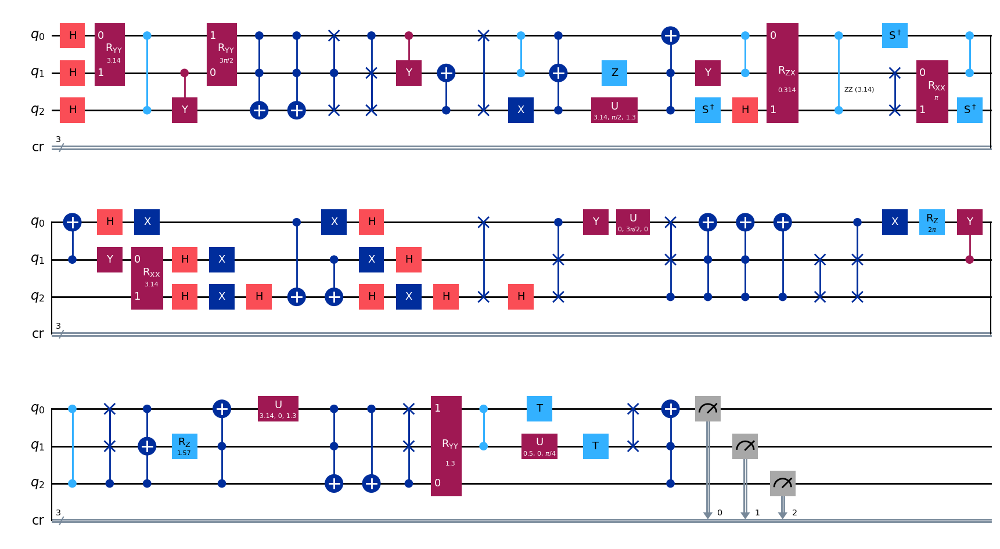

gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6167000000000002,) , Number of invalids = 32

[Run 4 | Gen 8/99] Best Fitness: 1.6167 | Fidelity: 0.5207 | Gates: 57


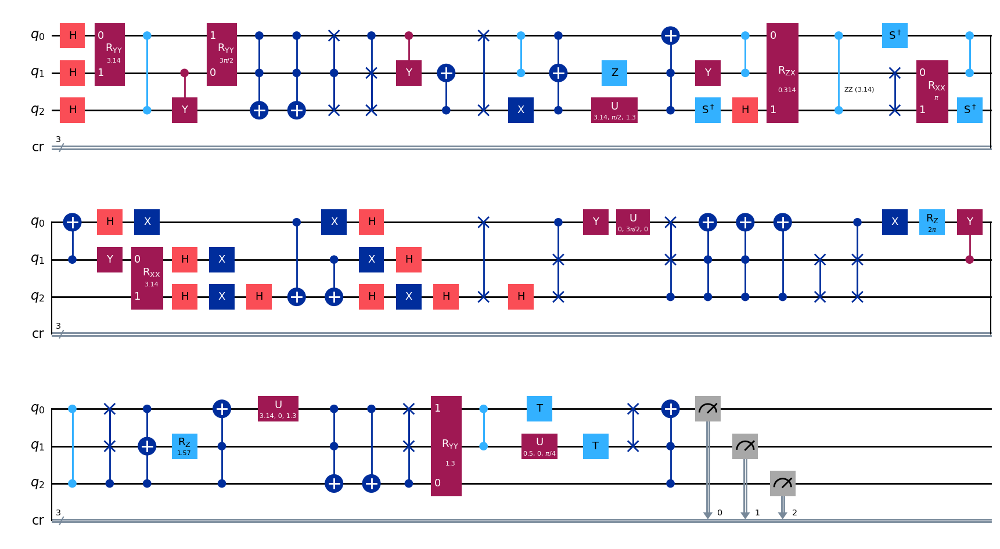

gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6167000000000002,) , Number of invalids = 12

[Run 4 | Gen 9/99] Best Fitness: 1.6167 | Fidelity: 0.5253 | Gates: 57


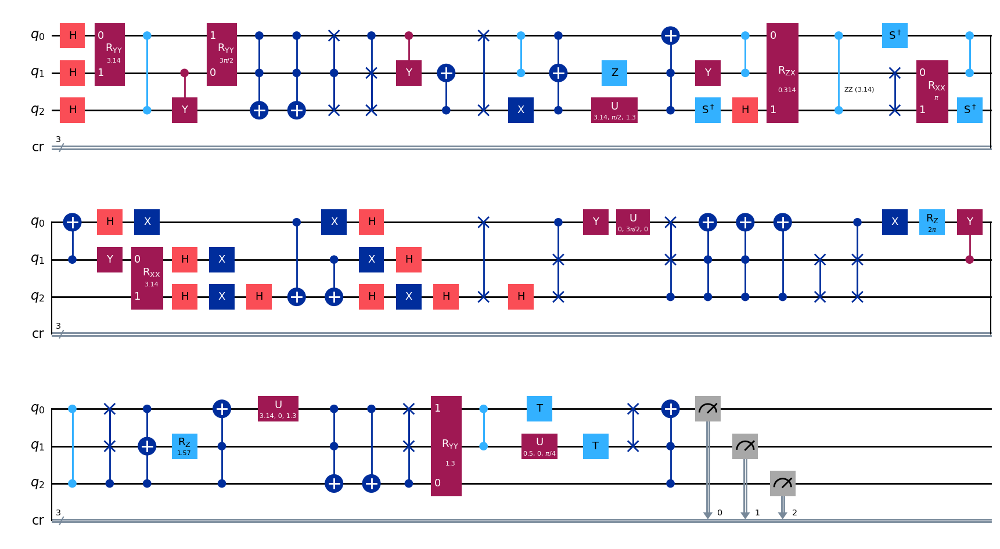

gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6167000000000002,) , Number of invalids = 21

[Run 4 | Gen 10/99] Best Fitness: 1.6167 | Fidelity: 0.5259 | Gates: 57


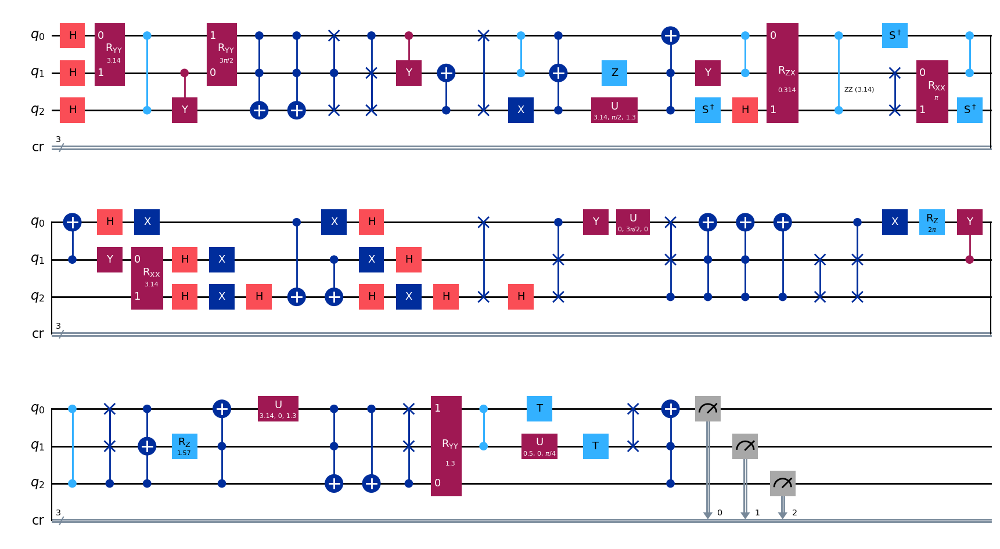

gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6167000000000002,) , Number of invalids = 27

[Run 4 | Gen 11/99] Best Fitness: 1.6167 | Fidelity: 0.5174 | Gates: 57


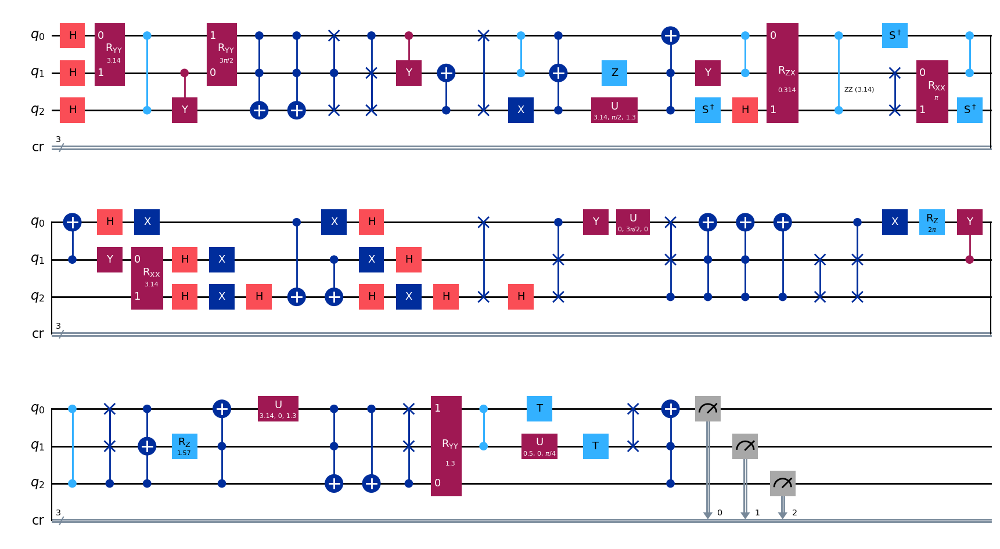

gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6167000000000002,) , Number of invalids = 10

[Run 4 | Gen 12/99] Best Fitness: 1.6167 | Fidelity: 0.5194 | Gates: 57


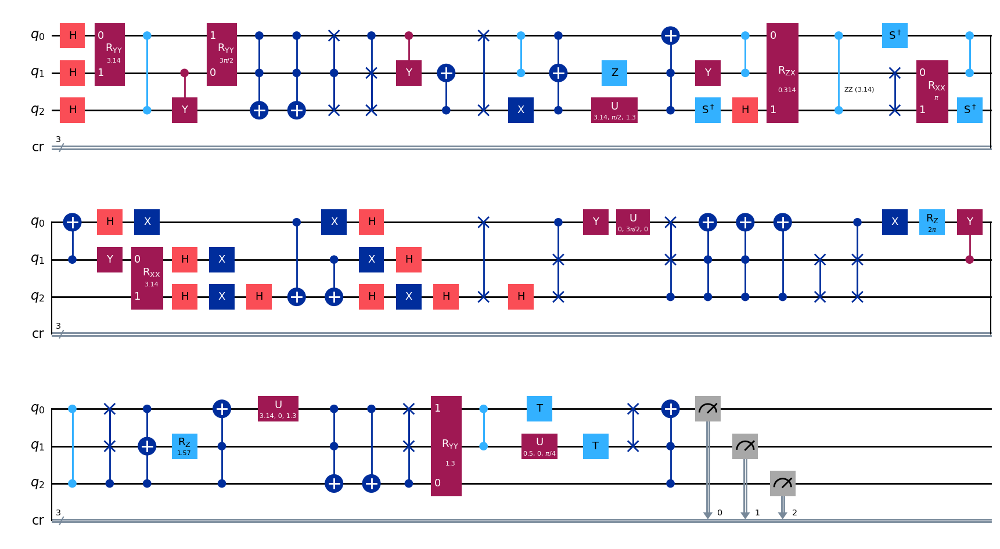

gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6167000000000002,) , Number of invalids = 13

[Run 4 | Gen 13/99] Best Fitness: 1.6167 | Fidelity: 0.5264 | Gates: 57


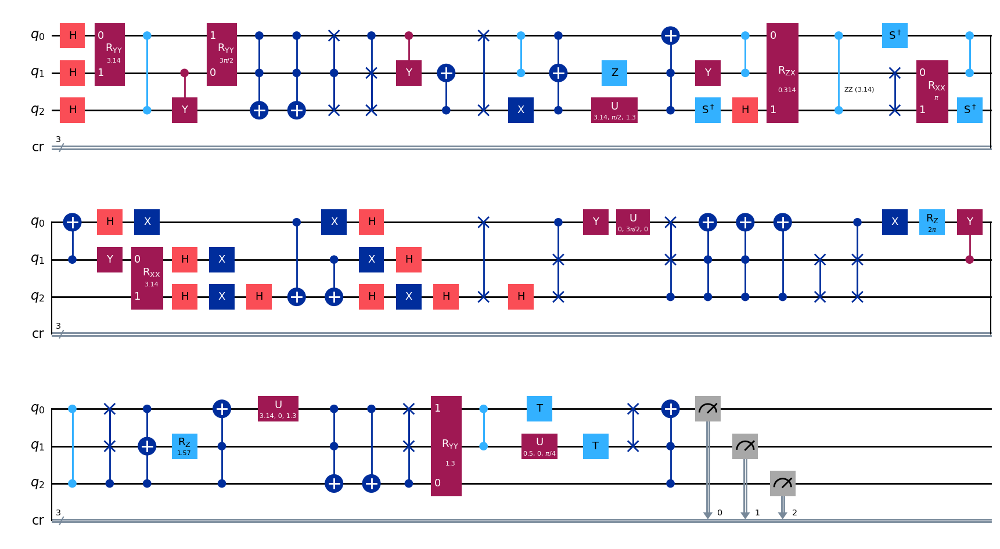

gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6167000000000002,) , Number of invalids = 6

[Run 4 | Gen 14/99] Best Fitness: 1.6167 | Fidelity: 0.5168 | Gates: 57


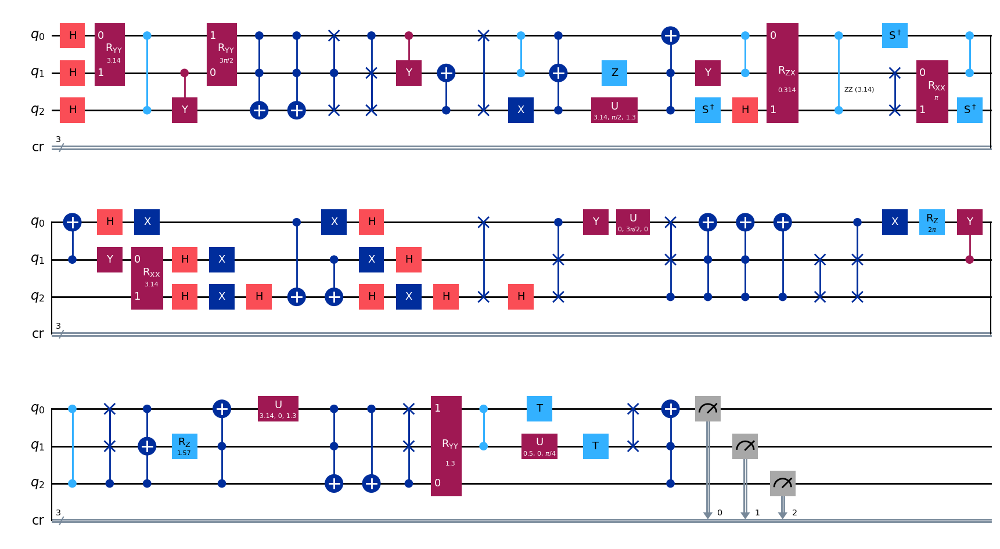

gen = 0 , Best fitness = (1.6167000000000002,)
gen = 1 , Best fitness = (1.6131000000000002,) , Number of invalids = 13

[Run 4 | Gen 15/99] Best Fitness: 1.6131 | Fidelity: 0.5229 | Gates: 57


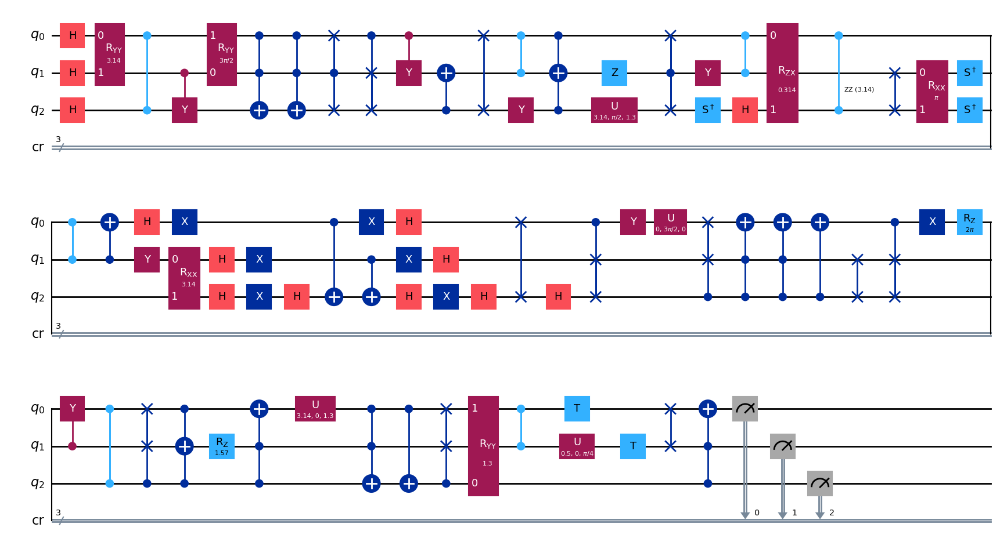

gen = 0 , Best fitness = (1.6131000000000002,)
gen = 1 , Best fitness = (1.6131000000000002,) , Number of invalids = 9

[Run 4 | Gen 16/99] Best Fitness: 1.6131 | Fidelity: 0.5253 | Gates: 57


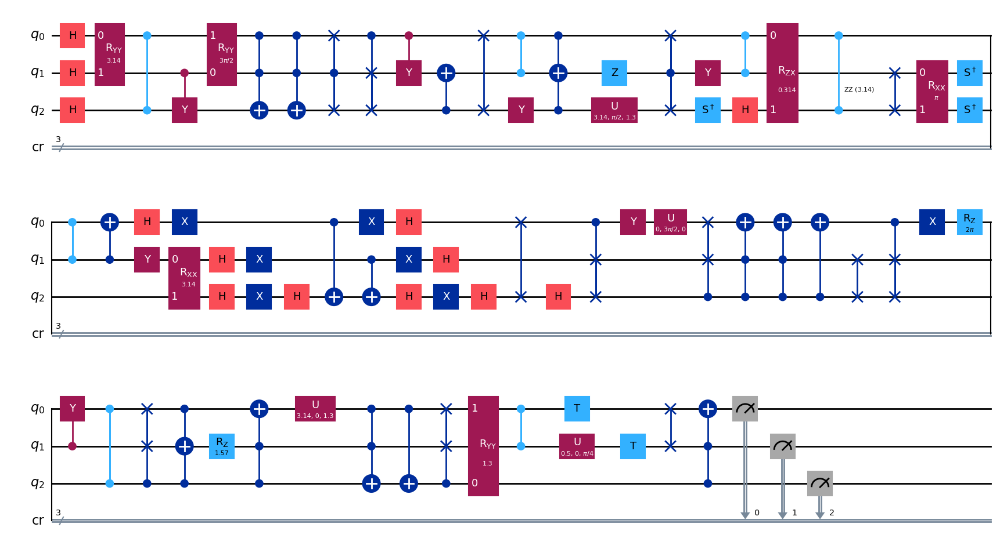

gen = 0 , Best fitness = (1.6131000000000002,)
gen = 1 , Best fitness = (1.6131000000000002,) , Number of invalids = 6

[Run 4 | Gen 17/99] Best Fitness: 1.6131 | Fidelity: 0.5261 | Gates: 57


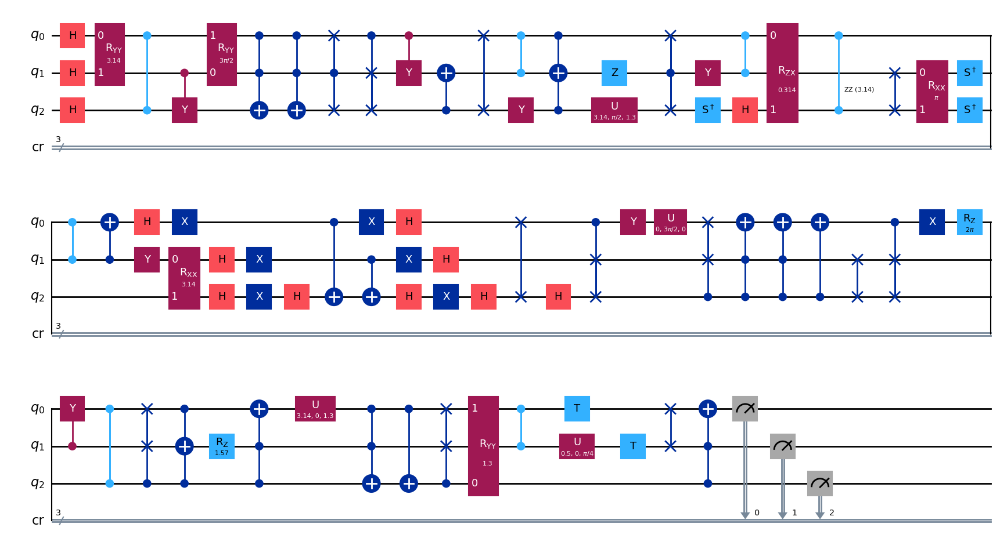

gen = 0 , Best fitness = (1.6131000000000002,)
gen = 1 , Best fitness = (1.6131000000000002,) , Number of invalids = 5

[Run 4 | Gen 18/99] Best Fitness: 1.6131 | Fidelity: 0.5320 | Gates: 57


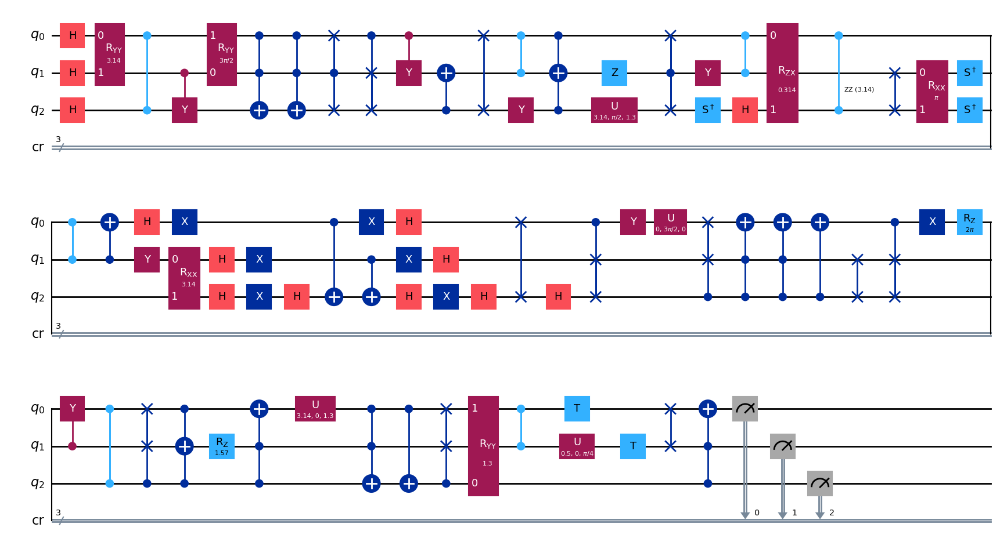

gen = 0 , Best fitness = (1.6131000000000002,)
gen = 1 , Best fitness = (1.6131000000000002,) , Number of invalids = 12

[Run 4 | Gen 19/99] Best Fitness: 1.6131 | Fidelity: 0.5213 | Gates: 57


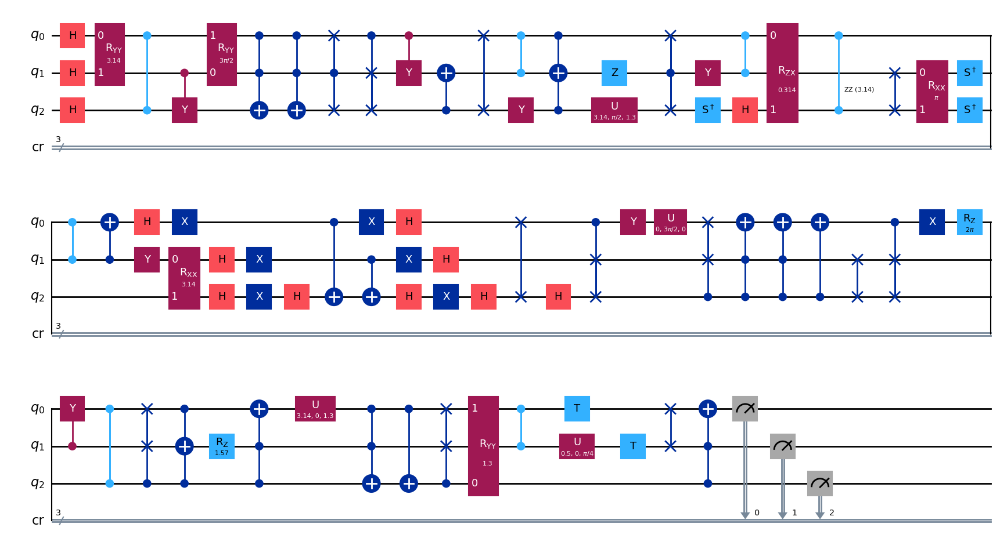

gen = 0 , Best fitness = (1.6131000000000002,)
gen = 1 , Best fitness = (1.395,) , Number of invalids = 7

[Run 4 | Gen 20/99] Best Fitness: 1.3950 | Fidelity: 0.5619 | Gates: 48


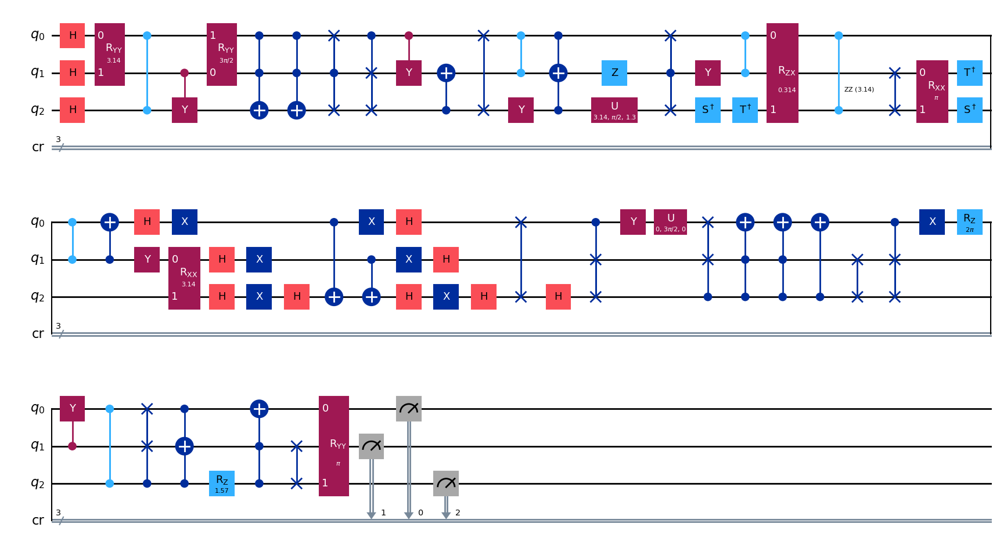

gen = 0 , Best fitness = (1.395,)
gen = 1 , Best fitness = (1.395,) , Number of invalids = 10

[Run 4 | Gen 21/99] Best Fitness: 1.3950 | Fidelity: 0.5610 | Gates: 48


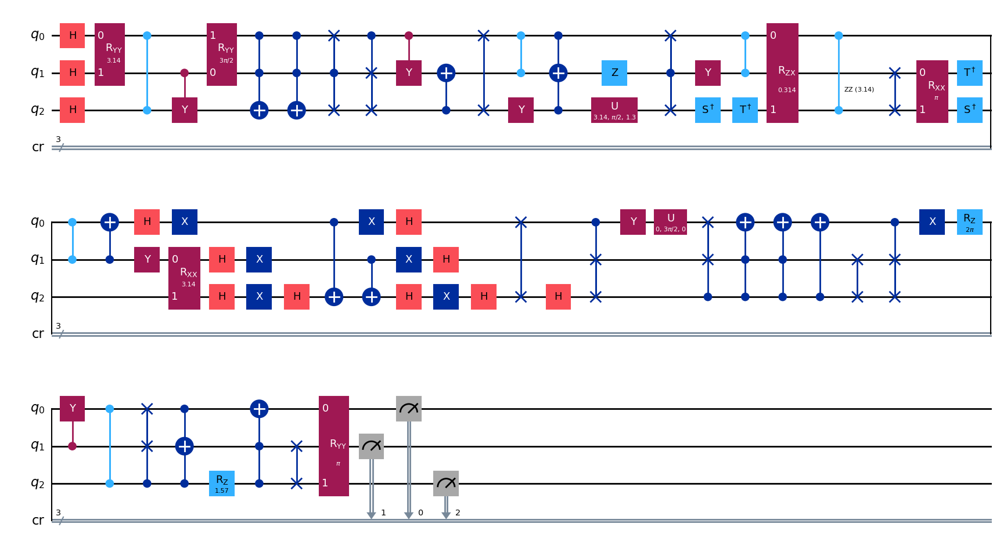

gen = 0 , Best fitness = (1.395,)
gen = 1 , Best fitness = (1.395,) , Number of invalids = 4

[Run 4 | Gen 22/99] Best Fitness: 1.3950 | Fidelity: 0.5610 | Gates: 48


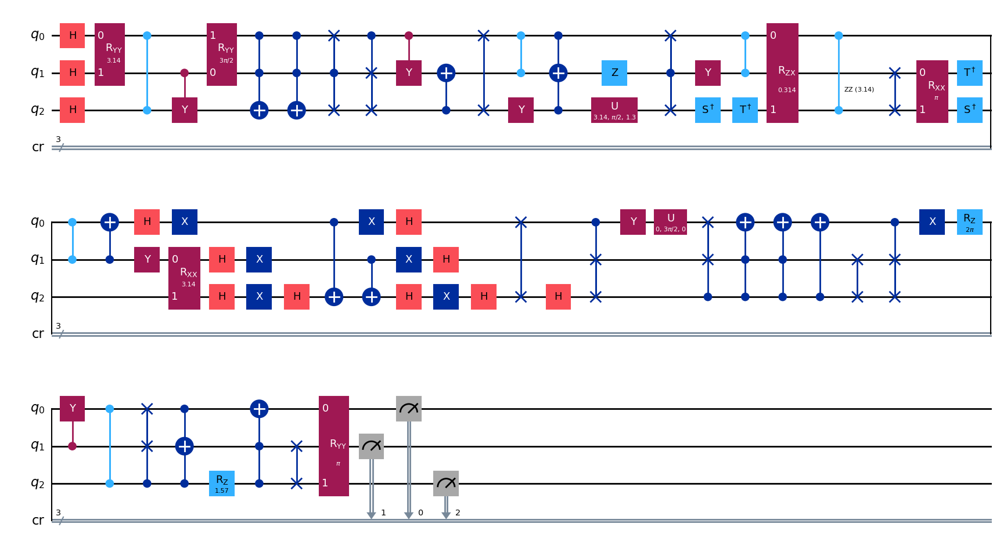

gen = 0 , Best fitness = (1.395,)
gen = 1 , Best fitness = (1.395,) , Number of invalids = 7

[Run 4 | Gen 23/99] Best Fitness: 1.3950 | Fidelity: 0.5707 | Gates: 48


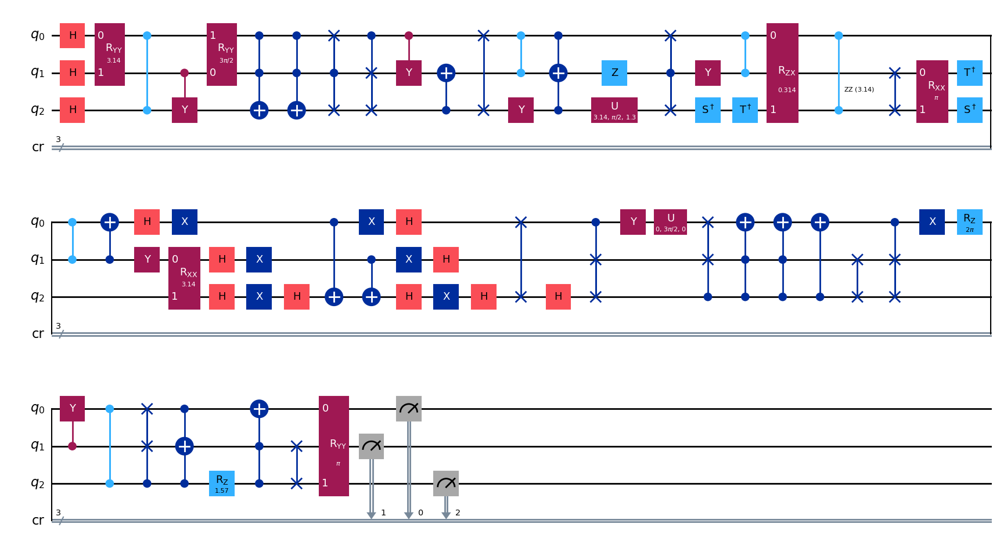

gen = 0 , Best fitness = (1.395,)
gen = 1 , Best fitness = (1.096,) , Number of invalids = 8

[Run 4 | Gen 24/99] Best Fitness: 1.0960 | Fidelity: 0.5596 | Gates: 33


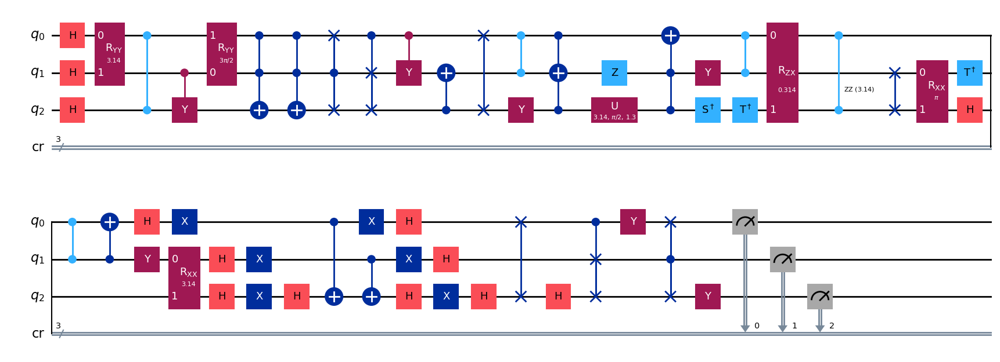

gen = 0 , Best fitness = (1.096,)
gen = 1 , Best fitness = (1.096,) , Number of invalids = 4

[Run 4 | Gen 25/99] Best Fitness: 1.0960 | Fidelity: 0.5619 | Gates: 33


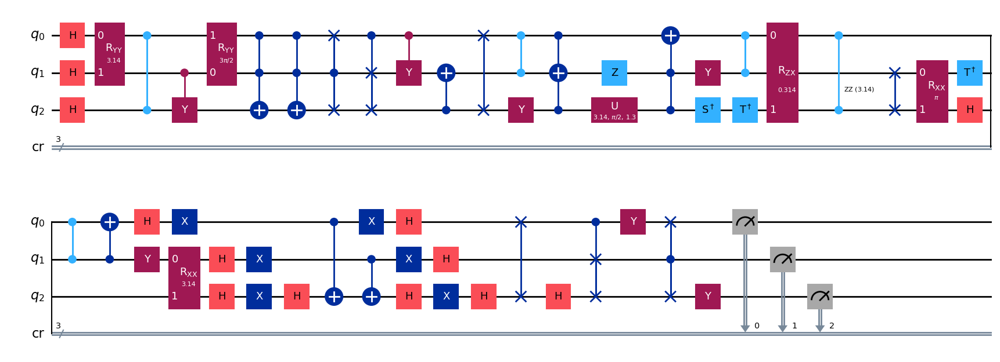

gen = 0 , Best fitness = (1.096,)
gen = 1 , Best fitness = (1.0927,) , Number of invalids = 4

[Run 4 | Gen 26/99] Best Fitness: 1.0927 | Fidelity: 0.5657 | Gates: 33


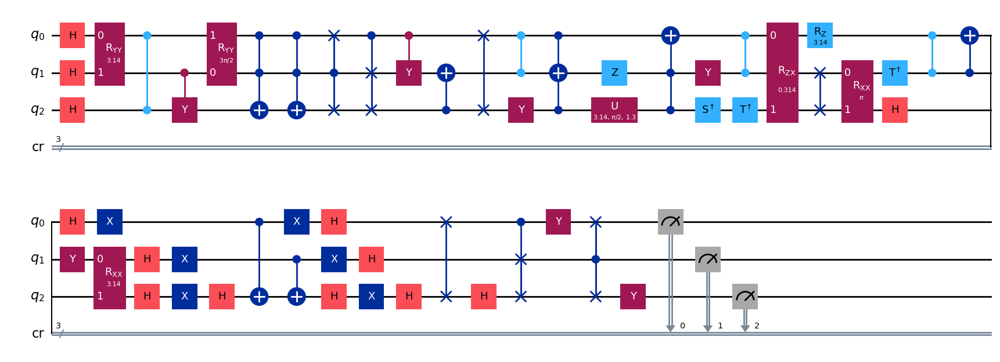

gen = 0 , Best fitness = (1.0927,)
gen = 1 , Best fitness = (1.0927,) , Number of invalids = 8

[Run 4 | Gen 27/99] Best Fitness: 1.0927 | Fidelity: 0.5709 | Gates: 33


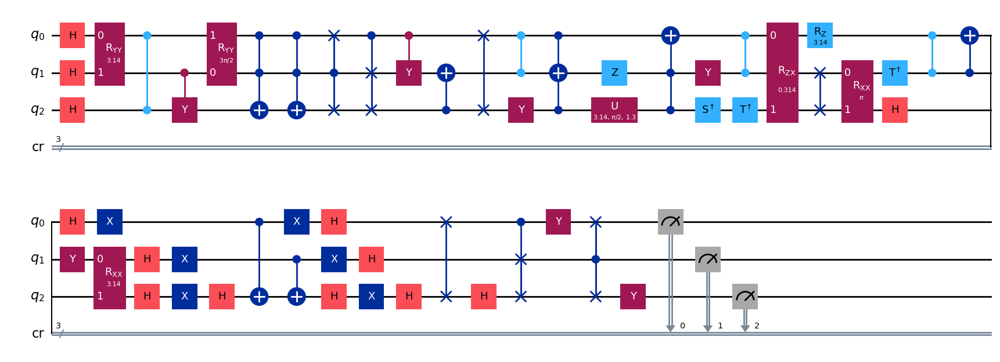

gen = 0 , Best fitness = (1.0927,)
gen = 1 , Best fitness = (1.0927,) , Number of invalids = 7

[Run 4 | Gen 28/99] Best Fitness: 1.0927 | Fidelity: 0.5658 | Gates: 33


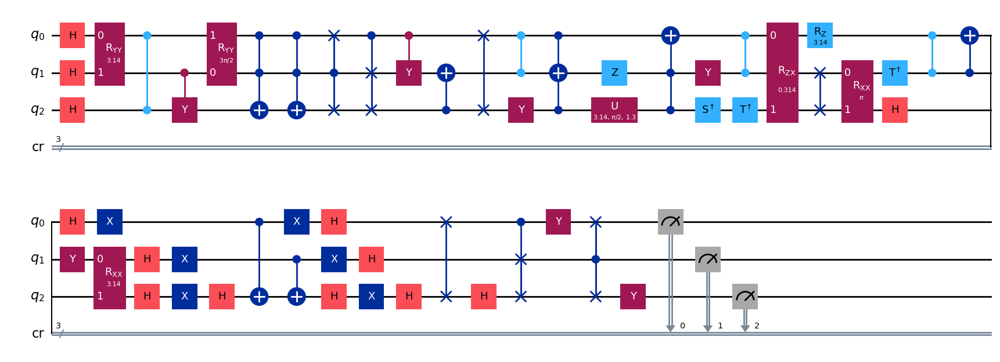

gen = 0 , Best fitness = (1.0927,)
gen = 1 , Best fitness = (1.0927,) , Number of invalids = 10

[Run 4 | Gen 29/99] Best Fitness: 1.0927 | Fidelity: 0.5611 | Gates: 33


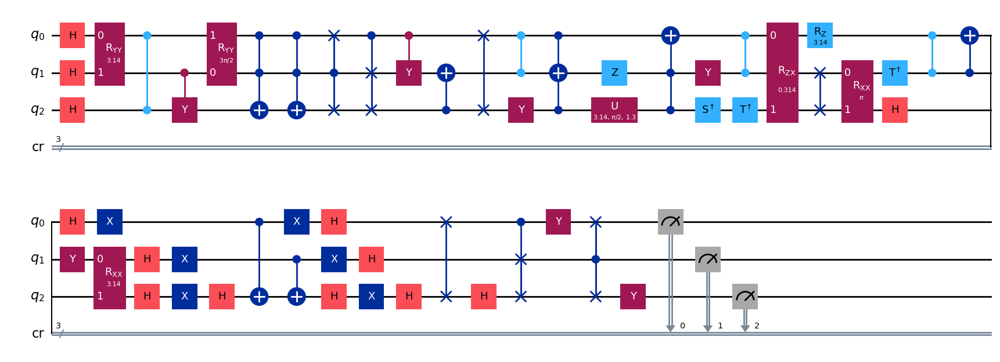

gen = 0 , Best fitness = (1.0927,)
gen = 1 , Best fitness = (1.0927,) , Number of invalids = 7

[Run 4 | Gen 30/99] Best Fitness: 1.0927 | Fidelity: 0.5629 | Gates: 33


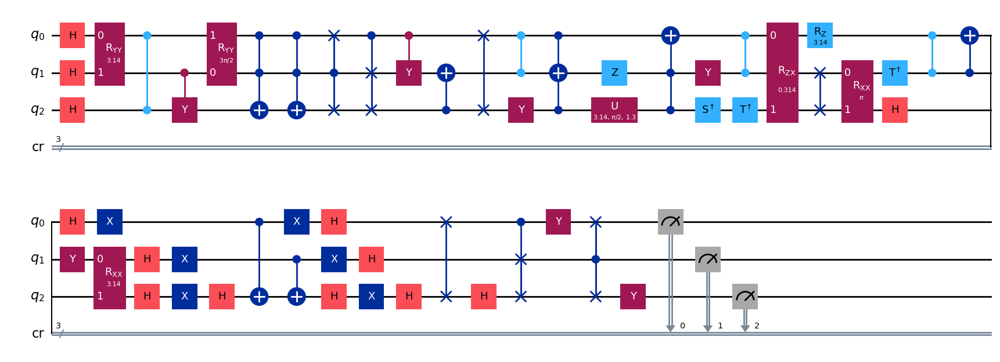

gen = 0 , Best fitness = (1.0927,)
gen = 1 , Best fitness = (1.0927,) , Number of invalids = 8

[Run 4 | Gen 31/99] Best Fitness: 1.0927 | Fidelity: 0.5559 | Gates: 33


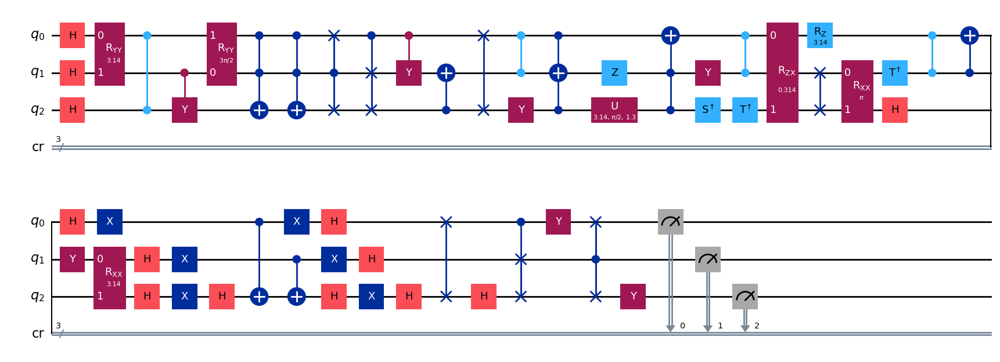

gen = 0 , Best fitness = (1.0927,)
gen = 1 , Best fitness = (1.0927,) , Number of invalids = 7

[Run 4 | Gen 32/99] Best Fitness: 1.0927 | Fidelity: 0.5722 | Gates: 33


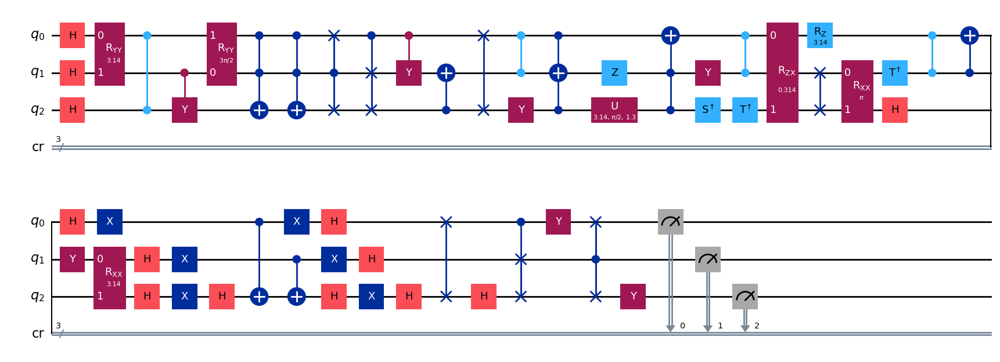

gen = 0 , Best fitness = (1.0927,)
gen = 1 , Best fitness = (1.0906,) , Number of invalids = 9

[Run 4 | Gen 33/99] Best Fitness: 1.0906 | Fidelity: 0.5592 | Gates: 33


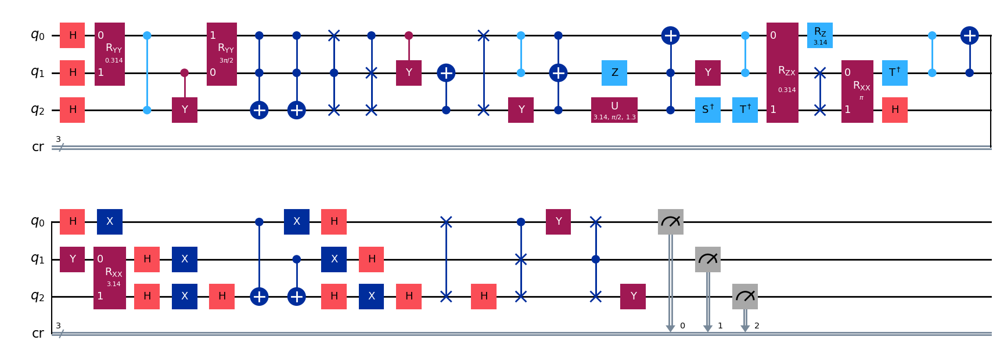

gen = 0 , Best fitness = (1.0906,)
gen = 1 , Best fitness = (1.0862,) , Number of invalids = 9

[Run 4 | Gen 34/99] Best Fitness: 1.0862 | Fidelity: 0.5612 | Gates: 33


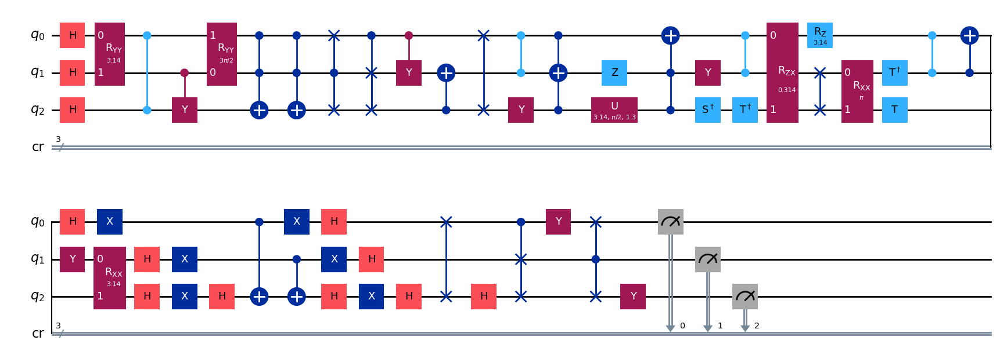

gen = 0 , Best fitness = (1.0862,)
gen = 1 , Best fitness = (1.0862,) , Number of invalids = 10

[Run 4 | Gen 35/99] Best Fitness: 1.0862 | Fidelity: 0.5577 | Gates: 33


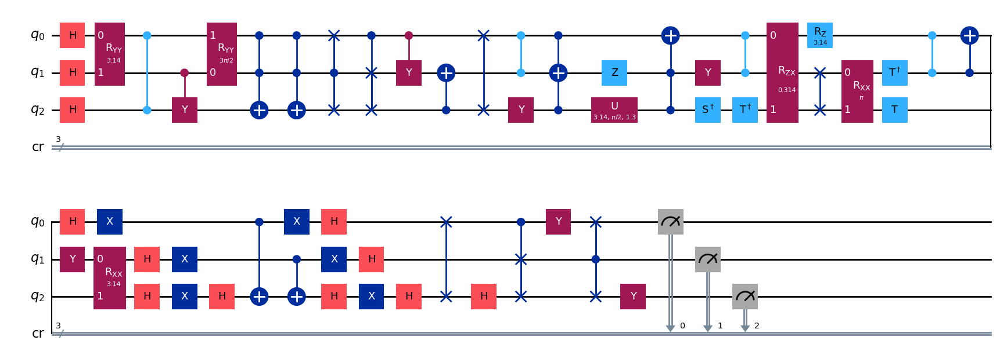

gen = 0 , Best fitness = (1.0862,)
gen = 1 , Best fitness = (1.0862,) , Number of invalids = 5

[Run 4 | Gen 36/99] Best Fitness: 1.0862 | Fidelity: 0.5550 | Gates: 33


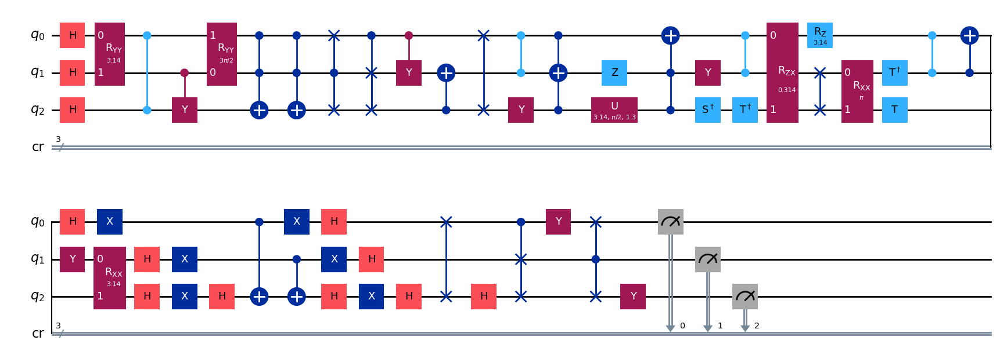

gen = 0 , Best fitness = (1.0862,)
gen = 1 , Best fitness = (1.0862,) , Number of invalids = 13

[Run 4 | Gen 37/99] Best Fitness: 1.0862 | Fidelity: 0.5542 | Gates: 33


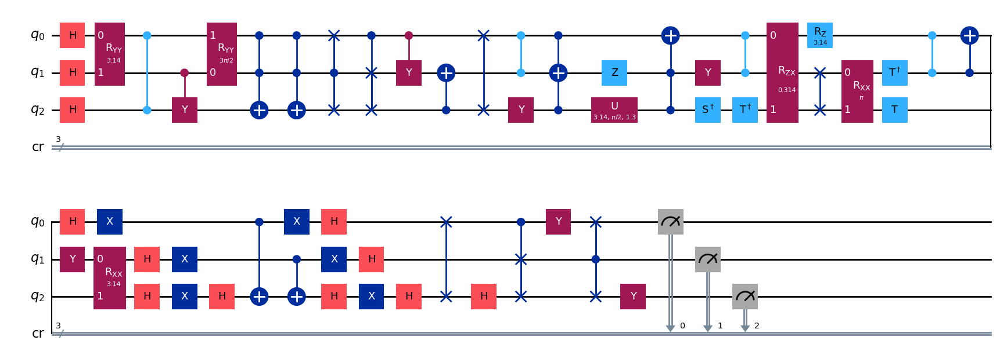

gen = 0 , Best fitness = (1.0862,)
gen = 1 , Best fitness = (1.0862,) , Number of invalids = 9

[Run 4 | Gen 38/99] Best Fitness: 1.0862 | Fidelity: 0.5527 | Gates: 33


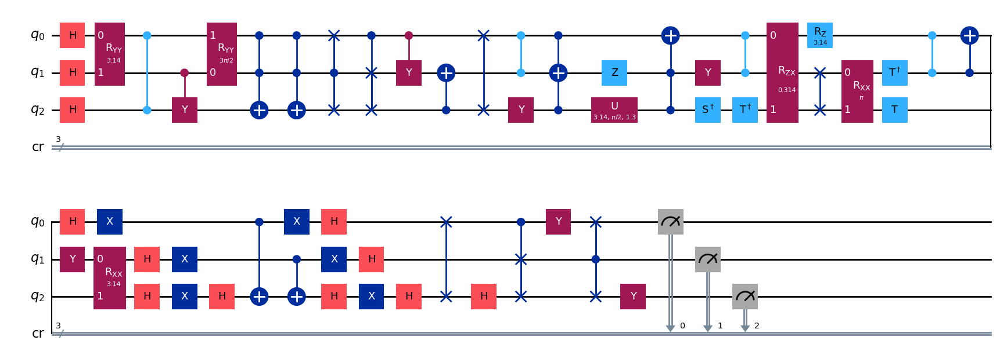

gen = 0 , Best fitness = (1.0862,)
gen = 1 , Best fitness = (1.0862,) , Number of invalids = 11

[Run 4 | Gen 39/99] Best Fitness: 1.0862 | Fidelity: 0.5615 | Gates: 33


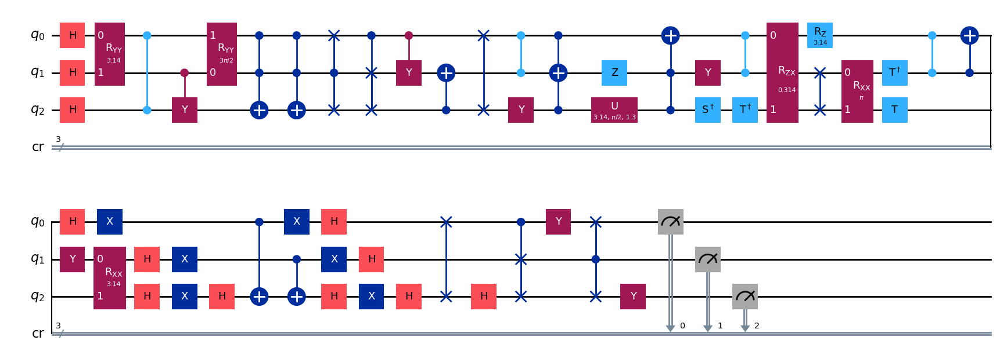

gen = 0 , Best fitness = (1.0862,)
gen = 1 , Best fitness = (1.0862,) , Number of invalids = 4

[Run 4 | Gen 40/99] Best Fitness: 1.0862 | Fidelity: 0.5733 | Gates: 33


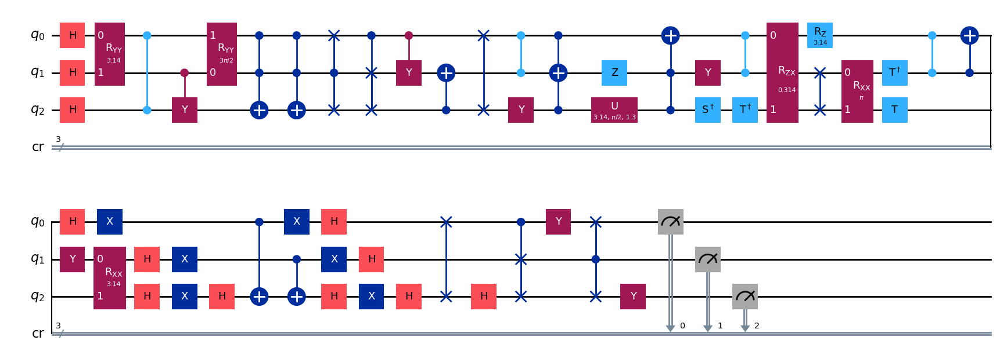

gen = 0 , Best fitness = (1.0862,)
gen = 1 , Best fitness = (1.0862,) , Number of invalids = 12

[Run 4 | Gen 41/99] Best Fitness: 1.0862 | Fidelity: 0.5637 | Gates: 33


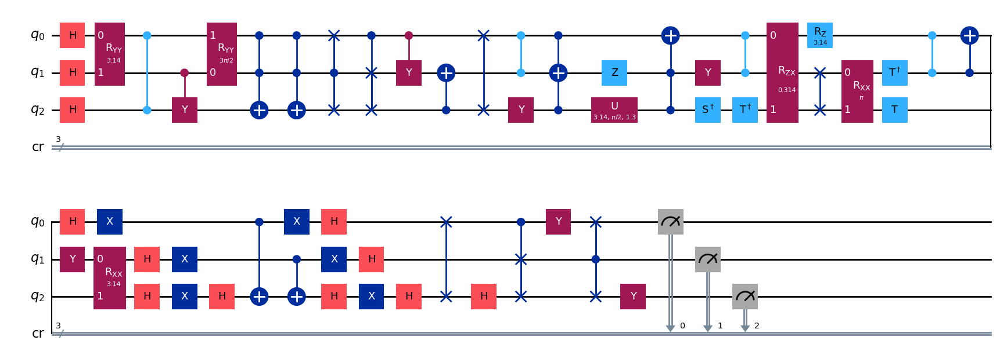

gen = 0 , Best fitness = (1.0862,)
gen = 1 , Best fitness = (1.0862,) , Number of invalids = 7

[Run 4 | Gen 42/99] Best Fitness: 1.0862 | Fidelity: 0.5590 | Gates: 33


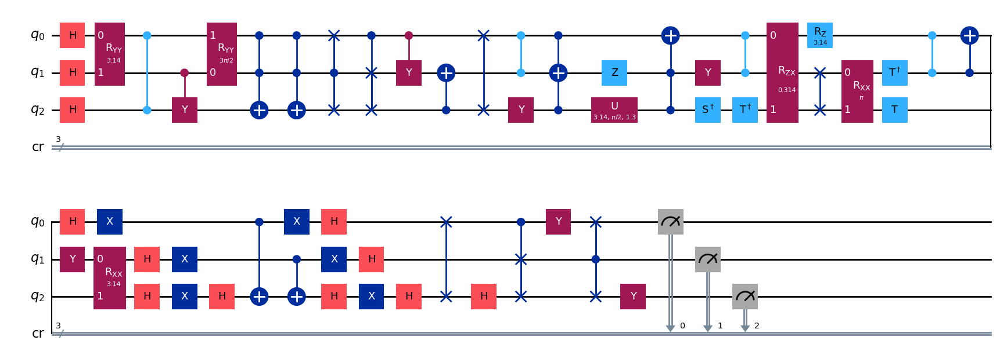

gen = 0 , Best fitness = (1.0862,)
gen = 1 , Best fitness = (1.0862,) , Number of invalids = 5

[Run 4 | Gen 43/99] Best Fitness: 1.0862 | Fidelity: 0.5650 | Gates: 33


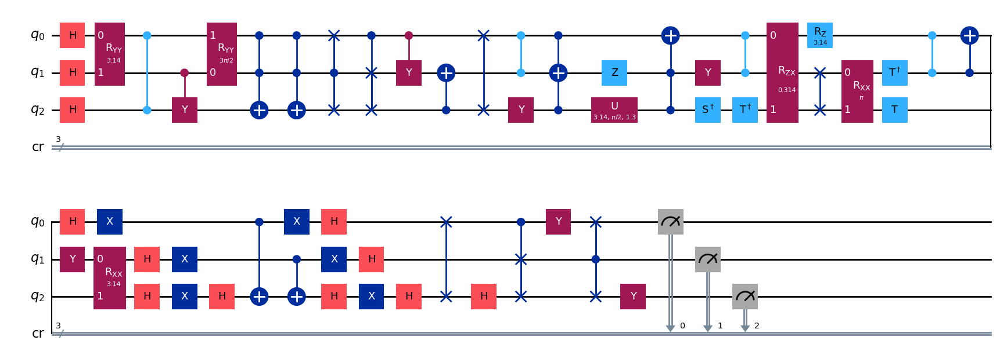

gen = 0 , Best fitness = (1.0862,)
gen = 1 , Best fitness = (1.0841,) , Number of invalids = 4

[Run 4 | Gen 44/99] Best Fitness: 1.0841 | Fidelity: 0.5611 | Gates: 33


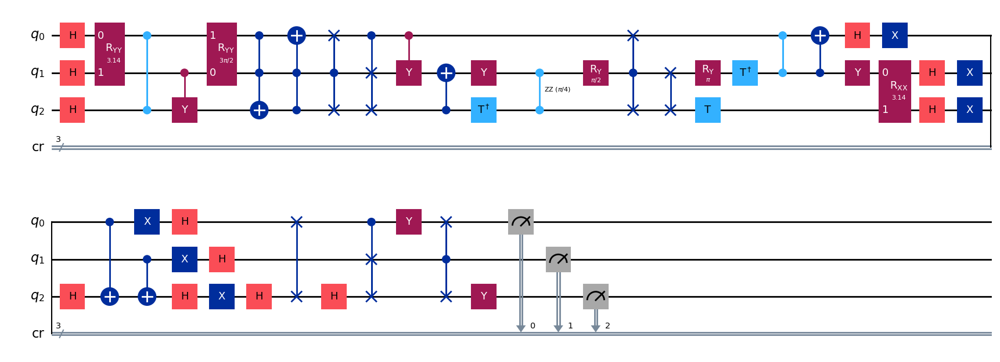

gen = 0 , Best fitness = (1.0841,)
gen = 1 , Best fitness = (1.0830000000000002,) , Number of invalids = 1

[Run 4 | Gen 45/99] Best Fitness: 1.0830 | Fidelity: 0.5625 | Gates: 33


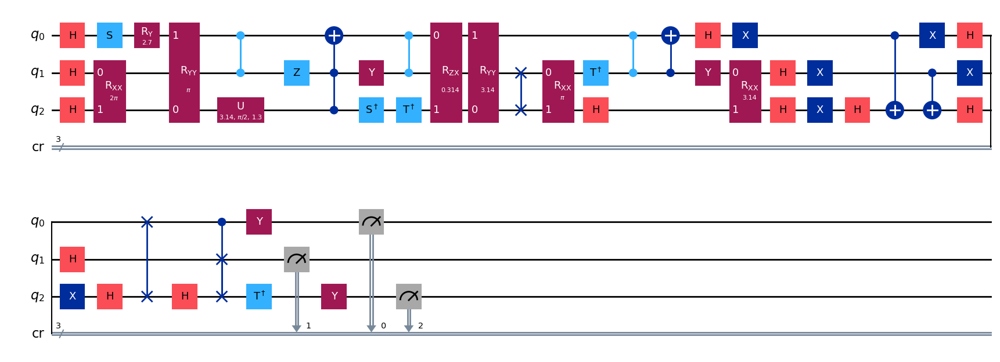

gen = 0 , Best fitness = (1.0830000000000002,)
gen = 1 , Best fitness = (1.0554999999999999,) , Number of invalids = 2

[Run 4 | Gen 46/99] Best Fitness: 1.0555 | Fidelity: 0.5526 | Gates: 31


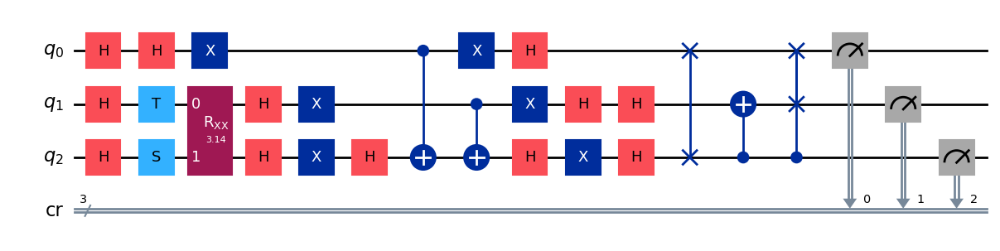

gen = 0 , Best fitness = (1.0554999999999999,)
gen = 1 , Best fitness = (1.0554999999999999,) , Number of invalids = 2

[Run 4 | Gen 47/99] Best Fitness: 1.0555 | Fidelity: 0.5579 | Gates: 31


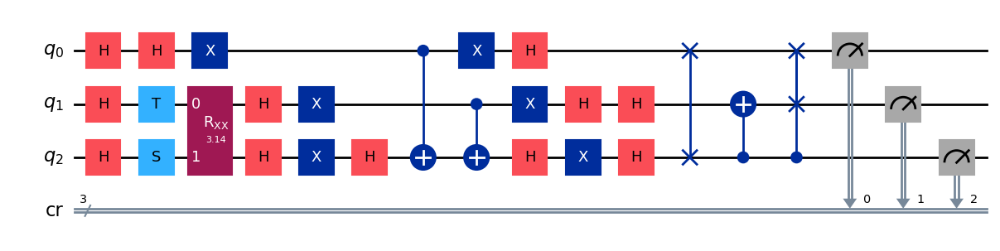

gen = 0 , Best fitness = (1.0554999999999999,)
gen = 1 , Best fitness = (1.0459999999999998,) , Number of invalids = 0

[Run 4 | Gen 48/99] Best Fitness: 1.0460 | Fidelity: 0.5636 | Gates: 30


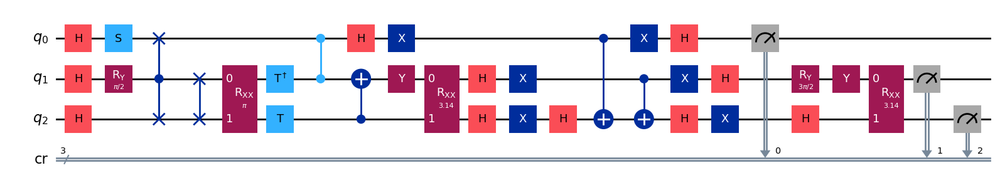

gen = 0 , Best fitness = (1.0459999999999998,)
gen = 1 , Best fitness = (1.0346,) , Number of invalids = 2

[Run 4 | Gen 49/99] Best Fitness: 1.0346 | Fidelity: 0.5587 | Gates: 30


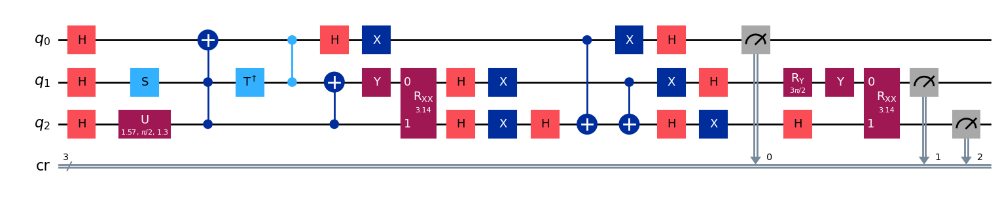

gen = 0 , Best fitness = (1.0346,)
gen = 1 , Best fitness = (1.0346,) , Number of invalids = 5

[Run 4 | Gen 50/99] Best Fitness: 1.0346 | Fidelity: 0.5625 | Gates: 30


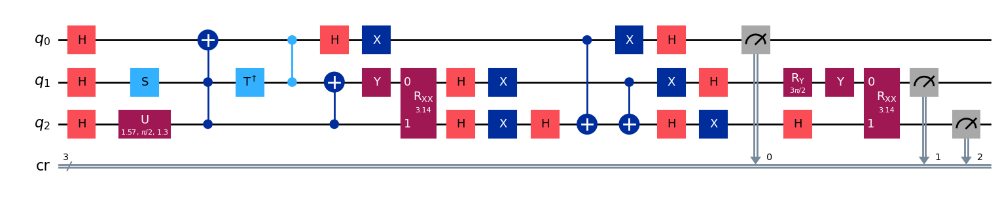

gen = 0 , Best fitness = (1.0346,)
gen = 1 , Best fitness = (1.0310000000000001,) , Number of invalids = 5

[Run 4 | Gen 51/99] Best Fitness: 1.0310 | Fidelity: 0.6236 | Gates: 33


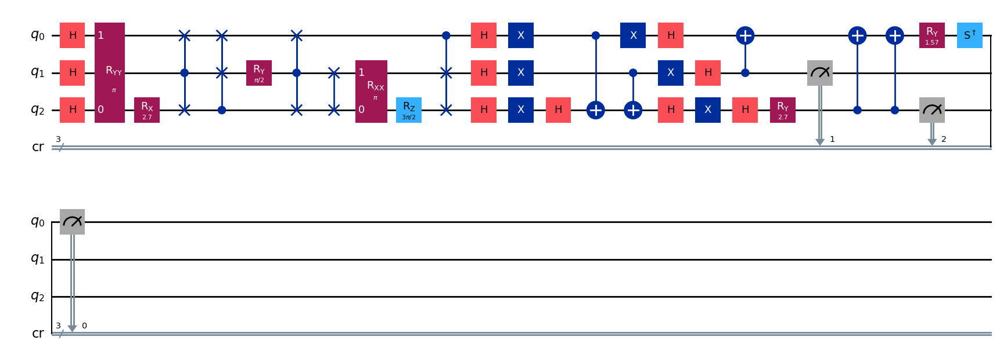

gen = 0 , Best fitness = (1.0310000000000001,)
gen = 1 , Best fitness = (1.0310000000000001,) , Number of invalids = 4

[Run 4 | Gen 52/99] Best Fitness: 1.0310 | Fidelity: 0.6168 | Gates: 33


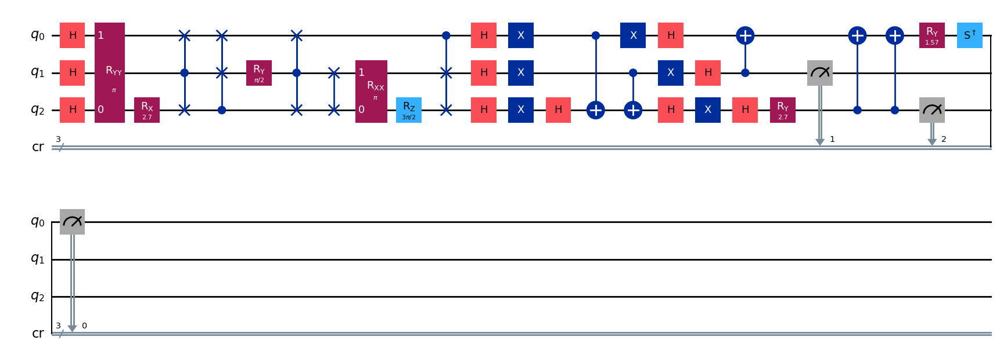

gen = 0 , Best fitness = (1.0310000000000001,)
gen = 1 , Best fitness = (0.9952,) , Number of invalids = 4

[Run 4 | Gen 53/99] Best Fitness: 0.9952 | Fidelity: 0.5771 | Gates: 29


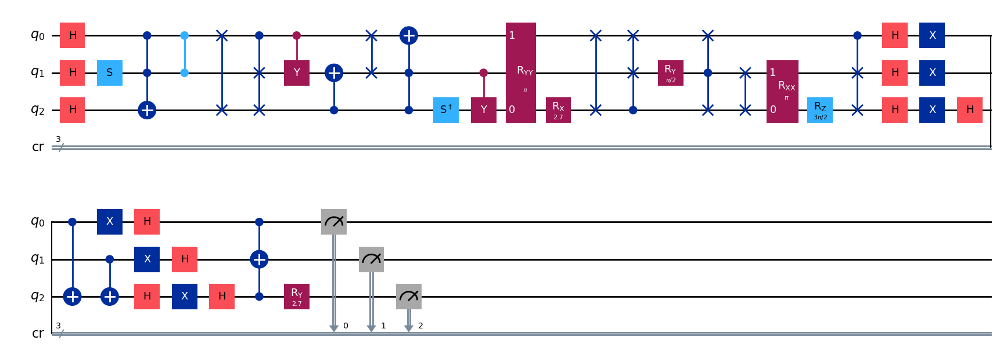

gen = 0 , Best fitness = (0.9952,)
gen = 1 , Best fitness = (0.9484,) , Number of invalids = 7

[Run 4 | Gen 54/99] Best Fitness: 0.9484 | Fidelity: 0.7067 | Gates: 33


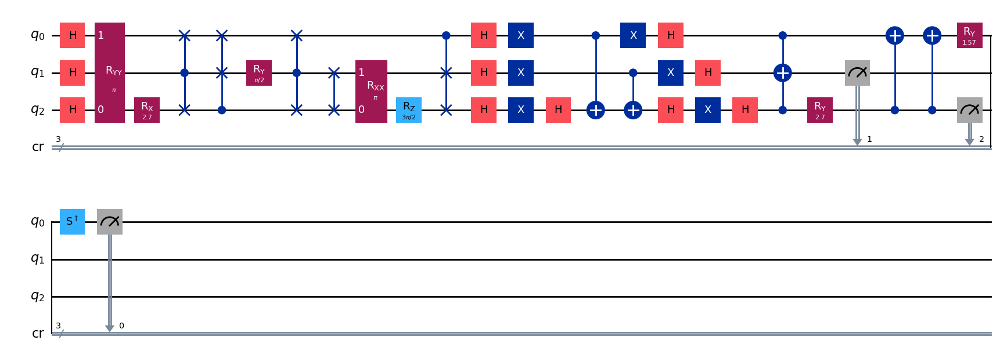

gen = 0 , Best fitness = (0.9484,)
gen = 1 , Best fitness = (0.9484,) , Number of invalids = 5

[Run 4 | Gen 55/99] Best Fitness: 0.9484 | Fidelity: 0.7109 | Gates: 33


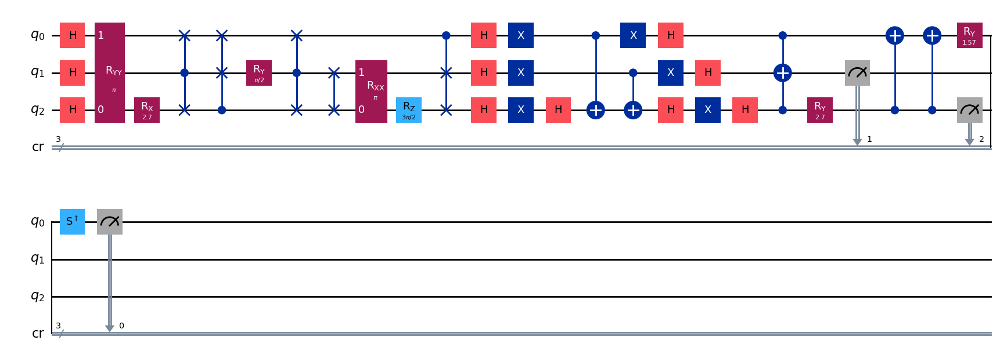

gen = 0 , Best fitness = (0.9484,)
gen = 1 , Best fitness = (0.9484,) , Number of invalids = 2

[Run 4 | Gen 56/99] Best Fitness: 0.9484 | Fidelity: 0.7096 | Gates: 33


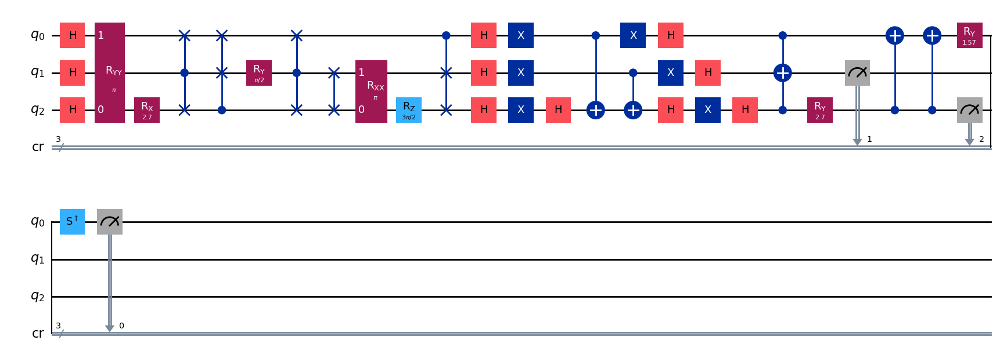

gen = 0 , Best fitness = (0.9484,)
gen = 1 , Best fitness = (0.9484,) , Number of invalids = 2

[Run 4 | Gen 57/99] Best Fitness: 0.9484 | Fidelity: 0.7170 | Gates: 33


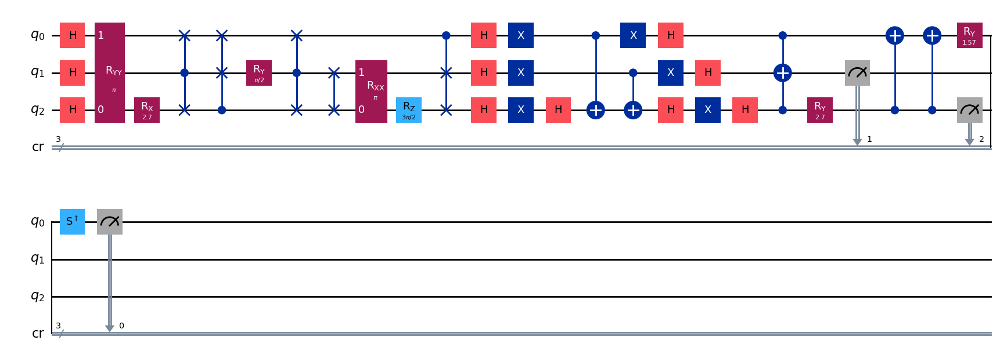

gen = 0 , Best fitness = (0.9484,)
gen = 1 , Best fitness = (0.9484,) , Number of invalids = 4

[Run 4 | Gen 58/99] Best Fitness: 0.9484 | Fidelity: 0.7093 | Gates: 33


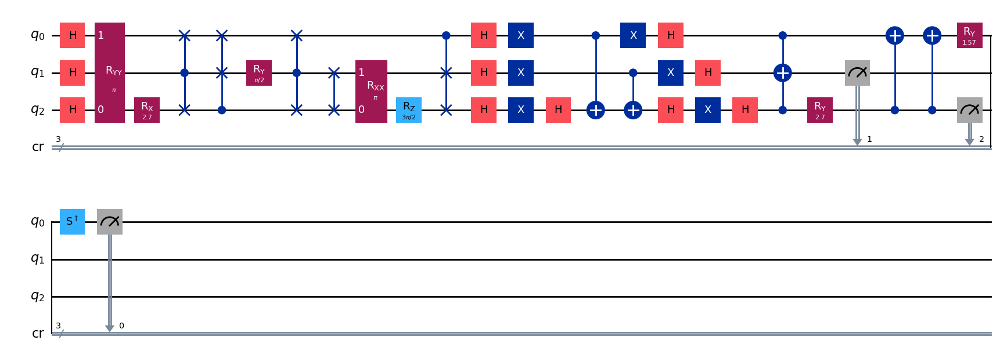

gen = 0 , Best fitness = (0.9484,)
gen = 1 , Best fitness = (0.9484,) , Number of invalids = 0

[Run 4 | Gen 59/99] Best Fitness: 0.9484 | Fidelity: 0.7060 | Gates: 33


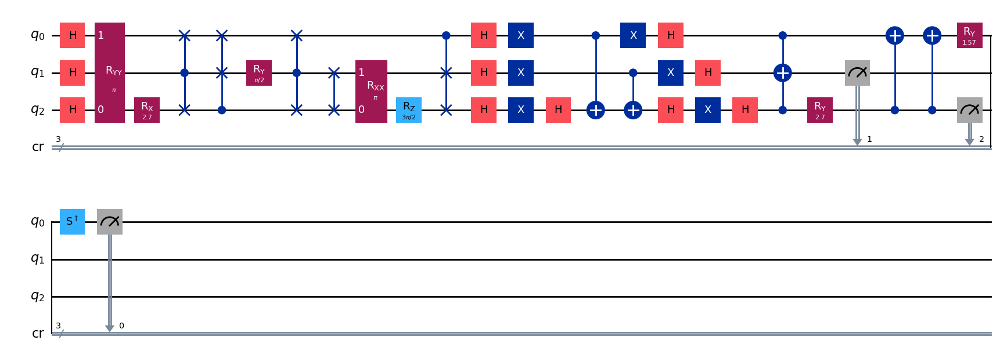

gen = 0 , Best fitness = (0.9484,)
gen = 1 , Best fitness = (0.9484,) , Number of invalids = 0

[Run 4 | Gen 60/99] Best Fitness: 0.9484 | Fidelity: 0.7129 | Gates: 33


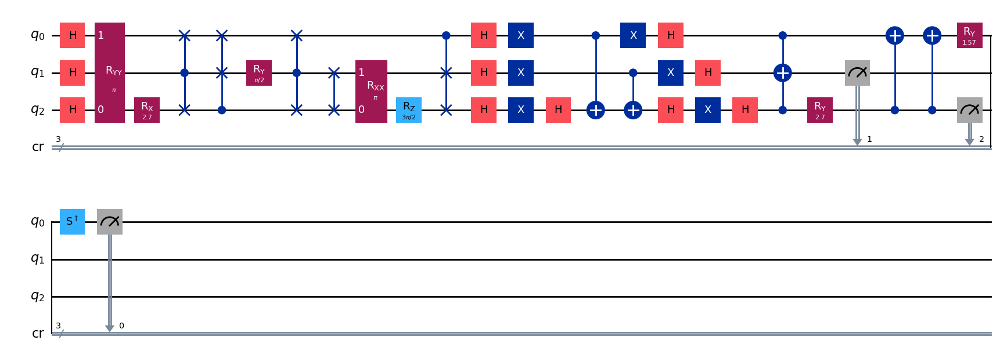

gen = 0 , Best fitness = (0.9484,)
gen = 1 , Best fitness = (0.9484,) , Number of invalids = 1

[Run 4 | Gen 61/99] Best Fitness: 0.9484 | Fidelity: 0.7048 | Gates: 33


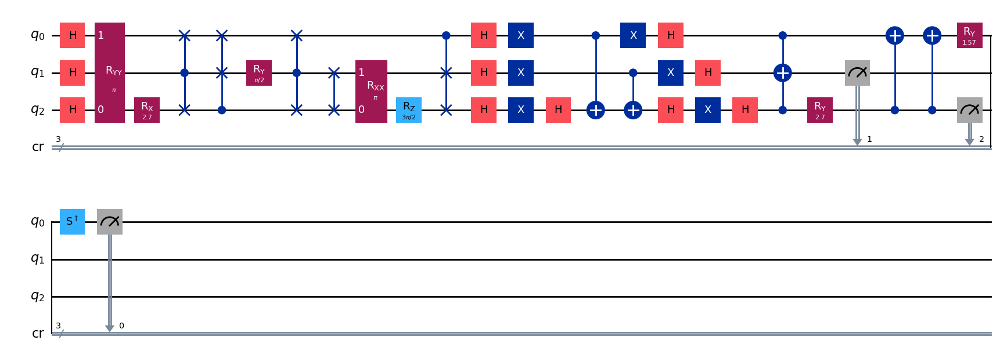

gen = 0 , Best fitness = (0.9484,)
gen = 1 , Best fitness = (0.9466,) , Number of invalids = 1

[Run 4 | Gen 62/99] Best Fitness: 0.9466 | Fidelity: 0.7050 | Gates: 33


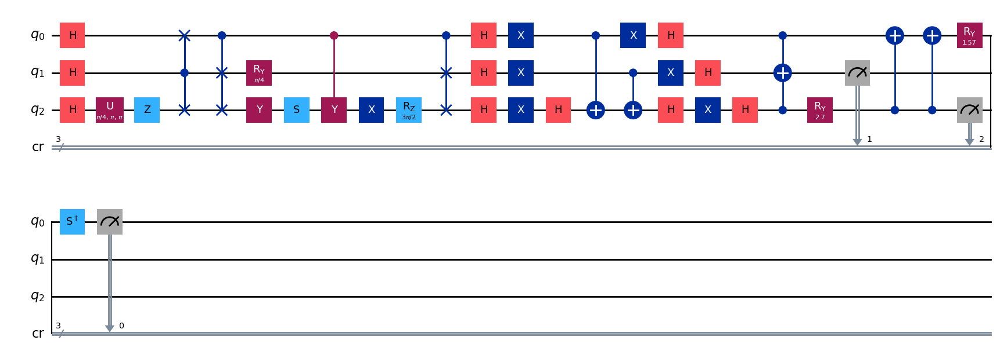

gen = 0 , Best fitness = (0.9466,)
gen = 1 , Best fitness = (0.9452,) , Number of invalids = 0

[Run 4 | Gen 63/99] Best Fitness: 0.9452 | Fidelity: 0.7042 | Gates: 33


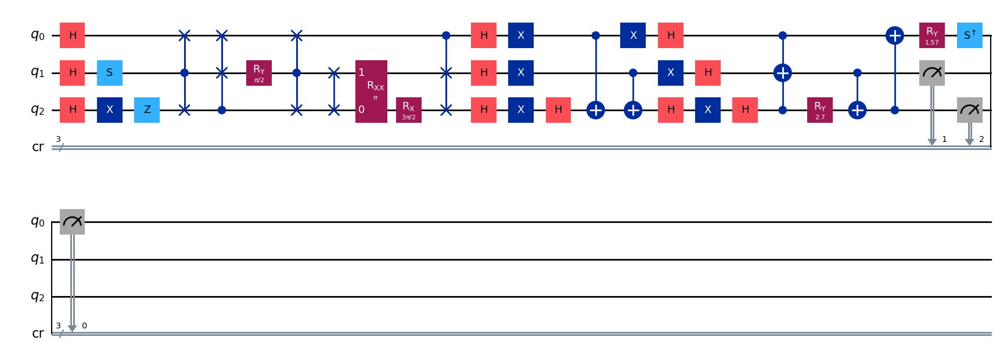

gen = 0 , Best fitness = (0.9452,)
gen = 1 , Best fitness = (0.9452,) , Number of invalids = 0

[Run 4 | Gen 64/99] Best Fitness: 0.9452 | Fidelity: 0.7056 | Gates: 33


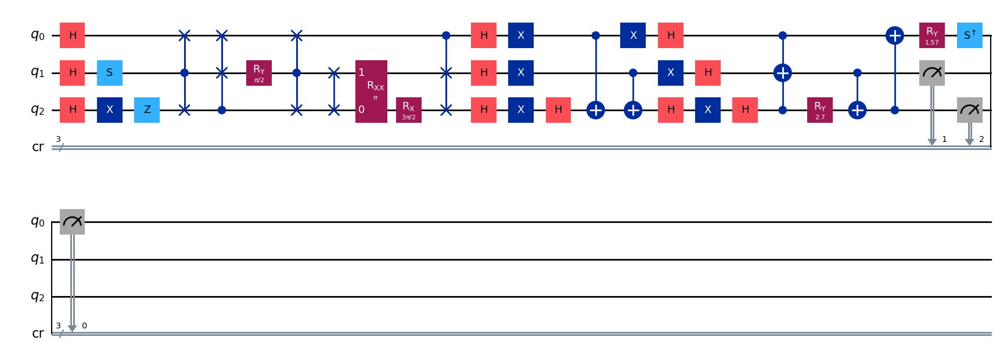

gen = 0 , Best fitness = (0.9452,)
gen = 1 , Best fitness = (0.9449000000000001,) , Number of invalids = 0

[Run 4 | Gen 65/99] Best Fitness: 0.9449 | Fidelity: 0.7091 | Gates: 33


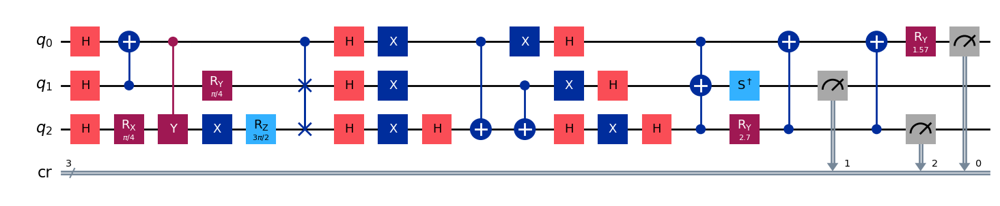

gen = 0 , Best fitness = (0.9449000000000001,)
gen = 1 , Best fitness = (0.9449000000000001,) , Number of invalids = 0

[Run 4 | Gen 66/99] Best Fitness: 0.9449 | Fidelity: 0.7021 | Gates: 33


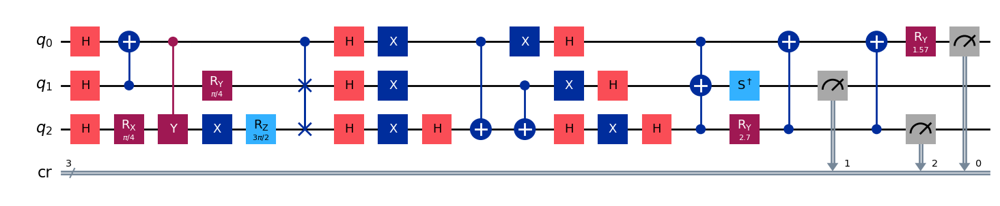

gen = 0 , Best fitness = (0.9449000000000001,)
gen = 1 , Best fitness = (0.9297,) , Number of invalids = 0

[Run 4 | Gen 67/99] Best Fitness: 0.9297 | Fidelity: 0.6983 | Gates: 32


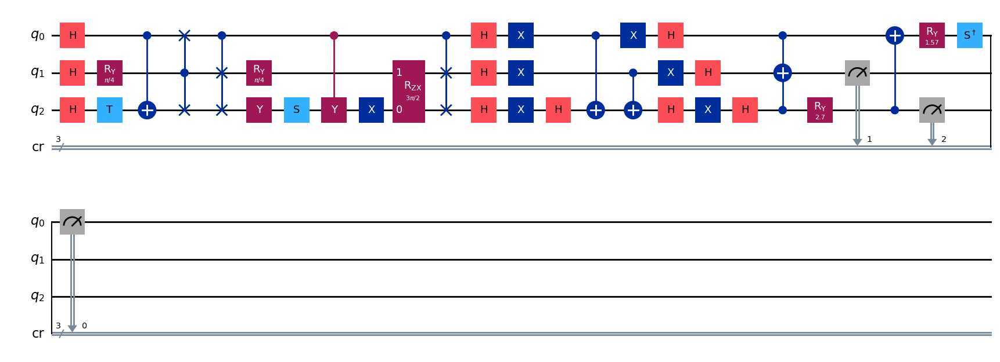

gen = 0 , Best fitness = (0.9297,)
gen = 1 , Best fitness = (0.9093,) , Number of invalids = 0

[Run 4 | Gen 68/99] Best Fitness: 0.9093 | Fidelity: 0.7486 | Gates: 33


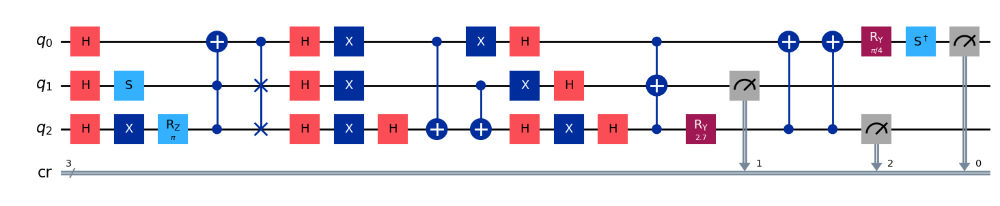

gen = 0 , Best fitness = (0.9093,)
gen = 1 , Best fitness = (0.8766,) , Number of invalids = 0

[Run 4 | Gen 69/99] Best Fitness: 0.8766 | Fidelity: 0.7829 | Gates: 33


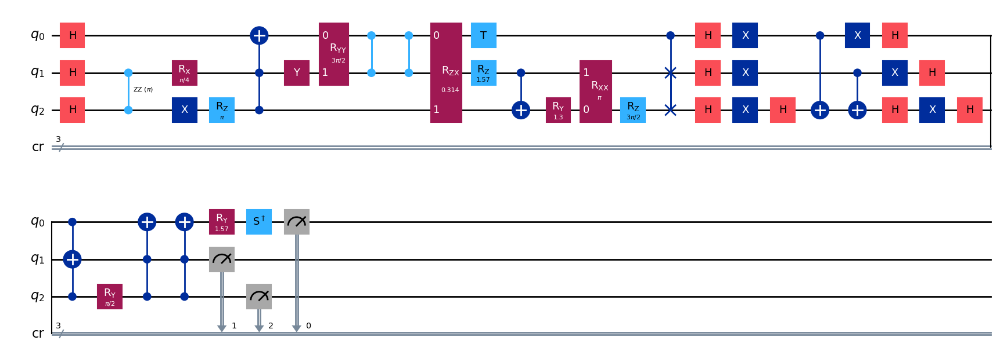

gen = 0 , Best fitness = (0.8766,)
gen = 1 , Best fitness = (0.8742,) , Number of invalids = 0

[Run 4 | Gen 70/99] Best Fitness: 0.8742 | Fidelity: 0.7833 | Gates: 33


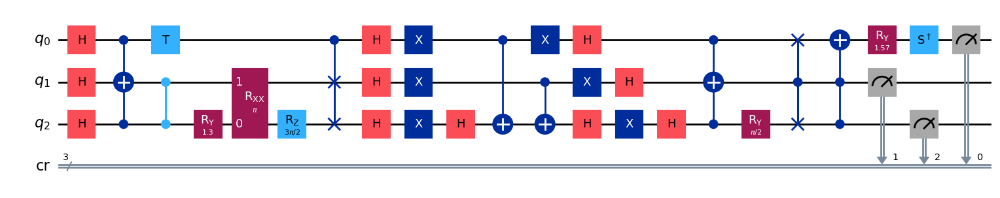

gen = 0 , Best fitness = (0.8742,)
gen = 1 , Best fitness = (0.8742,) , Number of invalids = 0

[Run 4 | Gen 71/99] Best Fitness: 0.8742 | Fidelity: 0.7735 | Gates: 33


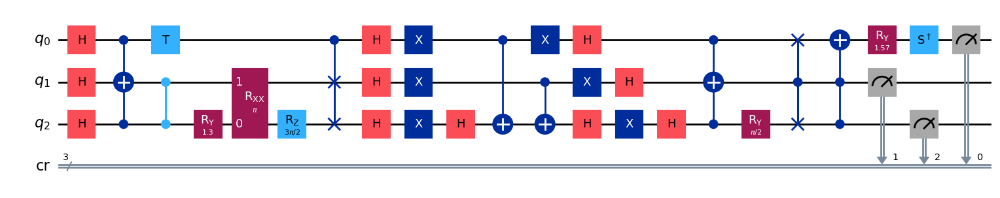

gen = 0 , Best fitness = (0.8742,)
gen = 1 , Best fitness = (0.8553000000000001,) , Number of invalids = 0

[Run 4 | Gen 72/99] Best Fitness: 0.8553 | Fidelity: 0.7836 | Gates: 32


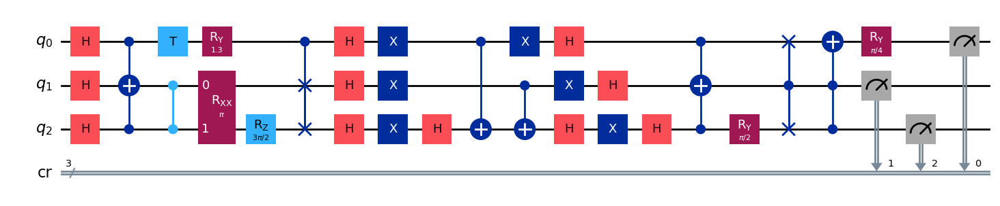

gen = 0 , Best fitness = (0.8553000000000001,)
gen = 1 , Best fitness = (0.8553000000000001,) , Number of invalids = 0

[Run 4 | Gen 73/99] Best Fitness: 0.8553 | Fidelity: 0.7832 | Gates: 32


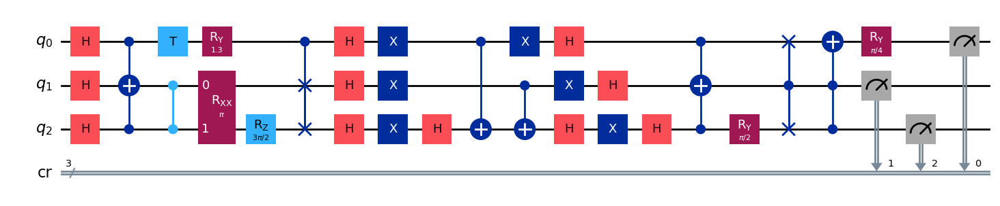

gen = 0 , Best fitness = (0.8553000000000001,)
gen = 1 , Best fitness = (0.8553000000000001,) , Number of invalids = 0

[Run 4 | Gen 74/99] Best Fitness: 0.8553 | Fidelity: 0.7763 | Gates: 32


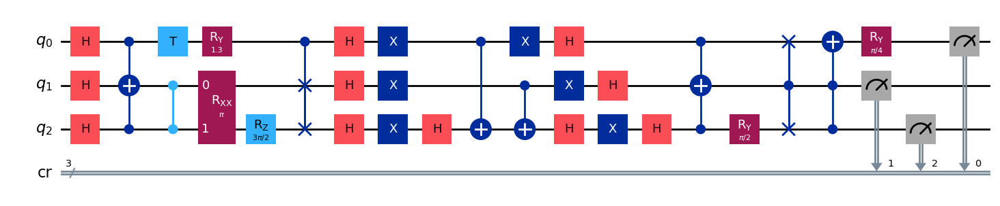

gen = 0 , Best fitness = (0.8553000000000001,)
gen = 1 , Best fitness = (0.8534,) , Number of invalids = 0

[Run 4 | Gen 75/99] Best Fitness: 0.8534 | Fidelity: 0.7783 | Gates: 32


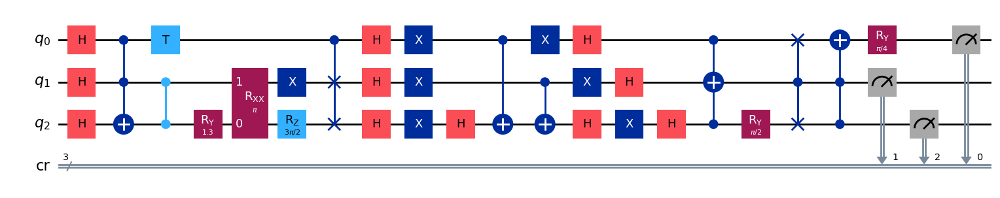

gen = 0 , Best fitness = (0.8534,)
gen = 1 , Best fitness = (0.8534,) , Number of invalids = 0

[Run 4 | Gen 76/99] Best Fitness: 0.8534 | Fidelity: 0.7760 | Gates: 32


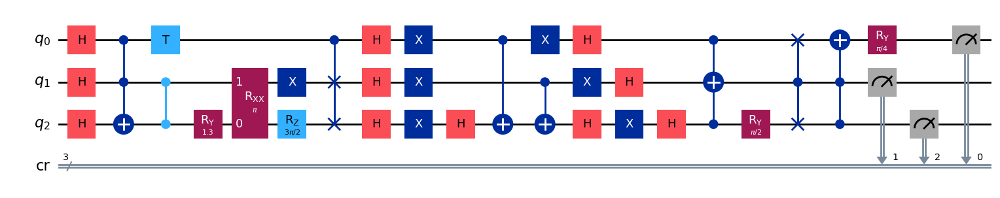

gen = 0 , Best fitness = (0.8534,)
gen = 1 , Best fitness = (0.8488,) , Number of invalids = 0

[Run 4 | Gen 77/99] Best Fitness: 0.8488 | Fidelity: 0.7780 | Gates: 32


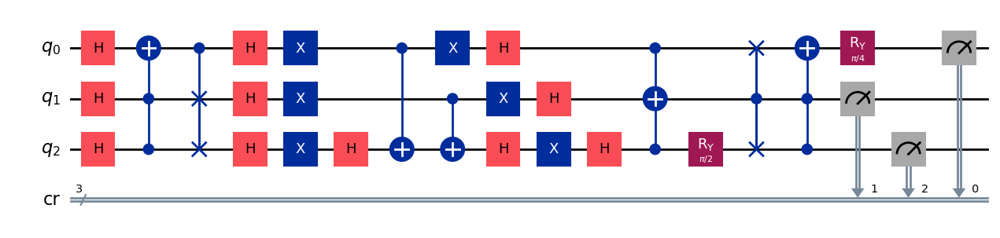

gen = 0 , Best fitness = (0.8488,)
gen = 1 , Best fitness = (0.8476,) , Number of invalids = 0

[Run 4 | Gen 78/99] Best Fitness: 0.8476 | Fidelity: 0.7801 | Gates: 32


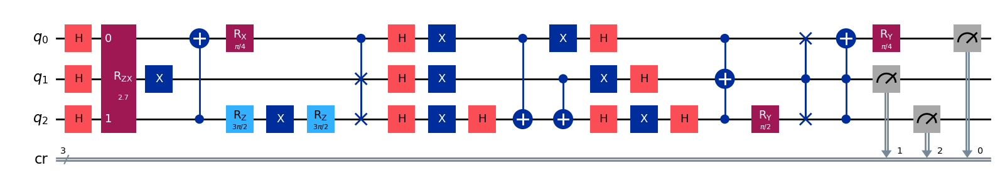

gen = 0 , Best fitness = (0.8476,)
gen = 1 , Best fitness = (0.8476,) , Number of invalids = 0

[Run 4 | Gen 79/99] Best Fitness: 0.8476 | Fidelity: 0.7817 | Gates: 32


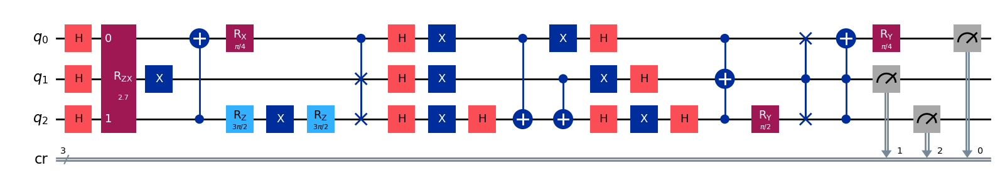

gen = 0 , Best fitness = (0.8476,)
gen = 1 , Best fitness = (0.8476,) , Number of invalids = 0

[Run 4 | Gen 80/99] Best Fitness: 0.8476 | Fidelity: 0.7826 | Gates: 32


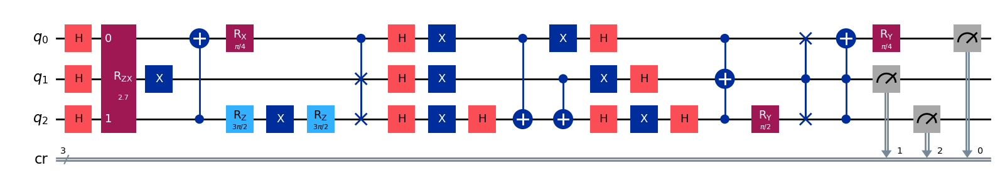

gen = 0 , Best fitness = (0.8476,)
gen = 1 , Best fitness = (0.8297,) , Number of invalids = 0

[Run 4 | Gen 81/99] Best Fitness: 0.8297 | Fidelity: 0.7889 | Gates: 31


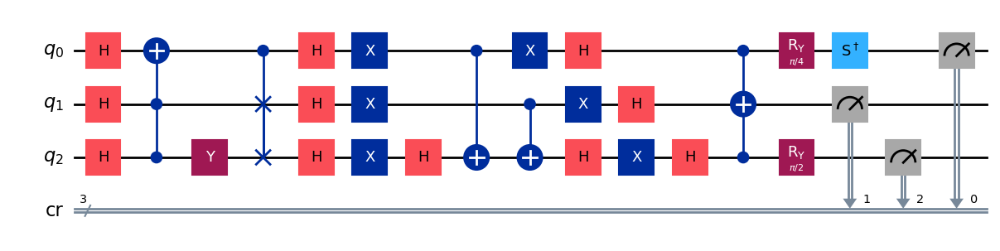

gen = 0 , Best fitness = (0.8297,)
gen = 1 , Best fitness = (0.8297,) , Number of invalids = 0

[Run 4 | Gen 82/99] Best Fitness: 0.8297 | Fidelity: 0.7831 | Gates: 31


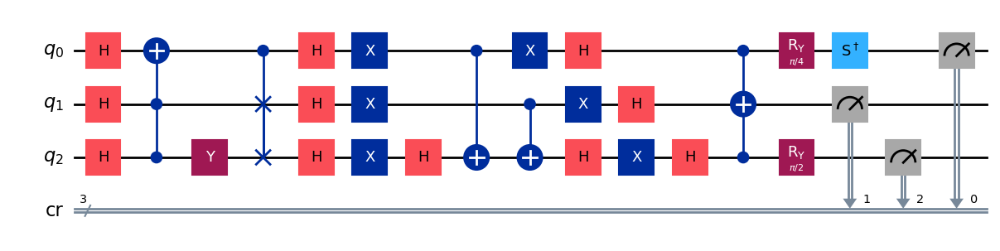

gen = 0 , Best fitness = (0.8297,)
gen = 1 , Best fitness = (0.8297,) , Number of invalids = 0

[Run 4 | Gen 83/99] Best Fitness: 0.8297 | Fidelity: 0.7790 | Gates: 31


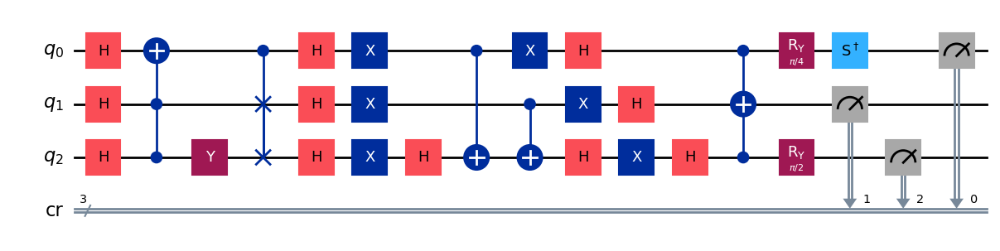

gen = 0 , Best fitness = (0.8297,)
gen = 1 , Best fitness = (0.8297,) , Number of invalids = 0

[Run 4 | Gen 84/99] Best Fitness: 0.8297 | Fidelity: 0.7805 | Gates: 31


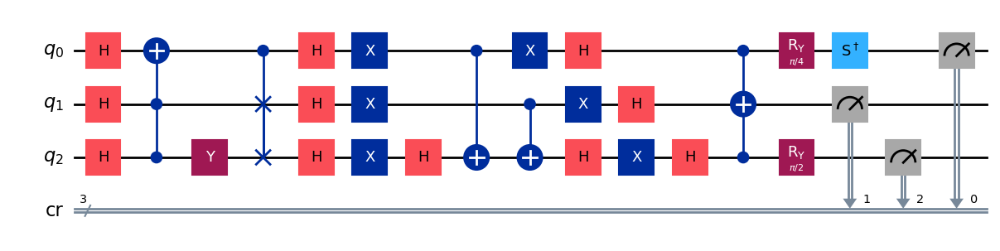

gen = 0 , Best fitness = (0.8297,)
gen = 1 , Best fitness = (0.8297,) , Number of invalids = 0

[Run 4 | Gen 85/99] Best Fitness: 0.8297 | Fidelity: 0.7810 | Gates: 31


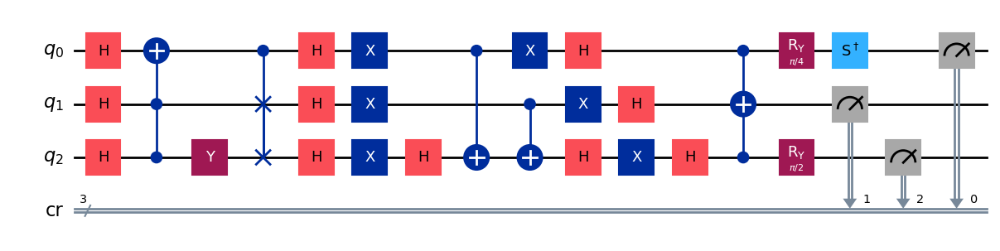

gen = 0 , Best fitness = (0.8297,)
gen = 1 , Best fitness = (0.8297,) , Number of invalids = 0

[Run 4 | Gen 86/99] Best Fitness: 0.8297 | Fidelity: 0.7794 | Gates: 31


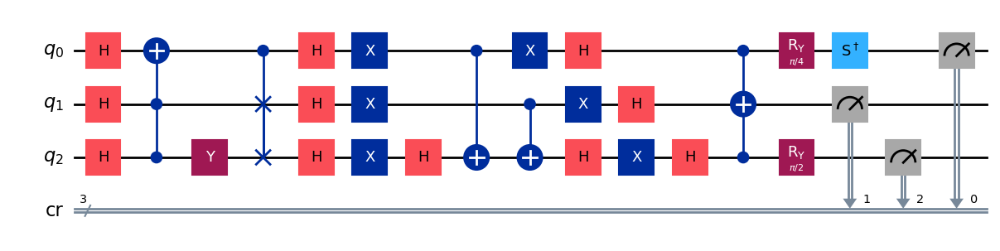

gen = 0 , Best fitness = (0.8297,)
gen = 1 , Best fitness = (0.8268,) , Number of invalids = 0

[Run 4 | Gen 87/99] Best Fitness: 0.8268 | Fidelity: 0.7804 | Gates: 31


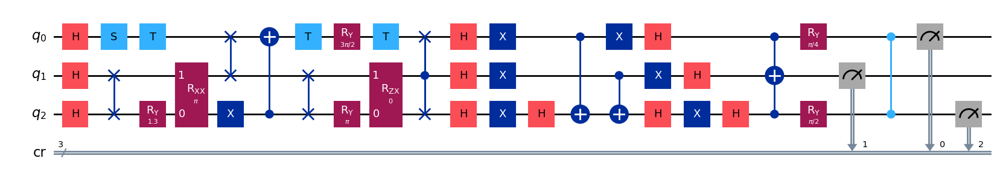

gen = 0 , Best fitness = (0.8268,)
gen = 1 , Best fitness = (0.8183,) , Number of invalids = 0

[Run 4 | Gen 88/99] Best Fitness: 0.8183 | Fidelity: 0.7807 | Gates: 30


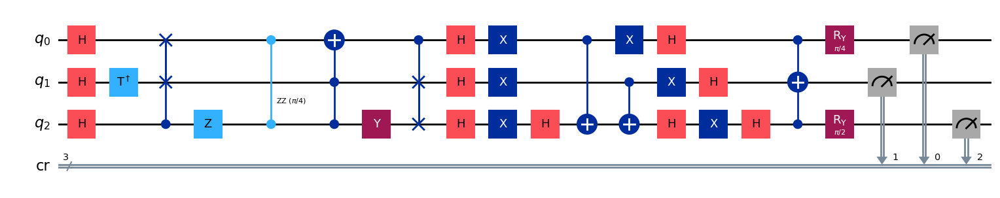

gen = 0 , Best fitness = (0.8183,)
gen = 1 , Best fitness = (0.8153,) , Number of invalids = 0

[Run 4 | Gen 89/99] Best Fitness: 0.8153 | Fidelity: 0.7803 | Gates: 30


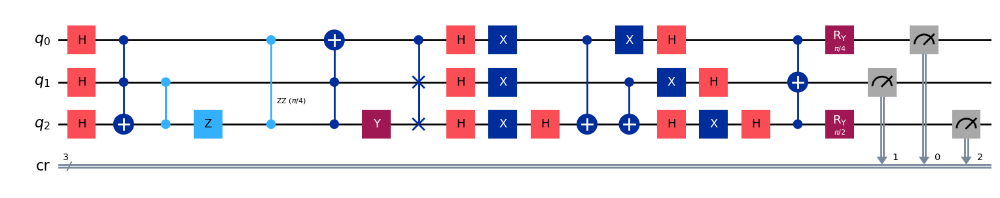

gen = 0 , Best fitness = (0.8153,)
gen = 1 , Best fitness = (0.8153,) , Number of invalids = 0

[Run 4 | Gen 90/99] Best Fitness: 0.8153 | Fidelity: 0.7788 | Gates: 30


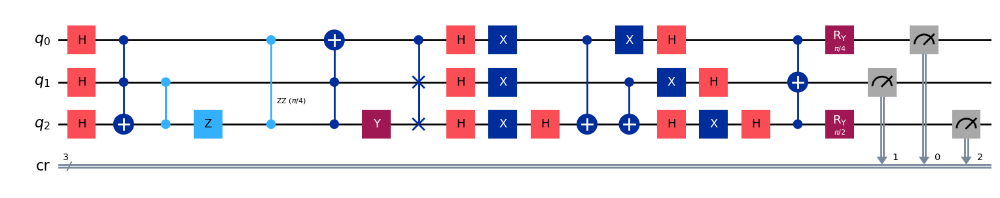

gen = 0 , Best fitness = (0.8153,)
gen = 1 , Best fitness = (0.814,) , Number of invalids = 0

[Run 4 | Gen 91/99] Best Fitness: 0.8140 | Fidelity: 0.7820 | Gates: 30


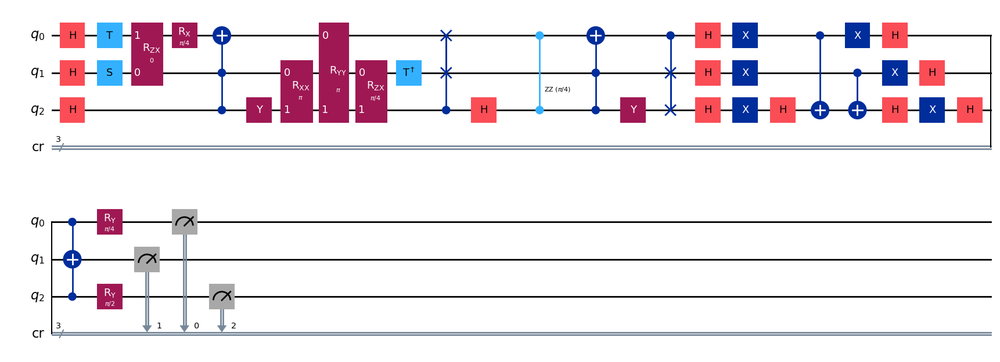

gen = 0 , Best fitness = (0.814,)
gen = 1 , Best fitness = (0.8138,) , Number of invalids = 0

[Run 4 | Gen 92/99] Best Fitness: 0.8138 | Fidelity: 0.7824 | Gates: 30


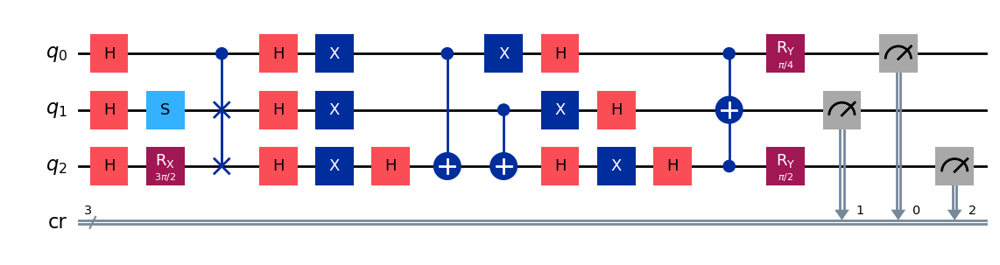

gen = 0 , Best fitness = (0.8138,)
gen = 1 , Best fitness = (0.8092,) , Number of invalids = 0

[Run 4 | Gen 93/99] Best Fitness: 0.8092 | Fidelity: 0.8145 | Gates: 31


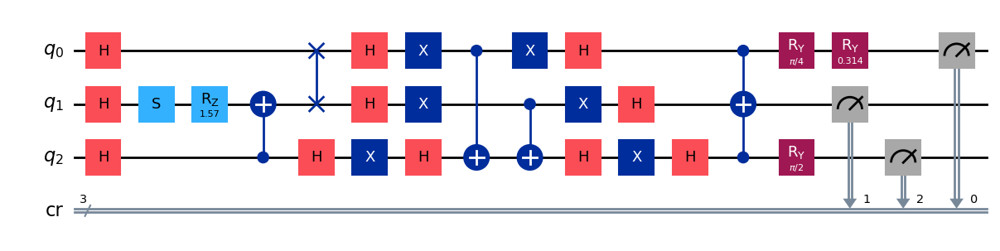

gen = 0 , Best fitness = (0.8092,)
gen = 1 , Best fitness = (0.8092,) , Number of invalids = 0

[Run 4 | Gen 94/99] Best Fitness: 0.8092 | Fidelity: 0.8115 | Gates: 31


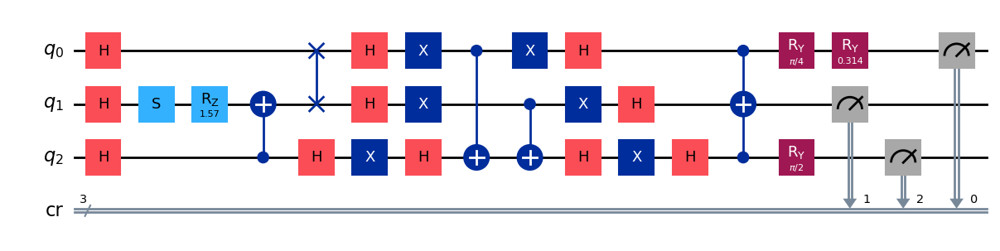

gen = 0 , Best fitness = (0.8092,)
gen = 1 , Best fitness = (0.8081,) , Number of invalids = 0

[Run 4 | Gen 95/99] Best Fitness: 0.8081 | Fidelity: 0.8257 | Gates: 32


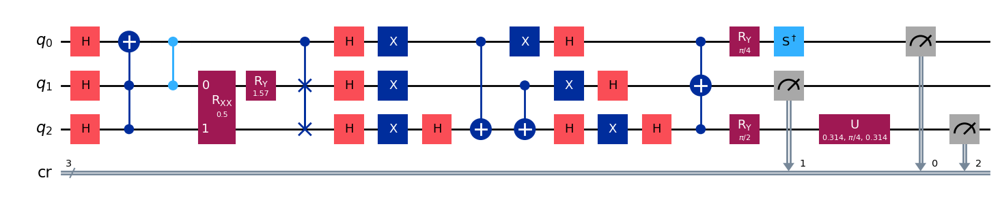

gen = 0 , Best fitness = (0.8081,)
gen = 1 , Best fitness = (0.8081,) , Number of invalids = 0

[Run 4 | Gen 96/99] Best Fitness: 0.8081 | Fidelity: 0.8260 | Gates: 32


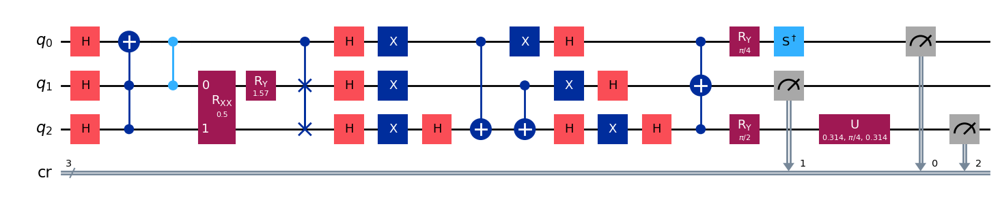

gen = 0 , Best fitness = (0.8081,)
gen = 1 , Best fitness = (0.8038,) , Number of invalids = 0

[Run 4 | Gen 97/99] Best Fitness: 0.8038 | Fidelity: 0.8104 | Gates: 31


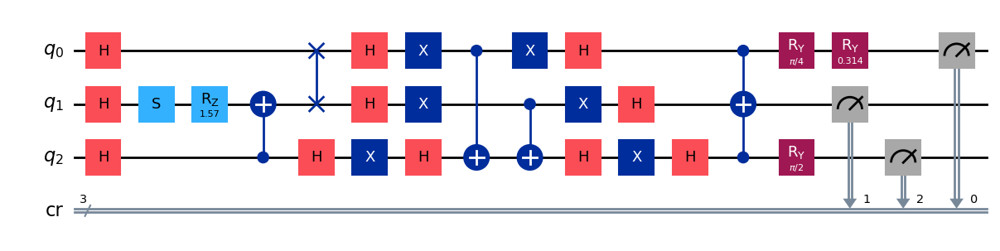

gen = 0 , Best fitness = (0.8038,)
gen = 1 , Best fitness = (0.8038,) , Number of invalids = 0

[Run 4 | Gen 98/99] Best Fitness: 0.8038 | Fidelity: 0.8131 | Gates: 31


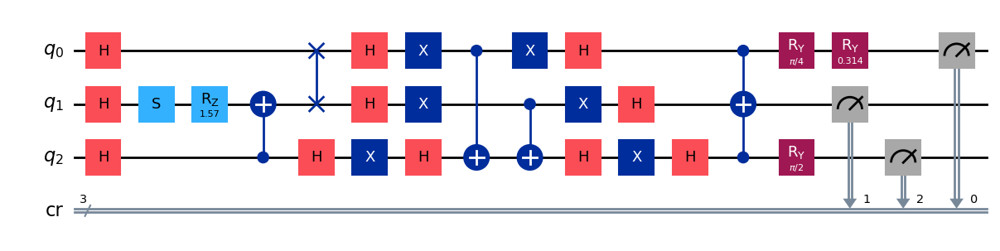

gen = 0 , Best fitness = (0.8038,)
gen = 1 , Best fitness = (0.7964,) , Number of invalids = 0

[Run 4 | Gen 99/99] Best Fitness: 0.7964 | Fidelity: 0.8250 | Gates: 31


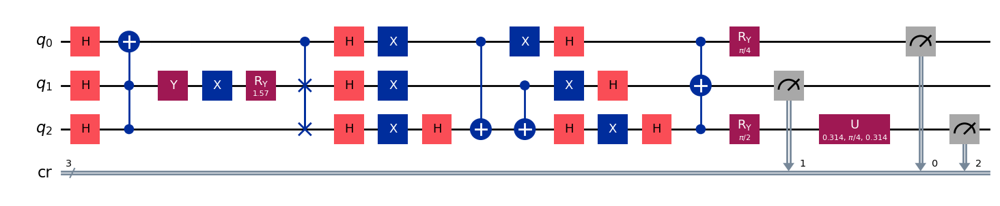


Generating evolution plots for Run 4...
✓ Plot saved to: experiments_state_101/run_4_seed_60899/evolution_metrics_run_4.png


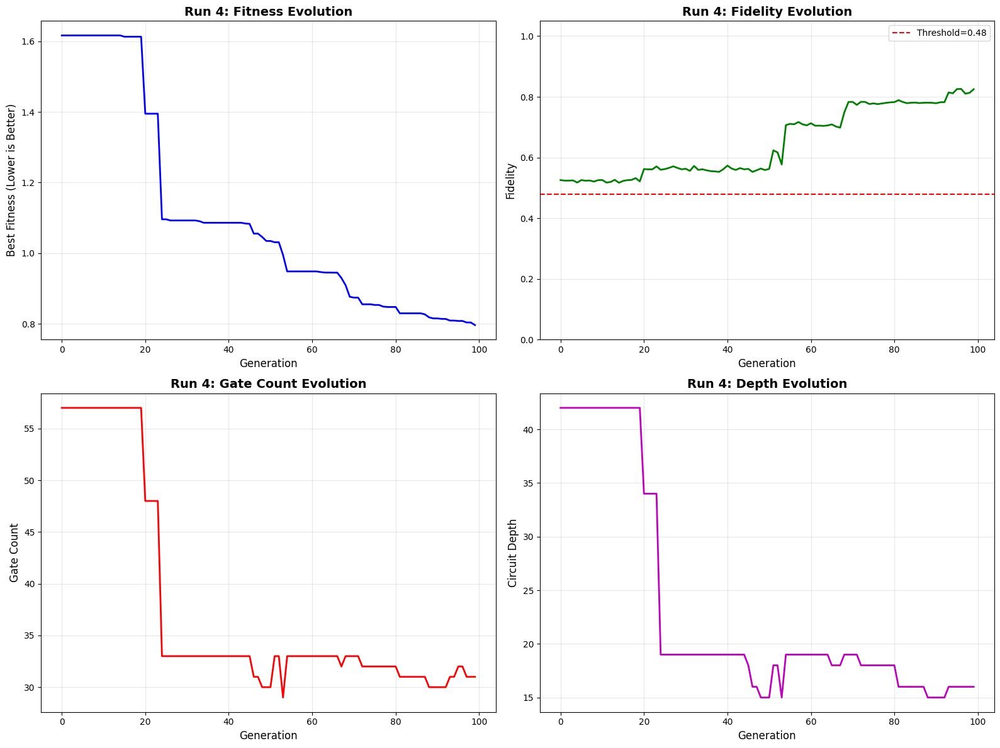


✓ Run 4 COMPLETE | Fidelity: 0.8188 | Gates: 31 | Depth: 16


RUN 5/5 | Target: 101 | Seed: 37187
✓ Logging to: experiments_state_101/run_5_seed_37187
✓ Starting evolution (Population: 1000, Generations: 100)
gen = 0 , Best fitness = (1.3620999999999999,)
gen = 1 , Best fitness = (1.3620999999999999,) , Number of invalids = 160

[Run 5 | Gen 0/99] Best Fitness: 1.3621 | Fidelity: 0.8056 | Gates: 58


/Users/admin/Downloads/GE_Grover/.venv/lib/python3.10/site-packages/numpy/_core/_methods.py:191: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


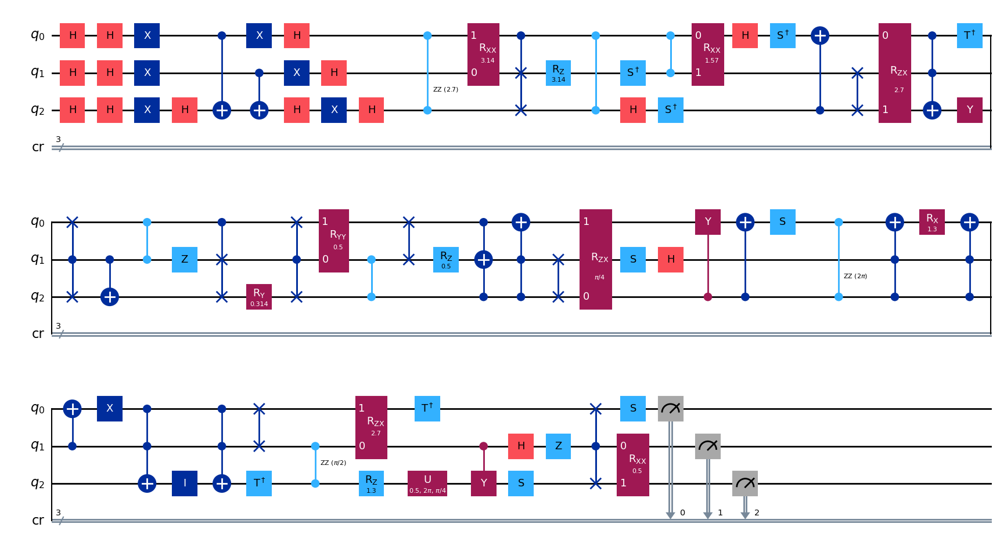

gen = 0 , Best fitness = (1.3620999999999999,)
gen = 1 , Best fitness = (1.3180999999999998,) , Number of invalids = 78

[Run 5 | Gen 1/99] Best Fitness: 1.3181 | Fidelity: 0.8472 | Gates: 58


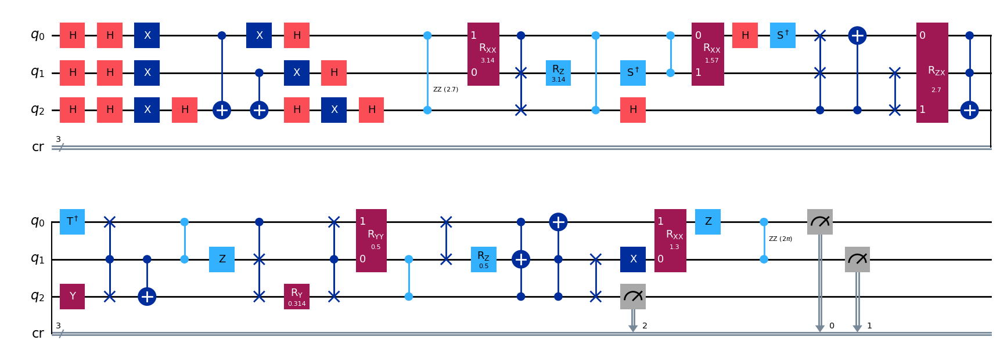

gen = 0 , Best fitness = (1.3180999999999998,)
gen = 1 , Best fitness = (1.3153,) , Number of invalids = 92

[Run 5 | Gen 2/99] Best Fitness: 1.3153 | Fidelity: 0.8396 | Gates: 58


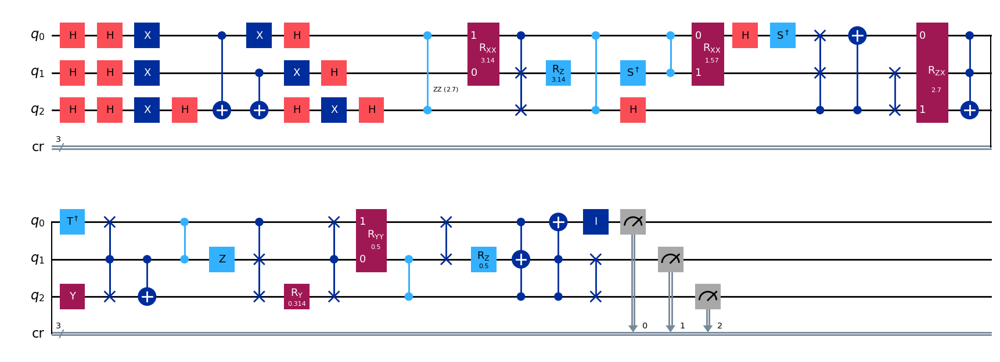

gen = 0 , Best fitness = (1.3153,)
gen = 1 , Best fitness = (1.2832999999999999,) , Number of invalids = 69

[Run 5 | Gen 3/99] Best Fitness: 1.2833 | Fidelity: 0.8743 | Gates: 58


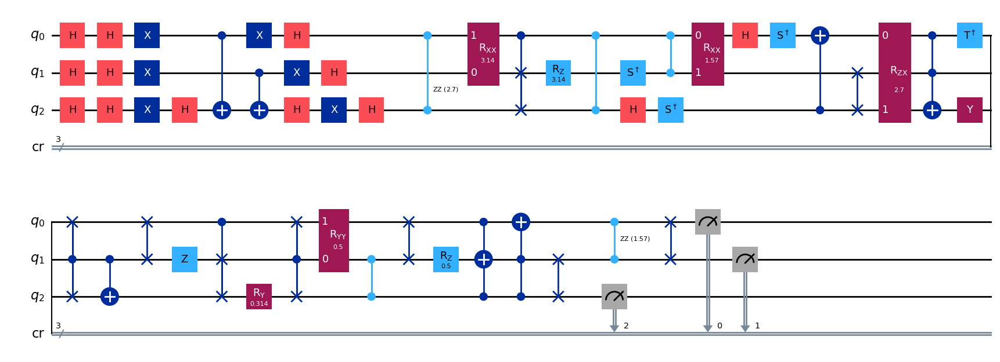

gen = 0 , Best fitness = (1.2832999999999999,)
gen = 1 , Best fitness = (1.2571999999999999,) , Number of invalids = 59

[Run 5 | Gen 4/99] Best Fitness: 1.2572 | Fidelity: 0.9023 | Gates: 58


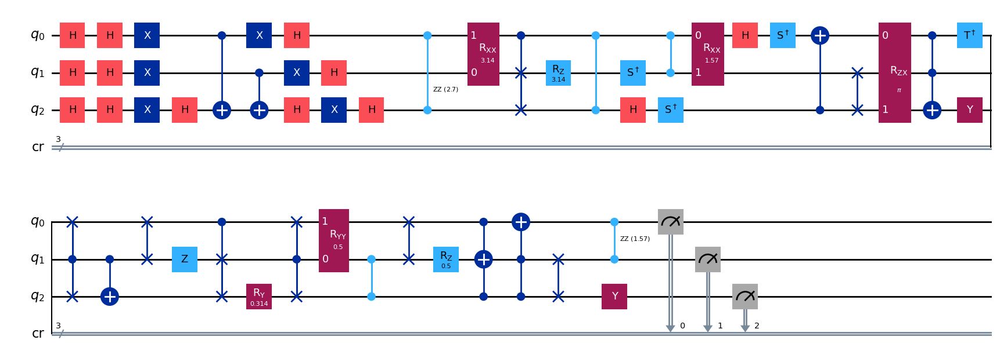

gen = 0 , Best fitness = (1.2571999999999999,)
gen = 1 , Best fitness = (1.2571999999999999,) , Number of invalids = 43

[Run 5 | Gen 5/99] Best Fitness: 1.2572 | Fidelity: 0.9021 | Gates: 58


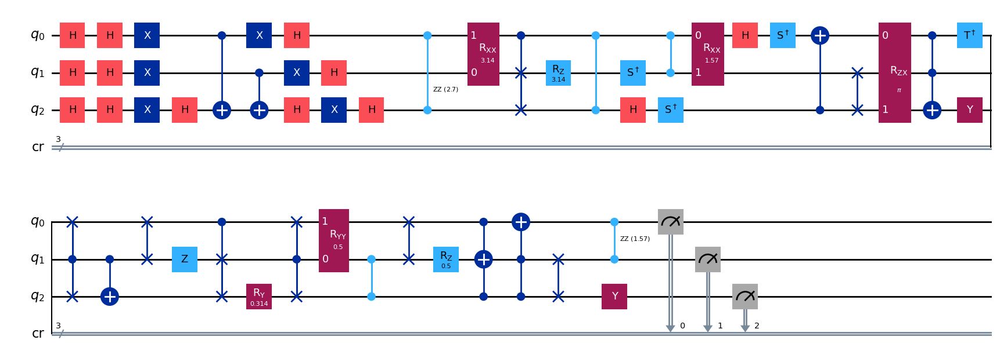

gen = 0 , Best fitness = (1.2571999999999999,)
gen = 1 , Best fitness = (0.9094,) , Number of invalids = 35

[Run 5 | Gen 6/99] Best Fitness: 0.9094 | Fidelity: 0.9509 | Gates: 43


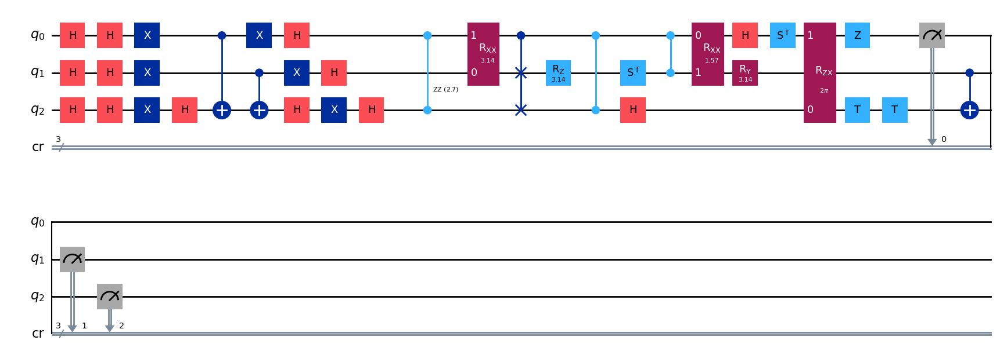

gen = 0 , Best fitness = (0.9094,)
gen = 1 , Best fitness = (0.9094,) , Number of invalids = 30

[Run 5 | Gen 7/99] Best Fitness: 0.9094 | Fidelity: 0.9522 | Gates: 43


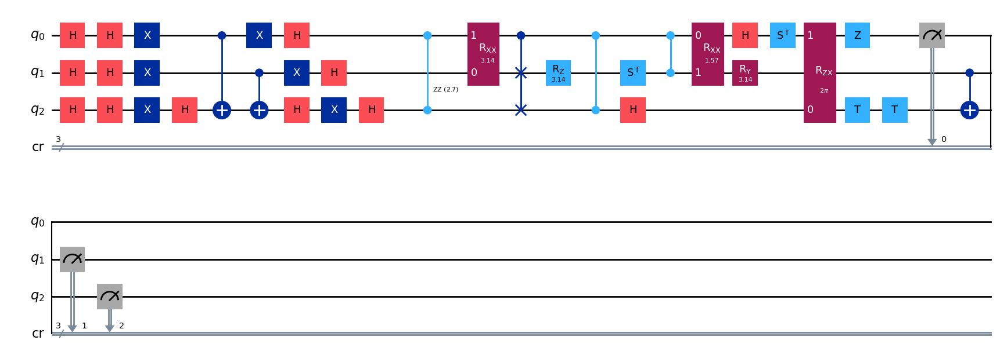

gen = 0 , Best fitness = (0.9094,)
gen = 1 , Best fitness = (0.9041,) , Number of invalids = 33

[Run 5 | Gen 8/99] Best Fitness: 0.9041 | Fidelity: 0.9547 | Gates: 43


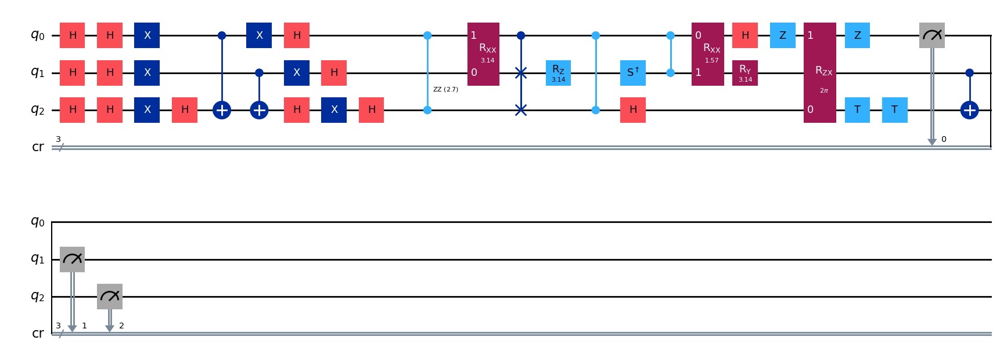

gen = 0 , Best fitness = (0.9041,)
gen = 1 , Best fitness = (0.9041,) , Number of invalids = 47

[Run 5 | Gen 9/99] Best Fitness: 0.9041 | Fidelity: 0.9522 | Gates: 43


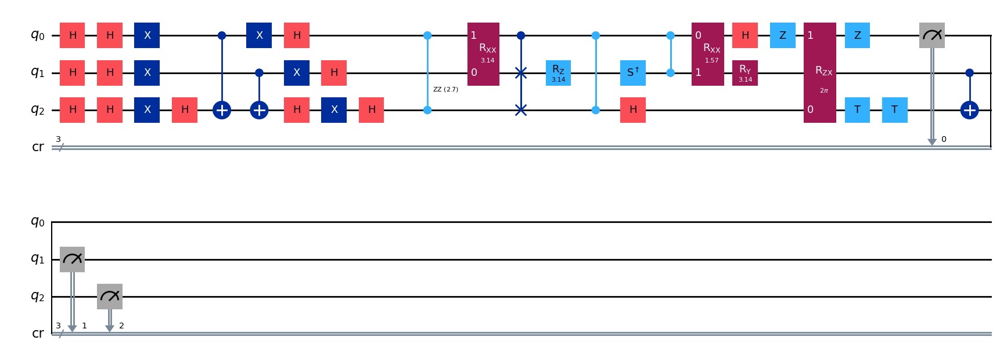

gen = 0 , Best fitness = (0.9041,)
gen = 1 , Best fitness = (0.9041,) , Number of invalids = 26

[Run 5 | Gen 10/99] Best Fitness: 0.9041 | Fidelity: 0.9553 | Gates: 43


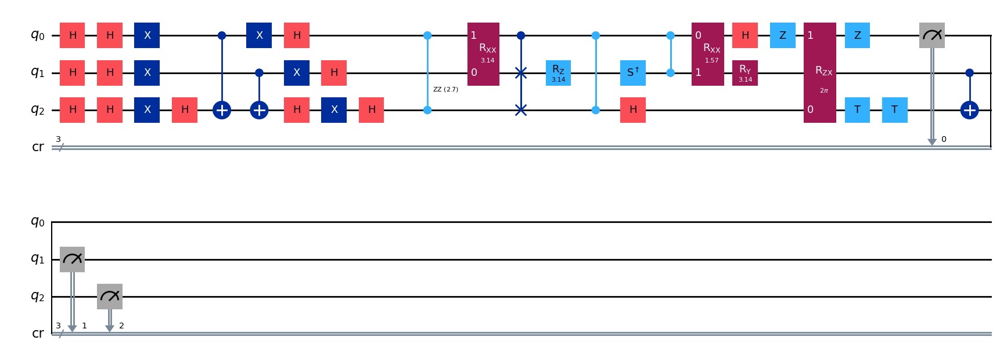

gen = 0 , Best fitness = (0.9041,)
gen = 1 , Best fitness = (0.8867999999999999,) , Number of invalids = 20

[Run 5 | Gen 11/99] Best Fitness: 0.8868 | Fidelity: 0.9511 | Gates: 42


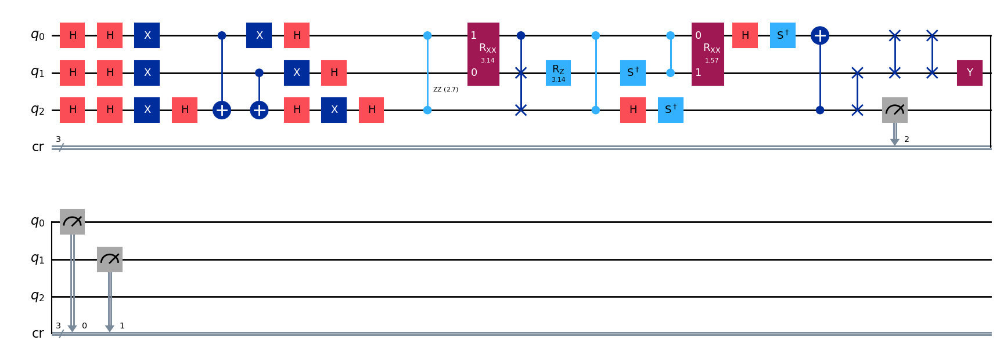

gen = 0 , Best fitness = (0.8867999999999999,)
gen = 1 , Best fitness = (0.8867999999999999,) , Number of invalids = 19

[Run 5 | Gen 12/99] Best Fitness: 0.8868 | Fidelity: 0.9536 | Gates: 42


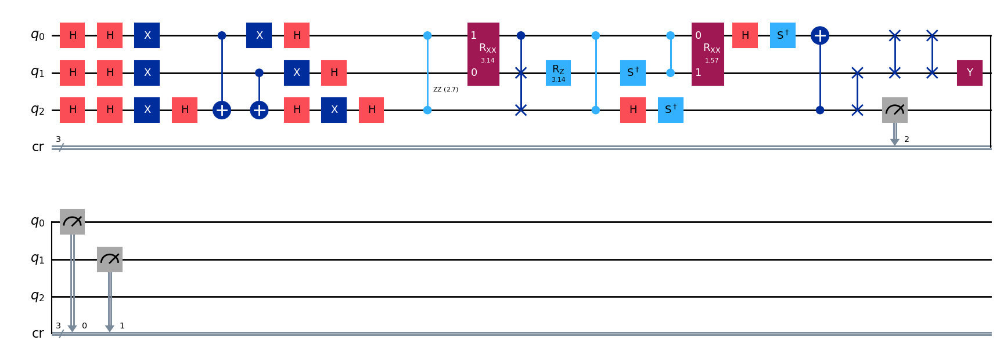

gen = 0 , Best fitness = (0.8867999999999999,)
gen = 1 , Best fitness = (0.8854,) , Number of invalids = 36

[Run 5 | Gen 13/99] Best Fitness: 0.8854 | Fidelity: 0.9529 | Gates: 42


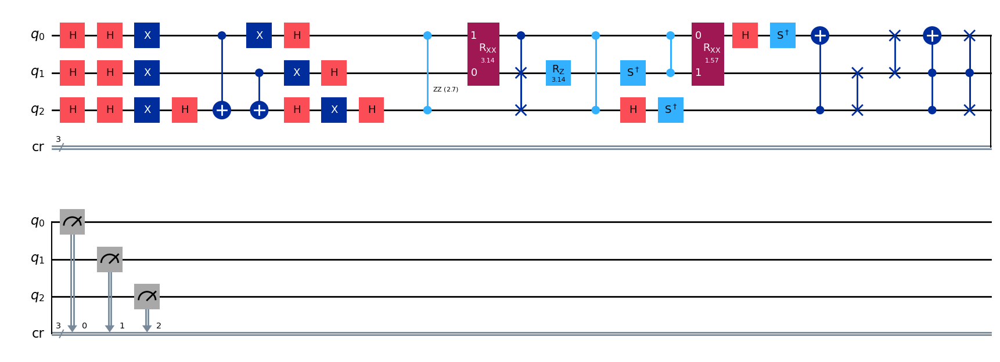

gen = 0 , Best fitness = (0.8854,)
gen = 1 , Best fitness = (0.8837999999999999,) , Number of invalids = 30

[Run 5 | Gen 14/99] Best Fitness: 0.8838 | Fidelity: 0.9558 | Gates: 42


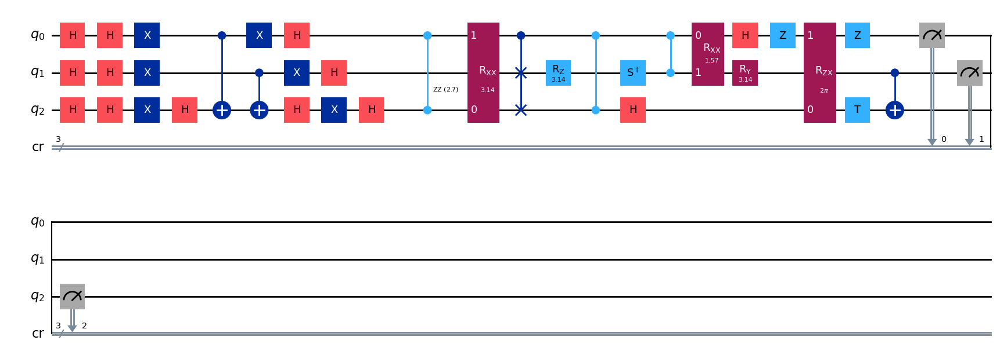

gen = 0 , Best fitness = (0.8837999999999999,)
gen = 1 , Best fitness = (0.8837999999999999,) , Number of invalids = 36

[Run 5 | Gen 15/99] Best Fitness: 0.8838 | Fidelity: 0.9467 | Gates: 42


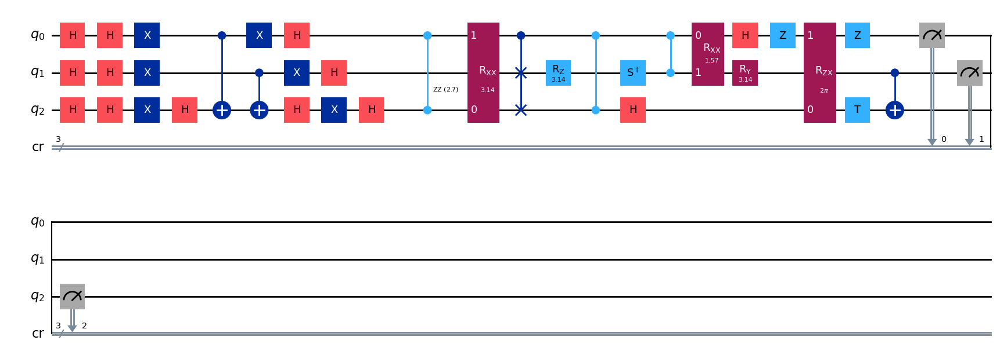

gen = 0 , Best fitness = (0.8837999999999999,)
gen = 1 , Best fitness = (0.8837999999999999,) , Number of invalids = 23

[Run 5 | Gen 16/99] Best Fitness: 0.8838 | Fidelity: 0.9536 | Gates: 42


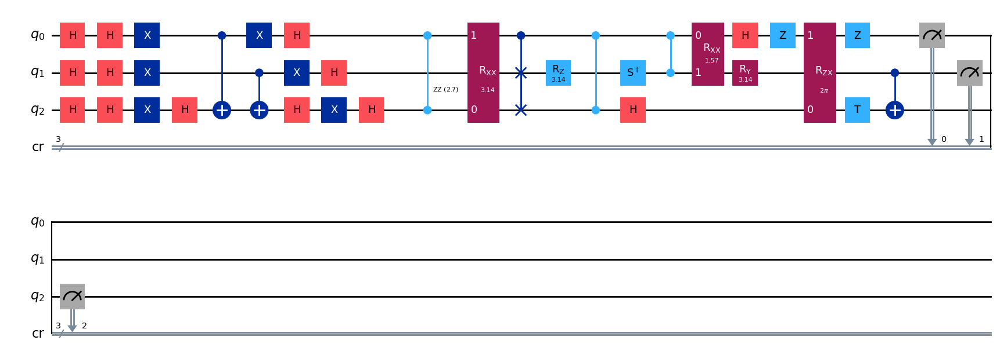

gen = 0 , Best fitness = (0.8837999999999999,)
gen = 1 , Best fitness = (0.8837999999999999,) , Number of invalids = 16

[Run 5 | Gen 17/99] Best Fitness: 0.8838 | Fidelity: 0.9534 | Gates: 42


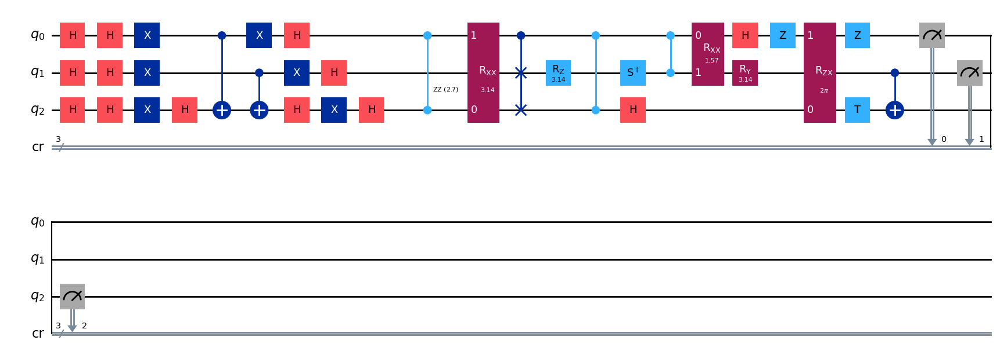

gen = 0 , Best fitness = (0.8837999999999999,)
gen = 1 , Best fitness = (0.8837999999999999,) , Number of invalids = 13

[Run 5 | Gen 18/99] Best Fitness: 0.8838 | Fidelity: 0.9542 | Gates: 42


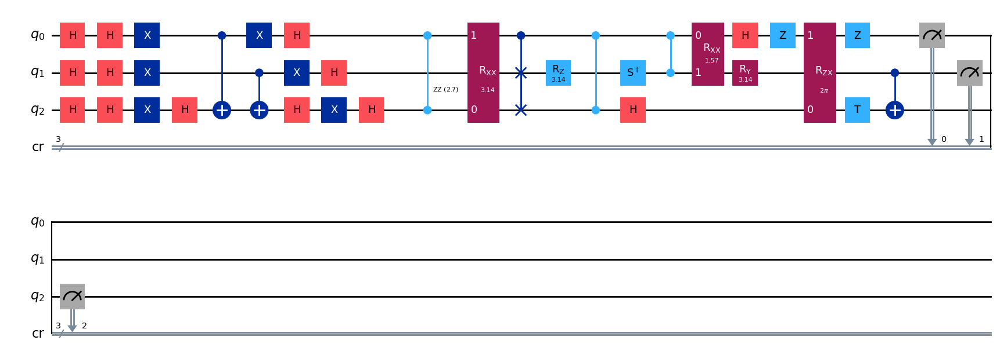

gen = 0 , Best fitness = (0.8837999999999999,)
gen = 1 , Best fitness = (0.8837999999999999,) , Number of invalids = 13

[Run 5 | Gen 19/99] Best Fitness: 0.8838 | Fidelity: 0.9518 | Gates: 42


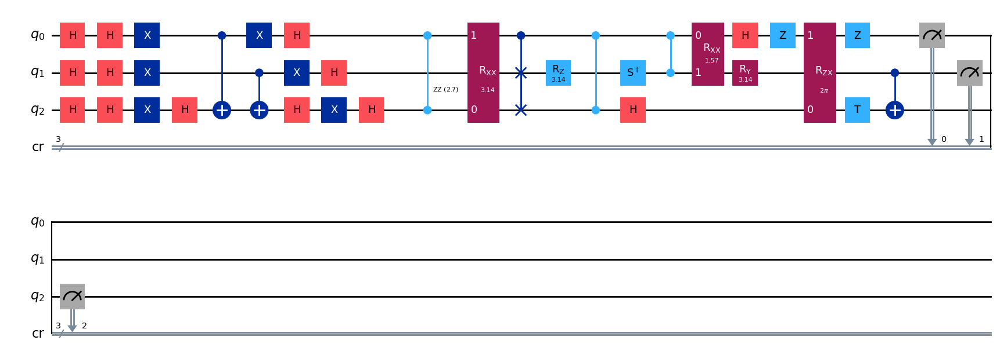

gen = 0 , Best fitness = (0.8837999999999999,)
gen = 1 , Best fitness = (0.7863,) , Number of invalids = 15

[Run 5 | Gen 20/99] Best Fitness: 0.7863 | Fidelity: 0.9502 | Gates: 37


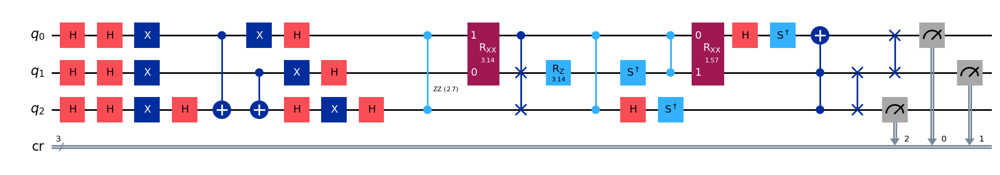

gen = 0 , Best fitness = (0.7863,)
gen = 1 , Best fitness = (0.7863,) , Number of invalids = 9

[Run 5 | Gen 21/99] Best Fitness: 0.7863 | Fidelity: 0.9553 | Gates: 37


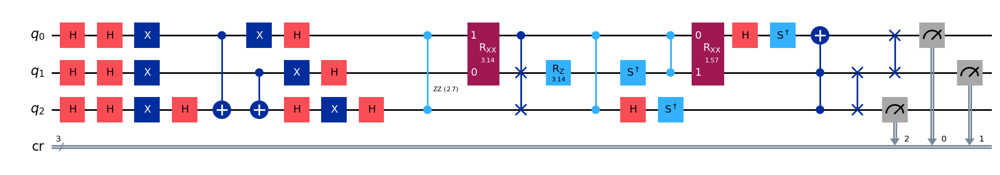

gen = 0 , Best fitness = (0.7863,)
gen = 1 , Best fitness = (0.7671,) , Number of invalids = 9

[Run 5 | Gen 22/99] Best Fitness: 0.7671 | Fidelity: 0.9531 | Gates: 36


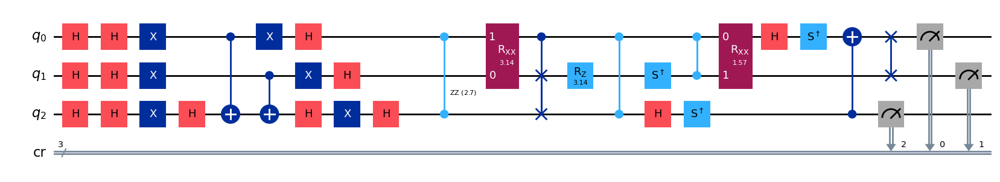

gen = 0 , Best fitness = (0.7671,)
gen = 1 , Best fitness = (0.7671,) , Number of invalids = 18

[Run 5 | Gen 23/99] Best Fitness: 0.7671 | Fidelity: 0.9474 | Gates: 36


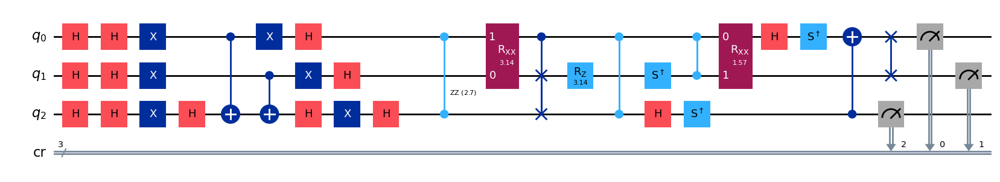

gen = 0 , Best fitness = (0.7671,)
gen = 1 , Best fitness = (0.7671,) , Number of invalids = 14

[Run 5 | Gen 24/99] Best Fitness: 0.7671 | Fidelity: 0.9507 | Gates: 36


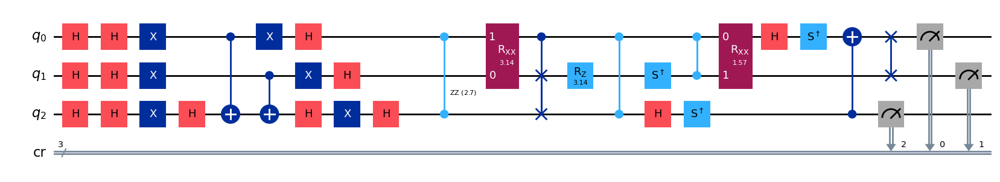

gen = 0 , Best fitness = (0.7671,)
gen = 1 , Best fitness = (0.7671,) , Number of invalids = 18

[Run 5 | Gen 25/99] Best Fitness: 0.7671 | Fidelity: 0.9543 | Gates: 36


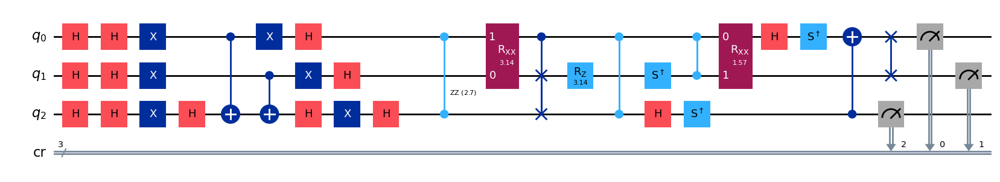

gen = 0 , Best fitness = (0.7671,)
gen = 1 , Best fitness = (0.7659,) , Number of invalids = 14

[Run 5 | Gen 26/99] Best Fitness: 0.7659 | Fidelity: 0.9528 | Gates: 36


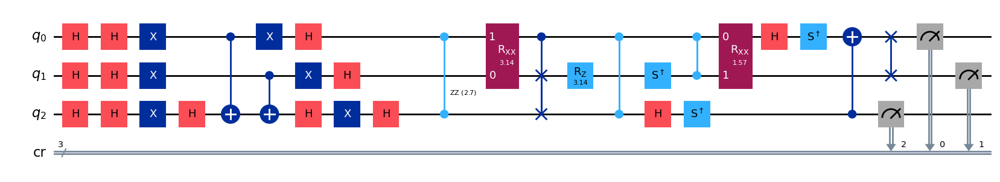

gen = 0 , Best fitness = (0.7659,)
gen = 1 , Best fitness = (0.7659,) , Number of invalids = 6

[Run 5 | Gen 27/99] Best Fitness: 0.7659 | Fidelity: 0.9508 | Gates: 36


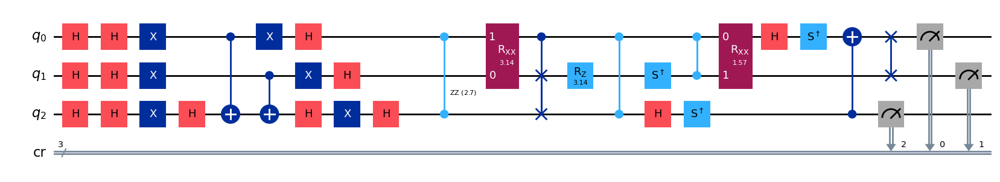

gen = 0 , Best fitness = (0.7659,)
gen = 1 , Best fitness = (0.5367000000000001,) , Number of invalids = 15

[Run 5 | Gen 28/99] Best Fitness: 0.5367 | Fidelity: 0.9828 | Gates: 26


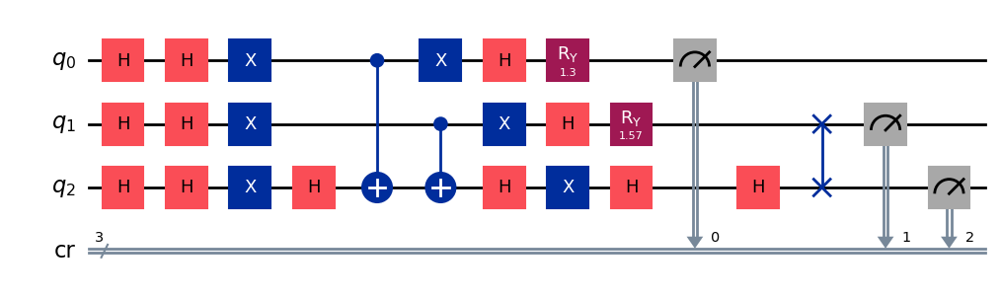

gen = 0 , Best fitness = (0.5367000000000001,)
gen = 1 , Best fitness = (0.5357000000000001,) , Number of invalids = 17

[Run 5 | Gen 29/99] Best Fitness: 0.5357 | Fidelity: 0.9828 | Gates: 26


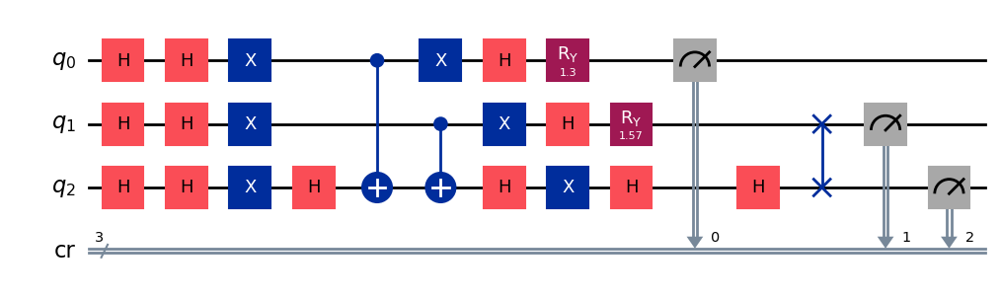

gen = 0 , Best fitness = (0.5357000000000001,)
gen = 1 , Best fitness = (0.5357000000000001,) , Number of invalids = 11

[Run 5 | Gen 30/99] Best Fitness: 0.5357 | Fidelity: 0.9827 | Gates: 26


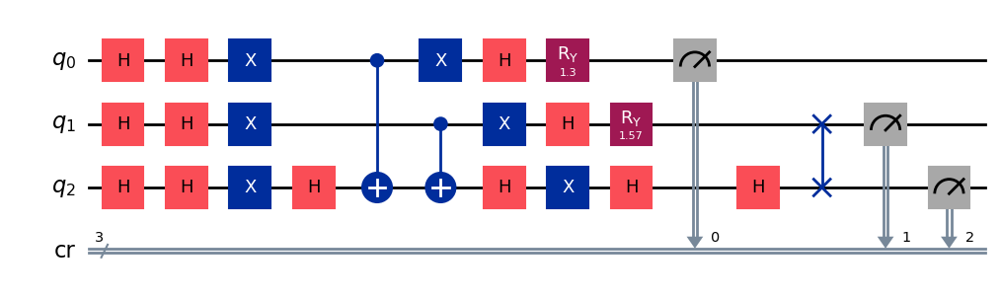

gen = 0 , Best fitness = (0.5357000000000001,)
gen = 1 , Best fitness = (0.5357000000000001,) , Number of invalids = 9

[Run 5 | Gen 31/99] Best Fitness: 0.5357 | Fidelity: 0.9796 | Gates: 26


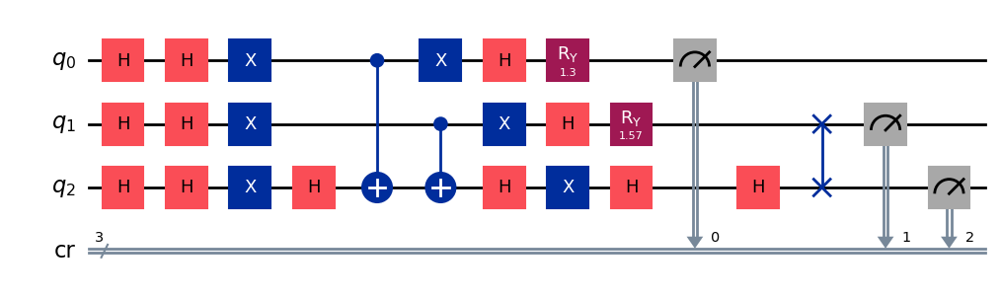

gen = 0 , Best fitness = (0.5357000000000001,)
gen = 1 , Best fitness = (0.5357000000000001,) , Number of invalids = 4

[Run 5 | Gen 32/99] Best Fitness: 0.5357 | Fidelity: 0.9801 | Gates: 26


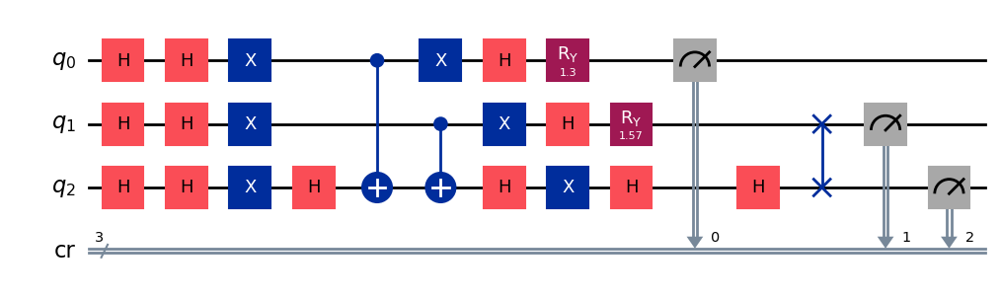

gen = 0 , Best fitness = (0.5357000000000001,)
gen = 1 , Best fitness = (0.5355,) , Number of invalids = 5

[Run 5 | Gen 33/99] Best Fitness: 0.5355 | Fidelity: 0.9809 | Gates: 26


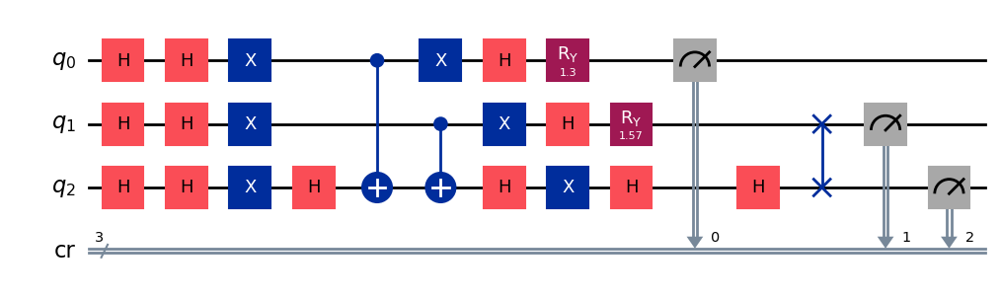

gen = 0 , Best fitness = (0.5355,)
gen = 1 , Best fitness = (0.5355,) , Number of invalids = 3

[Run 5 | Gen 34/99] Best Fitness: 0.5355 | Fidelity: 0.9820 | Gates: 26


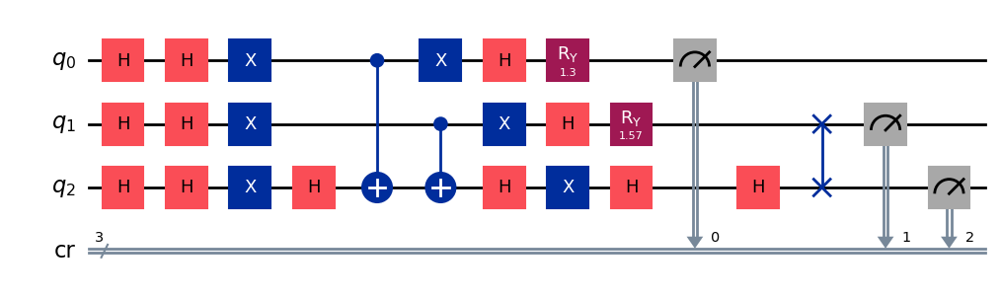

gen = 0 , Best fitness = (0.5355,)
gen = 1 , Best fitness = (0.5355,) , Number of invalids = 1

[Run 5 | Gen 35/99] Best Fitness: 0.5355 | Fidelity: 0.9808 | Gates: 26


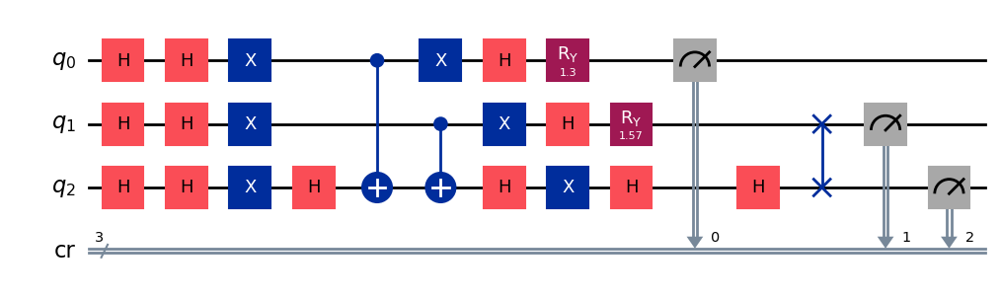

gen = 0 , Best fitness = (0.5355,)
gen = 1 , Best fitness = (0.5355,) , Number of invalids = 2

[Run 5 | Gen 36/99] Best Fitness: 0.5355 | Fidelity: 0.9810 | Gates: 26


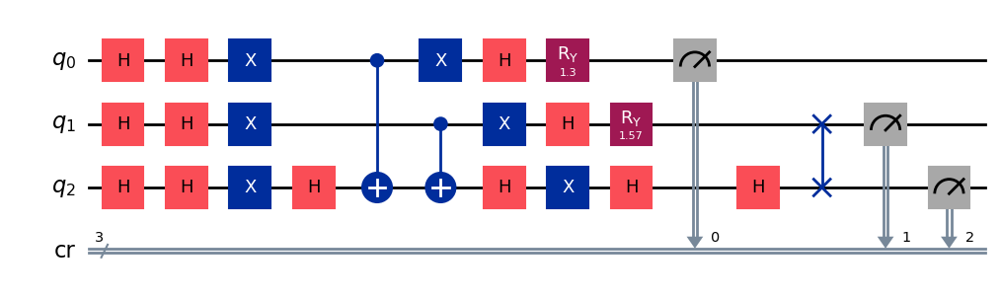

gen = 0 , Best fitness = (0.5355,)
gen = 1 , Best fitness = (0.5355,) , Number of invalids = 1

[Run 5 | Gen 37/99] Best Fitness: 0.5355 | Fidelity: 0.9844 | Gates: 26


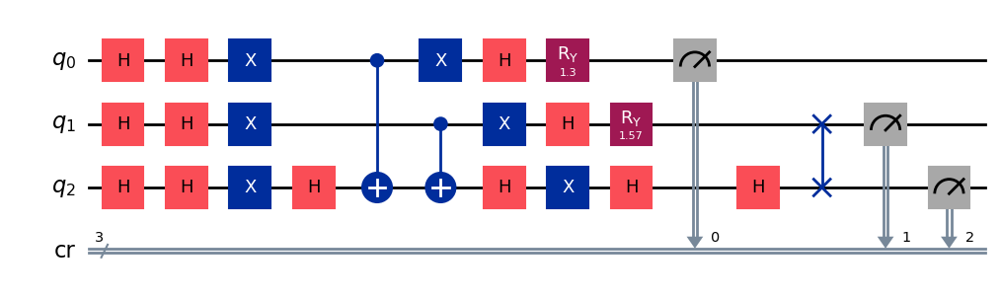

gen = 0 , Best fitness = (0.5355,)
gen = 1 , Best fitness = (0.5355,) , Number of invalids = 2

[Run 5 | Gen 38/99] Best Fitness: 0.5355 | Fidelity: 0.9806 | Gates: 26


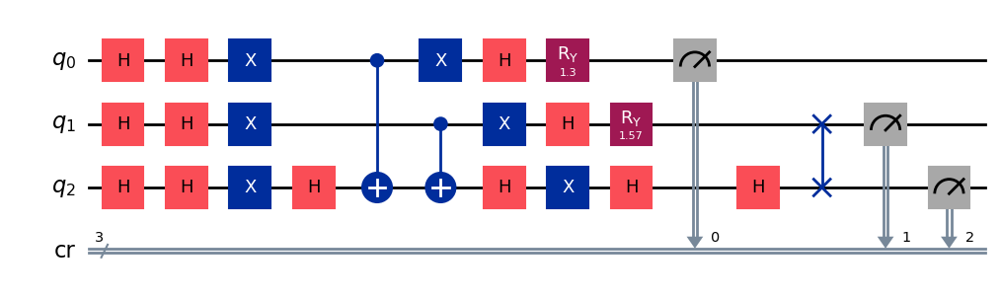

gen = 0 , Best fitness = (0.5355,)
gen = 1 , Best fitness = (0.5355,) , Number of invalids = 0

[Run 5 | Gen 39/99] Best Fitness: 0.5355 | Fidelity: 0.9810 | Gates: 26


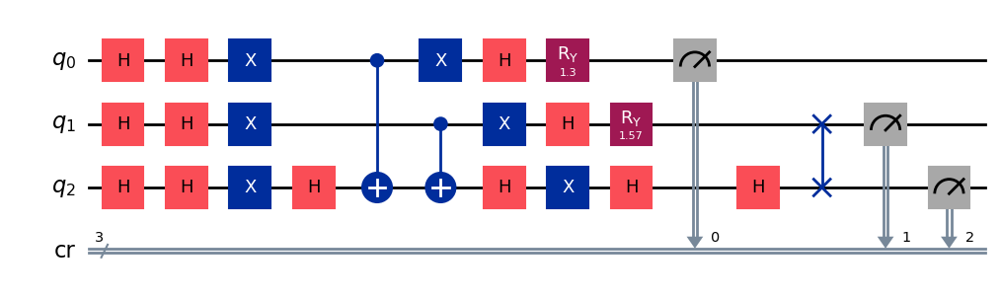

gen = 0 , Best fitness = (0.5355,)
gen = 1 , Best fitness = (0.5355,) , Number of invalids = 0

[Run 5 | Gen 40/99] Best Fitness: 0.5355 | Fidelity: 0.9819 | Gates: 26


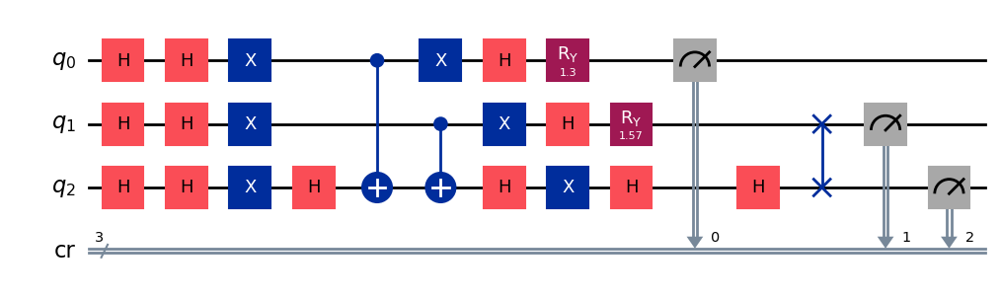

gen = 0 , Best fitness = (0.5355,)
gen = 1 , Best fitness = (0.5355,) , Number of invalids = 1

[Run 5 | Gen 41/99] Best Fitness: 0.5355 | Fidelity: 0.9831 | Gates: 26


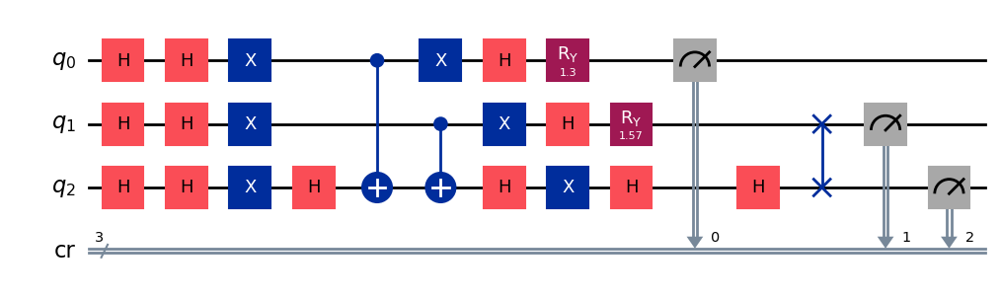

gen = 0 , Best fitness = (0.5355,)
gen = 1 , Best fitness = (0.5355,) , Number of invalids = 0

[Run 5 | Gen 42/99] Best Fitness: 0.5355 | Fidelity: 0.9813 | Gates: 26


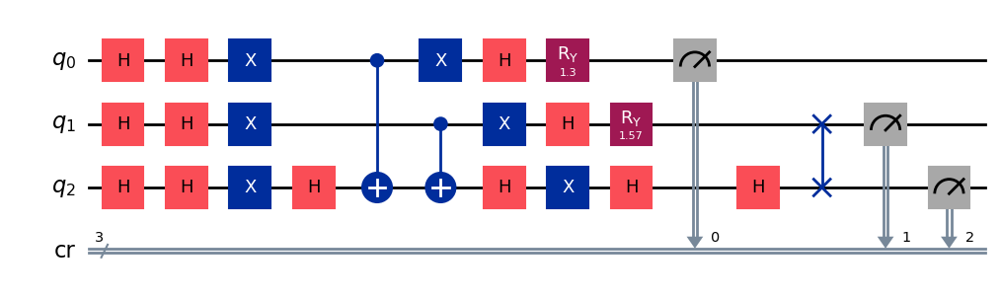

gen = 0 , Best fitness = (0.5355,)
gen = 1 , Best fitness = (0.5351,) , Number of invalids = 0

[Run 5 | Gen 43/99] Best Fitness: 0.5351 | Fidelity: 0.9812 | Gates: 26


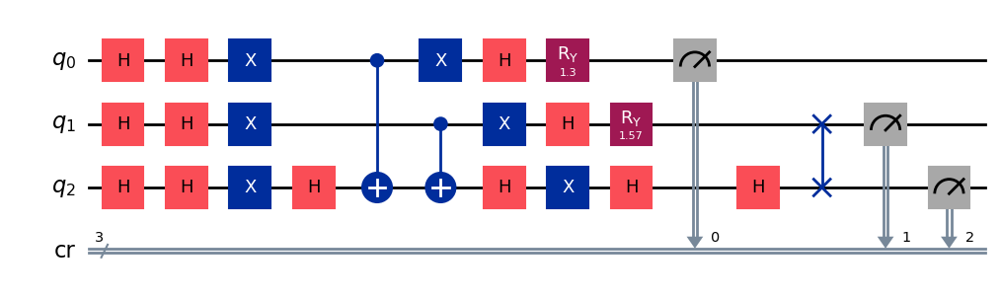

gen = 0 , Best fitness = (0.5351,)
gen = 1 , Best fitness = (0.5351,) , Number of invalids = 0

[Run 5 | Gen 44/99] Best Fitness: 0.5351 | Fidelity: 0.9819 | Gates: 26


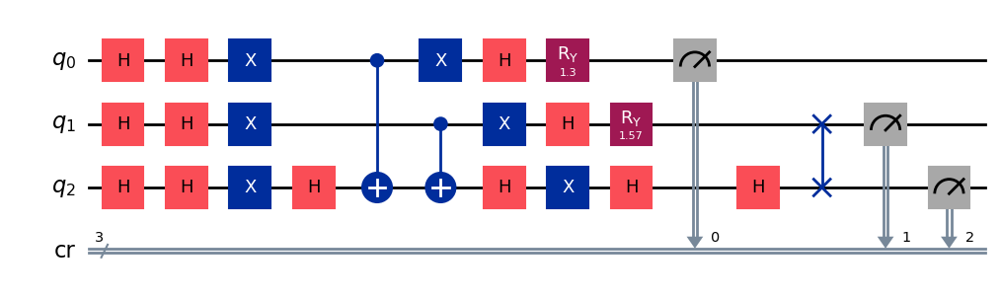

gen = 0 , Best fitness = (0.5351,)
gen = 1 , Best fitness = (0.5351,) , Number of invalids = 0

[Run 5 | Gen 45/99] Best Fitness: 0.5351 | Fidelity: 0.9808 | Gates: 26


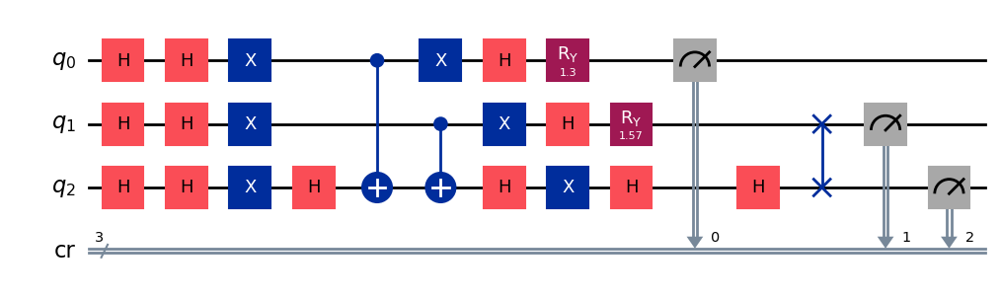

gen = 0 , Best fitness = (0.5351,)
gen = 1 , Best fitness = (0.5351,) , Number of invalids = 0

[Run 5 | Gen 46/99] Best Fitness: 0.5351 | Fidelity: 0.9802 | Gates: 26


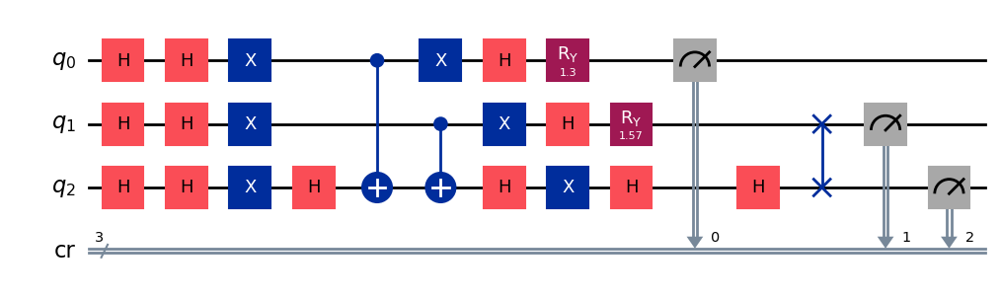

gen = 0 , Best fitness = (0.5351,)
gen = 1 , Best fitness = (0.5351,) , Number of invalids = 0

[Run 5 | Gen 47/99] Best Fitness: 0.5351 | Fidelity: 0.9798 | Gates: 26


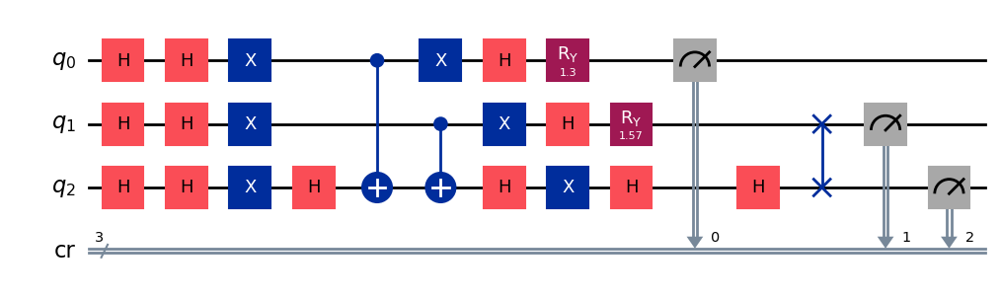

gen = 0 , Best fitness = (0.5351,)
gen = 1 , Best fitness = (0.5351,) , Number of invalids = 0

[Run 5 | Gen 48/99] Best Fitness: 0.5351 | Fidelity: 0.9826 | Gates: 26


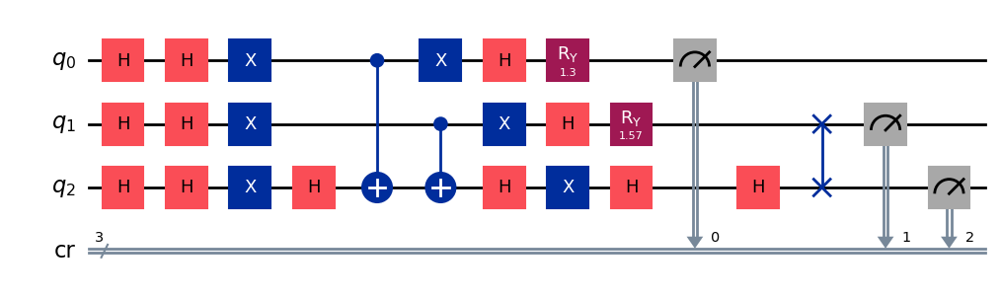

gen = 0 , Best fitness = (0.5351,)
gen = 1 , Best fitness = (0.5351,) , Number of invalids = 0

[Run 5 | Gen 49/99] Best Fitness: 0.5351 | Fidelity: 0.9826 | Gates: 26


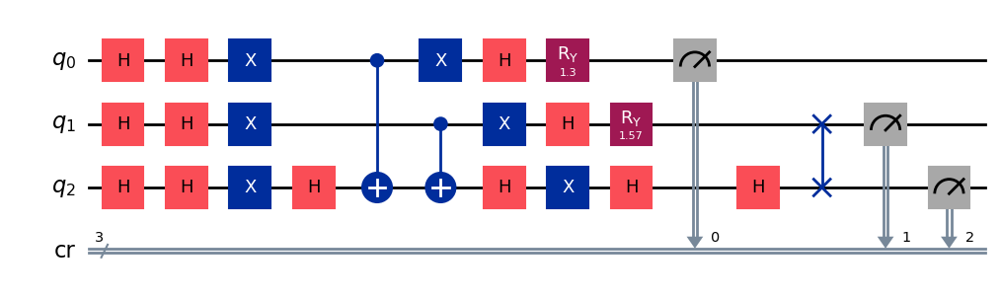

gen = 0 , Best fitness = (0.5351,)
gen = 1 , Best fitness = (0.5351,) , Number of invalids = 0

[Run 5 | Gen 50/99] Best Fitness: 0.5351 | Fidelity: 0.9842 | Gates: 26


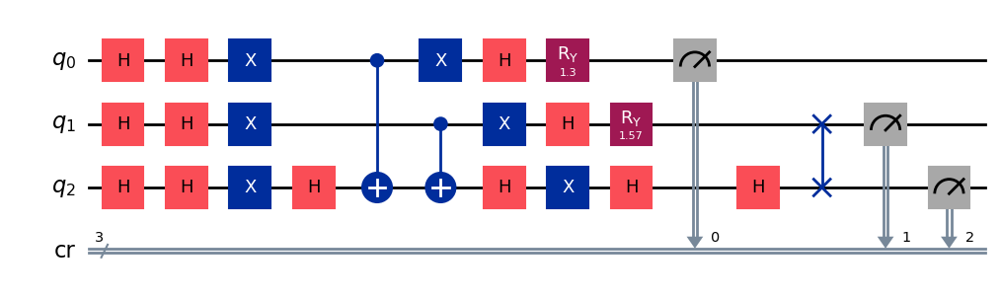

gen = 0 , Best fitness = (0.5351,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 51/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


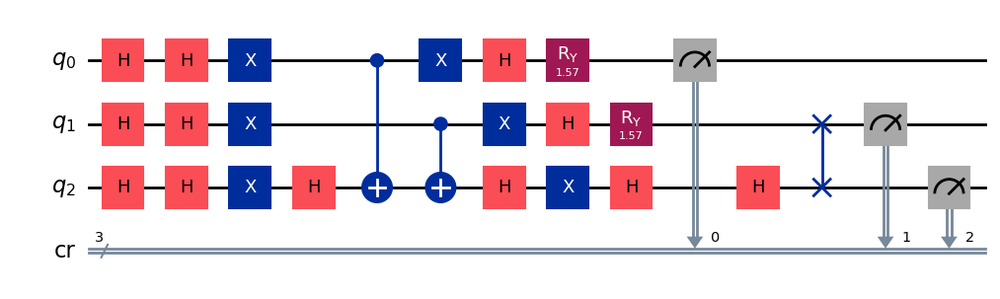

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 52/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


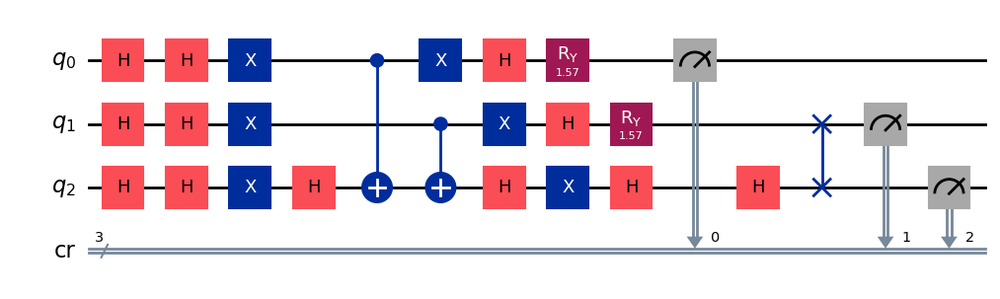

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 53/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


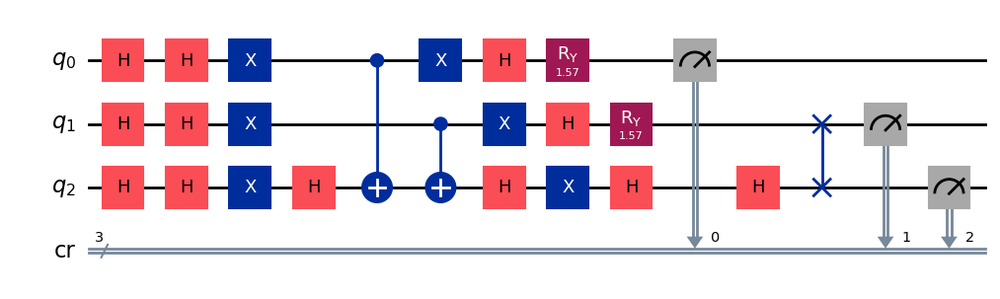

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 54/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


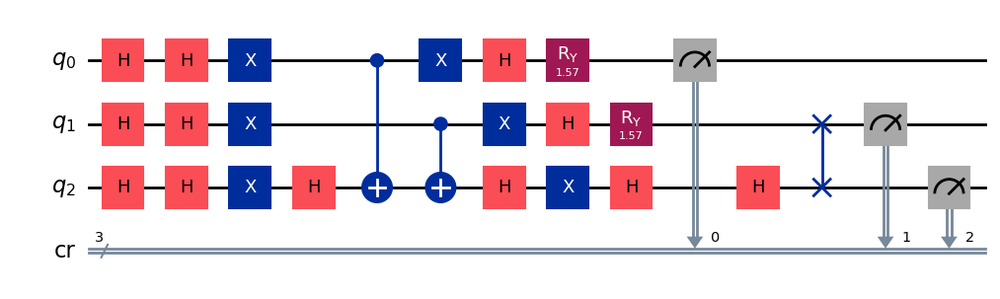

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 55/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


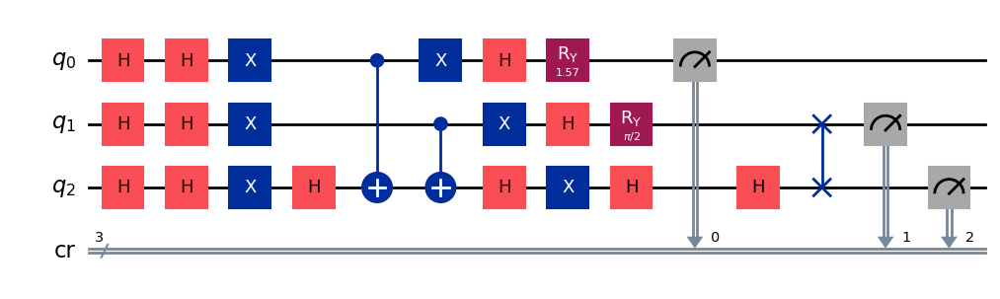

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 56/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


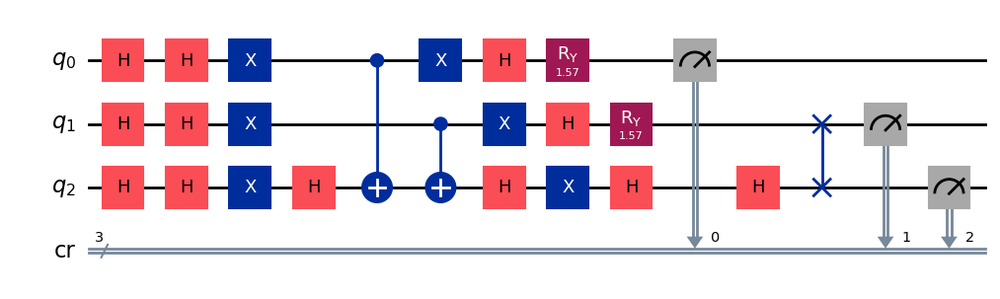

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 57/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


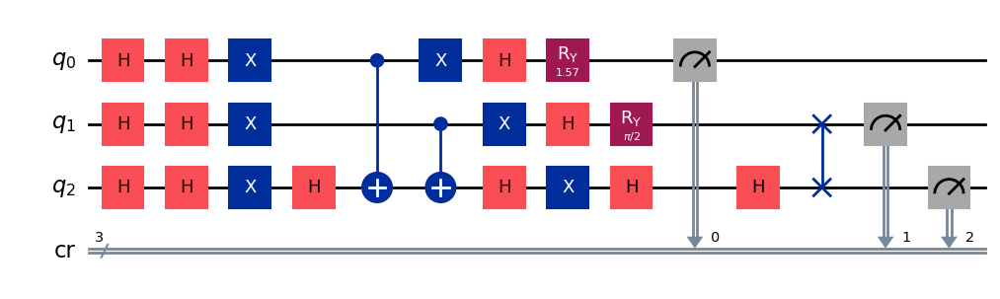

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 58/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


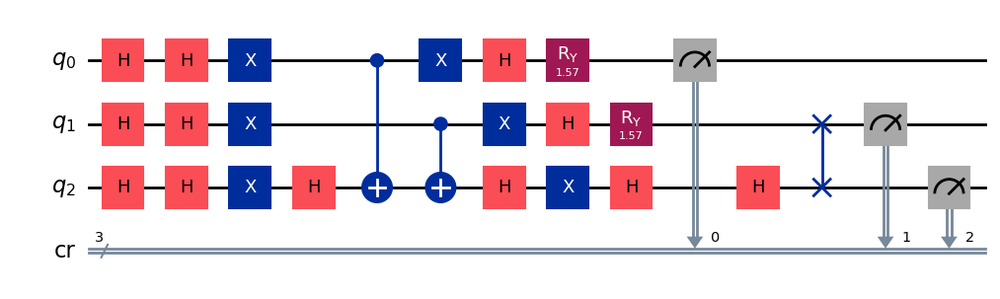

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 59/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


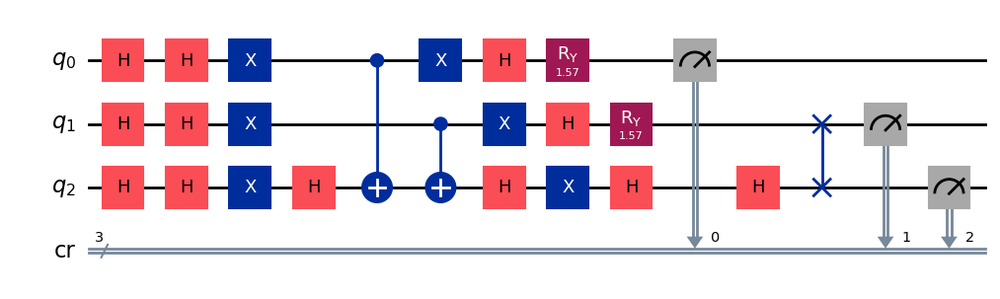

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 60/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


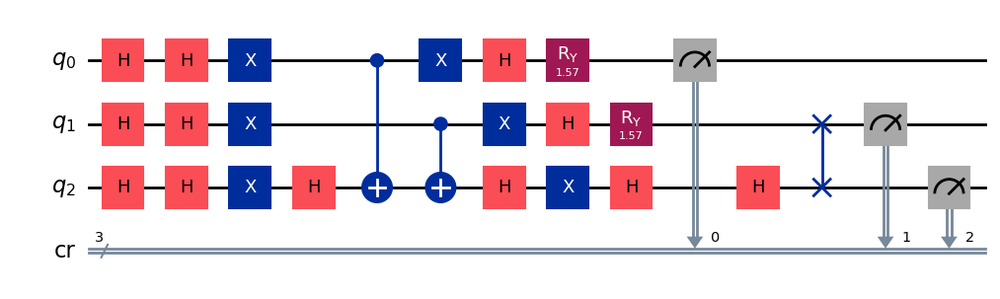

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 61/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


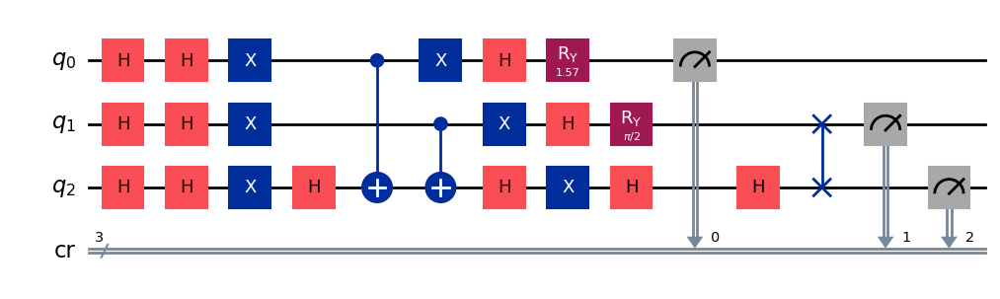

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 62/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


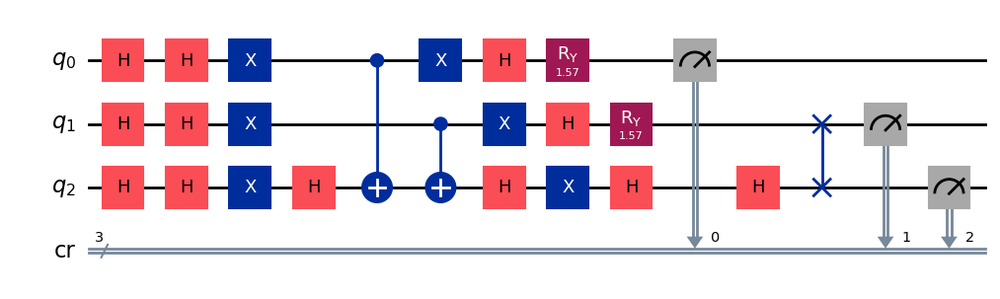

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 63/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


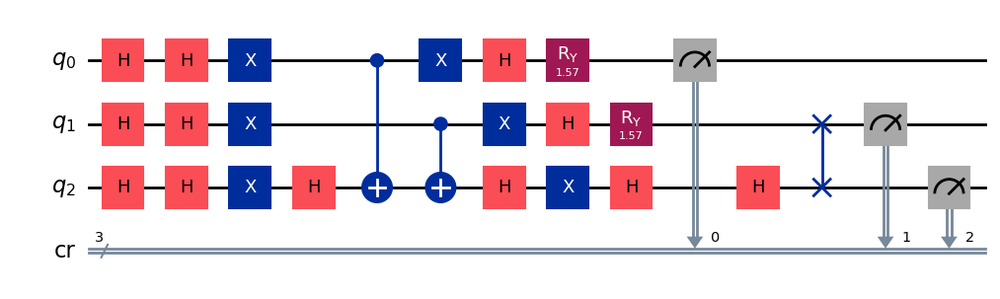

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 64/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


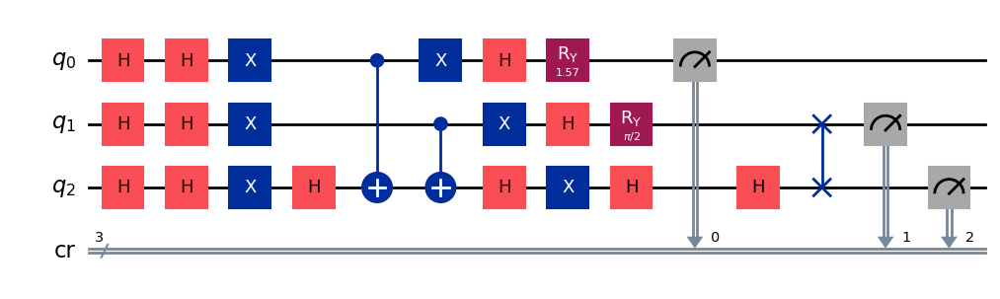

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 65/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


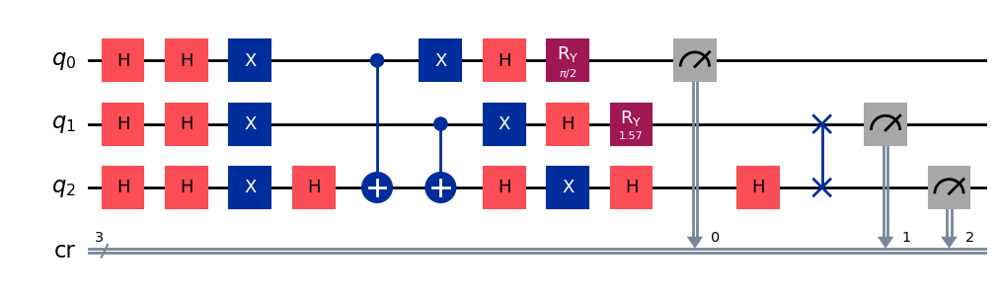

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 66/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


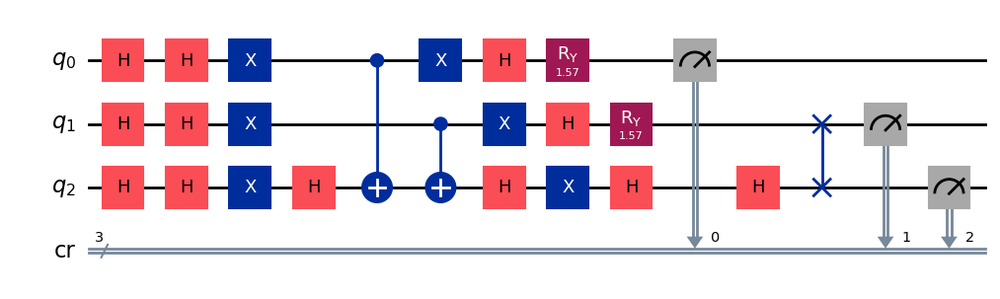

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 67/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


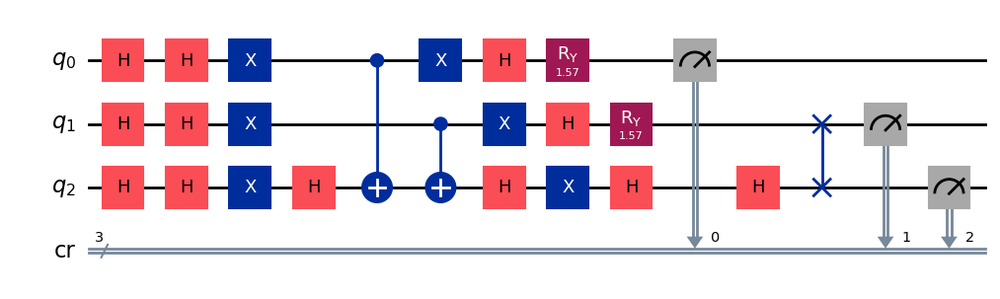

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 68/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


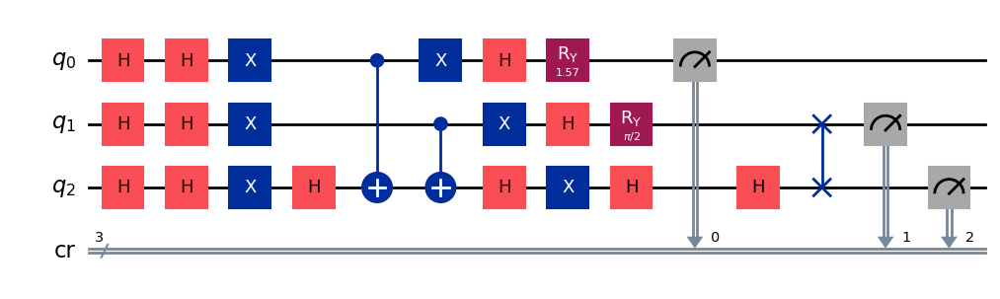

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 69/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


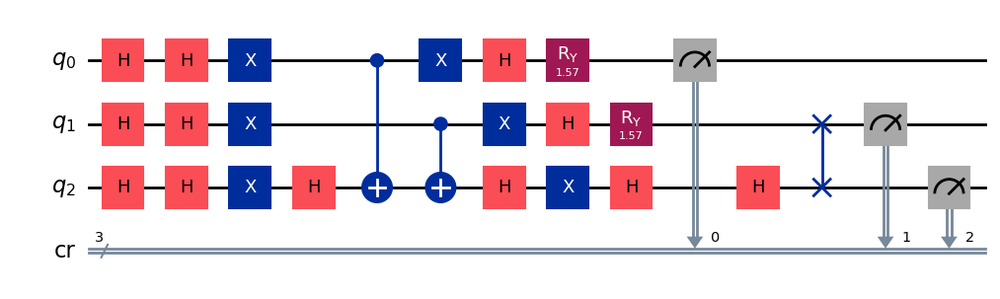

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 70/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


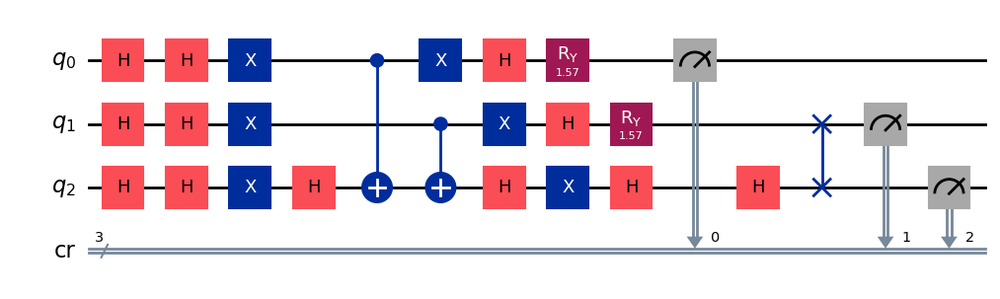

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 71/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


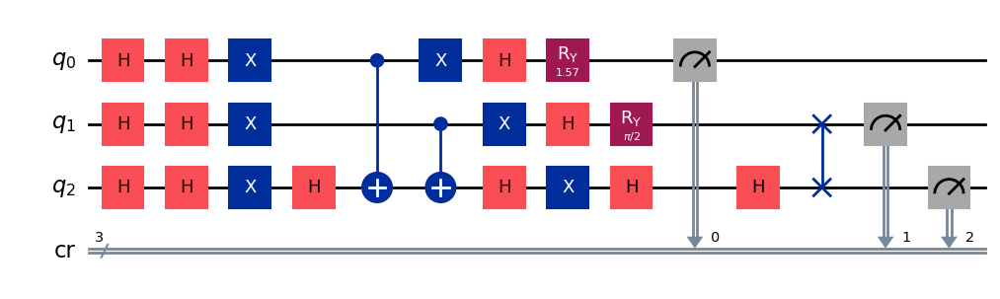

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 72/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


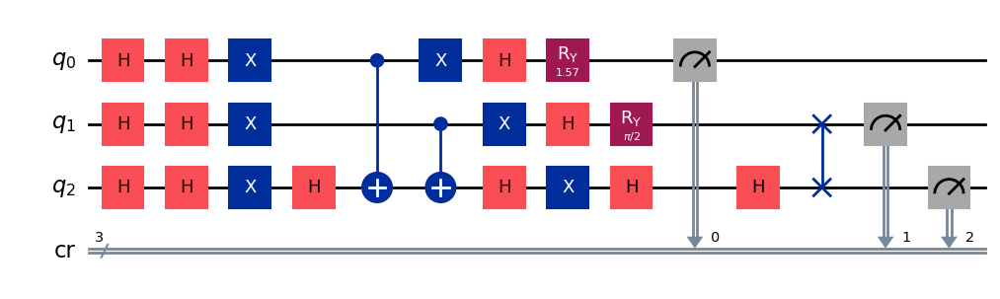

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 73/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


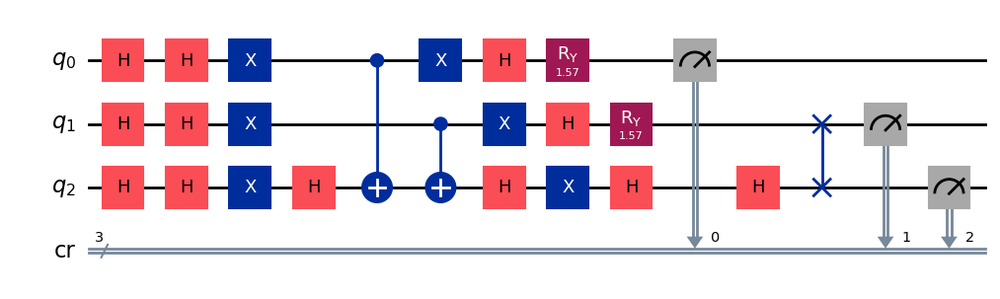

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 74/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


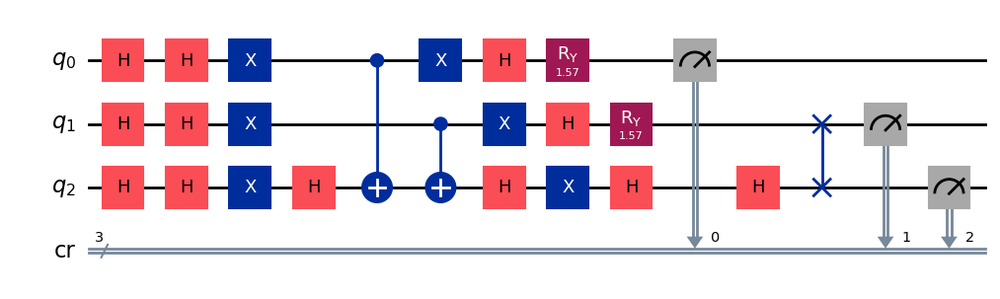

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 75/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


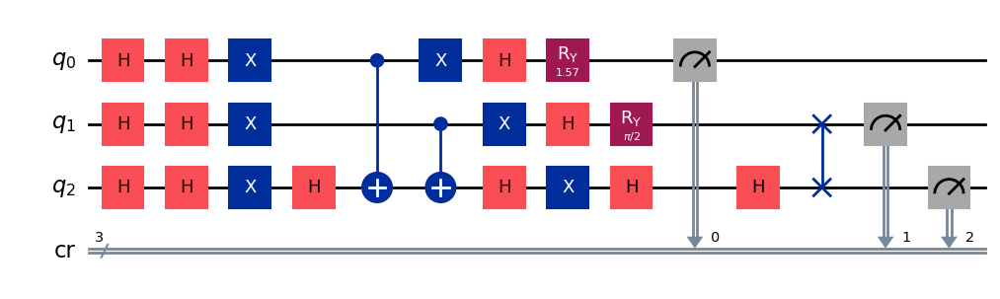

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 76/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


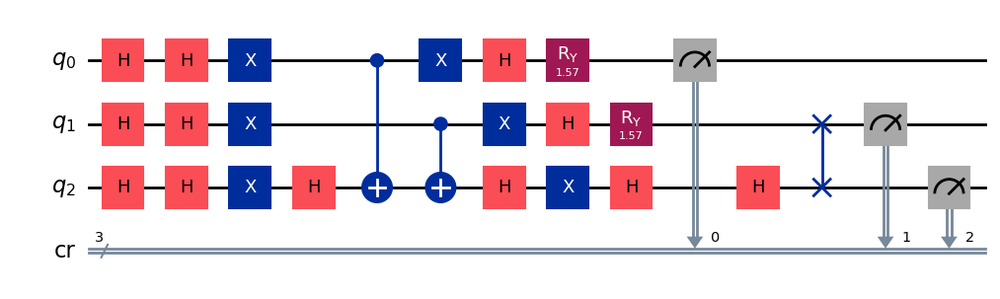

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 77/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


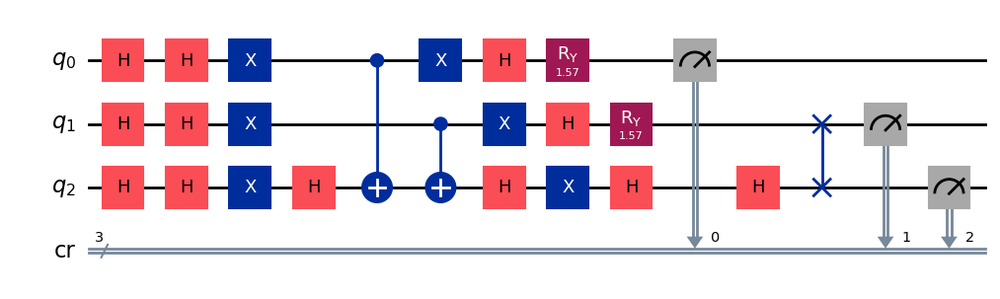

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 78/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


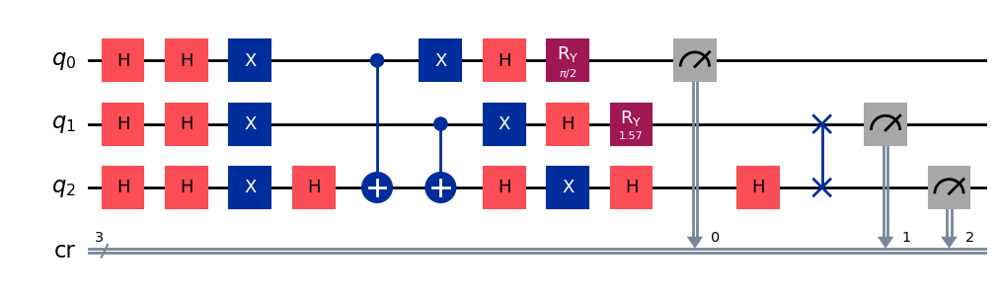

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 79/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


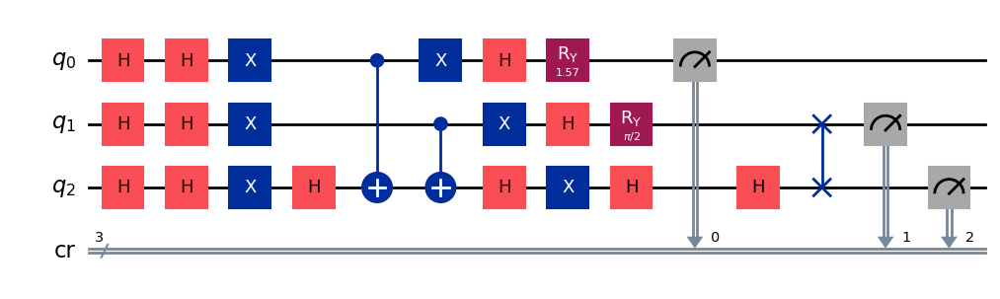

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 80/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


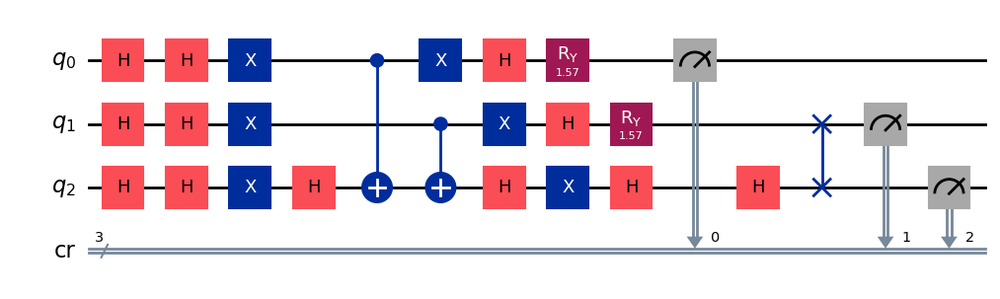

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 81/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


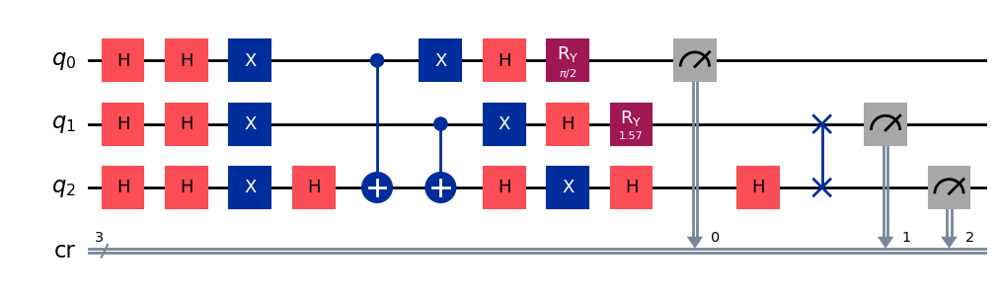

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 82/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


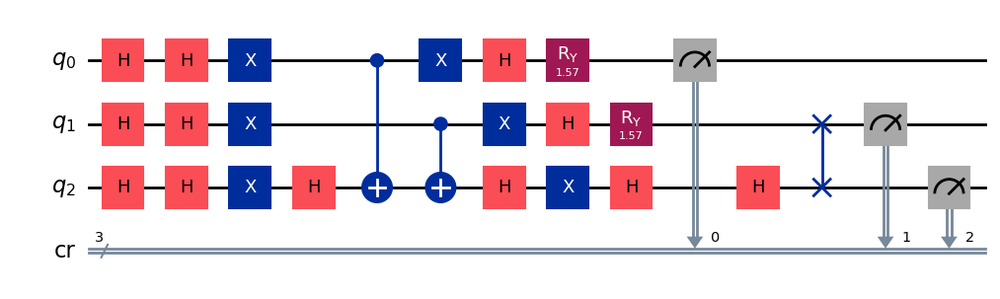

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 83/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


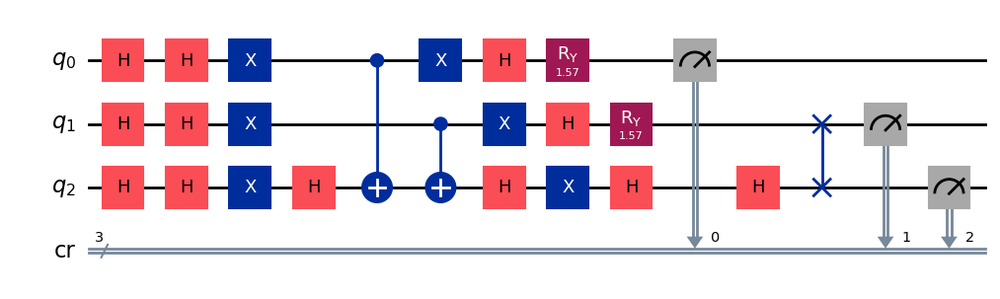

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 84/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


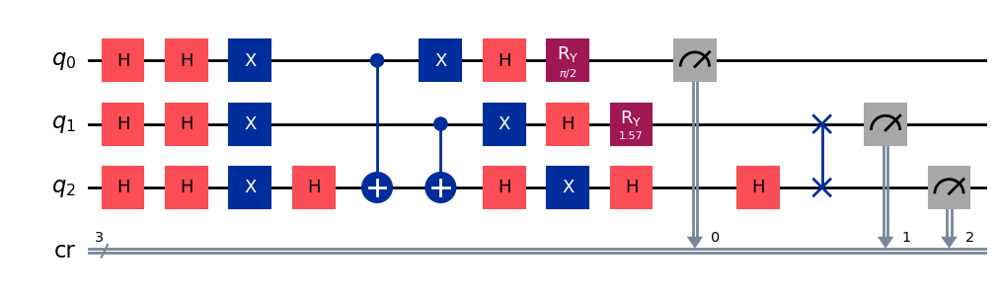

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 85/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


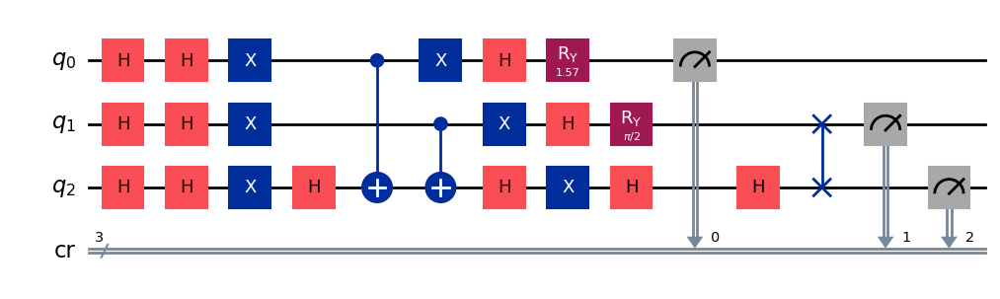

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 86/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


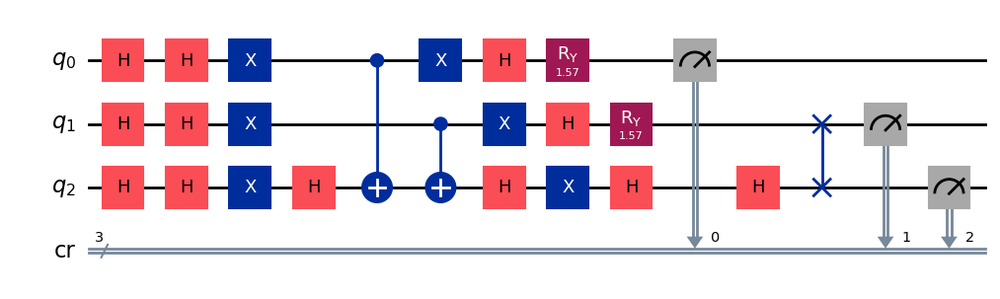

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 87/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


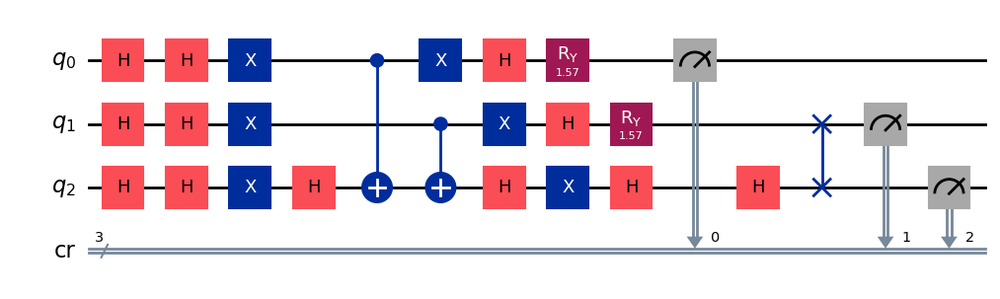

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 88/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


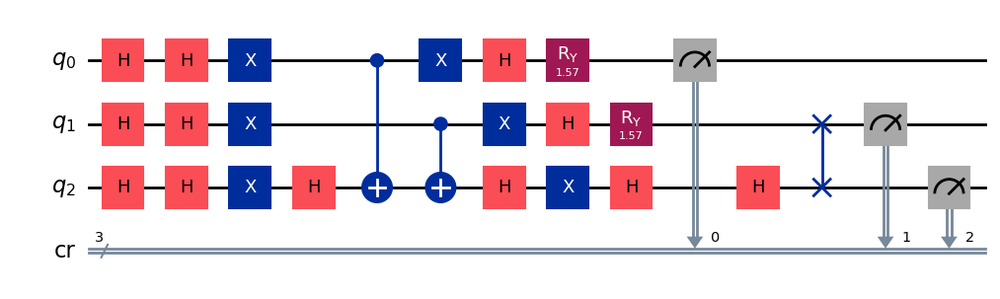

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 89/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


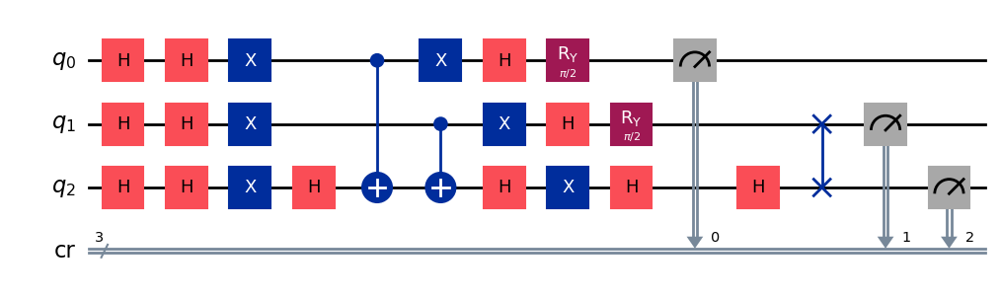

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 90/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


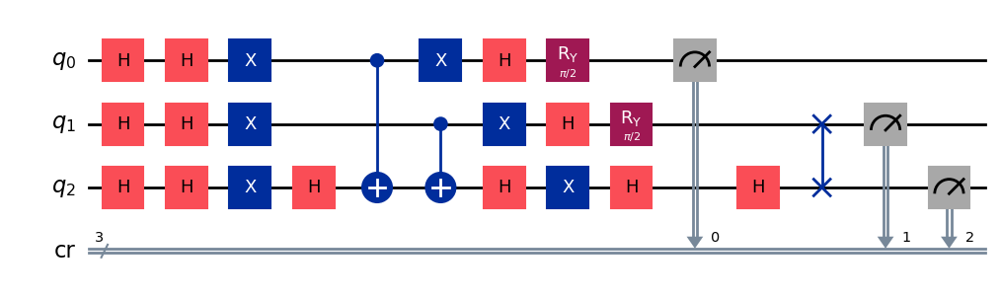

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 91/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


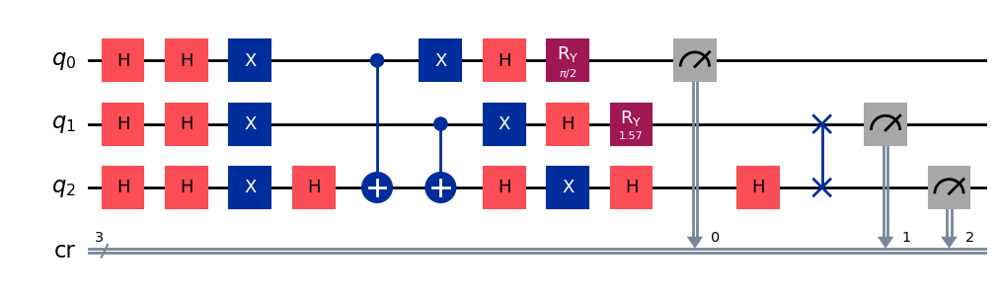

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 92/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


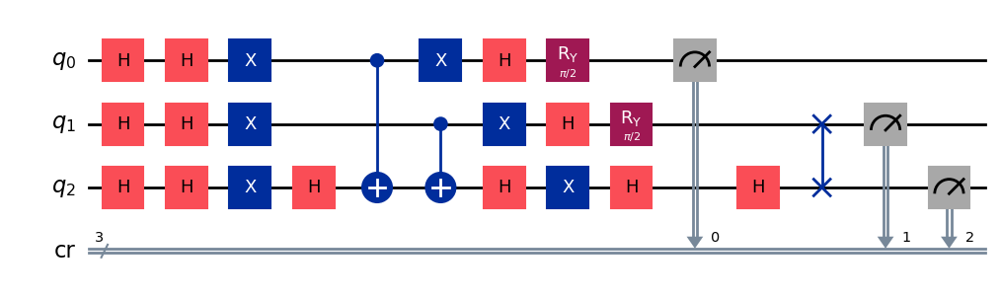

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 93/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


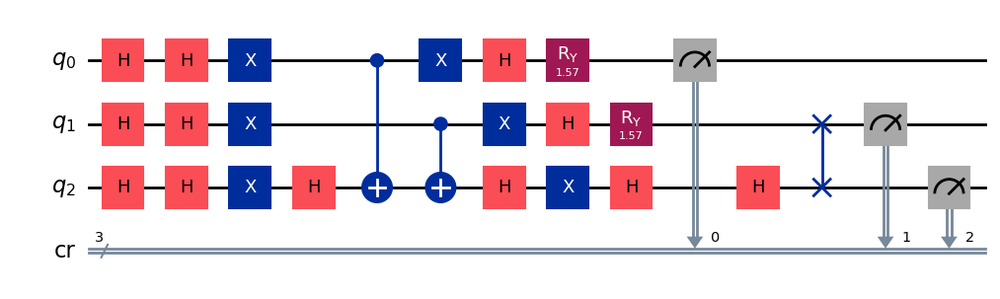

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 94/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


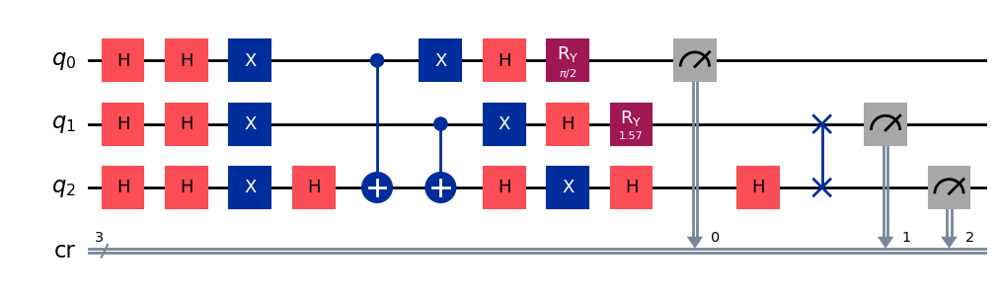

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 95/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


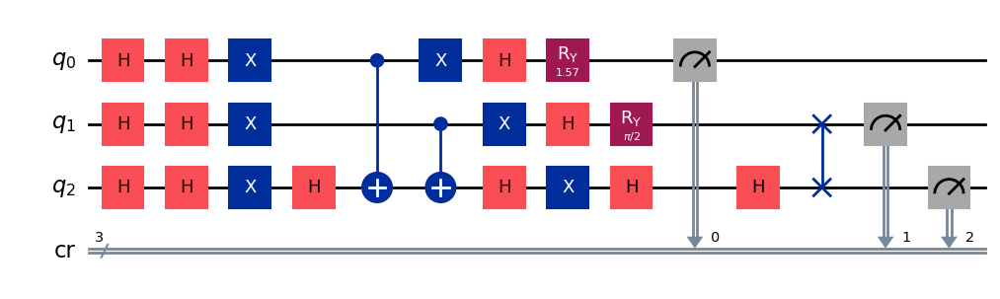

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 96/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


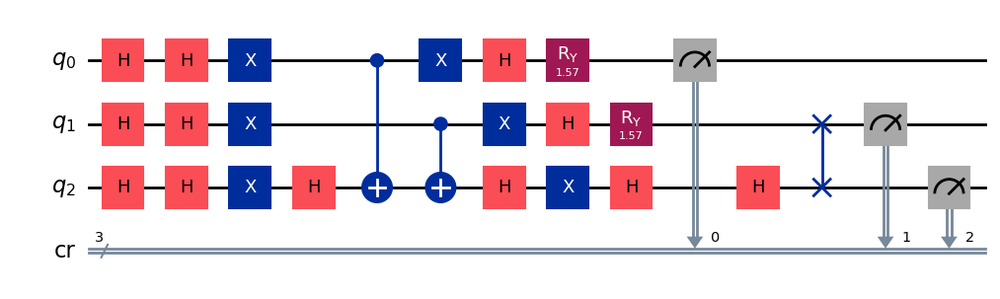

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 97/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


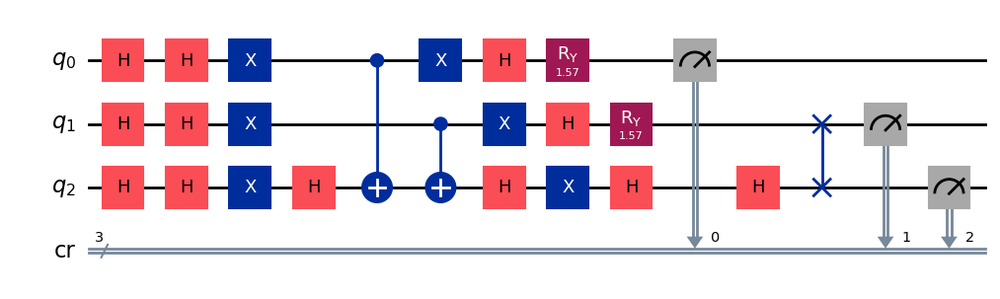

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 98/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


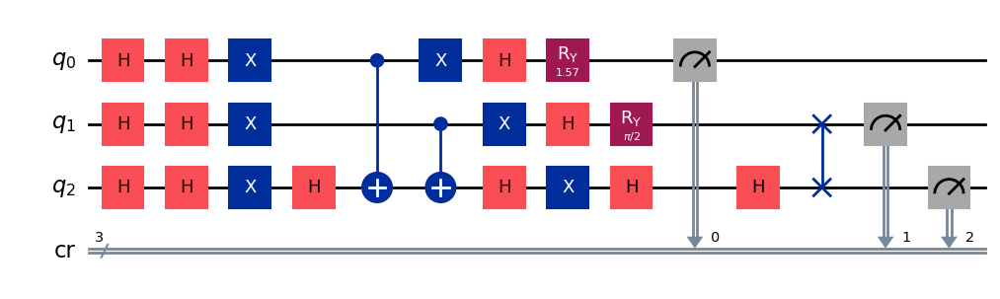

gen = 0 , Best fitness = (0.52,)
gen = 1 , Best fitness = (0.52,) , Number of invalids = 0

[Run 5 | Gen 99/99] Best Fitness: 0.5200 | Fidelity: 1.0000 | Gates: 26


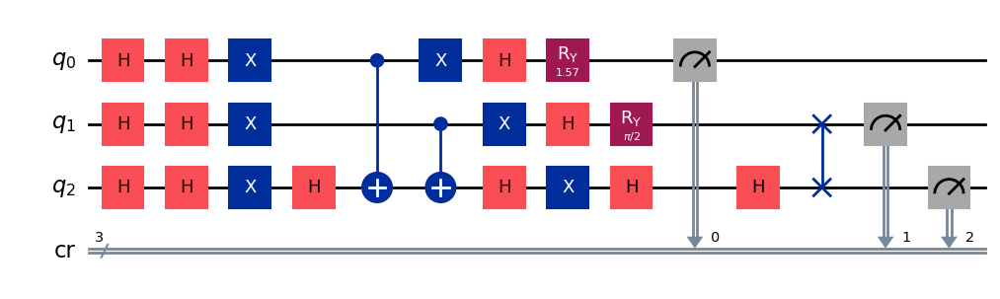


Generating evolution plots for Run 5...
✓ Plot saved to: experiments_state_101/run_5_seed_37187/evolution_metrics_run_5.png


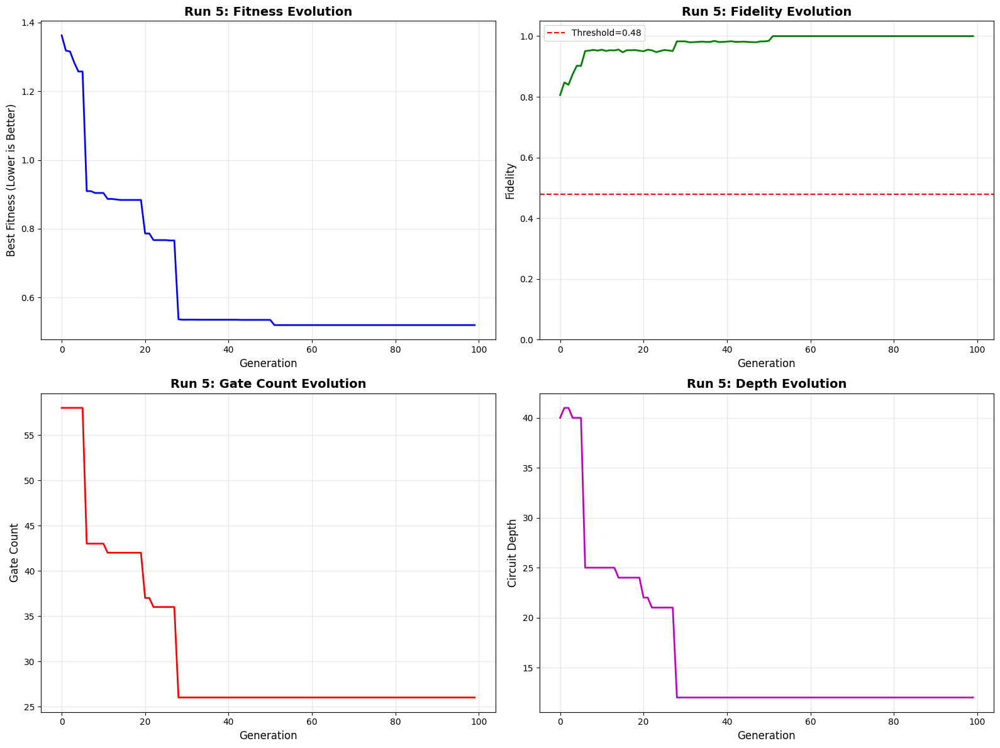


✓ Run 5 COMPLETE | Fidelity: 1.0000 | Gates: 26 | Depth: 12



In [14]:
NUMBER_OF_RUNS = 5
TARGET_STATE_FOR_EXPERIMENT = "101"

# Generate 5 random 5-digit seeds
seeds = [random.randint(10000, 99999) for _ in range(NUMBER_OF_RUNS)]
print(f"Generated seeds: {seeds}")

# Save seeds to file for reproducibility
seed_log = {
    "target_state": TARGET_STATE_FOR_EXPERIMENT,
    "seeds": seeds,
    "timestamp": pd.Timestamp.now().isoformat()
}
with open('experiment_seeds.json', 'w') as f:
    json.dump(seed_log, f, indent=2)
print(f"✓ Seeds saved to experiment_seeds.json")

all_run_results = []

print(f"\nStarting {NUMBER_OF_RUNS} independent runs for state |{TARGET_STATE_FOR_EXPERIMENT}>...")

for i, seed in enumerate(seeds):
    result = run_evolution_experiment(i+1, seed, TARGET_STATE_FOR_EXPERIMENT)
    all_run_results.append(result)

### Statistical Analysis (Mean ± SD)

In [15]:
fidelities = [r['fidelity'] for r in all_run_results]
depths = [r['depth'] for r in all_run_results]
gates = [r['gate_count'] for r in all_run_results]

mean_fid = statistics.mean(fidelities)
std_fid = statistics.stdev(fidelities)

mean_depth = statistics.mean(depths)
std_depth = statistics.stdev(depths)

mean_gates = statistics.mean(gates)
std_gates = statistics.stdev(gates)

print("\n" + "="*50)
print(f"AGGREGATE STATISTICS FOR STATE |{TARGET_STATE_FOR_EXPERIMENT}> ({NUMBER_OF_RUNS} Runs)")
print("="*50)
print(f"Fidelity:   {mean_fid*100:.2f}% ± {std_fid*100:.2f}%")
print(f"Depth:      {mean_depth:.2f} ± {std_depth:.2f}")
print(f"Gate Count: {mean_gates:.2f} ± {std_gates:.2f}")
print("="*50)

print("\nLaTeX Copy-Paste String:")
print(f"{mean_fid*100:.1f} \\pm {std_fid*100:.1f} & {mean_depth:.1f} \\pm {std_depth:.1f} & {mean_gates:.1f} \\pm {std_gates:.1f}")

# Print individual run details
print("\n" + "="*50)
print("INDIVIDUAL RUN DETAILS")
print("="*50)
for r in all_run_results:
    print(f"Run {r['run_id']} (Seed: {r['seed']}): Fidelity={r['fidelity']:.4f}, Gates={r['gate_count']}, Depth={r['depth']}, Log Dir={r['log_dir']}")



AGGREGATE STATISTICS FOR STATE |101> (5 Runs)
Fidelity:   90.11% ± 8.72%
Depth:      14.40 ± 1.82
Gate Count: 29.40 ± 2.41

LaTeX Copy-Paste String:
90.1 \pm 8.7 & 14.4 \pm 1.8 & 29.4 \pm 2.4

INDIVIDUAL RUN DETAILS
Run 1 (Seed: 29855): Fidelity=0.8904, Gates=32, Depth=16, Log Dir=experiments_state_101/run_1_seed_29855
Run 2 (Seed: 15775): Fidelity=0.9810, Gates=28, Depth=13, Log Dir=experiments_state_101/run_2_seed_15775
Run 3 (Seed: 52596): Fidelity=0.8151, Gates=30, Depth=15, Log Dir=experiments_state_101/run_3_seed_52596
Run 4 (Seed: 60899): Fidelity=0.8188, Gates=31, Depth=16, Log Dir=experiments_state_101/run_4_seed_60899
Run 5 (Seed: 37187): Fidelity=1.0000, Gates=26, Depth=12, Log Dir=experiments_state_101/run_5_seed_37187


#### Aggregate Evolution Plots Across All Runs



GENERATING AGGREGATE PLOTS
✓ Aggregate plot saved to: experiments_state_101/aggregate_evolution_all_runs.png


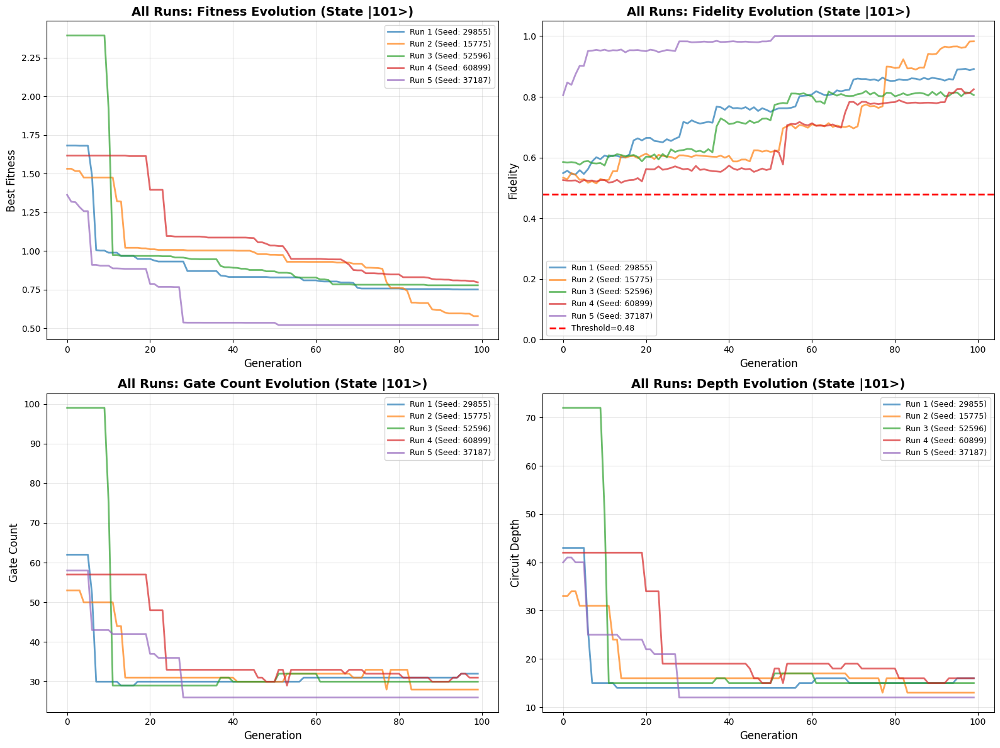

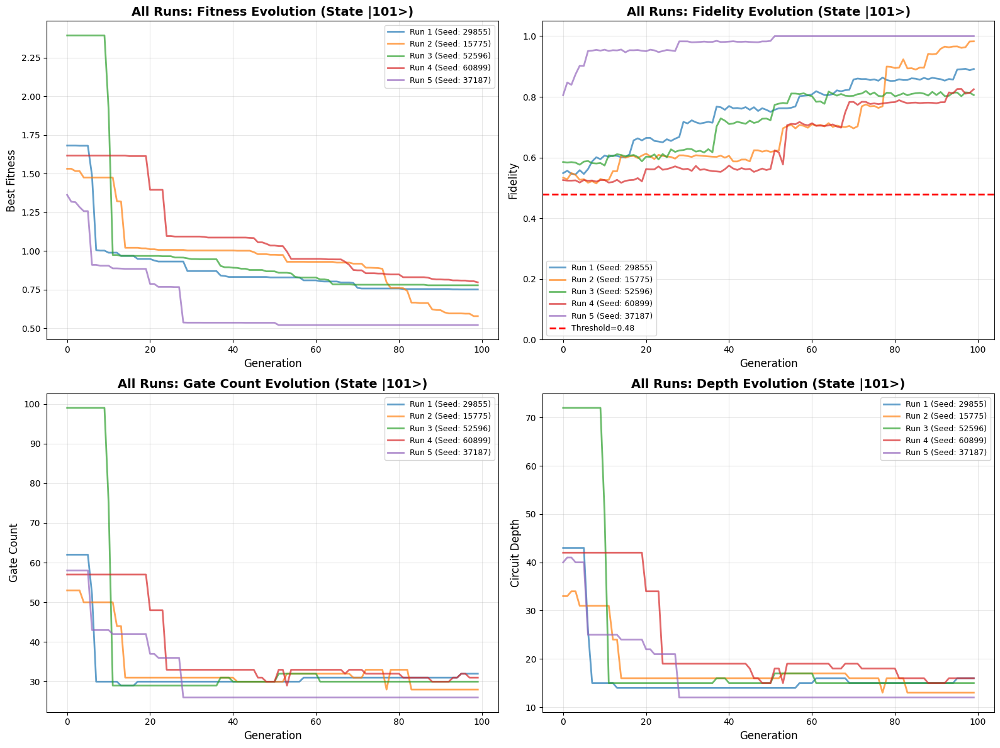

In [16]:
print("\n" + "="*50)
print("GENERATING AGGREGATE PLOTS")
print("="*50)

fig, axes = plt.subplots(2, 2, figsize=(16, 12))

colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']

for idx, r in enumerate(all_run_results):
    color = colors[idx % len(colors)]
    label = f"Run {r['run_id']} (Seed: {r['seed']})"
    
    # Fitness
    axes[0, 0].plot(r['generations'], r['fitness_history'], 
                    linewidth=2, alpha=0.7, color=color, label=label)
    
    # Fidelity
    axes[0, 1].plot(r['generations'], r['fidelity_history'], 
                    linewidth=2, alpha=0.7, color=color, label=label)
    
    # Gate count
    axes[1, 0].plot(r['generations'], r['gate_count_history'], 
                    linewidth=2, alpha=0.7, color=color, label=label)
    
    # Depth
    axes[1, 1].plot(r['generations'], r['depth_history'], 
                    linewidth=2, alpha=0.7, color=color, label=label)

# Configure subplots
axes[0, 0].set_xlabel('Generation', fontsize=12)
axes[0, 0].set_ylabel('Best Fitness', fontsize=12)
axes[0, 0].set_title(f'All Runs: Fitness Evolution (State |{TARGET_STATE_FOR_EXPERIMENT}>)', 
                     fontsize=14, fontweight='bold')
axes[0, 0].grid(True, alpha=0.3)
axes[0, 0].legend(fontsize=9)

axes[0, 1].set_xlabel('Generation', fontsize=12)
axes[0, 1].set_ylabel('Fidelity', fontsize=12)
axes[0, 1].set_title(f'All Runs: Fidelity Evolution (State |{TARGET_STATE_FOR_EXPERIMENT}>)', 
                     fontsize=14, fontweight='bold')
axes[0, 1].grid(True, alpha=0.3)
axes[0, 1].set_ylim([0, 1.05])
axes[0, 1].axhline(y=SUCCESS_THRESHOLD, color='r', linestyle='--', 
                   linewidth=2, label=f'Threshold={SUCCESS_THRESHOLD}')
axes[0, 1].legend(fontsize=9)

axes[1, 0].set_xlabel('Generation', fontsize=12)
axes[1, 0].set_ylabel('Gate Count', fontsize=12)
axes[1, 0].set_title(f'All Runs: Gate Count Evolution (State |{TARGET_STATE_FOR_EXPERIMENT}>)', 
                     fontsize=14, fontweight='bold')
axes[1, 0].grid(True, alpha=0.3)
axes[1, 0].legend(fontsize=9)

axes[1, 1].set_xlabel('Generation', fontsize=12)
axes[1, 1].set_ylabel('Circuit Depth', fontsize=12)
axes[1, 1].set_title(f'All Runs: Depth Evolution (State |{TARGET_STATE_FOR_EXPERIMENT}>)', 
                     fontsize=14, fontweight='bold')
axes[1, 1].grid(True, alpha=0.3)
axes[1, 1].legend(fontsize=9)

plt.tight_layout()

state_dir = f"experiments_state_{TARGET_STATE_FOR_EXPERIMENT}"
aggregate_plot_path = os.path.join(state_dir, f'aggregate_evolution_all_runs.png')
plt.savefig(aggregate_plot_path, dpi=150, bbox_inches='tight')

print(f"✓ Aggregate plot saved to: {aggregate_plot_path}")
display(fig)

### Select Best Circuit for IBM Hardware


Selecting Best Circuit from Run #5 (Seed: 37187)
Simulated Fidelity: 1.0000
Log directory: experiments_state_101/run_5_seed_37187
[QPU] Running on: ibm_torino

[HOF Individual 1] Fitness: 0.52
Evolved transpiled count_ops: OrderedDict([('rz', 5), ('x', 4), ('sx', 4), ('measure', 3), ('cz', 2)])
Evolved transpiled depth:    9
Total ops:        18
Qubits / Clbits:  133 / 3


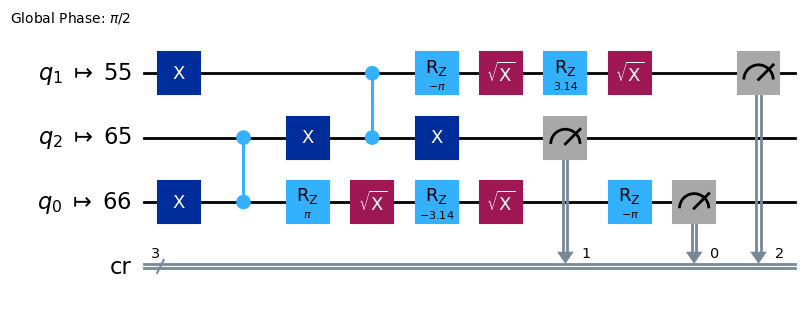

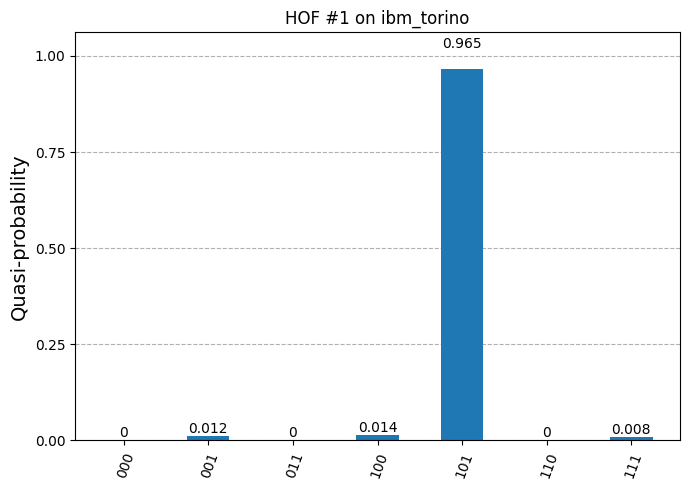

In [21]:
best_run = min(all_run_results, key=lambda x: x['raw_fitness'])

print(f"\nSelecting Best Circuit from Run #{best_run['run_id']} (Seed: {best_run['seed']})")
print(f"Simulated Fidelity: {best_run['fidelity']:.4f}")
print(f"Log directory: {best_run['log_dir']}")

evaluator = CircuitEvaluator(shots=NUM_SHOTS, log_dir=best_run['log_dir'])
dummy_hof = tools.HallOfFame(1)
dummy_hof.update([best_run['individual']])

run_hof_on_ibm(evaluator, dummy_hof, target_state=TARGET_STATE_FOR_EXPERIMENT)